# Reinforcement Q-learning simple NN as function approximation

- Portfolio grid of size 10 (0 to 1)
- 2 hidden neural layers 
- Training

In [1]:
# Initialization
import numpy as np
import pandas as pd
import random
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline

In [12]:
data = pd.read_csv('data.csv') #Three stocks (R,X_s,X_b,s_nom,s_pe,s_spr) 

In [9]:
data = pd.read_excel('sim_data_CER.xlsx') #Three stocks (R,X_s,X_b) Without predictors

# Initialization of the Tensorflow placeholders and the network

In [10]:
num_lags = 3
num_stocks=3
num_inputvar = (num_lags+1)*num_stocks
num_actions=10
hidden1 = 60
hidden2 = 45
hidden3 = 20

#Initialize Neural Network and set-up the placeholders
tf.reset_default_graph()
NN_input = tf.placeholder(shape=[1,num_inputvar],dtype=tf.float32)
# w1 = tf.Variable(tf.random_uniform([num_inputvar,hidden1],0,1))
# w2 = tf.Variable(tf.random_uniform([hidden1,hidden2],0,1))
# w3 = tf.Variable(tf.random_uniform([hidden2,hidden3],0,1))
# w4 = tf.Variable(tf.random_uniform([hidden3,num_actions],0,1))
# b1 = tf.Variable(np.zeros((1,hidden1)), dtype=tf.float32)
# b2 = tf.Variable(np.zeros((1,hidden2)), dtype=tf.float32)
# b3 = tf.Variable(np.zeros((1,hidden3)), dtype=tf.float32)
# b4 = tf.Variable(np.zeros((1,num_actions)), dtype=tf.float32)

w1 = tf.Variable(tf.random_uniform([num_inputvar,hidden1],0,0.01))
# b1 = tf.Variable(np.zeros((1,num_actions)), dtype=tf.float32) 
w2 = tf.Variable(tf.random_uniform([hidden1,num_actions],0,0.01))
# h1 = tf.add(tf.matmul(NN_input,w1),b1)
# # h_drop1 = tf.nn.dropout(h1,0.5)
# a1 = tf.nn.softmax(h1)

# h2 = tf.add(tf.matmul(a1,w2),b2)
# # h_drop2 = tf.nn.dropout(h2,0.3)
# a2 = tf.nn.softmax(h2)

# h3 = tf.add(tf.matmul(a2,w3),b3)
# # h_drop3 = tf.nn.dropout(h3,0.1)
# a3 = tf.nn.softmax(h3)

# ol = tf.add(tf.matmul(a3,w4),b4)
# output = tf.nn.softmax(ol)

outputh1 = tf.matmul(NN_input,w1)
output = tf.matmul(outputh1,w2)
A_Max = tf.argmax(output,1)

Q_Next = tf.placeholder(shape=[1,num_actions],dtype=tf.float32)
loss = tf.reduce_sum(tf.square(Q_Next - output))



learning_rate = tf.placeholder(tf.float32, shape=[])
trainer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
optmzr = trainer.minimize(loss)


# A_Max = tf.argmax(output,1)
# Calculate loss for the NN from the Q values
# Q_Next = tf.placeholder(shape=[1,num_actions],dtype=tf.float32)
# diff = tf.subtract(Q_Next,output)
# loss = tf.reduce_sum(tf.multiply(diff,diff))

# cross_entropy = tf.reduce_mean(-tf.reduce_sum(a4 * tf.log(Q_Next), reduction_indices=[1]))
# optmzr = tf.train.GradientDescentOptimizer(learning_rate = learning_rate).minimize(loss)
A = np.linspace(0,1,num_actions) # portfolio weights of stocks (1-weight) is the weight in the bonds

# Training of the NN function approximation

1974-05-01 00:00:00


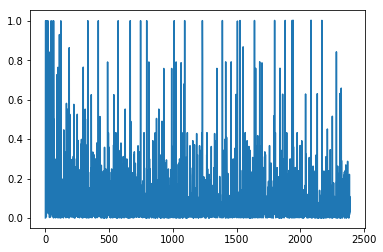

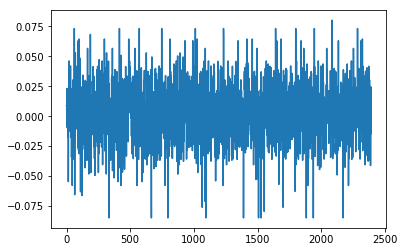

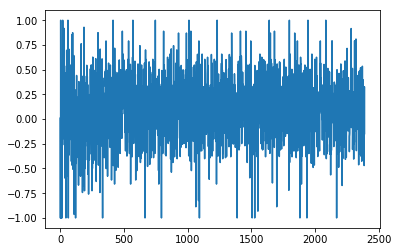

1.17007517709
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.66666667  0.33333333  0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.33333333  0.66666667  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.33333333  0.66666667  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667]
Writing away results
1974-06-01 00:00:00


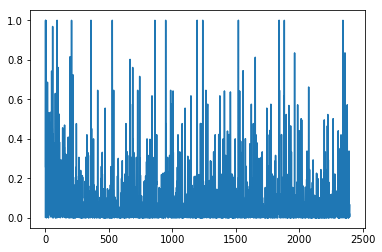

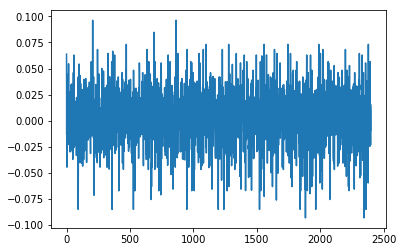

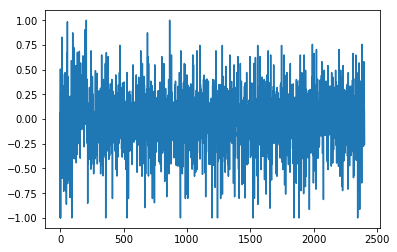

1.27580455186
[ 0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.22222222
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.66666667  0.11111111  0.33333333  0.66666667  0.22222222  0.66666667
  0.66666667  0.22222222  0.33333333  0.44444444  0.77777778  0.77777778
  0.66666667  0.88888889  0.33333333  0.66666667  0.77777778  1.
  0.11111111  0.77777778  0.77777778  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778
  0.77777778  0.55555556  0.66666667  0.66666667  0.66666667]
Writing away results
1974-07-01 00:00:00


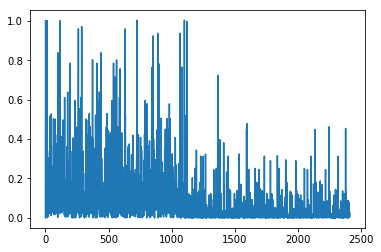

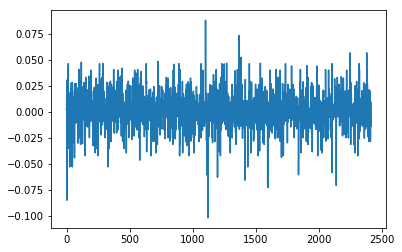

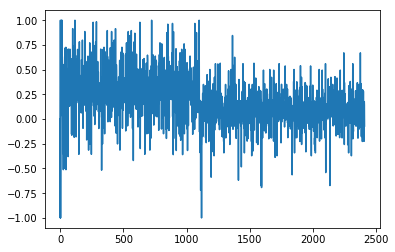

1.10901498807
[ 0.          0.          0.          0.          0.          0.
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.          0.          0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.          0.22222222  0.22222222
  0.          0.          0.          0.          0.          0.22222222
  0.22222222  0.          0.22222222  0.          0.          0.          0.
  0.          0.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.          0.          0.          0.
  0.22222222  0.22222222  0.22222222  0.        ]
Writing away results
1974-08-01 00:00:00


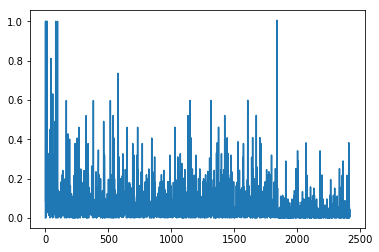

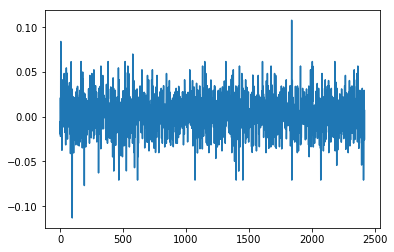

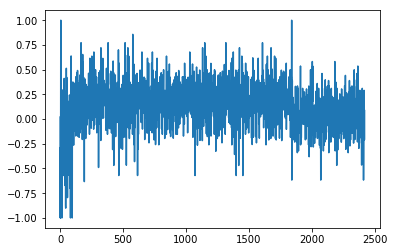

1.20184368165
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556  0.11111111
  0.55555556  0.55555556  0.11111111  0.55555556  0.55555556  0.11111111
  0.55555556  0.11111111  0.11111111  0.11111111  0.55555556  0.55555556
  0.11111111  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556]
Writing away results
1974-09-01 00:00:00


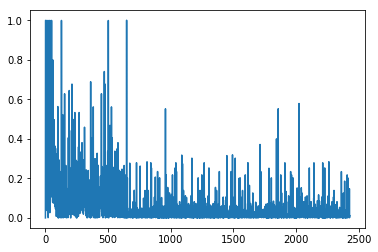

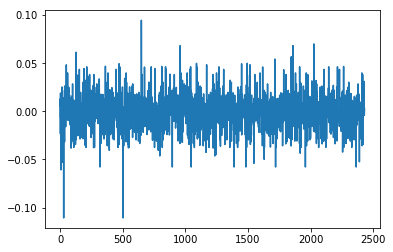

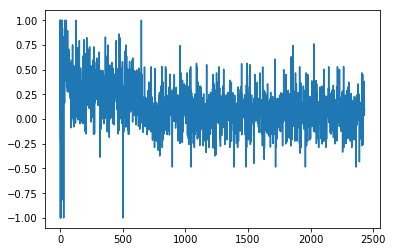

1.20533944482
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.33333333
  0.33333333  0.33333333  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111  0.11111111
  0.11111111  0.33333333  0.11111111  0.11111111  0.11111111  0.33333333
  0.33333333  0.33333333  0.33333333  0.11111111  0.11111111  0.33333333
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111
  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111]
Writing away results
1974-10-01 00:00:00


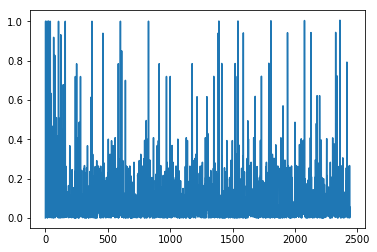

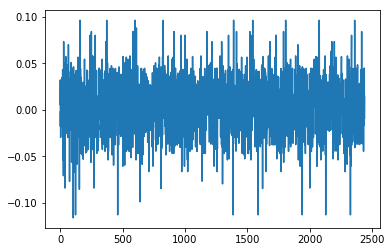

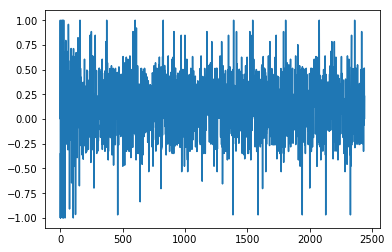

1.39622771888
[ 0.44444444  0.44444444  0.44444444  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444
  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.44444444  0.88888889  0.44444444  0.88888889  0.88888889
  0.44444444  0.88888889  0.88888889  0.44444444  0.88888889  0.44444444
  0.44444444  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.44444444  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889
  0.88888889  0.77777778  0.88888889  0.88888889  0.88888889]
Writing away results
1974-11-01 00:00:00


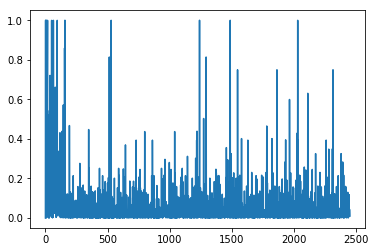

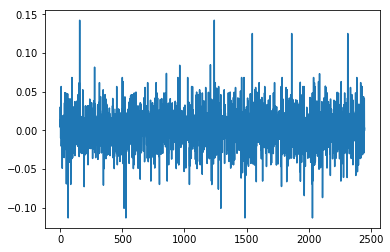

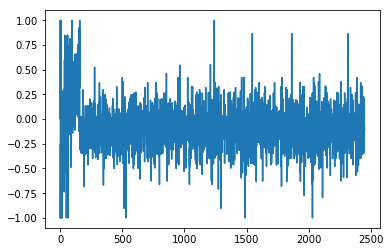

1.38431440458
[ 0.11111111  0.44444444  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.55555556  0.77777778  0.11111111
  1.          0.66666667  0.55555556  0.66666667  0.66666667  0.55555556
  0.88888889  0.77777778  0.33333333  0.11111111  0.55555556  0.66666667
  0.66666667  0.55555556  1.          0.55555556  0.77777778  0.
  0.11111111  1.          0.66666667  0.66666667  0.77777778  0.11111111
  0.77777778  0.          0.11111111  0.77777778  0.77777778  0.
  0.88888889  0.66666667  0.77777778  0.          0.44444444  0.55555556
  0.77777778  0.77777778  0.11111111  0.44444444  0.77777778  0.66666667
  0.11111111  0.55555556  1.          1.          0.66666667]
Writing away results
1974-12-01 00:00:00


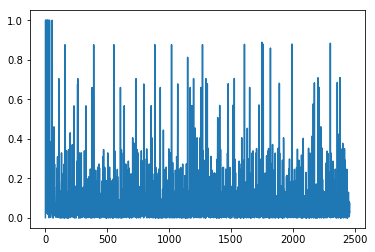

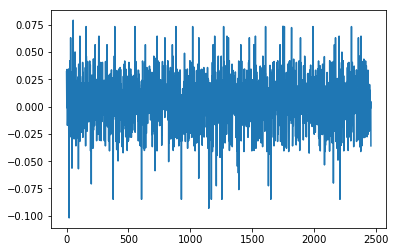

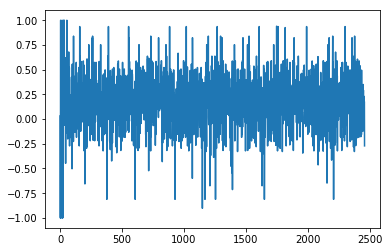

1.14365278278
[ 0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.11111111  0.66666667  0.66666667  0.11111111  0.66666667
  0.66666667  0.11111111  0.66666667  0.11111111  0.11111111  0.11111111
  0.66666667  0.66666667  0.11111111  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111]
Writing away results
1975-01-01 00:00:00


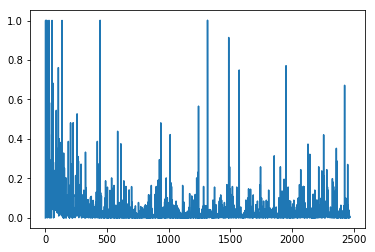

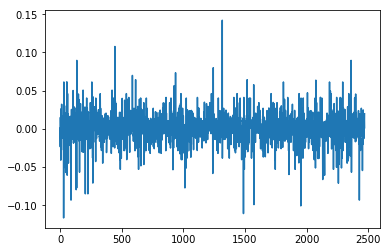

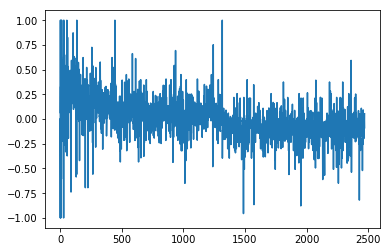

1.16150717099
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.55555556  1.          0.          0.44444444  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.22222222
  0.          0.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.55555556  1.          0.          0.          0.22222222
  0.22222222  0.          0.22222222  0.          0.66666667  0.77777778
  0.          1.          1.          0.33333333  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.88888889  1.          0.11111111
  0.          0.22222222  0.22222222  0.22222222  0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.11111111  1.        ]
Writing away results
1975-02-01 00:00:00


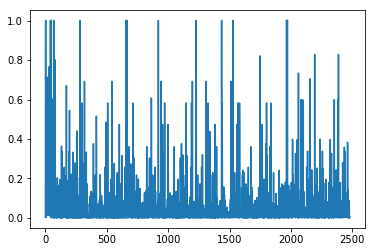

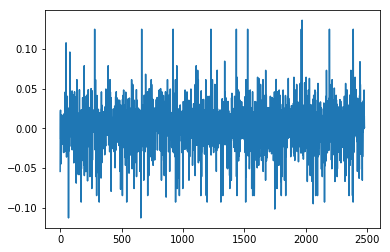

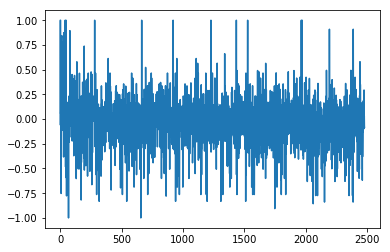

1.24610027072
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.77777778  0.77777778  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.77777778
  0.66666667  0.66666667  0.44444444  0.66666667  0.66666667  0.44444444
  0.66666667  0.22222222  0.77777778  0.77777778  0.66666667  0.44444444
  0.44444444  0.66666667  0.77777778  0.22222222  0.77777778  0.77777778
  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.          0.22222222  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.33333333
  0.66666667  0.66666667  0.77777778  0.66666667  0.77777778]
Writing away results
1975-03-01 00:00:00


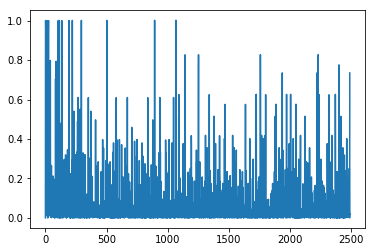

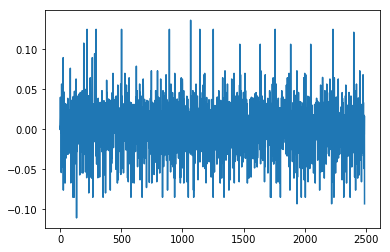

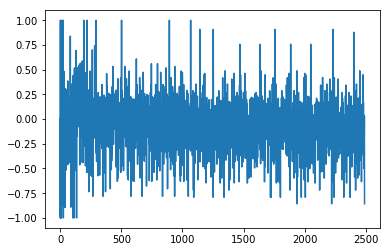

1.16924225172
[ 0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.77777778  0.66666667  0.11111111  0.22222222
  0.66666667  0.55555556  0.66666667  0.66666667  0.77777778  0.77777778
  1.          0.77777778  0.77777778  0.66666667  0.11111111  0.77777778
  0.66666667  0.77777778  0.66666667  0.77777778  0.77777778  0.77777778
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.          0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.66666667  0.11111111  0.22222222]
Writing away results
1975-04-01 00:00:00


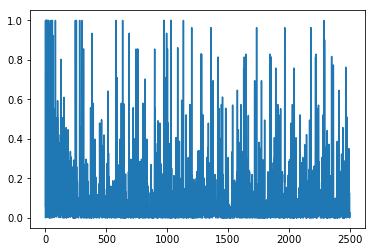

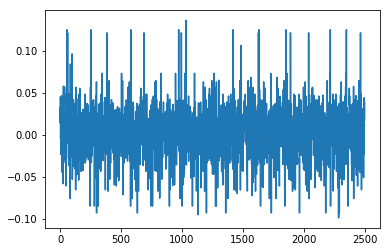

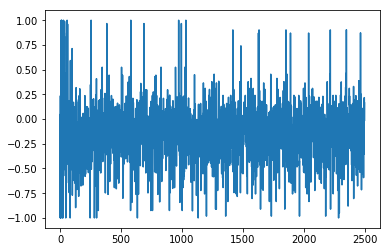

1.11299274875
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.          0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.77777778  0.66666667  0.33333333
  0.77777778  0.77777778  0.66666667  0.77777778  0.66666667  0.66666667
  0.77777778  0.66666667  0.77777778  0.77777778  0.66666667  0.77777778
  0.77777778  1.          0.66666667  0.66666667  0.66666667  0.88888889
  0.77777778  0.66666667  0.77777778  0.77777778  0.44444444  0.66666667
  0.66666667  0.88888889  0.66666667  0.77777778  0.66666667  0.66666667
  0.77777778  0.66666667  0.77777778  0.77777778  0.44444444]
Writing away results
1975-05-01 00:00:00


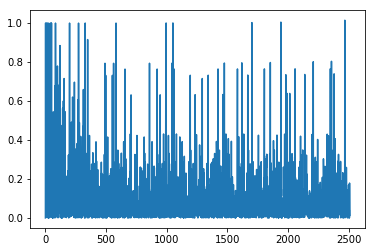

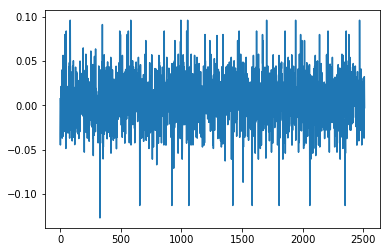

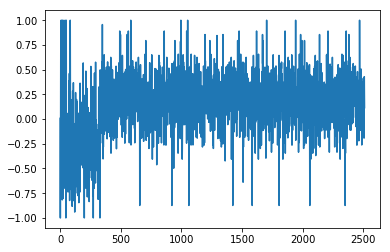

0.935915996162
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.88888889  0.          0.88888889  0.88888889  0.
  0.88888889  0.88888889  0.          0.88888889  0.          0.          0.
  0.88888889  0.88888889  0.          0.88888889  0.          0.          0.
  0.          0.          0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.          0.          0.          0.
  0.88888889  0.88888889  0.88888889  0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.          0.88888889  0.          0.88888889
  0.88888889  0.        ]
Writing away results
1975-06-01 00:00:00


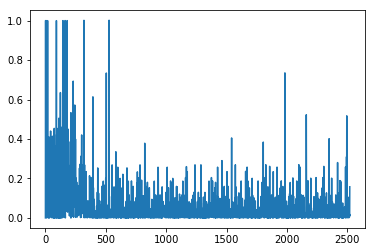

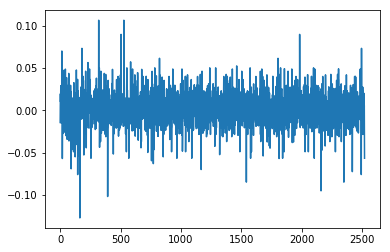

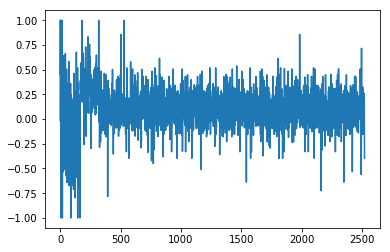

1.02595682811
[ 0.44444444  0.44444444  0.44444444  0.22222222  0.22222222  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222
  0.44444444  0.22222222  0.44444444  0.44444444  0.22222222  0.44444444
  0.44444444  0.22222222  0.44444444  0.22222222  0.22222222  0.22222222
  0.44444444  0.44444444  0.22222222  0.44444444  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222  0.22222222
  0.22222222  0.22222222  0.44444444  0.44444444  0.44444444  0.22222222
  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222  0.44444444
  0.22222222  0.44444444  0.44444444  0.22222222  0.22222222]
Writing away results
1975-07-01 00:00:00


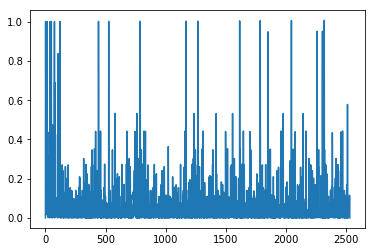

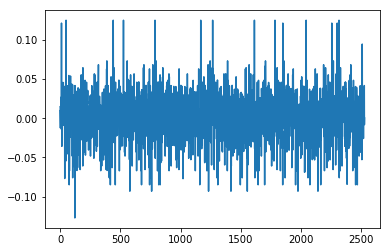

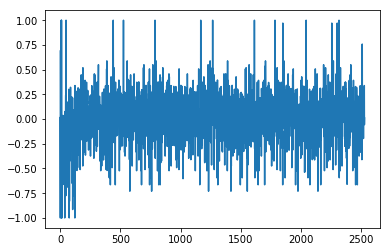

1.14264515901
[ 0.66666667  0.66666667  0.77777778  0.44444444  0.44444444  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667
  0.77777778  0.88888889  0.66666667  0.77777778  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.77777778  0.77777778  0.66666667
  0.77777778  0.88888889  0.66666667  0.77777778  0.66666667  0.77777778
  0.77777778  0.22222222  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  0.77777778
  0.77777778  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  0.77777778
  0.          0.66666667  0.77777778  0.66666667  0.44444444]
Writing away results
1975-08-01 00:00:00


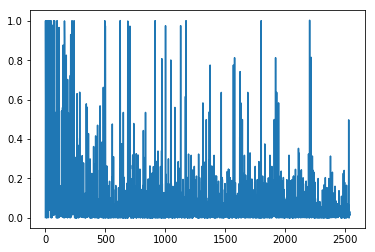

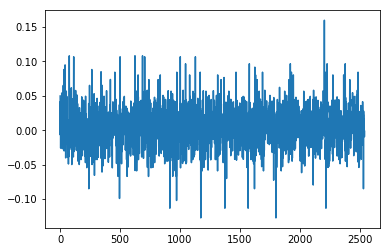

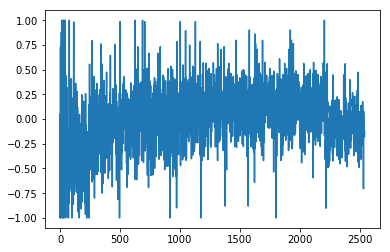

1.09866484723
[ 0.88888889  0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.
  0.88888889  0.88888889  0.          0.88888889  0.88888889  0.
  0.88888889  0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.          0.          0.          0.          0.
  0.          0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.          0.          0.          0.          0.88888889
  0.88888889  0.88888889  0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.          0.88888889  0.          0.          0.88888889
  0.          0.88888889  0.          0.88888889]
Writing away results
1975-09-01 00:00:00


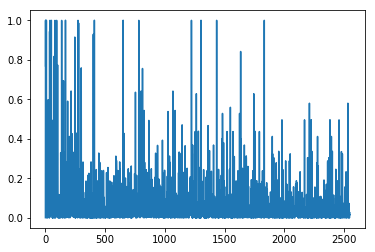

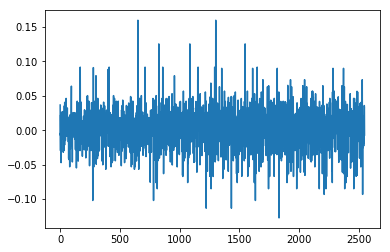

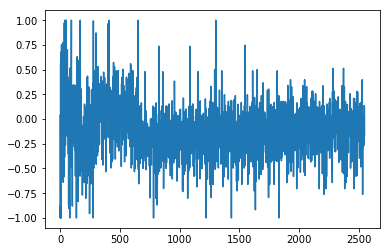

1.29967801959
[ 0.          0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.66666667  0.33333333  0.22222222
  0.66666667  0.55555556  0.66666667  0.66666667  0.44444444  0.66666667
  0.          0.77777778  0.77777778  0.66666667  0.44444444  0.22222222
  0.66666667  0.77777778  1.          0.          0.77777778  1.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  1.          0.          0.77777778  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.          0.77777778  0.66666667  0.
  0.66666667  1.          0.66666667  0.66666667]
Writing away results
1975-10-01 00:00:00


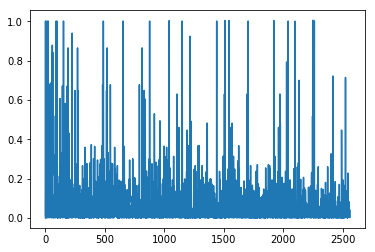

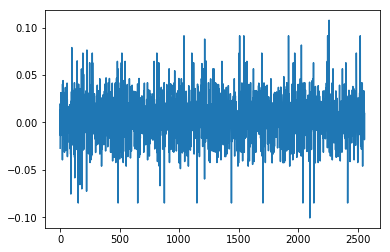

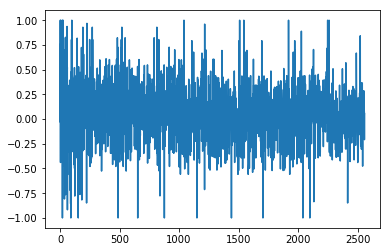

1.09827562371
[ 0.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.66666667  0.66666667
  0.          0.66666667  0.66666667  0.          0.66666667  0.          0.
  0.          0.66666667  0.33333333  0.66666667  0.66666667  0.          0.
  0.          0.          0.          0.          0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.          0.
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.66666667  0.
  0.22222222  0.66666667  0.          0.          0.          0.66666667
  0.66666667  0.66666667]
Writing away results
1975-11-01 00:00:00


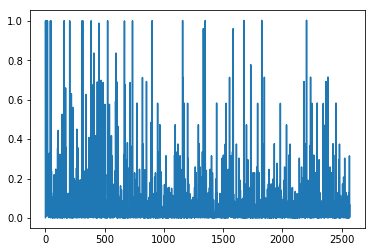

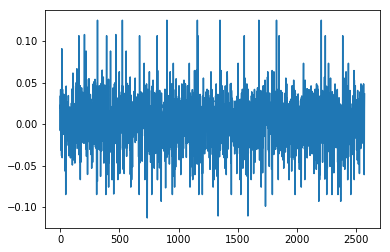

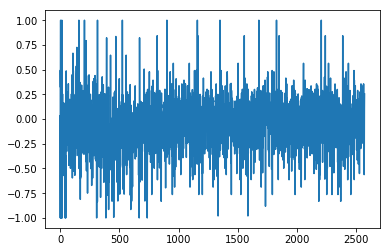

1.16066976783
[ 0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.66666667  0.77777778  0.77777778  0.66666667  0.77777778
  0.66666667  0.66666667  0.11111111  0.66666667  0.44444444  0.77777778
  0.77777778  0.66666667  0.11111111  0.77777778  0.66666667  0.77777778
  0.66666667  0.11111111  0.77777778  1.          0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.66666667  0.11111111  0.77777778  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.66666667  0.11111111  0.11111111  0.66666667  0.77777778  0.66666667
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1975-12-01 00:00:00


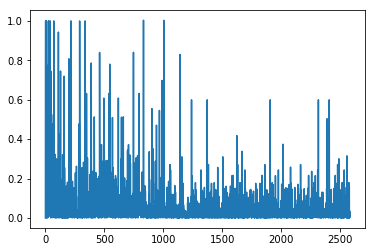

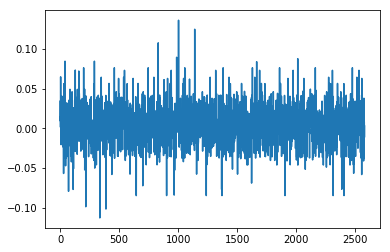

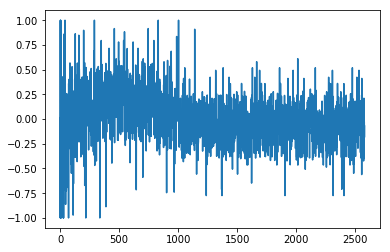

1.25251155495
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.66666667  0.          0.66666667  0.66666667  0.22222222  0.66666667
  0.66666667  0.          0.66666667  0.33333333  0.          0.
  0.66666667  0.          0.66666667  0.66666667  0.11111111  0.55555556
  0.          0.88888889  0.77777778  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.77777778
  0.          0.22222222  0.66666667  0.66666667  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667
  0.          0.22222222  0.66666667  0.11111111  0.66666667  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1976-01-01 00:00:00


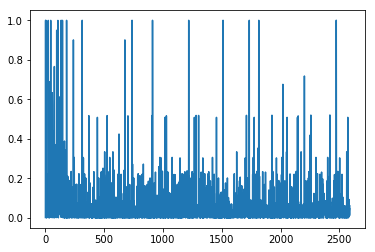

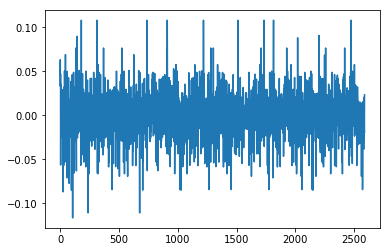

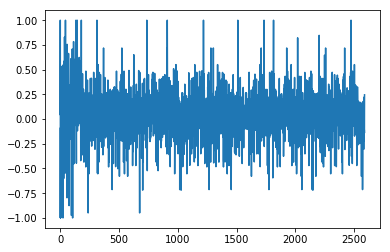

1.18293845274
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.55555556  0.44444444
  0.11111111  0.44444444  0.44444444  0.22222222  0.44444444  0.44444444
  0.11111111  0.44444444  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.55555556  0.44444444  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.55555556  0.66666667  0.66666667
  0.55555556  0.44444444  0.44444444  0.44444444  0.55555556  0.44444444
  0.44444444  0.44444444  0.44444444  0.55555556  0.44444444  0.66666667
  0.55555556  0.44444444  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1976-02-01 00:00:00


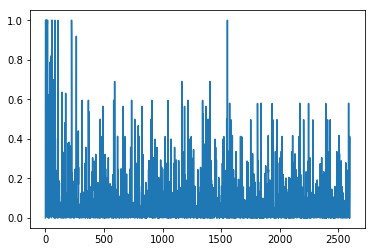

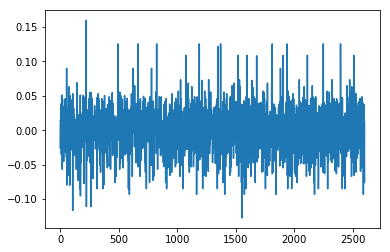

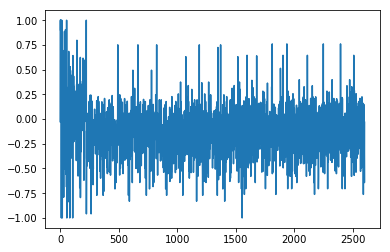

0.997842554527
[ 0.66666667  0.66666667  0.66666667  0.33333333  0.66666667  0.77777778
  0.22222222  0.66666667  0.77777778  0.66666667  0.66666667  0.77777778
  0.66666667  0.77777778  0.77777778  0.77777778  0.66666667  0.77777778
  0.          0.66666667  0.77777778  0.66666667  0.77777778  0.77777778
  0.66666667  0.77777778  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.77777778  0.66666667  0.77777778  0.22222222
  0.33333333  0.66666667  0.66666667  0.22222222  0.66666667  0.11111111
  0.66666667  0.66666667  0.77777778  0.66666667  0.77777778  0.11111111
  0.66666667  0.77777778  0.66666667  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.66666667  0.88888889]
Writing away results
1976-03-01 00:00:00


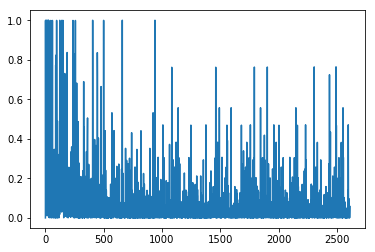

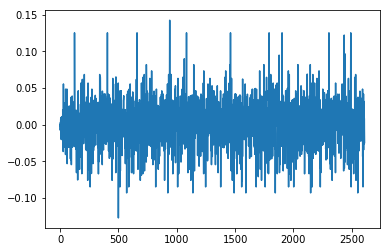

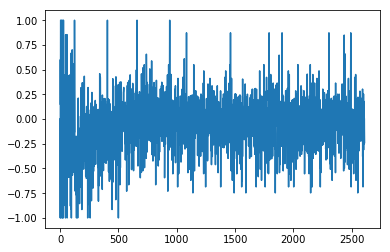

1.02815358493
[ 0.66666667  0.66666667  0.11111111  0.66666667  0.77777778  0.55555556
  0.66666667  0.77777778  0.66666667  0.66666667  0.77777778  0.11111111
  0.66666667  0.77777778  0.77777778  0.66666667  0.77777778  0.11111111
  0.66666667  0.77777778  0.66666667  0.77777778  0.77777778  0.77777778
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.77777778  0.66666667  0.77777778  0.33333333  0.66666667
  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.66666667  0.33333333  0.33333333  0.66666667
  0.77777778  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333]
Writing away results
1976-04-01 00:00:00


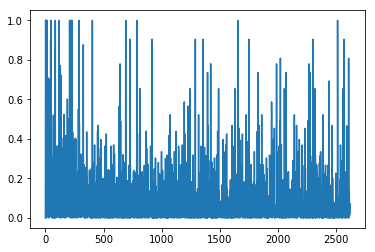

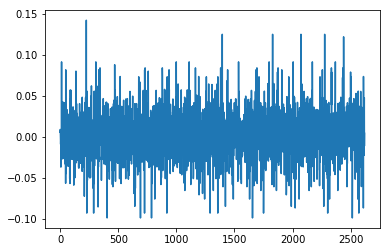

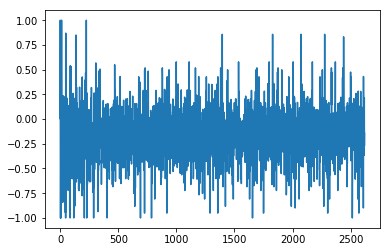

1.07931617467
[ 0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667  0.88888889
  0.77777778  0.77777778  0.66666667  0.22222222  0.66666667  0.66666667
  0.77777778  0.77777778  0.77777778  0.33333333  0.66666667  0.77777778
  0.77777778  0.11111111  0.66666667  0.66666667  0.11111111  0.66666667
  0.66666667  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.44444444  0.77777778  0.77777778  0.77777778  0.88888889  0.33333333
  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.77777778  1.          0.66666667  0.88888889]
Writing away results
1976-05-01 00:00:00


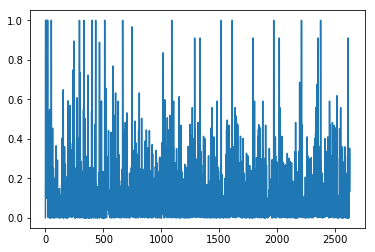

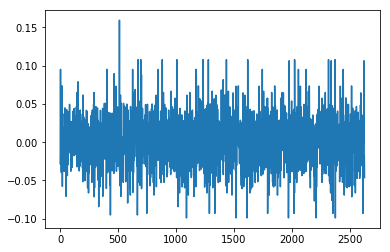

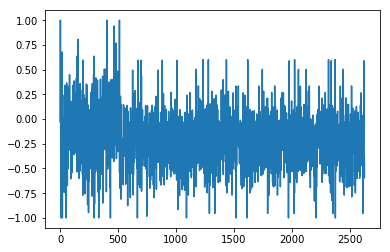

0.993391380392
[ 0.66666667  0.55555556  0.77777778  0.66666667  0.66666667  0.77777778
  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667  0.22222222
  0.22222222  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.66666667  0.66666667  0.55555556  0.77777778
  0.77777778  0.          0.66666667  0.77777778  0.77777778  0.66666667
  0.66666667  0.11111111  0.77777778  0.          0.77777778  0.77777778
  0.22222222  0.66666667  0.77777778  0.77777778  0.77777778  0.66666667
  0.66666667  0.22222222  0.77777778  0.          0.66666667  0.66666667
  0.77777778  0.77777778  0.77777778  0.77777778  0.          0.22222222
  0.77777778  0.77777778  0.66666667  0.66666667  0.11111111]
Writing away results
1976-06-01 00:00:00


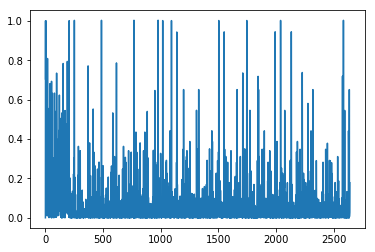

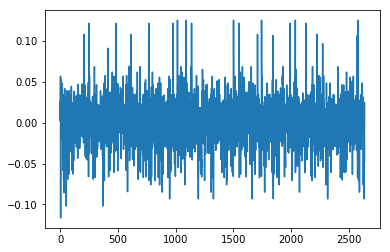

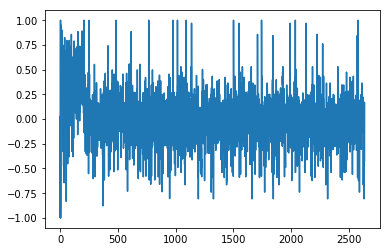

1.09115019138
[ 0.55555556  0.77777778  0.55555556  0.55555556  0.88888889  0.55555556
  0.55555556  0.88888889  0.55555556  0.22222222  0.77777778  0.77777778
  0.55555556  0.88888889  0.88888889  0.55555556  0.77777778  0.77777778
  0.77777778  0.77777778  0.22222222  0.77777778  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.77777778  0.22222222
  0.77777778  0.77777778  0.55555556  0.55555556  0.55555556  0.88888889
  0.55555556  0.55555556  0.55555556  0.55555556  0.77777778  0.55555556
  0.77777778  0.77777778  0.55555556  0.77777778  0.66666667  0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.88888889  0.66666667  0.77777778  0.77777778]
Writing away results
1976-07-01 00:00:00


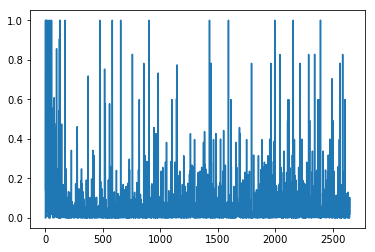

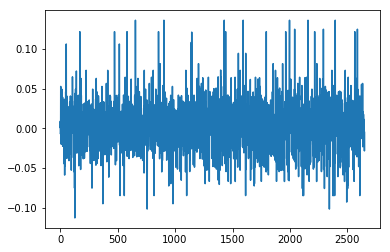

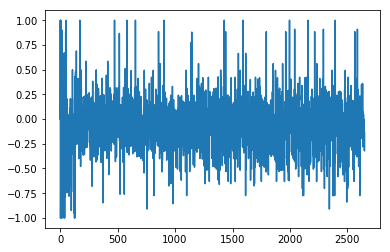

1.05963896377
[ 0.11111111  1.          0.66666667  1.          0.66666667  0.66666667
  1.          1.          0.11111111  0.77777778  0.77777778  0.66666667
  1.          1.          0.66666667  0.77777778  0.88888889  0.11111111
  0.77777778  0.77777778  0.44444444  0.66666667  1.          1.
  0.66666667  0.66666667  1.          0.77777778  0.44444444  0.77777778
  0.88888889  1.          0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  0.11111111
  1.          0.66666667  0.11111111  0.11111111  0.44444444  1.
  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667  1.          1.
  0.          0.55555556  0.77777778  1.        ]
Writing away results
1976-08-01 00:00:00


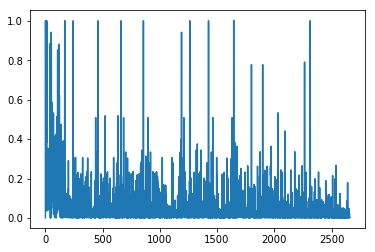

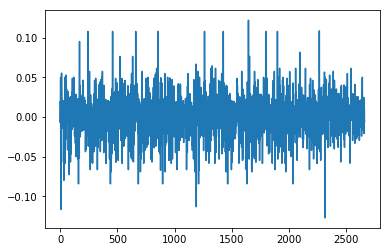

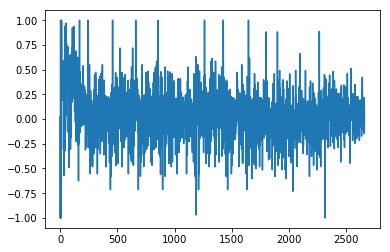

0.92283115273
[ 0.44444444  0.44444444  0.33333333  0.44444444  0.44444444  0.44444444
  0.44444444  0.11111111  0.11111111  0.11111111  0.44444444  0.44444444
  0.44444444  0.44444444  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.11111111  0.11111111  0.11111111  0.11111111
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.11111111  0.66666667  0.11111111  0.44444444
  0.44444444  0.11111111  0.66666667  0.11111111  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.11111111  0.11111111  0.44444444  0.66666667]
Writing away results
1976-09-01 00:00:00


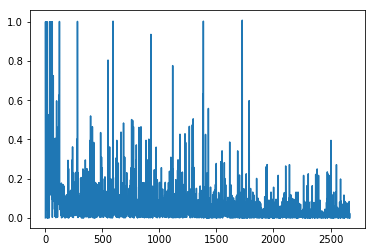

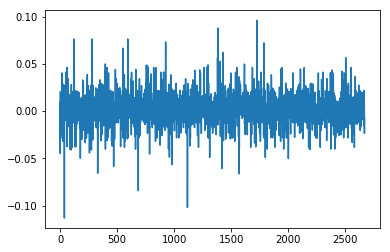

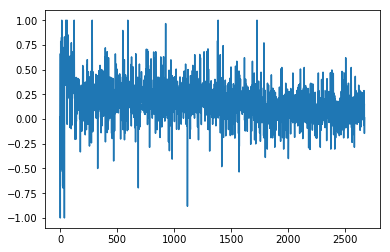

0.799896007633
[ 0.22222222  0.11111111  0.22222222  0.22222222  0.22222222  0.11111111
  0.11111111  0.11111111  0.11111111  0.22222222  0.22222222  0.11111111
  0.22222222  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111
  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.22222222  0.22222222  0.11111111  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.22222222  0.11111111  0.22222222  0.22222222
  0.11111111  0.11111111  0.11111111  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1976-10-01 00:00:00


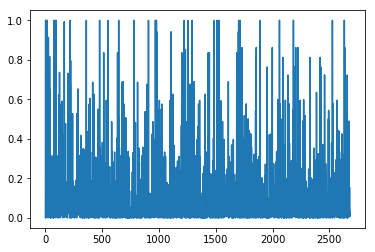

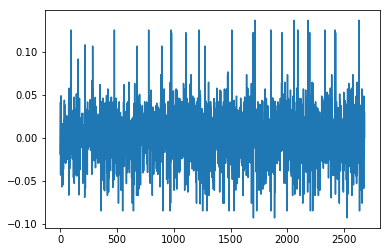

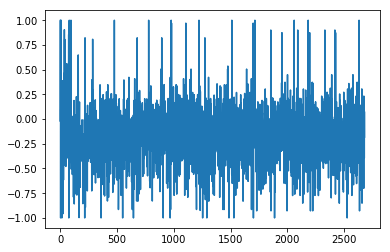

0.922235933597
[ 1.          0.66666667  0.66666667  0.          1.          0.66666667
  0.77777778  0.77777778  0.66666667  0.77777778  1.          0.66666667
  0.77777778  0.66666667  0.11111111  0.77777778  0.66666667  0.11111111
  0.88888889  1.          1.          0.66666667  0.66666667  1.
  0.77777778  0.66666667  0.11111111  0.          0.44444444  0.66666667
  0.66666667  1.          0.66666667  0.11111111  0.66666667  0.22222222
  0.77777778  0.66666667  0.11111111  0.          0.11111111  0.77777778
  0.66666667  0.66666667  1.          0.66666667  0.66666667  0.88888889
  0.11111111  0.11111111  0.77777778  1.          0.66666667  0.66666667
  0.77777778  0.          0.66666667  0.77777778  0.77777778]
Writing away results
1976-11-01 00:00:00


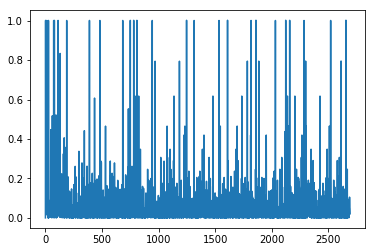

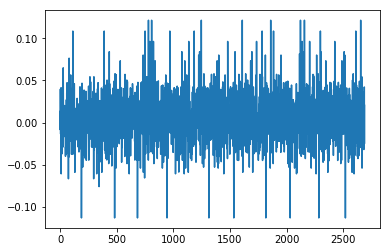

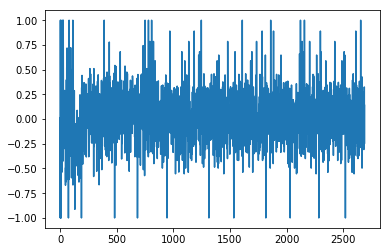

1.05661046782
[ 0.88888889  0.88888889  0.55555556  0.88888889  0.          0.          0.
  0.88888889  0.44444444  0.88888889  0.33333333  0.          0.22222222
  0.44444444  0.          0.          0.44444444  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  0.44444444  1.          0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  1.          0.88888889  0.88888889  0.          0.66666667
  0.44444444  0.88888889  0.88888889  0.          0.22222222  0.44444444
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.44444444  0.44444444  0.          0.88888889
  0.22222222  0.          0.          0.        ]
Writing away results
1976-12-01 00:00:00


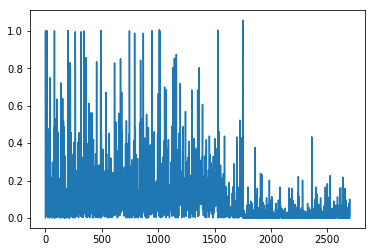

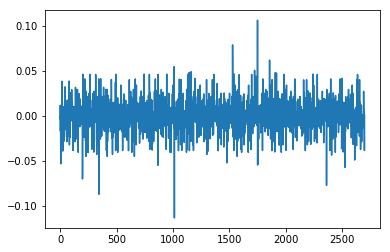

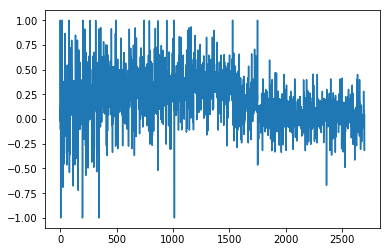

0.827358012592
[ 0.          0.          0.11111111  0.11111111  0.11111111  0.11111111
  0.          0.          0.11111111  0.          0.11111111  0.11111111
  0.          0.11111111  0.11111111  0.11111111  0.          0.          0.
  0.          0.          0.          0.11111111  0.11111111  0.11111111
  0.11111111  0.          0.          0.          0.11111111  0.          0.
  0.          0.          0.11111111  0.22222222  0.11111111  0.          0.
  0.11111111  0.11111111  0.11111111  0.          0.          0.          0.
  0.          0.          0.          0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111]
Writing away results
1977-01-01 00:00:00


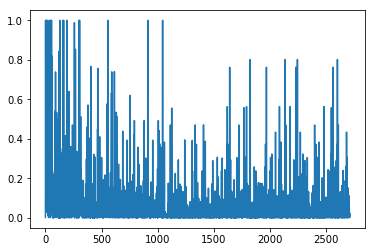

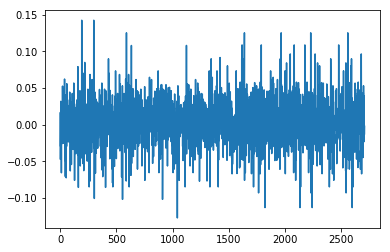

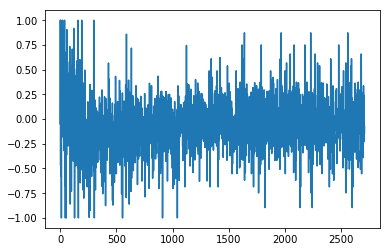

1.09523432375
[ 0.          0.88888889  0.77777778  0.77777778  0.77777778  0.88888889
  0.55555556  0.88888889  0.88888889  0.          0.66666667  0.          0.
  1.          0.          0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.77777778  1.          0.          0.
  0.88888889  0.88888889  0.88888889  0.77777778  0.88888889  0.88888889
  0.88888889  0.88888889  0.          0.66666667  0.55555556  0.
  0.88888889  0.          0.66666667  1.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444
  1.          0.          0.          0.66666667  0.22222222  0.          0.
  0.          0.33333333  0.66666667]
Writing away results
1977-02-01 00:00:00


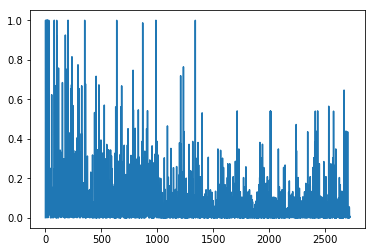

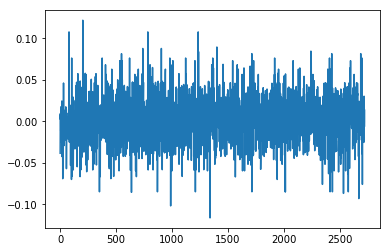

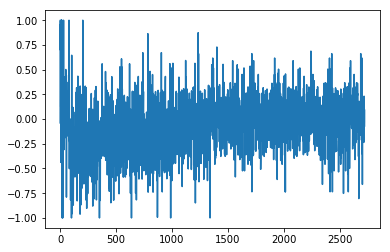

0.989572772095
[ 0.66666667  0.          0.77777778  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.77777778  0.77777778  0.77777778  0.55555556
  0.          0.77777778  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.77777778  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.66666667  0.77777778  0.77777778
  0.66666667  0.22222222  1.          0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.          0.77777778  0.77777778  0.66666667  1.          0.77777778
  0.77777778  0.77777778  0.77777778  0.55555556  0.55555556]
Writing away results
1977-03-01 00:00:00


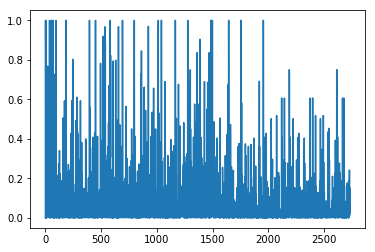

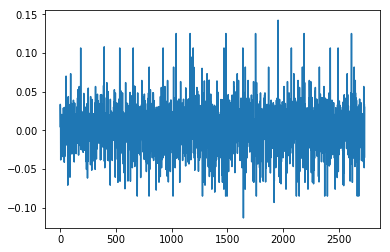

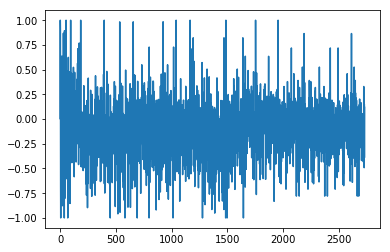

0.906929328185
[ 1.          0.77777778  0.77777778  0.66666667  0.77777778  0.77777778
  0.66666667  0.77777778  0.66666667  0.77777778  0.77777778  0.77777778
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.66666667  0.77777778  0.          0.77777778
  0.66666667  0.66666667  0.77777778  0.66666667  0.11111111  0.66666667
  0.66666667  0.77777778  0.66666667  0.77777778  0.44444444  0.77777778
  0.77777778  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.66666667  1.          0.77777778  0.66666667
  0.          0.77777778  0.44444444  0.77777778  0.77777778  0.77777778
  0.77777778  0.          0.66666667  0.11111111  0.66666667]
Writing away results
1977-04-01 00:00:00


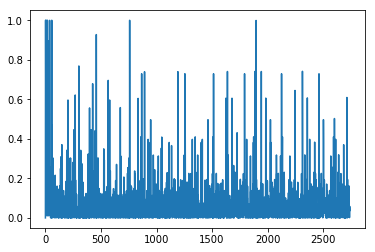

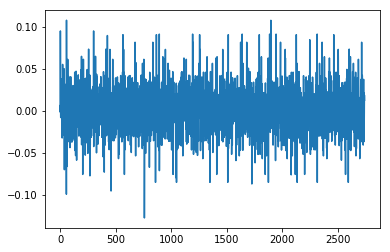

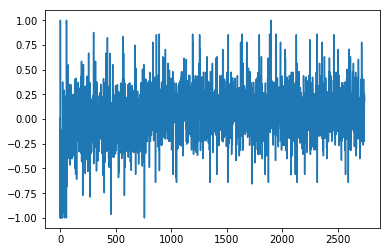

0.933563482337
[ 0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.55555556]
Writing away results
1977-05-01 00:00:00


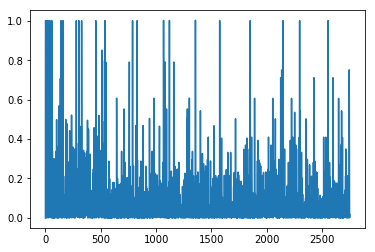

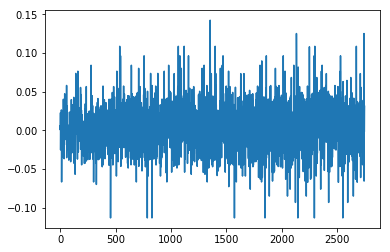

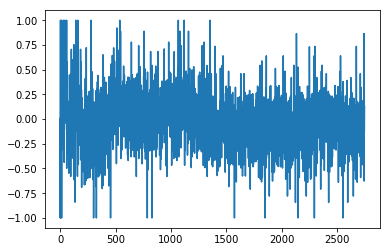

0.965601258048
[ 0.77777778  0.66666667  0.77777778  0.88888889  0.66666667  0.77777778
  0.77777778  0.77777778  0.55555556  0.44444444  0.77777778  0.77777778
  0.66666667  0.88888889  0.66666667  0.66666667  0.88888889  0.11111111
  0.77777778  0.77777778  0.77777778  0.88888889  0.66666667  0.66666667
  0.55555556  0.66666667  0.77777778  0.66666667  0.66666667  0.77777778
  0.66666667  0.77777778  0.55555556  0.66666667  0.77777778  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.55555556  0.77777778  0.77777778  0.77777778
  0.88888889  0.44444444  0.77777778  0.77777778  0.77777778  0.77777778
  0.44444444  0.55555556  0.66666667  0.44444444  0.77777778]
Writing away results
1977-06-01 00:00:00


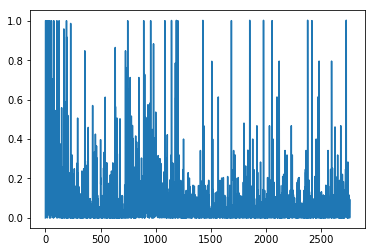

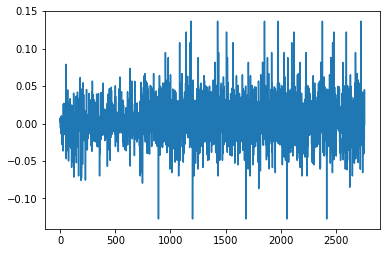

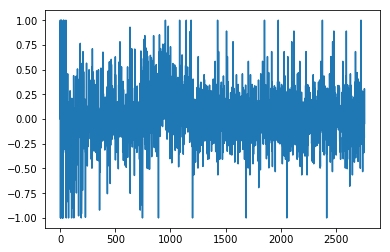

0.93643589241
[ 1.          1.          1.          0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  1.          1.          1.
  1.          1.          1.          0.44444444  0.22222222  0.22222222
  0.22222222  1.          1.          1.          1.          1.          1.
  1.          1.          0.22222222  0.22222222  0.22222222  1.          1.
  0.22222222  0.22222222  0.22222222  1.          1.          1.          1.
  1.          1.          1.          1.          0.22222222  0.22222222
  0.22222222  1.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  1.          1.          0.22222222  0.22222222
  0.22222222]
Writing away results
1977-07-01 00:00:00


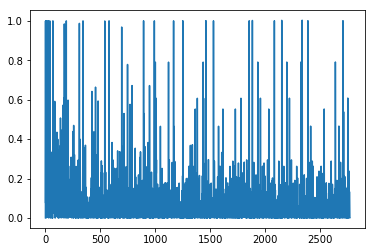

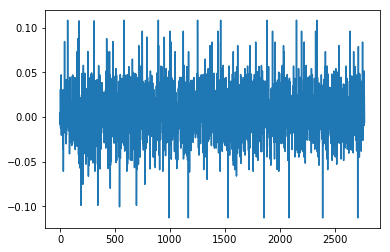

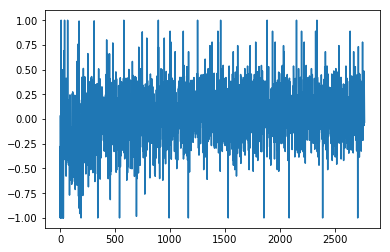

0.834502861591
[ 0.88888889  0.88888889  0.88888889  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.11111111  0.11111111  0.11111111
  0.11111111  0.88888889  0.88888889  0.88888889  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.11111111  0.88888889  0.11111111
  0.22222222  0.88888889  0.11111111  0.11111111  0.11111111  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.22222222  0.11111111  0.11111111  0.11111111  0.88888889  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.88888889  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1977-08-01 00:00:00


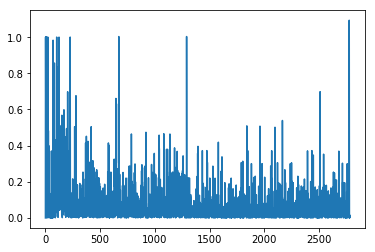

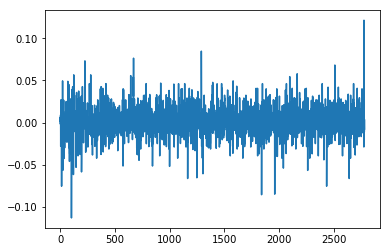

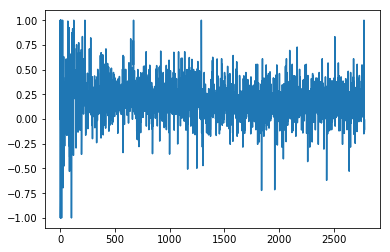

0.829367247597
[ 0.22222222  0.22222222  0.          0.          0.          0.          0.
  0.          0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.          0.          0.          0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.          0.22222222  0.          0.22222222  0.22222222
  0.          0.          0.          0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.          0.
  0.          0.22222222  0.          0.          0.          0.          0.
  0.          0.          0.22222222  0.          0.          0.          0.
  0.        ]
Writing away results
1977-09-01 00:00:00


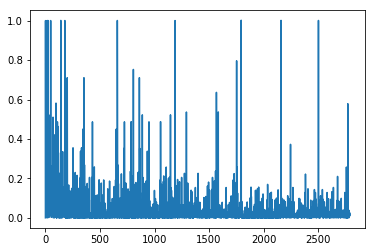

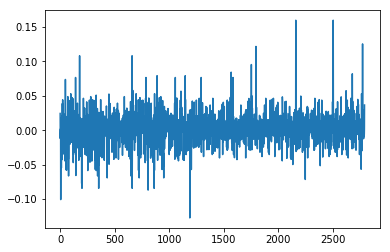

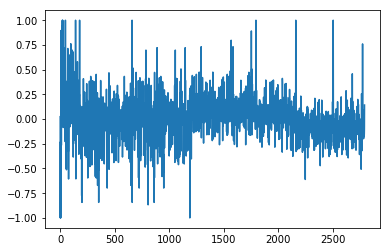

1.05734753836
[ 0.22222222  0.11111111  0.          0.11111111  0.11111111  0.77777778
  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.77777778  0.11111111  0.11111111  0.22222222
  0.22222222  0.22222222  0.55555556  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.88888889  0.11111111  0.44444444  0.22222222
  0.11111111  0.77777778  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.88888889
  0.11111111  0.11111111  0.88888889  0.          0.11111111  0.11111111
  0.11111111  0.          0.66666667  0.22222222  0.22222222  0.11111111
  0.11111111  0.          0.11111111  0.11111111  1.        ]
Writing away results
1977-10-01 00:00:00


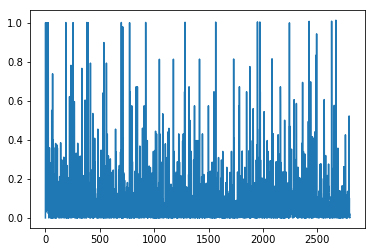

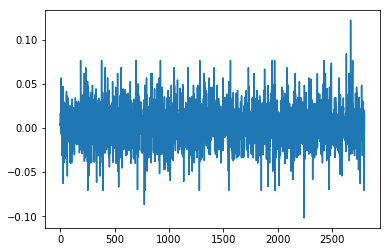

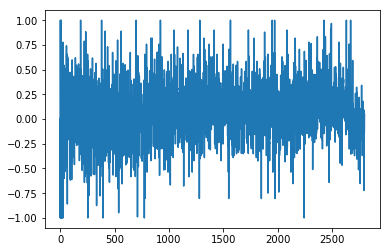

0.978923402345
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.55555556  0.22222222  0.55555556  0.55555556  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556]
Writing away results
1977-11-01 00:00:00


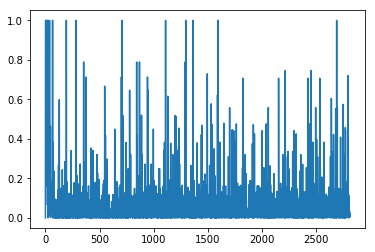

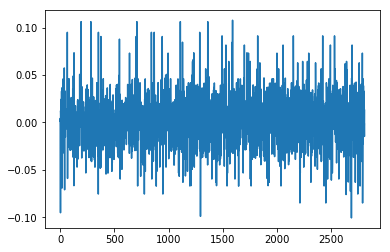

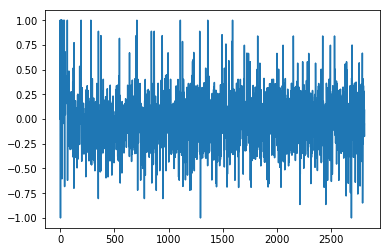

1.12380972025
[ 0.11111111  0.11111111  0.77777778  0.55555556  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.55555556  0.11111111  0.77777778  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.55555556  0.33333333  0.66666667  0.77777778  0.66666667
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  1.
  0.66666667  0.66666667  0.66666667  0.55555556  0.11111111  0.11111111
  0.66666667  0.55555556  0.11111111  0.11111111  0.11111111  0.55555556
  0.22222222  0.66666667  0.66666667  0.55555556  0.11111111  0.11111111
  0.11111111  0.77777778  0.55555556  0.66666667  0.66666667]
Writing away results
1977-12-01 00:00:00


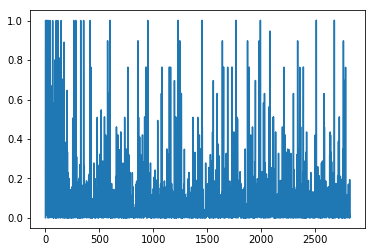

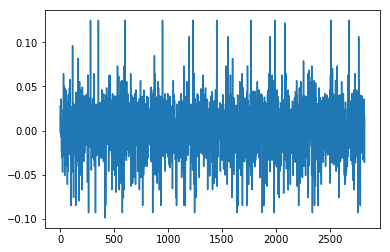

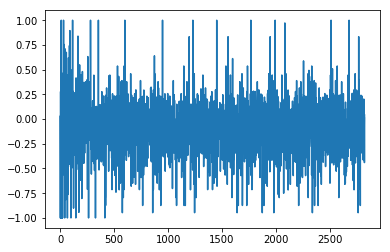

1.13311902143
[ 0.77777778  0.77777778  0.66666667  0.          0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.11111111  0.66666667
  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667  0.77777778
  0.66666667  0.55555556  0.66666667  0.66666667  0.77777778  0.66666667
  0.77777778  0.77777778  0.66666667  0.          0.66666667  0.77777778
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.          0.77777778  0.66666667
  0.66666667  0.77777778  0.          0.77777778  0.77777778  0.55555556
  0.77777778  0.66666667  0.66666667  0.77777778  0.77777778  0.77777778
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1978-01-01 00:00:00


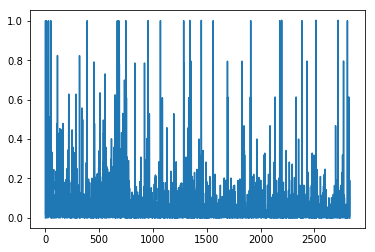

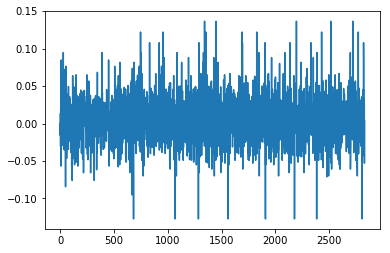

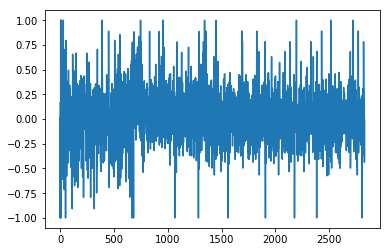

1.201739125
[ 0.          0.          0.          1.          1.          1.          1.
  1.          1.          0.          0.          0.          0.55555556
  1.          1.          1.          1.          1.          1.          1.
  1.          0.          0.66666667  0.          1.          1.
  0.22222222  0.11111111  0.          1.          1.          1.          1.
  1.          1.          1.          1.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.33333333  1.          1.          0.          0.          0.          0.
  0.          0.          1.          1.          1.          1.        ]
Writing away results
1978-02-01 00:00:00


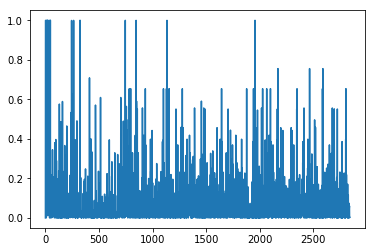

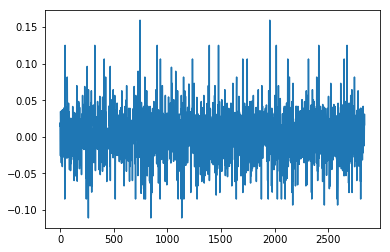

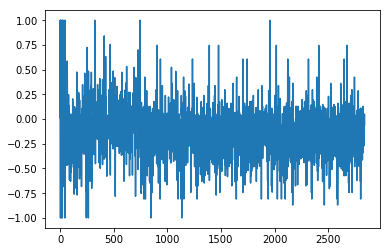

1.17641488648
[ 1.          0.77777778  0.77777778  0.22222222  0.66666667  0.66666667
  0.66666667  0.88888889  0.33333333  0.77777778  0.77777778  0.77777778
  0.66666667  0.88888889  0.66666667  0.77777778  0.66666667  0.22222222
  0.88888889  0.66666667  0.77777778  1.          0.77777778  0.77777778
  0.88888889  0.          0.66666667  0.22222222  0.44444444  0.66666667
  0.66666667  0.          0.88888889  0.88888889  0.66666667  0.77777778
  0.55555556  0.44444444  0.77777778  0.          0.66666667  0.77777778
  0.77777778  0.77777778  0.77777778  0.66666667  0.88888889  0.66666667
  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1978-03-01 00:00:00


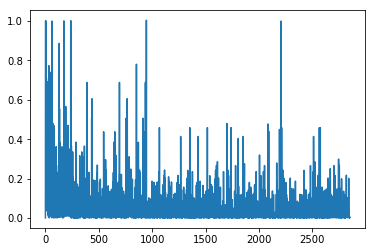

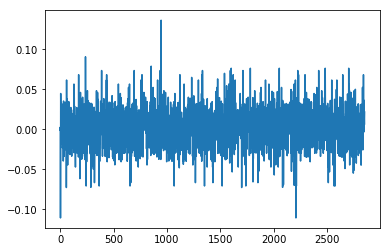

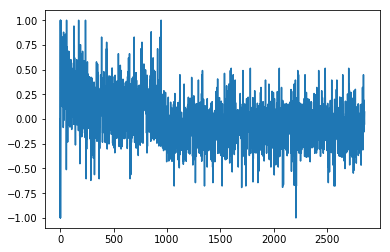

1.29039710586
[ 0.44444444  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  0.          0.44444444  0.77777778  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.11111111  0.44444444  0.66666667  0.77777778  0.55555556
  0.11111111  0.44444444  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.44444444  0.55555556  0.55555556  0.55555556  0.44444444
  0.66666667  0.11111111  0.55555556  0.44444444  0.11111111  0.11111111
  0.11111111  0.44444444  0.66666667  0.55555556  0.55555556  0.44444444
  1.          0.44444444  0.66666667  0.11111111  0.44444444  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1978-04-01 00:00:00


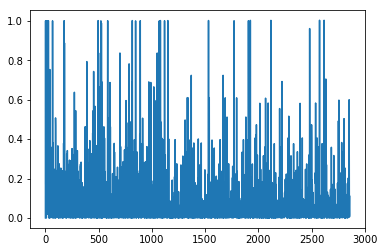

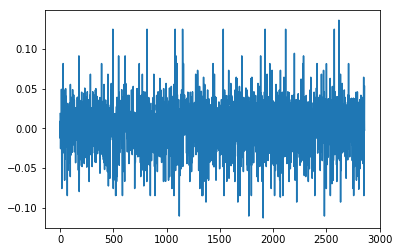

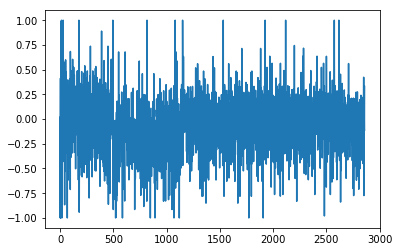

1.27848559668
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.77777778  0.77777778  0.          0.66666667  0.66666667
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.77777778  1.          0.66666667  0.77777778
  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  1.          0.77777778  0.77777778
  0.77777778  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.66666667  0.22222222  0.66666667  0.77777778  0.77777778
  0.77777778  0.22222222  0.77777778  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1978-05-01 00:00:00


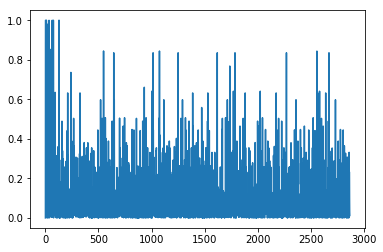

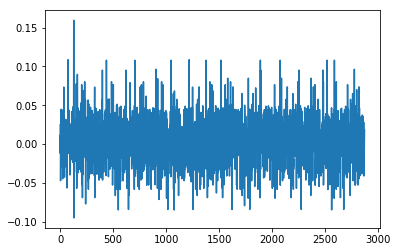

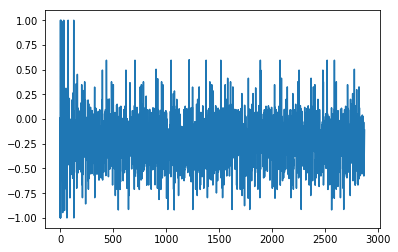

1.3607979372
[ 0.77777778  0.55555556  0.77777778  0.77777778  0.55555556  0.66666667
  0.66666667  0.66666667  0.55555556  0.22222222  0.77777778  0.77777778
  0.66666667  0.77777778  0.77777778  0.77777778  1.          0.66666667
  0.66666667  0.66666667  0.          0.11111111  0.66666667  0.77777778
  0.77777778  0.77777778  0.77777778  1.          1.          0.22222222
  0.          0.66666667  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.55555556  0.88888889  0.66666667  0.66666667  0.77777778
  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1978-06-01 00:00:00


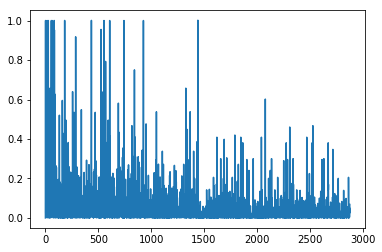

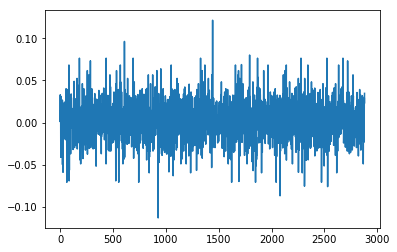

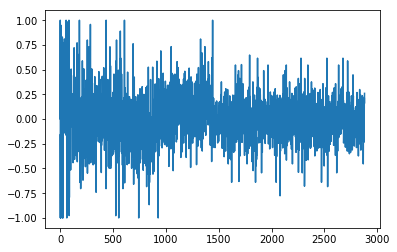

1.17511760415
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.77777778  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.33333333
  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222
  0.33333333  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1978-07-01 00:00:00


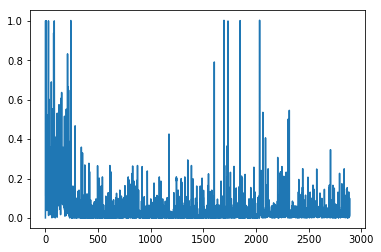

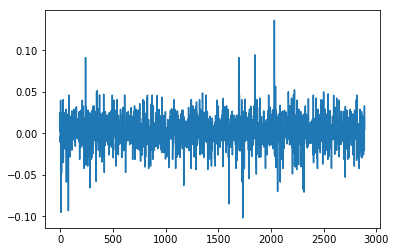

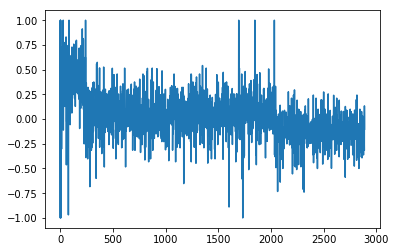

1.02001375562
[ 0.22222222  0.22222222  0.22222222  0.          0.          0.          0.
  0.22222222  0.22222222  0.22222222  0.66666667  0.22222222  0.22222222
  0.22222222  0.22222222  0.          0.          0.          0.
  0.22222222  0.          0.          0.          0.22222222  0.22222222
  0.22222222  0.22222222  0.          0.22222222  0.22222222  0.66666667
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.77777778  0.22222222  0.22222222  0.          0.
  0.          0.          0.          0.          0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222]
Writing away results
1978-08-01 00:00:00


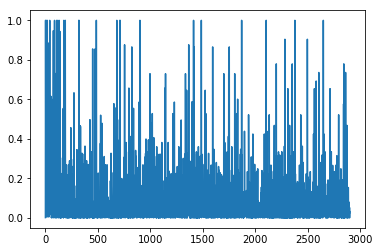

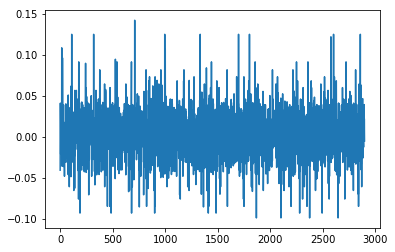

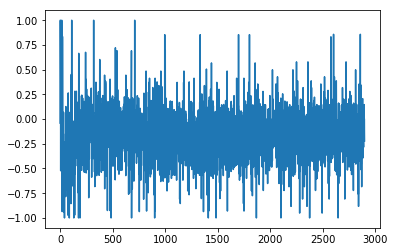

1.37202736135
[ 0.77777778  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778
  0.22222222  0.66666667  0.88888889  0.66666667  0.66666667  0.77777778
  0.66666667  0.11111111  0.22222222  0.66666667  0.77777778  0.22222222
  0.11111111  0.44444444  0.66666667  0.77777778  0.33333333  0.66666667
  0.66666667  0.66666667  0.88888889  0.22222222  0.55555556  0.66666667
  0.22222222  0.77777778  0.77777778  0.66666667  0.88888889  0.22222222
  0.11111111  0.44444444  0.77777778  0.77777778  0.22222222  0.66666667
  0.66666667  0.77777778  0.77777778  0.77777778  0.66666667  0.66666667
  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1978-09-01 00:00:00


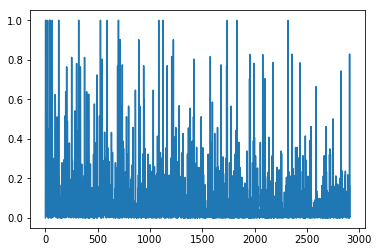

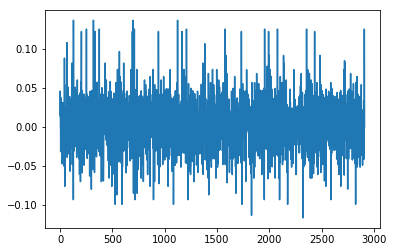

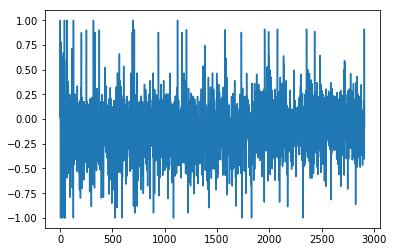

1.26036051843
[ 0.66666667  0.66666667  0.66666667  0.77777778  0.77777778  0.44444444
  0.66666667  0.77777778  0.66666667  0.66666667  0.77777778  0.66666667
  0.11111111  0.11111111  0.66666667  0.77777778  0.77777778  0.11111111
  0.11111111  0.66666667  0.77777778  1.          0.66666667  0.66666667
  0.66666667  0.22222222  0.88888889  0.77777778  0.66666667  0.33333333
  0.77777778  0.77777778  0.66666667  0.11111111  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  1.          0.66666667  0.11111111
  0.77777778  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222]
Writing away results
1978-10-01 00:00:00


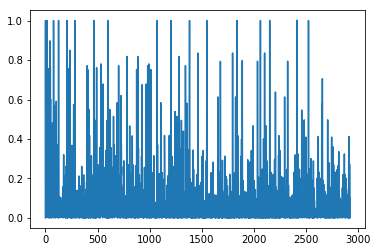

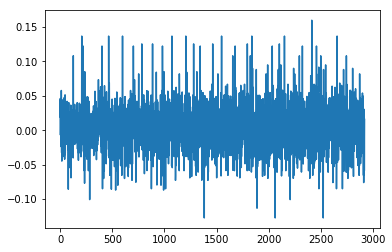

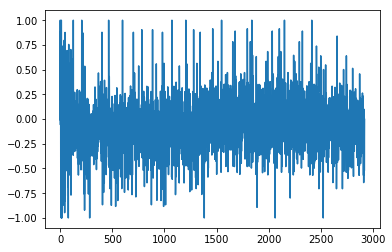

1.53827571587
[ 0.77777778  0.77777778  0.77777778  0.33333333  1.          1.
  0.66666667  1.          1.          0.66666667  1.          1.
  0.77777778  0.77777778  0.77777778  0.          1.          0.77777778
  0.77777778  0.11111111  1.          1.          1.          1.
  0.77777778  1.          1.          1.          0.77777778  0.33333333
  0.33333333  1.          0.22222222  0.          0.77777778  0.77777778
  0.77777778  0.22222222  1.          1.          0.33333333  0.77777778
  0.22222222  0.33333333  0.          0.77777778  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.77777778]
Writing away results
1978-11-01 00:00:00


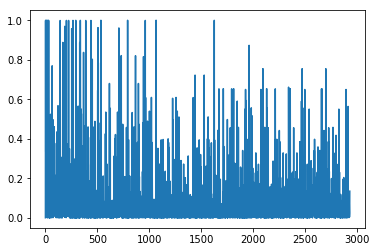

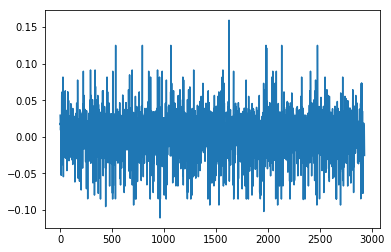

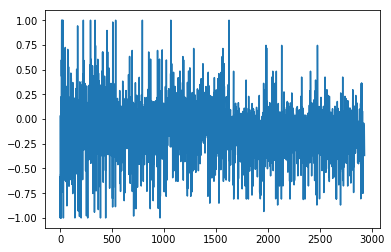

1.32166977277
[ 0.66666667  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.          0.66666667  0.66666667  0.77777778
  0.66666667  0.77777778  0.77777778  0.33333333  0.77777778  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.66666667  0.22222222  0.55555556  0.11111111  0.77777778
  0.11111111  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778
  0.66666667  0.33333333  0.66666667  0.33333333  0.77777778  0.77777778
  0.77777778  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667]
Writing away results
1978-12-01 00:00:00


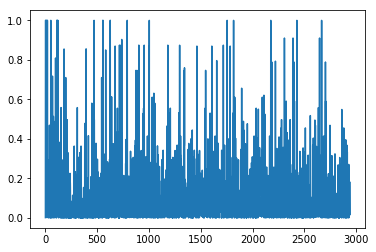

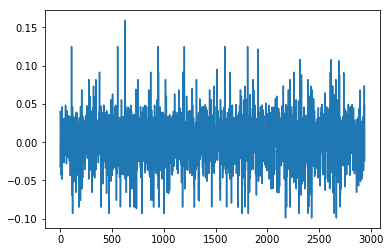

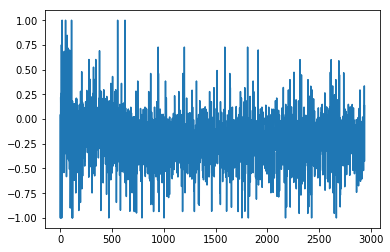

1.30170782926
[ 0.77777778  0.66666667  0.77777778  0.55555556  0.77777778  0.66666667
  0.77777778  0.77777778  0.22222222  0.77777778  0.          0.55555556
  0.77777778  0.22222222  0.77777778  0.66666667  0.66666667  0.77777778
  0.66666667  1.          0.77777778  0.          0.77777778  0.77777778
  0.          0.66666667  0.77777778  0.66666667  0.11111111  0.66666667
  0.77777778  0.77777778  0.          0.44444444  0.66666667  0.66666667
  0.33333333  0.66666667  0.44444444  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  1.          0.66666667  0.66666667  0.77777778
  0.66666667  0.33333333  0.66666667  0.11111111  0.22222222  0.77777778
  0.55555556  0.77777778  0.          0.77777778  0.66666667]
Writing away results
1979-01-01 00:00:00


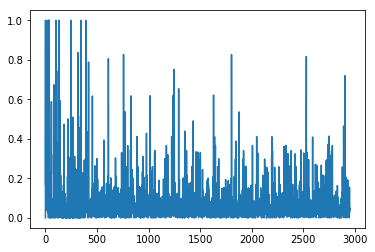

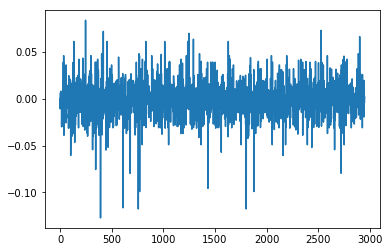

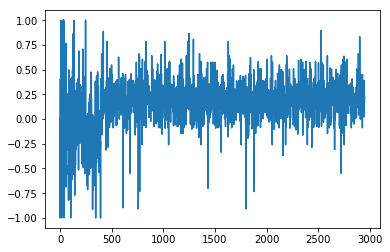

0.976658514871
[ 0.22222222  0.11111111  0.11111111  0.11111111  0.22222222  0.11111111
  0.11111111  0.11111111  0.11111111  0.22222222  0.22222222  0.22222222
  0.11111111  0.11111111  0.22222222  0.22222222  0.22222222  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.22222222  0.22222222  0.22222222  0.22222222  0.11111111  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1979-02-01 00:00:00


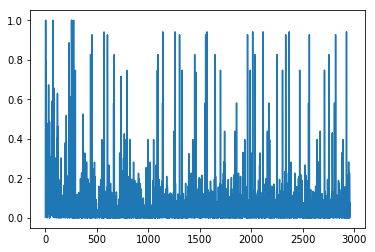

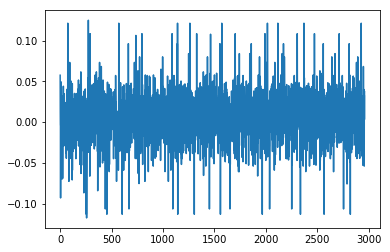

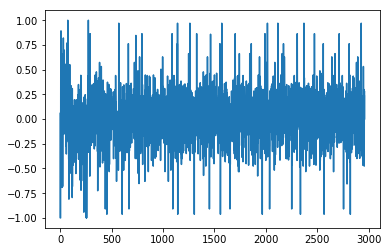

1.45722589769
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333
  0.88888889  0.88888889  0.          0.44444444  0.77777778  1.
  0.88888889  0.          0.77777778  0.77777778  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.44444444  0.          0.88888889  0.          0.          0.
  0.          0.77777778  0.33333333  0.88888889  0.88888889  0.
  0.77777778  0.44444444  0.22222222  0.22222222  0.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.77777778
  0.77777778  0.77777778  0.88888889  0.11111111]
Writing away results
1979-03-01 00:00:00


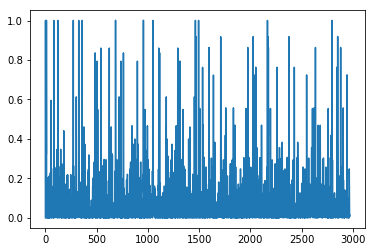

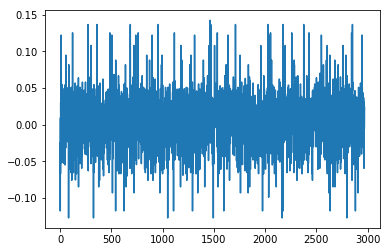

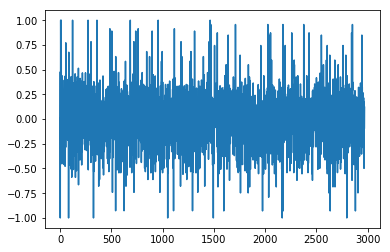

1.20078148687
[ 1.          1.          1.          1.          0.22222222  1.          1.
  0.77777778  1.          0.77777778  0.77777778  1.          0.77777778
  1.          0.55555556  1.          1.          1.          1.          1.
  1.          1.          1.          0.66666667  0.77777778  0.77777778
  1.          0.          0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  1.          0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.88888889  0.66666667  0.77777778  1.          0.77777778
  0.77777778]
Writing away results
1979-04-01 00:00:00


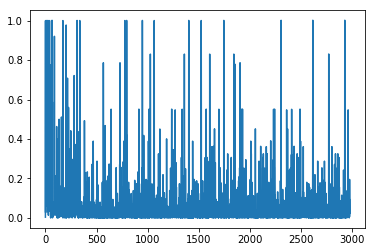

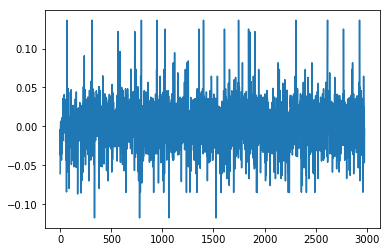

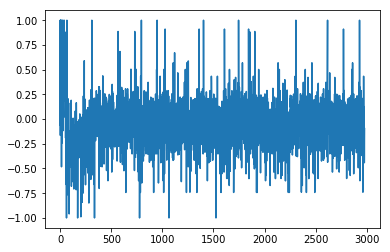

1.09304437333
[ 0.66666667  1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.33333333  0.77777778  0.66666667  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  1.          0.44444444  0.77777778
  0.77777778  1.          0.66666667  0.77777778  0.77777778  0.77777778
  0.          0.66666667  1.          0.66666667  0.33333333  0.77777778
  0.          0.22222222  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.77777778  0.66666667  0.66666667  0.77777778  0.77777778]
Writing away results
1979-05-01 00:00:00


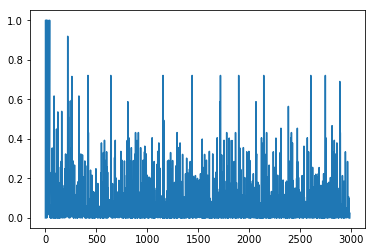

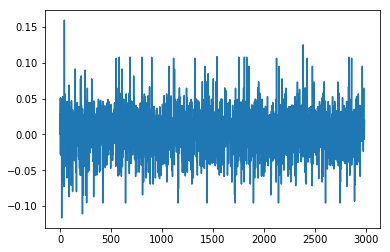

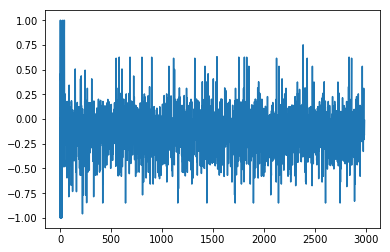

1.15204454403
[ 0.77777778  0.66666667  1.          0.44444444  0.77777778  0.11111111
  0.          0.11111111  0.11111111  0.88888889  0.11111111  0.33333333
  0.33333333  0.66666667  0.66666667  0.88888889  0.11111111  0.11111111
  0.11111111  0.77777778  0.77777778  0.66666667  0.66666667  0.11111111
  0.          0.77777778  0.11111111  0.          0.11111111  0.33333333
  0.33333333  0.44444444  0.66666667  0.66666667  0.11111111  0.66666667
  0.55555556  0.44444444  0.66666667  0.66666667  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.77777778  0.77777778  0.11111111  0.33333333  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1979-06-01 00:00:00


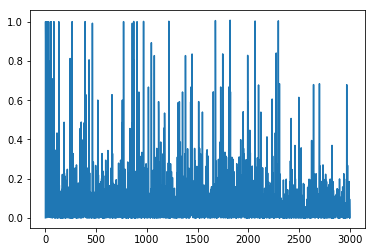

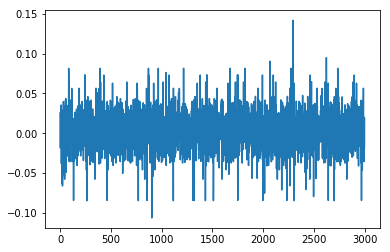

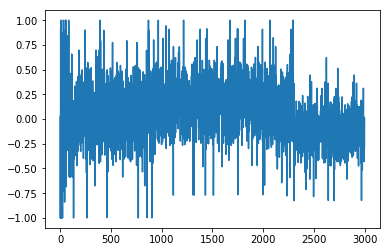

1.09581011439
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667
  0.33333333  0.11111111  0.66666667  0.33333333  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.88888889  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.55555556
  0.11111111  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.66666667  0.33333333  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1979-07-01 00:00:00


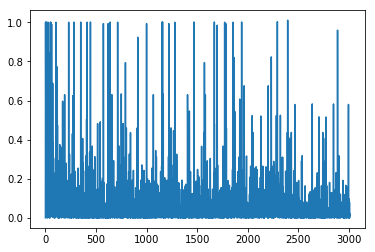

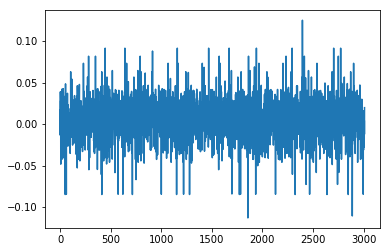

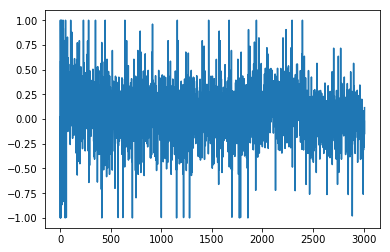

1.10082193356
[ 0.          0.66666667  0.66666667  0.          0.55555556  0.
  0.66666667  0.66666667  0.          0.          0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.          0.66666667  0.          0.
  0.          0.          0.          0.          0.66666667  0.66666667
  0.          0.          0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.          0.66666667  0.          0.          0.
  0.          0.          0.        ]
Writing away results
1979-08-01 00:00:00


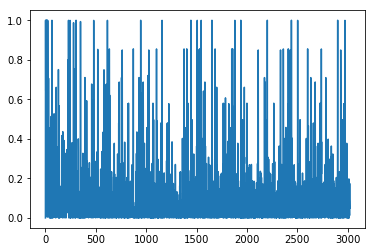

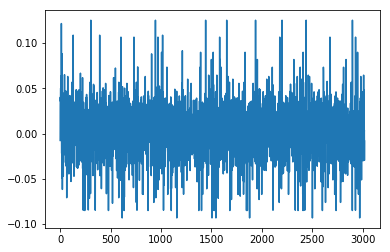

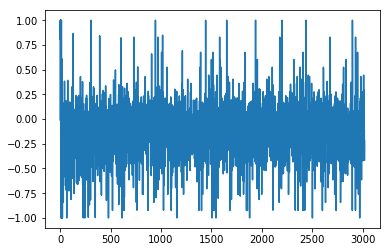

1.10271590215
[ 0.66666667  0.66666667  0.          0.66666667  0.77777778  0.44444444
  0.66666667  0.          0.66666667  0.77777778  0.88888889  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667  0.77777778
  0.          0.77777778  0.77777778  0.77777778  0.77777778  0.66666667
  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.66666667  0.77777778  0.66666667  0.66666667  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.44444444]
Writing away results
1979-09-01 00:00:00


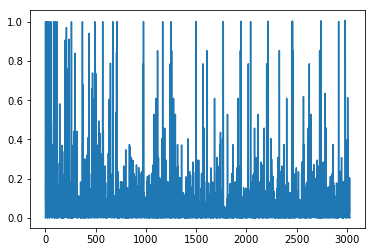

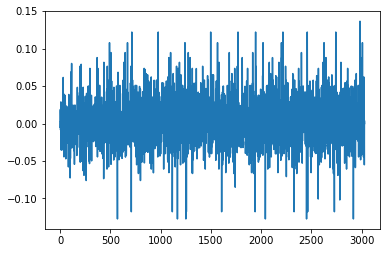

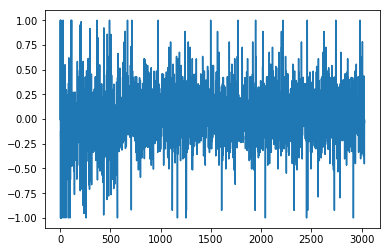

1.2529138337
[ 1.          0.44444444  1.          0.44444444  0.55555556  1.
  0.44444444  0.44444444  0.44444444  1.          1.          1.          1.
  1.          1.          1.          1.          0.44444444  0.44444444
  0.44444444  1.          0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.55555556  1.          0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.44444444  0.44444444  0.44444444  1.
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444]
Writing away results
1979-10-01 00:00:00


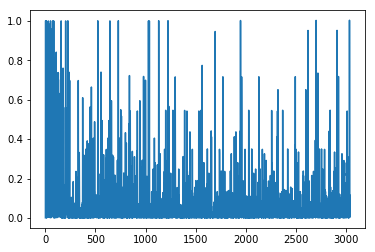

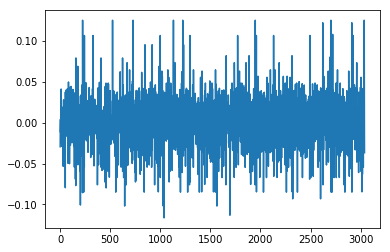

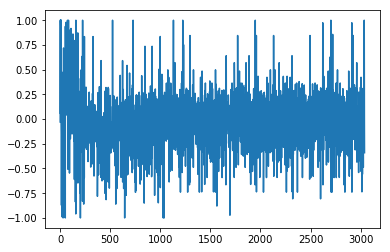

1.16779812039
[ 0.77777778  0.66666667  0.55555556  0.77777778  0.66666667  0.77777778
  0.66666667  1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  0.77777778
  0.77777778  0.22222222  0.          0.77777778  0.77777778  0.77777778
  0.11111111  1.          0.77777778  0.66666667  0.77777778  0.77777778
  0.11111111  0.77777778  0.77777778  0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.77777778  0.66666667  0.44444444  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.66666667]
Writing away results
1979-11-01 00:00:00


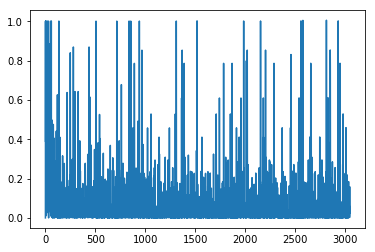

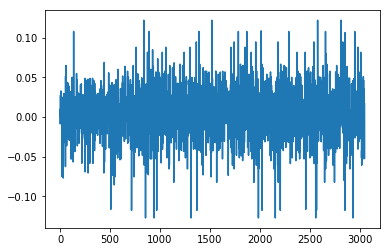

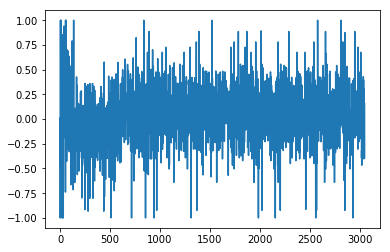

1.33101185442
[ 1.          0.          0.11111111  1.          0.          0.          0.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.          0.55555556  0.          1.
  0.          0.          0.          0.          0.          0.          0.
  0.          1.          1.        ]
Writing away results
1979-12-01 00:00:00


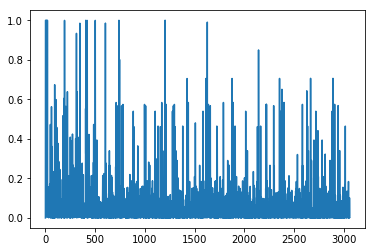

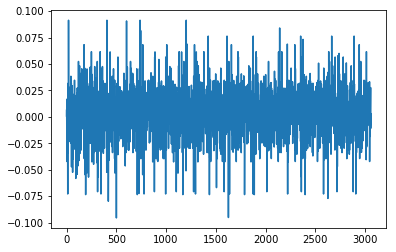

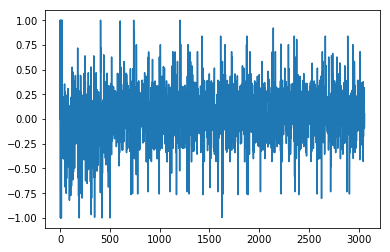

1.1397703318
[ 0.          0.          0.55555556  0.          0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.          0.          0.55555556
  0.          0.          0.          0.          0.          0.
  0.55555556  0.55555556  0.          0.          0.          0.          0.
  0.          0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.          0.          0.55555556  0.          0.
  0.          0.          0.          0.          0.          0.
  0.55555556  0.55555556  0.55555556]
Writing away results
1980-01-01 00:00:00


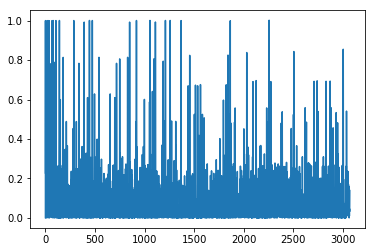

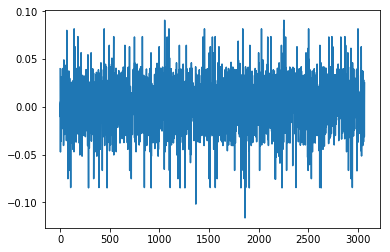

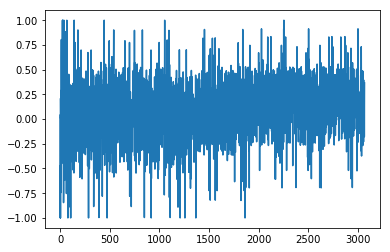

1.16324248185
[ 0.66666667  0.66666667  0.44444444  0.66666667  0.44444444  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.44444444  0.44444444  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.44444444  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1980-02-01 00:00:00


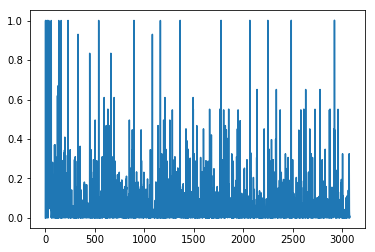

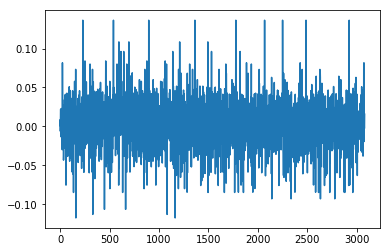

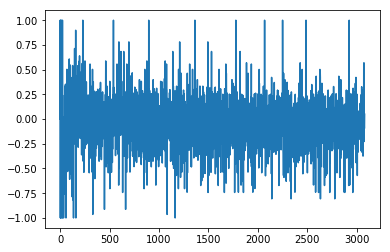

1.15034872719
[ 0.66666667  0.11111111  0.66666667  0.77777778  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667  0.77777778
  0.77777778  0.77777778  0.77777778  0.33333333  1.          0.66666667
  0.11111111  0.77777778  0.77777778  0.33333333  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.77777778  0.66666667  0.66666667  1.
  0.11111111  0.77777778  0.77777778  0.77777778  0.77777778  0.11111111
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1980-03-01 00:00:00


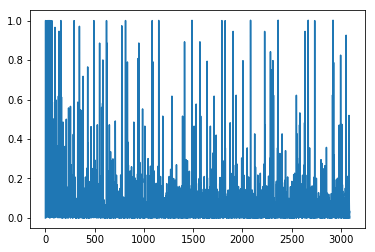

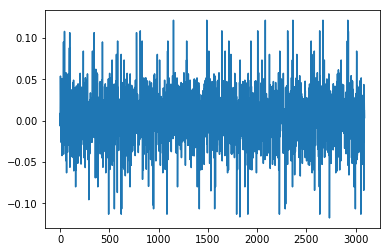

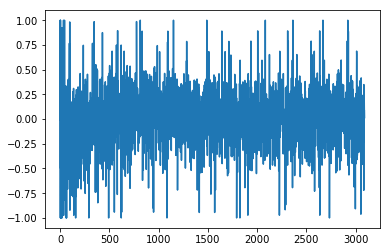

1.58970321461
[ 0.11111111  0.88888889  0.33333333  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.55555556
  0.22222222  0.22222222  0.88888889  0.          0.22222222  0.22222222
  0.22222222  0.11111111  0.77777778  0.88888889  0.88888889  0.
  0.22222222  0.22222222  0.22222222  0.22222222  0.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111
  0.55555556  0.77777778  0.88888889  0.22222222  0.77777778  0.22222222
  0.22222222  0.22222222  0.22222222  0.11111111  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1980-04-01 00:00:00


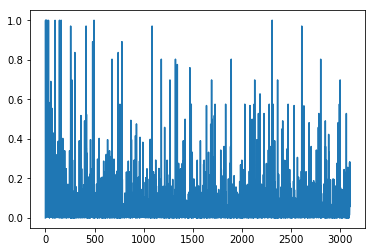

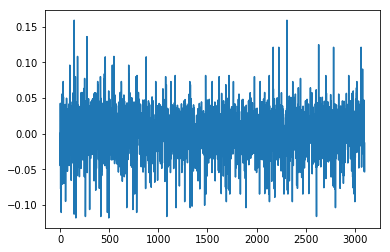

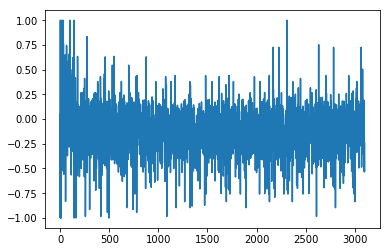

1.19543247817
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.44444444  0.66666667
  0.77777778  0.11111111  0.55555556  0.77777778  0.77777778  0.77777778
  0.66666667  0.66666667  0.88888889  0.66666667  0.55555556  0.33333333
  0.66666667  0.88888889  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778  0.66666667
  0.22222222  0.66666667  0.66666667  0.88888889  0.33333333  0.44444444
  0.44444444  0.77777778  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889]
Writing away results
1980-05-01 00:00:00


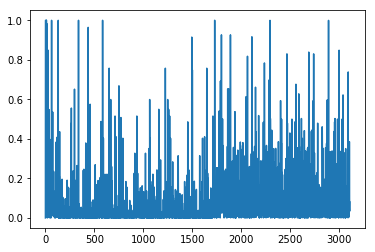

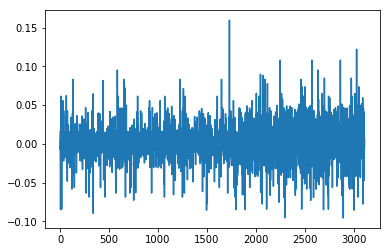

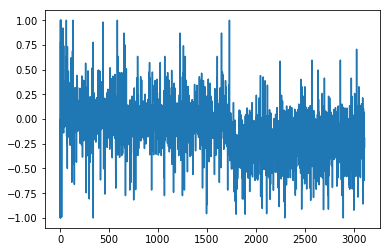

1.25049985577
[ 0.11111111  0.77777778  0.77777778  0.77777778  0.33333333  0.55555556
  0.33333333  0.55555556  0.44444444  0.66666667  0.66666667  0.66666667
  0.22222222  1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.44444444  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.22222222  0.66666667  0.11111111  0.66666667
  0.88888889  1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1980-06-01 00:00:00


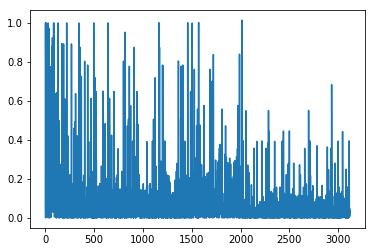

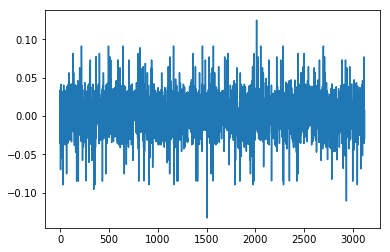

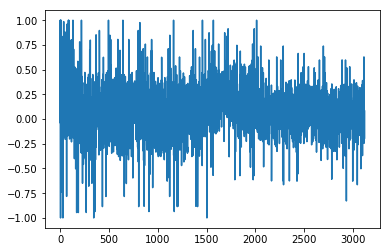

1.30150507614
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1980-07-01 00:00:00


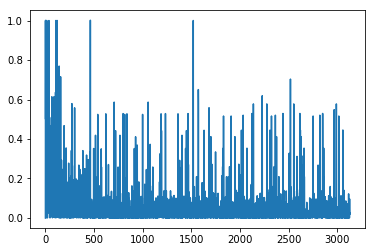

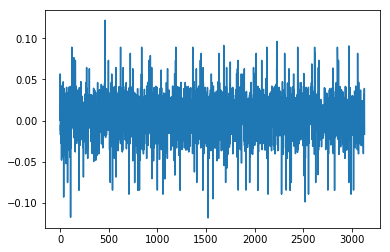

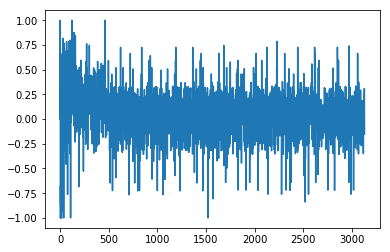

1.30012923578
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.11111111  0.11111111  0.66666667  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.77777778  0.11111111
  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.66666667  0.11111111  0.66666667  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1980-08-01 00:00:00


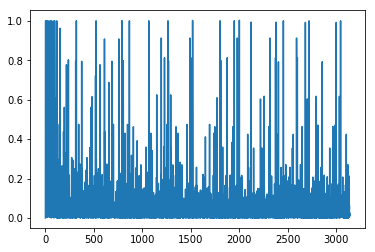

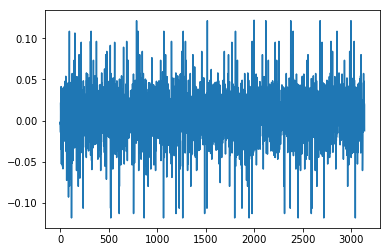

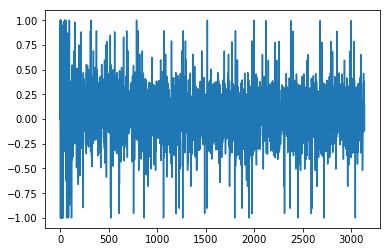

1.38784551652
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.          0.          0.88888889  0.          0.          0.
  0.          0.          0.          0.88888889  0.88888889  0.          0.
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  0.88888889  0.          0.          0.          0.          0.          0.
  0.          0.          0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889]
Writing away results
1980-09-01 00:00:00


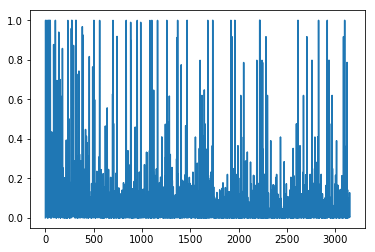

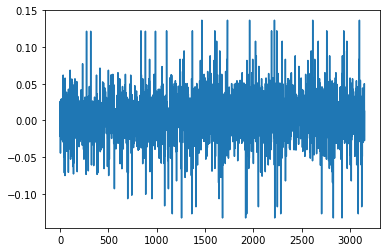

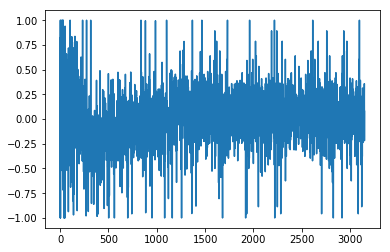

1.24189267105
[ 1.          0.22222222  1.          1.          1.          0.22222222
  0.22222222  0.22222222  1.          0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.77777778  1.          1.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.22222222  0.22222222  0.22222222
  1.          0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.        ]
Writing away results
1980-10-01 00:00:00


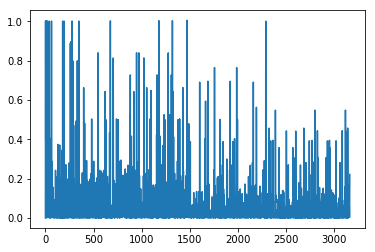

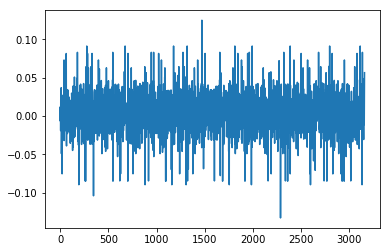

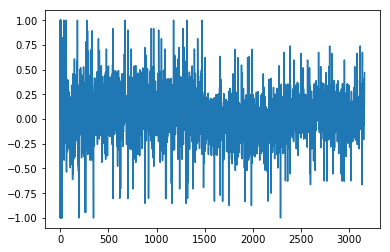

1.23320799017
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1980-11-01 00:00:00


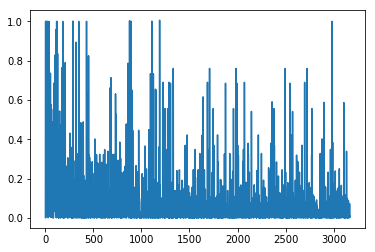

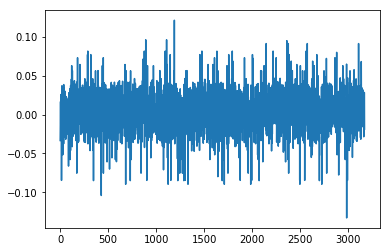

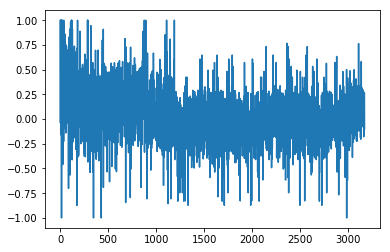

1.13960420212
[ 0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.11111111  1.          0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667  0.33333333
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333]
Writing away results
1980-12-01 00:00:00


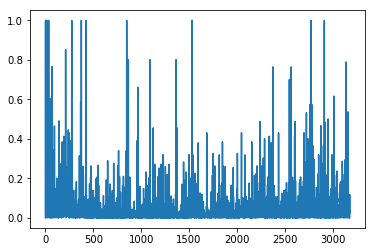

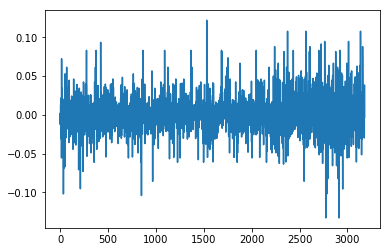

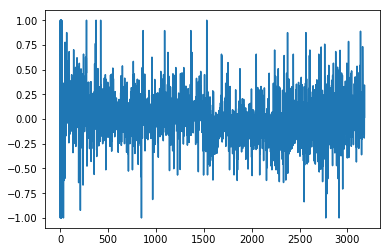

1.28338385906
[ 1.          0.44444444  0.22222222  0.22222222  0.22222222  0.44444444
  1.          0.22222222  0.22222222  0.22222222  0.22222222  0.55555556
  0.44444444  1.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.22222222  1.          0.22222222  1.          1.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.22222222  1.        ]
Writing away results
1981-01-01 00:00:00


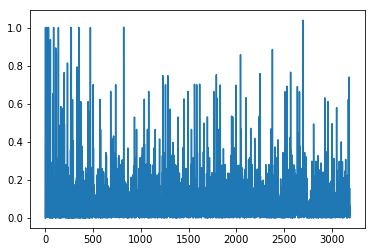

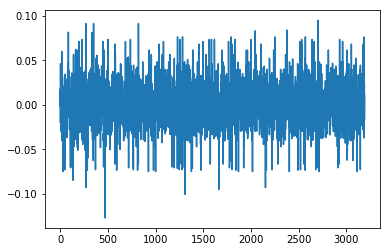

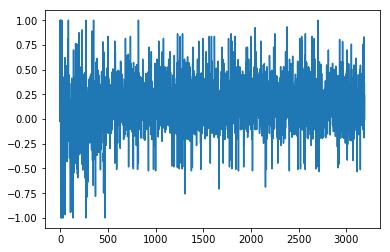

1.29380409853
[ 0.55555556  0.44444444  0.44444444  0.44444444  0.55555556  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.55555556
  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.44444444  0.44444444  0.44444444  0.55555556  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.44444444  0.44444444  0.55555556]
Writing away results
1981-02-01 00:00:00


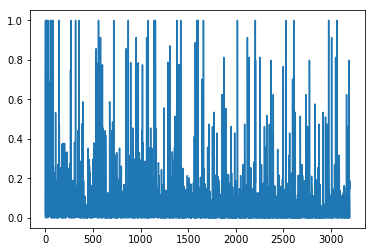

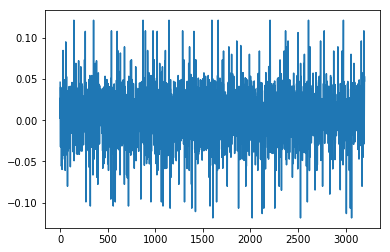

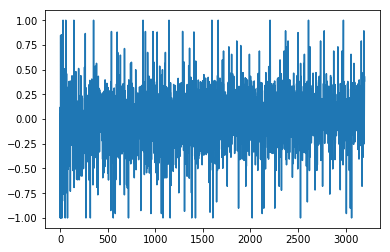

1.44601267929
[ 0.11111111  0.11111111  0.11111111  0.88888889  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.22222222  0.88888889  0.88888889
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  0.11111111  0.11111111  0.88888889  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.11111111  0.88888889  0.88888889  0.88888889]
Writing away results
1981-03-01 00:00:00


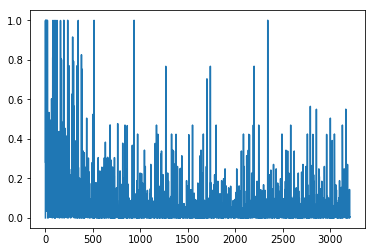

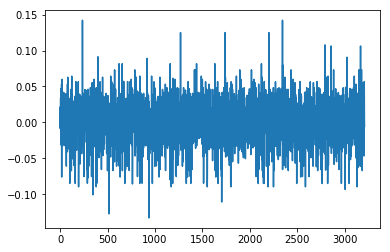

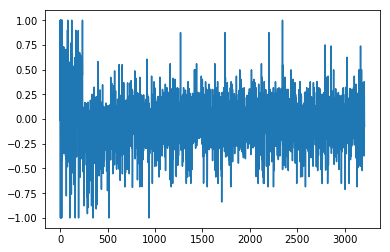

1.33955470302
[ 0.77777778  0.77777778  0.66666667  0.66666667  0.77777778  0.77777778
  0.77777778  0.55555556  0.          0.          0.66666667  0.77777778
  0.77777778  0.55555556  0.77777778  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.66666667  0.77777778  0.66666667  0.66666667  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.55555556  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1981-04-01 00:00:00


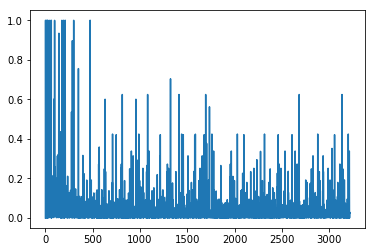

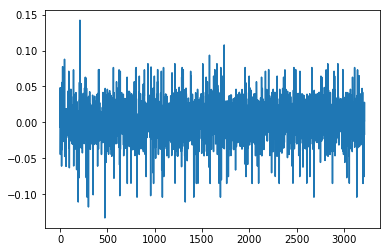

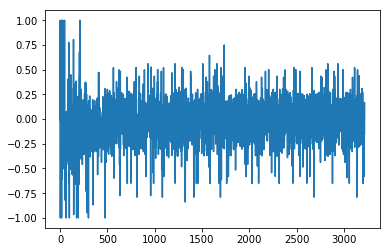

1.53474311258
[ 0.44444444  0.66666667  0.44444444  0.11111111  0.44444444  0.44444444
  0.33333333  0.33333333  0.55555556  0.66666667  0.44444444  0.44444444
  0.33333333  0.          0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.44444444  0.66666667  0.          0.55555556  0.44444444  0.33333333
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1981-05-01 00:00:00


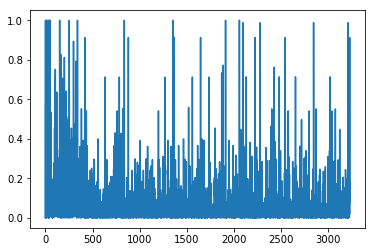

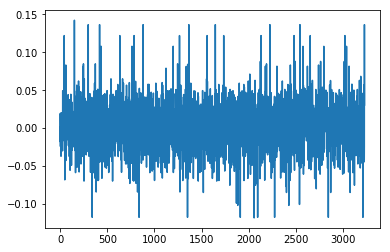

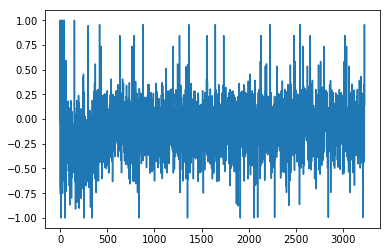

1.46911179732
[ 1.          0.88888889  0.11111111  0.11111111  0.88888889  0.77777778
  0.77777778  1.          1.          0.66666667  0.          0.77777778
  0.11111111  1.          0.66666667  0.77777778  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.22222222  0.22222222  0.77777778  0.44444444  1.          0.66666667
  1.          0.44444444  0.11111111  0.11111111  0.11111111  0.77777778
  0.22222222  0.77777778  0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.66666667  1.          0.77777778  1.          1.          1.          1.        ]
Writing away results
1981-06-01 00:00:00


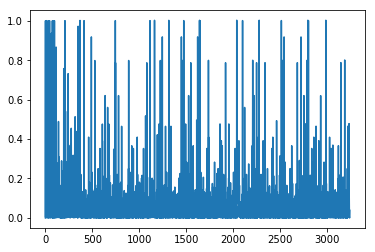

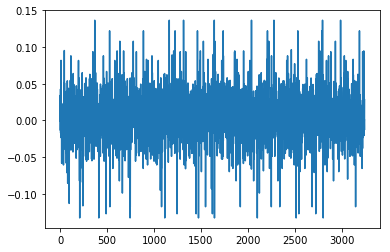

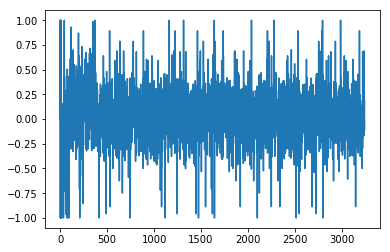

1.71663255377
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.11111111  0.22222222  0.22222222  1.          0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.22222222  1.          1.          1.          1.          1.          1.
  1.        ]
Writing away results
1981-07-01 00:00:00


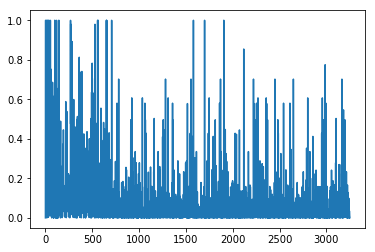

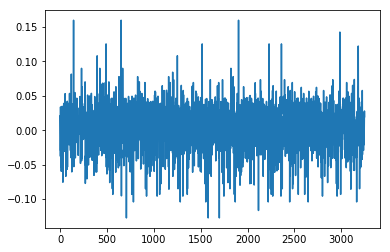

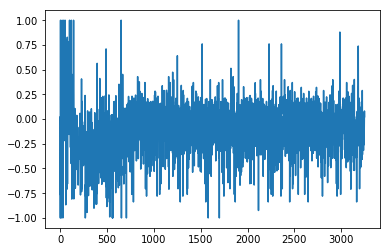

1.63423549762
[ 0.77777778  0.77777778  0.77777778  0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.88888889  0.66666667  0.77777778  0.
  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.66666667  0.11111111  0.66666667  0.77777778  0.66666667  0.66666667
  0.77777778  0.66666667  0.88888889  0.77777778  0.77777778  0.66666667
  0.88888889  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1981-08-01 00:00:00


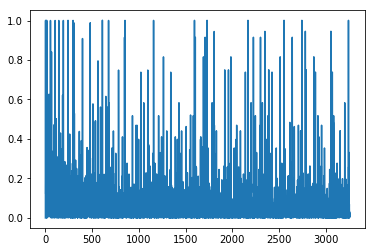

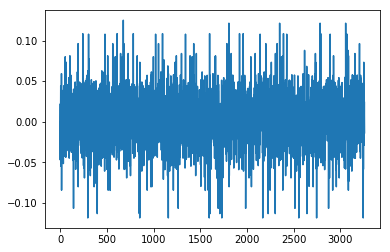

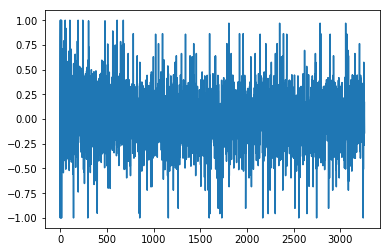

1.63397422296
[ 0.66666667  0.66666667  0.66666667  0.33333333  0.44444444  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1981-09-01 00:00:00


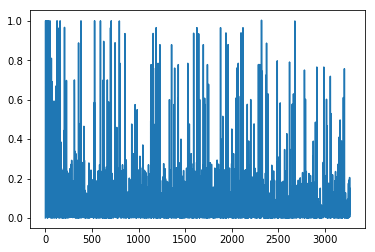

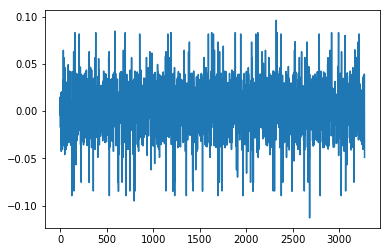

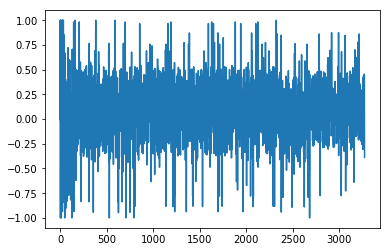

1.73612141716
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.66666667  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.66666667  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222]
Writing away results
1981-10-01 00:00:00


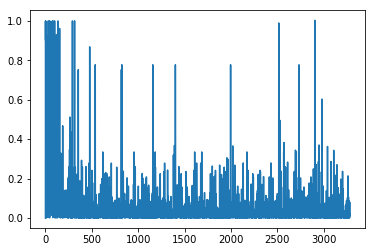

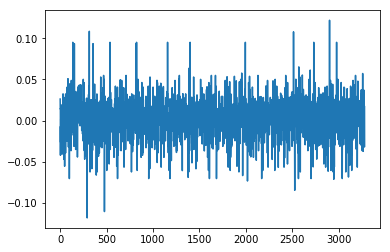

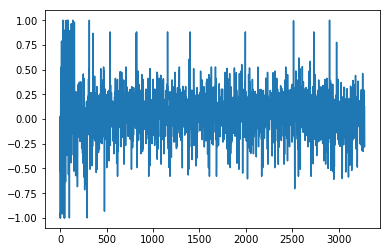

1.53884256686
[ 0.          0.55555556  0.          0.44444444  0.          0.          0.
  0.          0.          0.          0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.44444444  0.
  0.44444444  0.          0.          0.          0.          0.          0.
  0.          0.          0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.          0.44444444]
Writing away results
1981-11-01 00:00:00


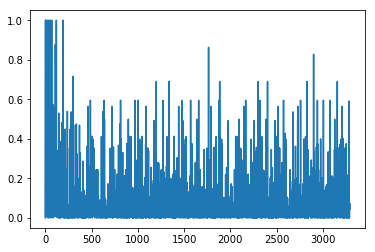

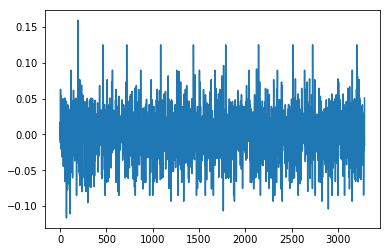

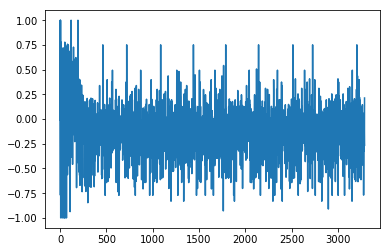

1.59794786271
[ 0.66666667  0.11111111  0.66666667  0.66666667  0.77777778  1.
  0.55555556  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.77777778
  0.66666667  0.66666667  0.55555556  1.          0.44444444  0.77777778
  0.77777778  1.          0.77777778  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.66666667  0.88888889]
Writing away results
1981-12-01 00:00:00


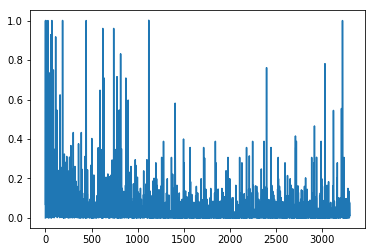

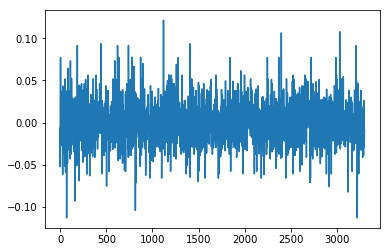

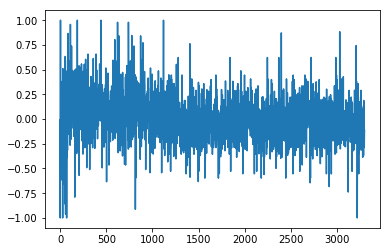

1.52984452069
[ 0.22222222  0.22222222  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.33333333  0.33333333  0.33333333  0.22222222
  0.77777778  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333  0.66666667  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.33333333  0.66666667]
Writing away results
1982-01-01 00:00:00


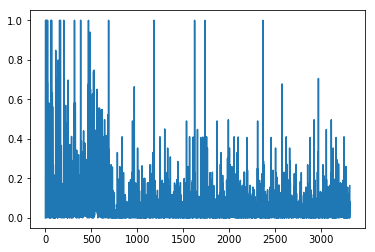

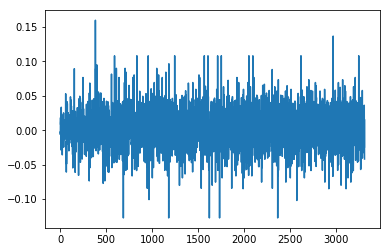

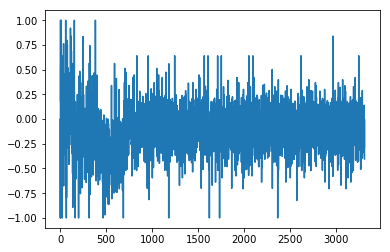

1.46603006256
[ 0.66666667  0.66666667  0.          0.77777778  0.55555556  0.55555556
  0.66666667  0.77777778  0.11111111  0.77777778  0.88888889  0.55555556
  0.88888889  0.88888889  0.55555556  0.77777778  0.55555556  0.77777778
  0.66666667  0.77777778  0.66666667  0.55555556  0.44444444  0.66666667
  0.55555556  0.66666667  0.11111111  0.66666667  0.55555556  0.77777778
  0.66666667  0.77777778  0.66666667  0.55555556  0.66666667  0.11111111
  0.77777778  0.55555556  0.33333333  0.66666667  0.44444444  0.55555556
  0.11111111  0.66666667  0.66666667  0.77777778  0.77777778  0.77777778
  0.55555556  0.44444444  0.88888889  0.55555556  0.44444444  0.66666667
  0.66666667  1.          0.66666667  0.77777778  0.66666667]
Writing away results
1982-02-01 00:00:00


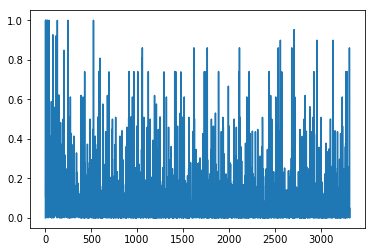

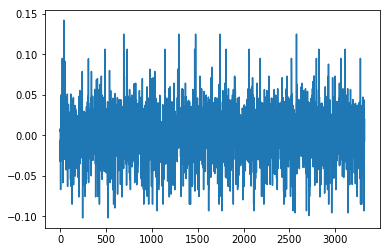

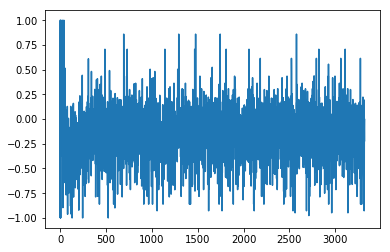

1.76918600016
[ 0.66666667  0.77777778  0.77777778  0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.66666667  0.77777778  0.66666667  0.66666667  0.77777778
  0.33333333  0.77777778  0.77777778  0.77777778  0.          0.33333333
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.33333333  0.66666667  0.66666667  0.77777778]
Writing away results
1982-03-01 00:00:00


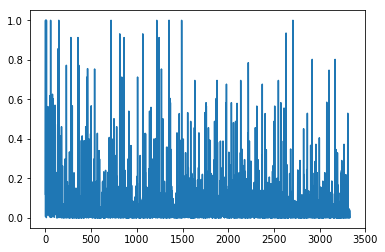

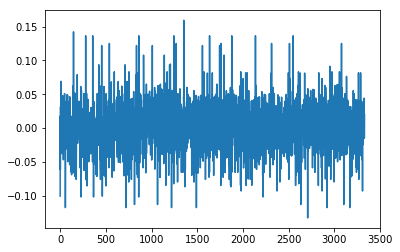

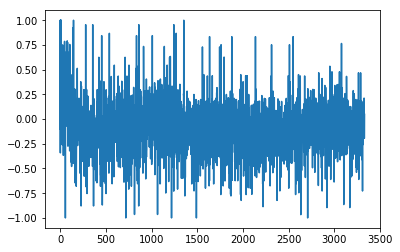

1.92338373908
[ 0.77777778  0.77777778  0.33333333  0.          0.77777778  1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.77777778  0.77777778  0.66666667  0.          0.55555556  0.          0.
  0.77777778  0.22222222  0.77777778  0.77777778  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.
  0.55555556  0.66666667  0.55555556  0.66666667]
Writing away results
1982-04-01 00:00:00


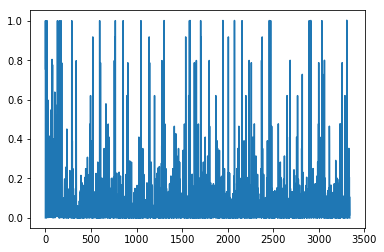

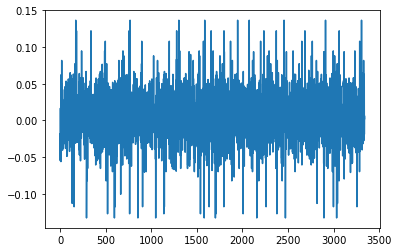

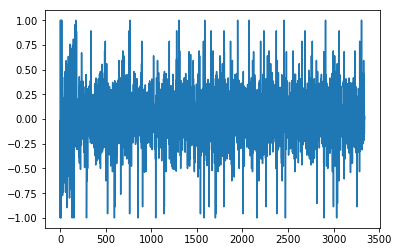

2.02464221096
[ 0.33333333  0.33333333  0.33333333  0.33333333  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.33333333  0.33333333  0.33333333  1.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.33333333  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.33333333  1.          0.33333333  0.33333333  1.          1.        ]
Writing away results
1982-05-01 00:00:00


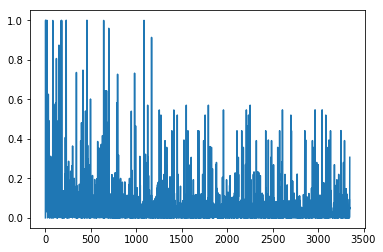

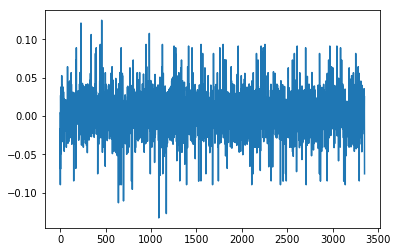

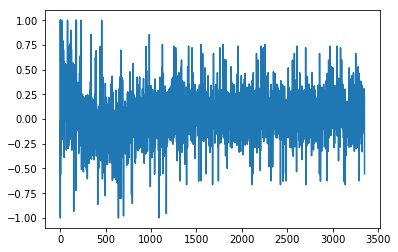

1.73629021495
[ 0.11111111  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111
  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667
  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667]
Writing away results
1982-06-01 00:00:00


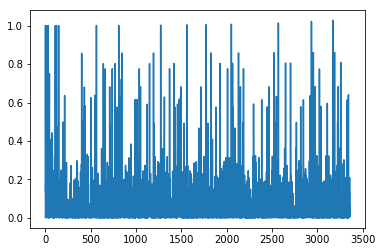

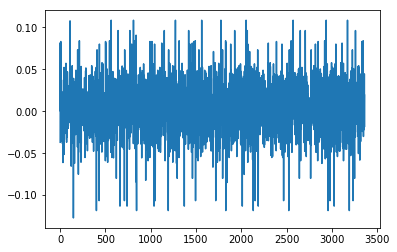

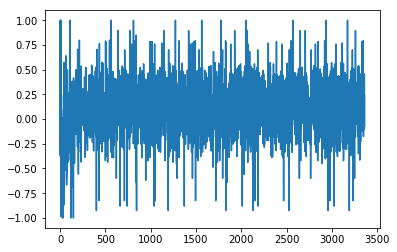

1.83705424025
[ 0.22222222  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.22222222  0.88888889  0.22222222  0.88888889
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.88888889  0.22222222  0.88888889  0.88888889
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1982-07-01 00:00:00


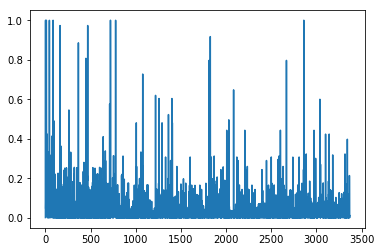

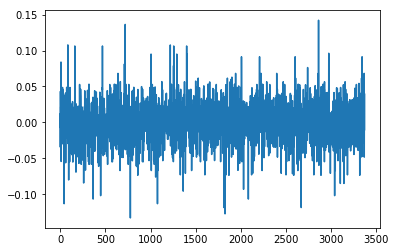

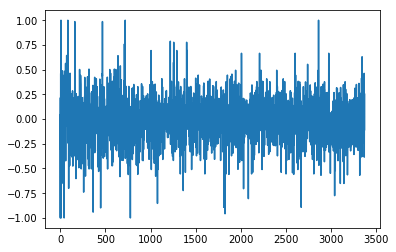

1.83541815329
[ 0.11111111  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.11111111  0.11111111  0.77777778  0.55555556  0.88888889
  0.77777778  0.11111111  0.44444444  0.44444444  0.11111111  0.11111111
  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.77777778  0.55555556  0.77777778  0.55555556  0.55555556  0.77777778
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1982-08-01 00:00:00


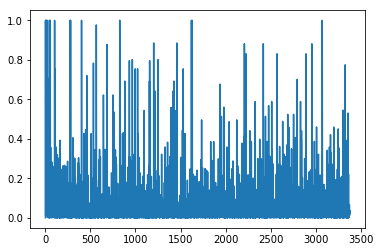

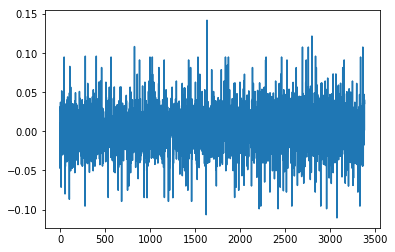

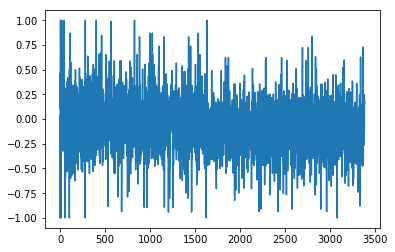

1.85382609836
[ 0.66666667  0.77777778  1.          0.77777778  0.77777778  0.11111111
  1.          0.77777778  0.77777778  0.77777778  0.77777778  0.44444444
  0.66666667  0.66666667  0.66666667  0.88888889  0.11111111  0.66666667
  0.66666667  0.44444444  0.22222222  0.          0.66666667  0.66666667
  0.77777778  0.77777778  0.66666667  0.88888889  0.66666667  1.
  0.77777778  0.77777778  0.66666667  0.88888889  1.          1.
  0.66666667  0.66666667  0.66666667  1.          0.77777778  0.77777778
  0.88888889  1.          0.77777778  0.44444444  0.11111111  0.66666667
  0.88888889  0.55555556  0.66666667  0.11111111  0.          0.11111111
  0.77777778  0.77777778  0.88888889  0.22222222  0.22222222]
Writing away results
1982-09-01 00:00:00


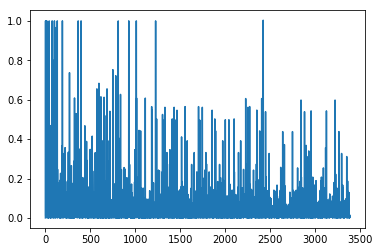

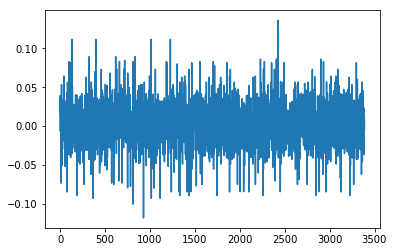

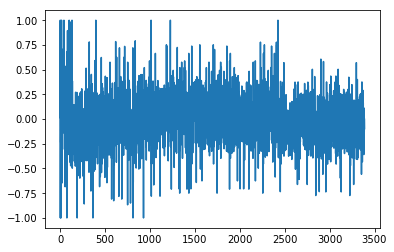

1.67665823231
[ 0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.66666667  0.22222222  0.66666667  0.77777778  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667
  0.22222222  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444]
Writing away results
1982-10-01 00:00:00


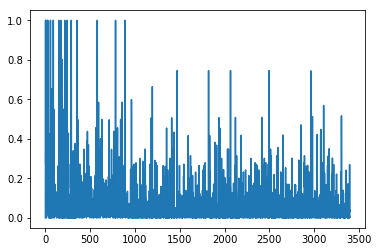

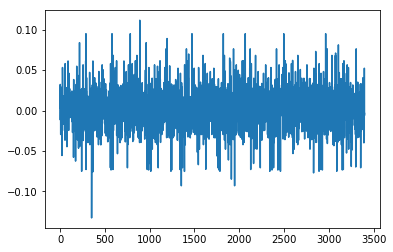

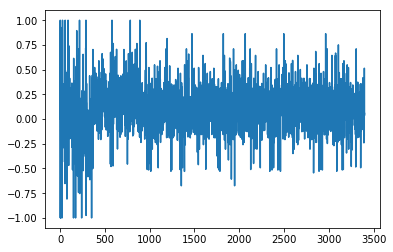

1.39928273955
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.          0.
  0.55555556  0.          0.          0.          0.          0.          0.
  0.          0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.          0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.55555556  0.          0.55555556  0.55555556
  0.          0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556]
Writing away results
1982-11-01 00:00:00


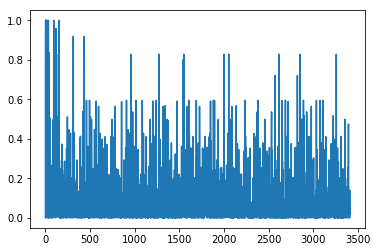

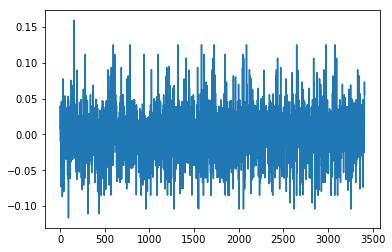

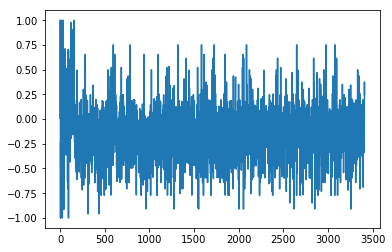

1.45730021276
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.77777778  0.77777778  0.66666667  0.77777778
  0.66666667  0.66666667  0.11111111  0.77777778  0.77777778  0.77777778
  0.77777778  1.          1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.77777778  0.66666667  0.77777778  0.66666667
  0.66666667  0.77777778  0.66666667  0.66666667  0.88888889  0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.77777778]
Writing away results
1982-12-01 00:00:00


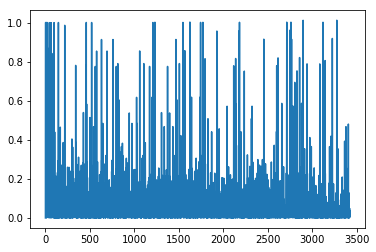

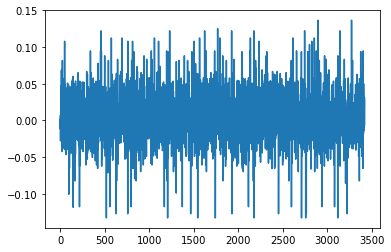

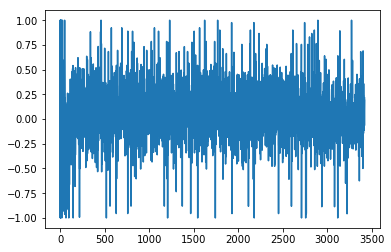

1.28017441752
[ 1.          1.          1.          1.          1.          1.          1.
  1.          0.22222222  0.22222222  0.22222222  1.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.22222222  1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.22222222  1.          0.22222222
  1.          1.          0.22222222  1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.22222222]
Writing away results
1983-01-01 00:00:00


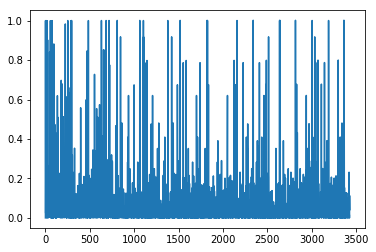

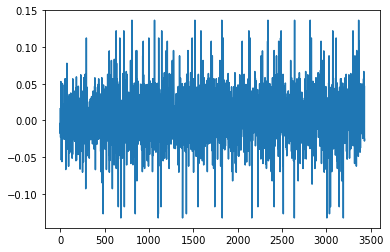

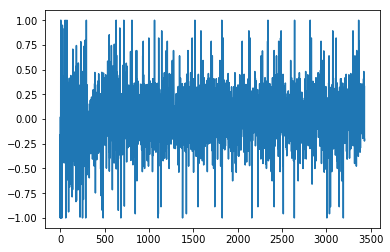

1.26918589327
[ 1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.
  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  0.  0.]
Writing away results
1983-02-01 00:00:00


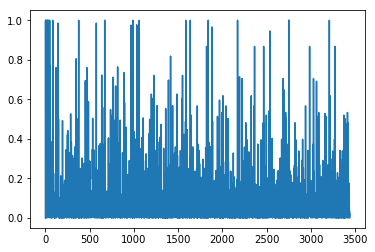

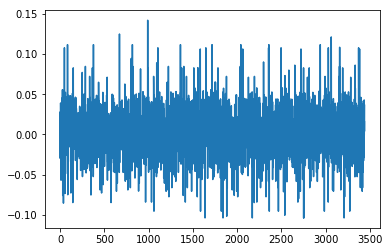

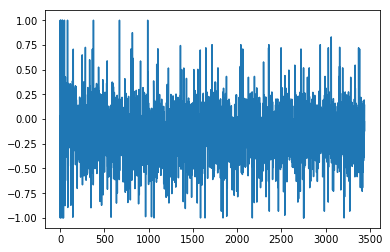

1.30811361355
[ 0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.44444444  0.66666667  0.66666667  0.88888889  0.11111111  1.          0.
  0.          0.66666667  0.22222222  0.66666667  0.66666667  0.66666667
  0.33333333  0.77777778  0.77777778  0.66666667  0.88888889  0.77777778
  0.77777778  0.77777778  0.66666667  0.77777778  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.88888889  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.33333333  0.77777778  0.77777778
  0.66666667  0.88888889  0.66666667  0.22222222  0.77777778  0.55555556
  0.77777778  0.77777778  0.77777778  0.66666667  0.22222222  0.77777778
  0.77777778  0.66666667  0.66666667  0.66666667]
Writing away results
1983-03-01 00:00:00


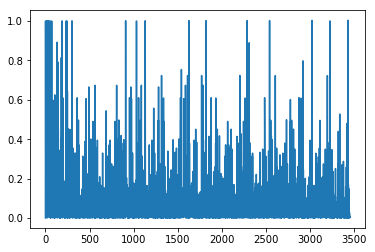

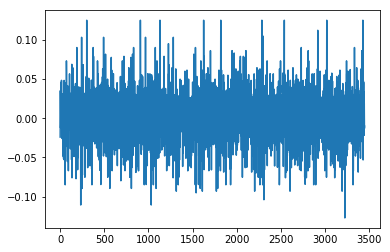

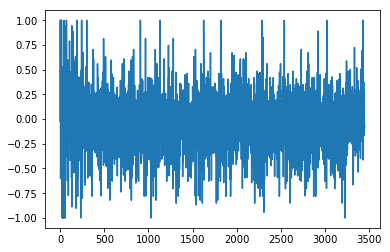

1.42610078755
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.66666667  0.77777778  0.66666667  0.33333333  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.88888889  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.77777778  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1983-04-01 00:00:00


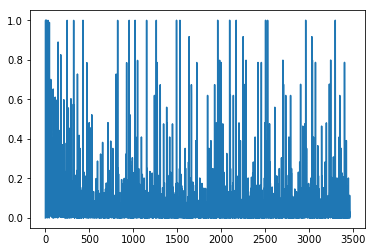

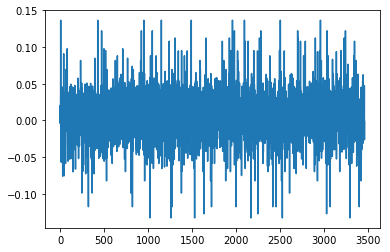

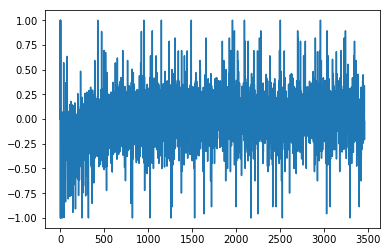

1.11389203529
[ 1.          1.          1.          1.          0.          0.          0.
  1.          0.          0.          0.          0.          0.          0.
  0.          0.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          0.
  1.          0.77777778  0.          1.          1.          1.          1.
  1.          0.33333333  1.          1.          1.          0.          0.
  0.          0.          1.        ]
Writing away results
1983-05-01 00:00:00


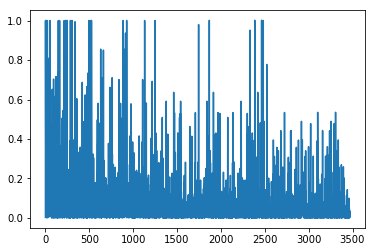

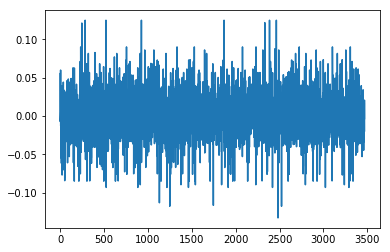

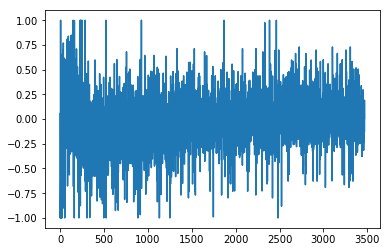

1.26683683118
[ 0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.44444444
  0.66666667  0.33333333  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.66666667  0.44444444  0.88888889
  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667]
Writing away results
1983-06-01 00:00:00


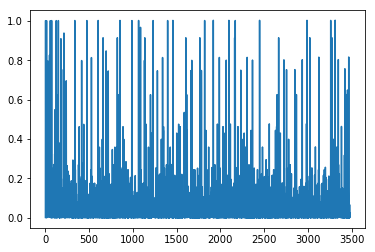

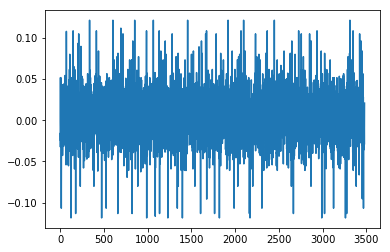

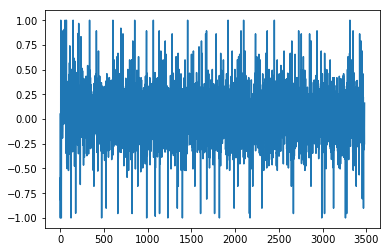

1.15041950713
[ 0.88888889  0.88888889  0.33333333  0.33333333  0.33333333  0.88888889
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.33333333  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.33333333  0.88888889  0.33333333
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333  0.33333333
  0.33333333  0.33333333  0.88888889  0.88888889  0.88888889]
Writing away results
1983-07-01 00:00:00


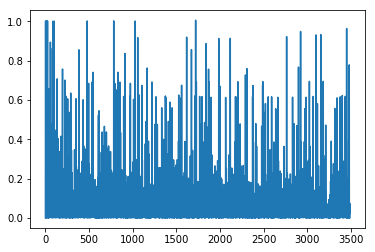

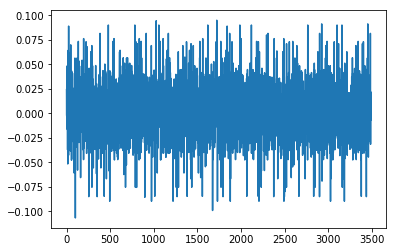

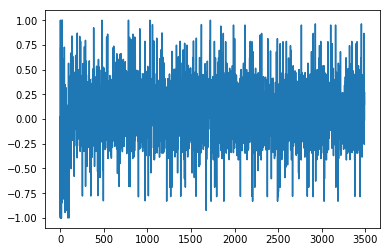

1.28779899307
[ 0.66666667  0.44444444  0.44444444  0.44444444  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.66666667  0.44444444  0.66666667  0.66666667  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.44444444]
Writing away results
1983-08-01 00:00:00


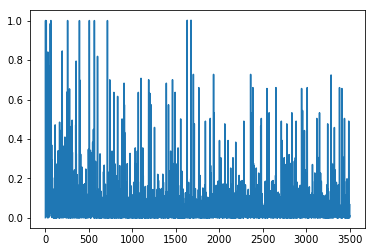

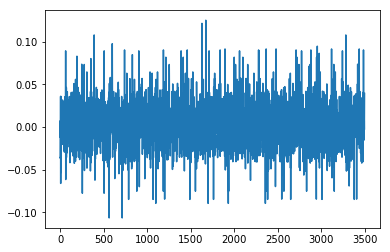

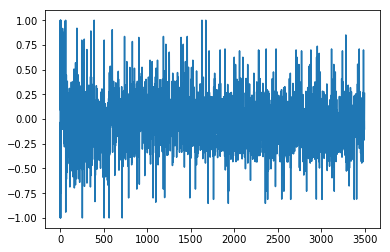

1.23202001359
[ 0.11111111  0.88888889  0.11111111  0.66666667  0.77777778  0.33333333
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.66666667  0.66666667  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.77777778
  0.66666667  0.66666667  0.11111111  0.11111111  0.          0.77777778
  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667]
Writing away results
1983-09-01 00:00:00


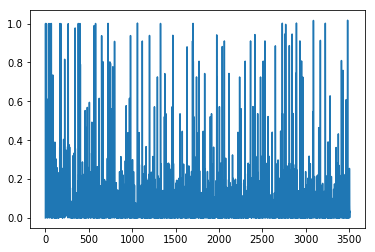

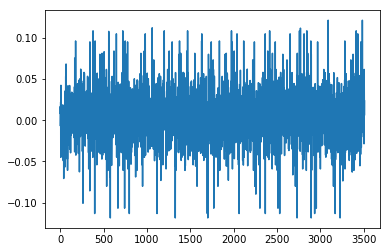

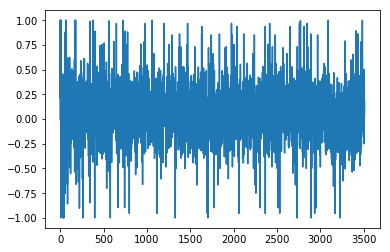

1.06883102852
[ 0.          0.          0.88888889  0.          0.          0.          0.
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.          0.88888889  0.
  0.88888889  0.88888889  0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.          0.88888889  0.88888889]
Writing away results
1983-10-01 00:00:00


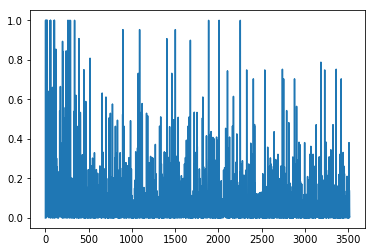

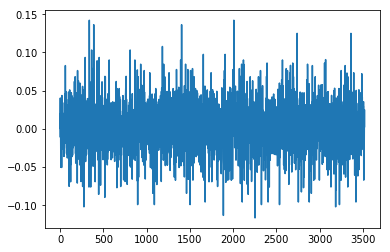

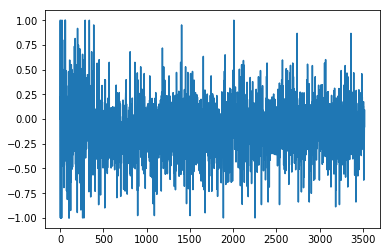

1.29533411534
[ 0.77777778  0.66666667  0.66666667  0.55555556  0.77777778  0.11111111
  0.11111111  0.77777778  0.88888889  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.66666667  0.44444444  0.55555556
  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667  0.77777778
  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.77777778  0.66666667  0.33333333
  0.55555556  0.66666667  0.77777778  0.66666667  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.          0.44444444  0.77777778
  0.77777778  0.33333333  0.66666667  0.55555556  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.77777778]
Writing away results
1983-11-01 00:00:00


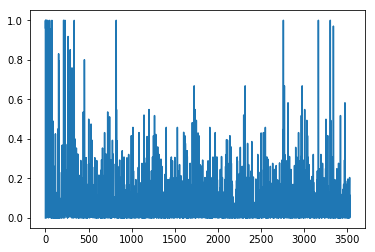

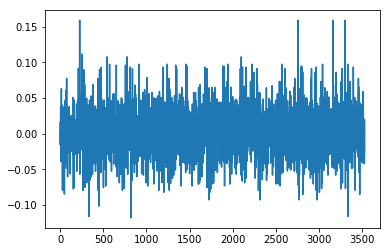

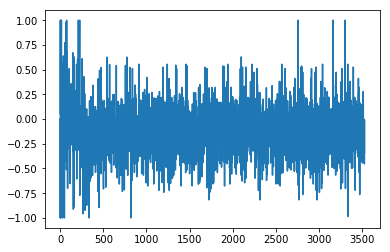

1.26333114639
[ 0.66666667  0.77777778  0.66666667  0.66666667  0.66666667  0.77777778
  0.44444444  0.66666667  0.77777778  0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667
  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.77777778  0.66666667  0.66666667  0.77777778  0.77777778
  0.66666667  0.77777778  0.66666667  0.66666667  0.11111111  0.66666667
  0.77777778  0.44444444  0.66666667  0.77777778  0.77777778  0.66666667
  0.66666667  1.          0.77777778  0.77777778  0.88888889  0.66666667
  0.66666667  0.11111111  0.77777778  0.77777778  0.66666667  0.66666667
  1.          0.77777778  0.77777778  0.66666667  0.66666667]
Writing away results
1983-12-01 00:00:00


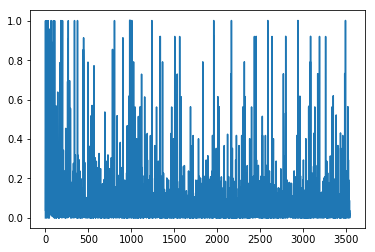

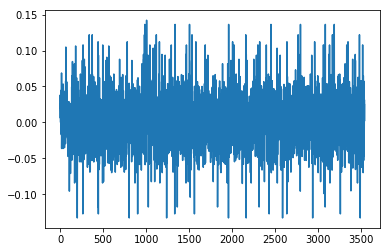

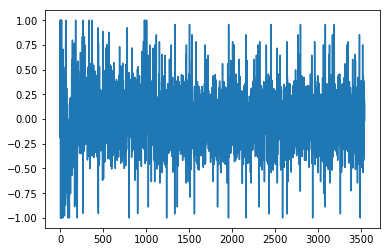

1.22350265852
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.66666667  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.66666667  1.          0.44444444  0.11111111  1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.11111111  1.          1.          1.
  0.66666667  1.          1.          1.          1.          0.22222222]
Writing away results
1984-01-01 00:00:00


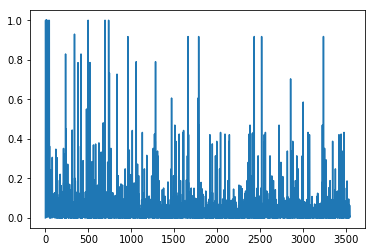

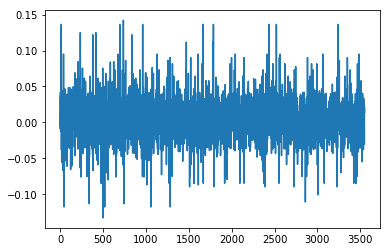

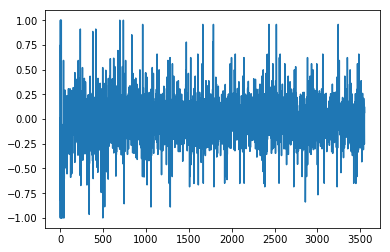

1.16151245844
[ 0.          0.          0.          0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.
  0.66666667  0.          0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.22222222
  0.66666667  0.66666667  0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.          0.66666667  0.55555556
  1.          0.66666667  0.55555556  1.        ]
Writing away results
1984-02-01 00:00:00


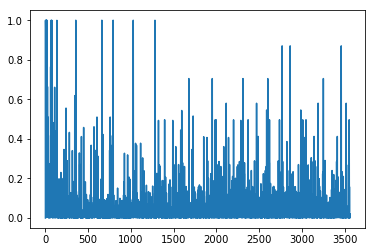

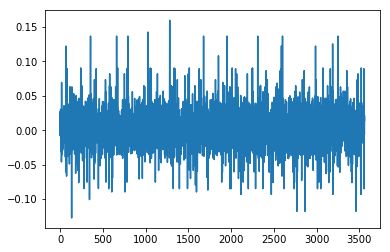

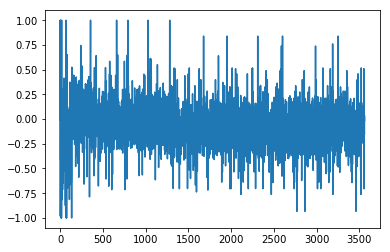

1.69904783824
[ 0.11111111  0.77777778  0.77777778  0.77777778  0.11111111  0.88888889
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  1.          0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.33333333
  0.66666667  0.66666667  0.11111111  0.77777778  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.33333333
  1.          0.66666667  0.33333333  1.          0.66666667]
Writing away results
1984-03-01 00:00:00


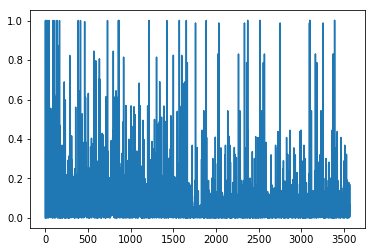

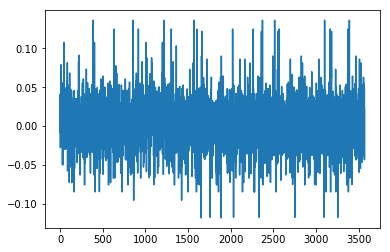

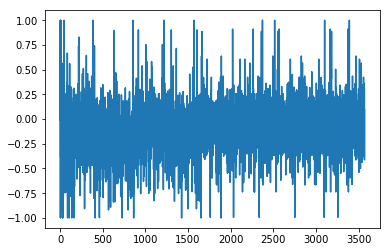

1.33250830557
[ 0.22222222  0.22222222  0.77777778  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.77777778  1.          0.66666667  0.77777778  0.66666667  0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          0.77777778  0.77777778  0.33333333  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778
  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667]
Writing away results
1984-04-01 00:00:00


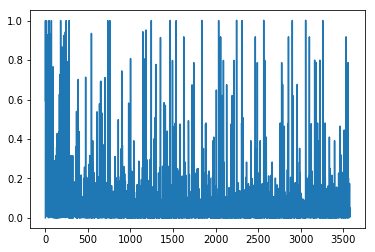

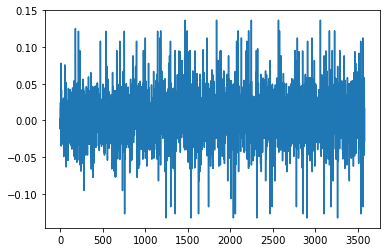

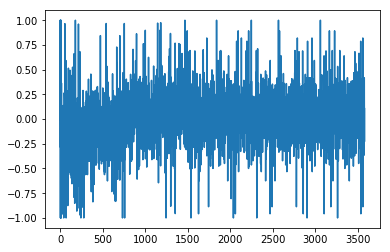

1.21335051617
[ 0.          0.          0.          0.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.          1.          1.          0.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.          0.          0.          0.          1.          1.          1.
  0.          1.          1.          0.          1.          0.          1.
  1.          1.          0.77777778]
Writing away results
1984-05-01 00:00:00


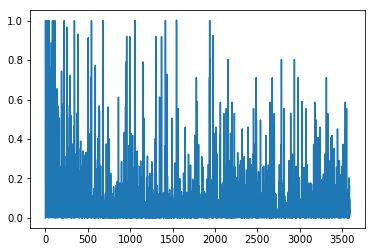

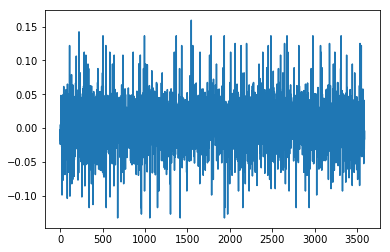

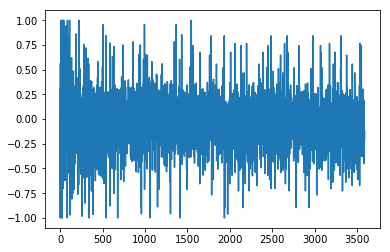

1.49961105444
[ 0.77777778  0.11111111  0.77777778  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.11111111  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.77777778  1.          1.          0.11111111  1.          1.          1.
  1.          0.66666667  0.33333333  1.          1.          1.
  0.11111111  0.11111111  0.77777778  0.77777778  1.          1.          1.
  0.33333333  1.          0.77777778  1.          1.          0.77777778
  0.11111111  1.          1.          0.77777778  1.        ]
Writing away results
1984-06-01 00:00:00


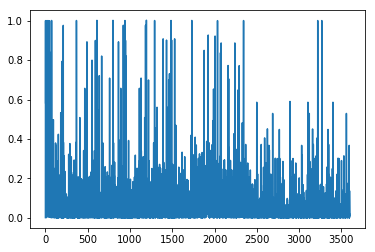

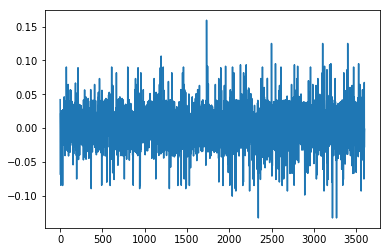

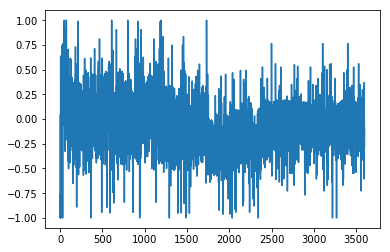

1.70145501716
[ 0.44444444  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.66666667  0.77777778  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.77777778  0.66666667  0.66666667  0.          0.22222222
  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.          0.33333333  0.66666667  0.77777778  0.88888889
  0.66666667  0.66666667  0.          0.66666667  0.66666667]
Writing away results
1984-07-01 00:00:00


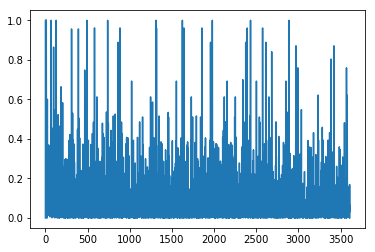

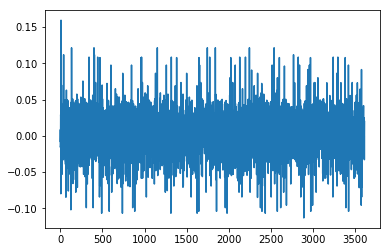

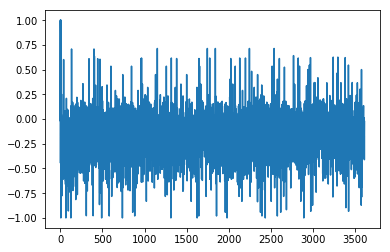

1.60927090312
[ 0.66666667  0.66666667  0.77777778  0.88888889  0.77777778  0.66666667
  0.77777778  0.77777778  0.88888889  0.88888889  0.66666667  0.77777778
  0.88888889  0.88888889  0.66666667  0.66666667  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.66666667  0.66666667  0.77777778  0.66666667  0.77777778  0.66666667
  0.77777778  0.77777778  0.88888889  0.77777778  0.55555556  0.77777778
  0.77777778  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.77777778  0.88888889  0.77777778  0.55555556
  0.77777778  0.66666667  0.66666667  0.77777778  0.44444444  0.77777778
  0.77777778  0.77777778  0.88888889  0.77777778  0.77777778]
Writing away results
1984-08-01 00:00:00


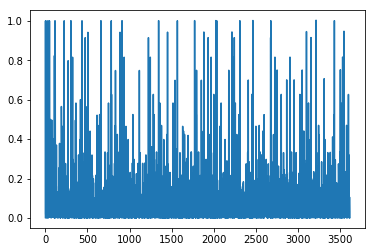

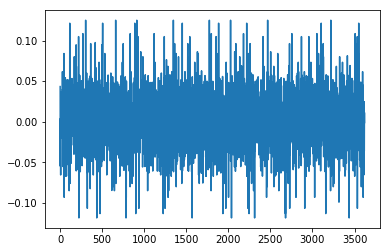

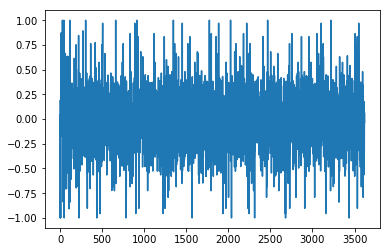

1.67173071005
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.77777778  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.
  0.88888889  0.77777778  0.88888889  0.88888889  0.77777778  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.77777778  0.77777778  0.77777778  0.77777778
  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889  0.88888889
  0.55555556  0.88888889  0.77777778  0.77777778  0.88888889  0.88888889
  0.77777778  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1984-09-01 00:00:00


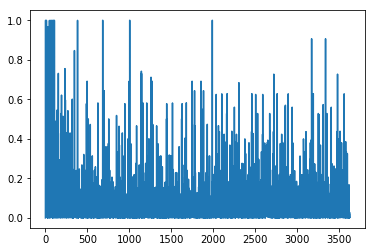

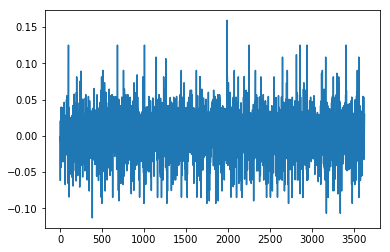

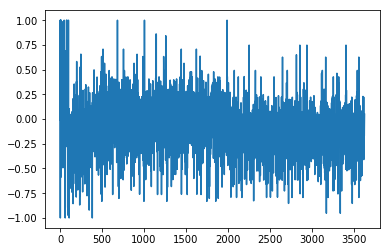

1.66417341862
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667
  0.77777778  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  1.
  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1984-10-01 00:00:00


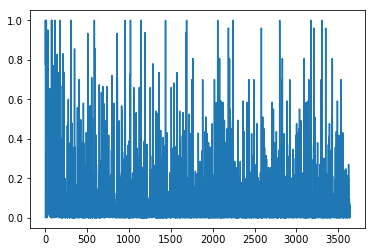

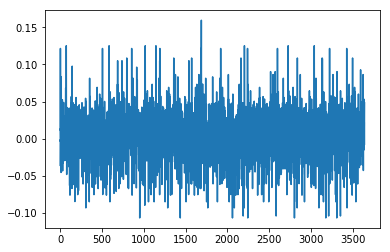

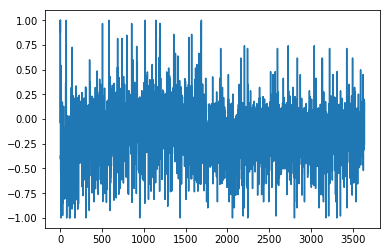

1.38885299387
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.77777778  1.          0.77777778
  0.77777778  0.66666667  0.55555556  0.22222222  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.22222222  0.66666667
  0.44444444  0.22222222  0.66666667  0.66666667  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1984-11-01 00:00:00


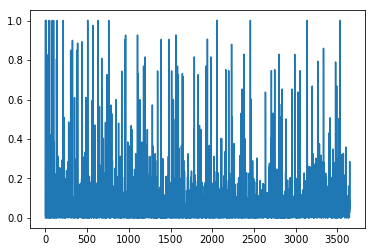

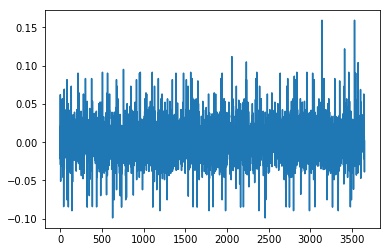

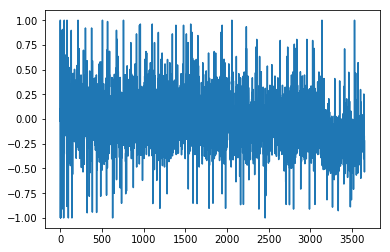

1.47662865751
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.77777778  0.66666667  0.66666667  0.66666667  0.22222222
  0.22222222  1.          1.          0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.33333333  0.22222222  0.66666667  0.77777778
  0.33333333  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1984-12-01 00:00:00


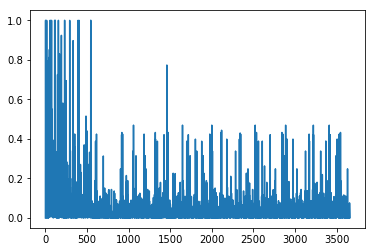

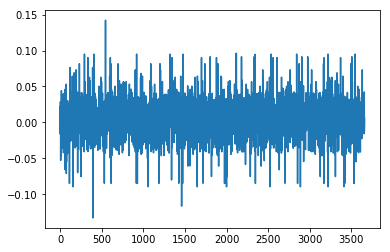

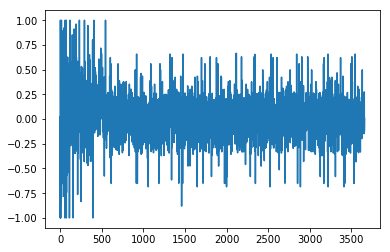

1.28664821739
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.55555556  0.66666667  0.          0.66666667  0.66666667
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.          0.
  0.          0.66666667  0.66666667  0.66666667  0.          0.66666667
  0.88888889  0.          0.66666667  1.          0.          0.66666667
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1985-01-01 00:00:00


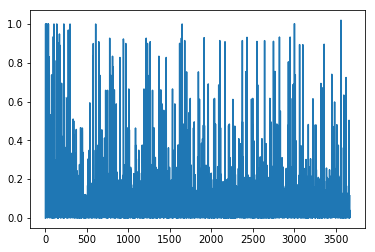

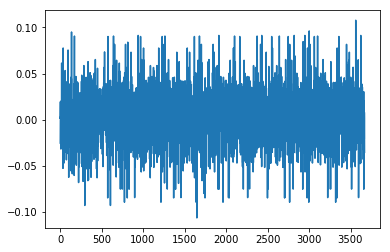

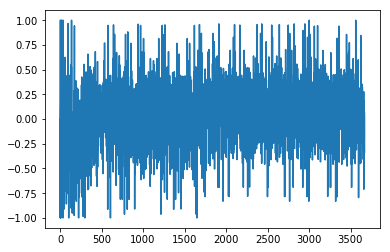

1.44334611954
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556]
Writing away results
1985-02-01 00:00:00


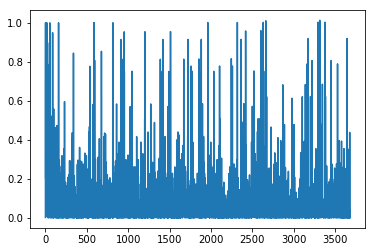

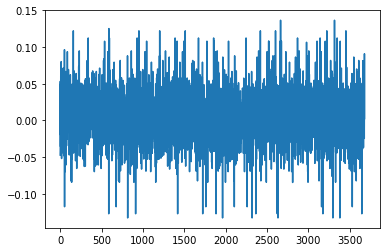

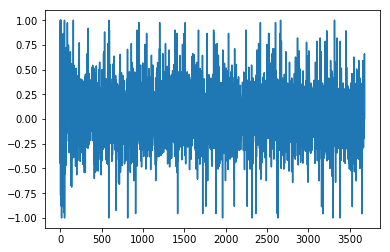

1.4029887447
[ 1.          1.          1.          1.          1.          1.          1.
  0.66666667  1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.66666667  1.          0.66666667
  1.          1.          0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          0.66666667  1.          0.66666667  0.66666667
  1.          1.          0.55555556  1.          1.          1.          1.
  1.          1.          1.          1.          0.66666667  0.66666667]
Writing away results
1985-03-01 00:00:00


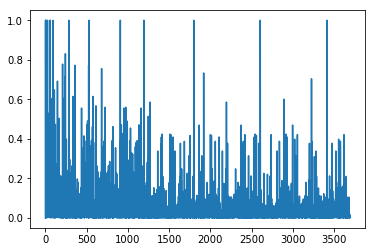

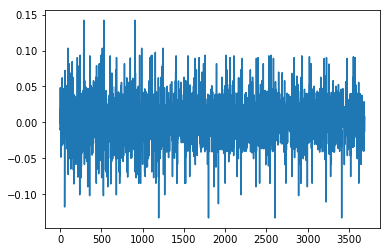

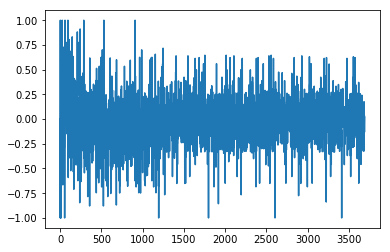

1.23129361267
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.11111111  0.11111111  0.55555556  0.66666667
  0.66666667  0.66666667  0.11111111  0.66666667  1.          0.11111111
  0.66666667  0.88888889  0.11111111  0.66666667  0.66666667  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.55555556  0.11111111]
Writing away results
1985-04-01 00:00:00


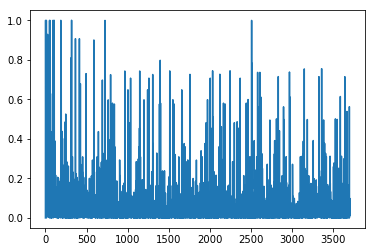

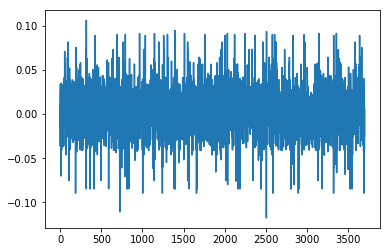

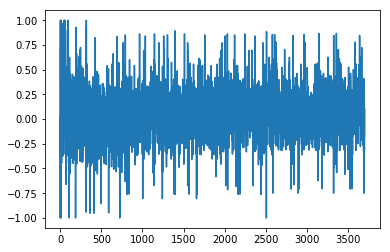

1.2144137448
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.11111111  0.66666667  0.66666667  0.11111111  0.66666667
  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1985-05-01 00:00:00


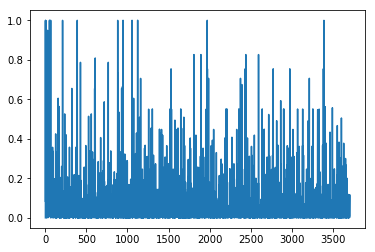

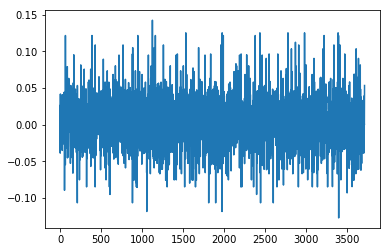

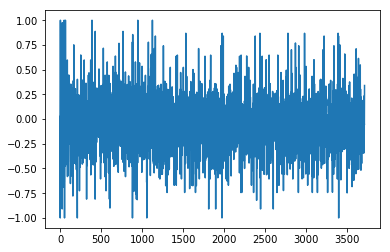

1.34599221237
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.66666667  0.77777778  0.88888889
  0.66666667  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.77777778  0.77777778  0.22222222  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.22222222  0.77777778  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.77777778  0.          0.77777778]
Writing away results
1985-06-01 00:00:00


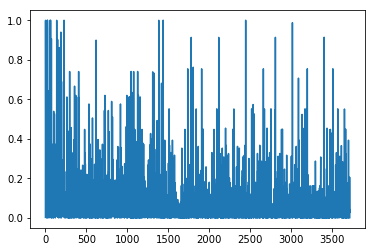

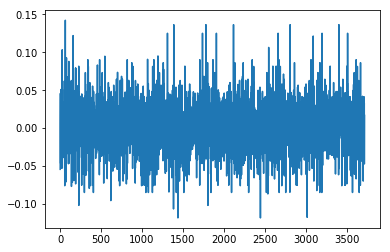

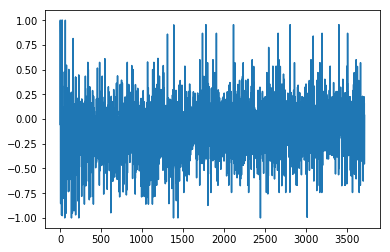

1.47060011193
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  1.          0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.66666667  0.88888889  0.77777778
  0.77777778  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.88888889  1.          0.66666667  0.33333333  1.
  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.77777778  0.77777778  0.77777778  0.77777778]
Writing away results
1985-07-01 00:00:00


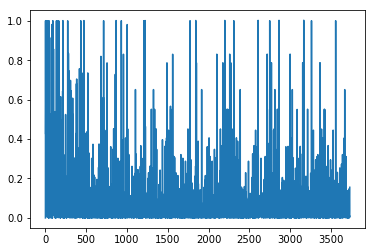

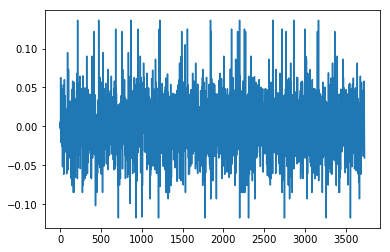

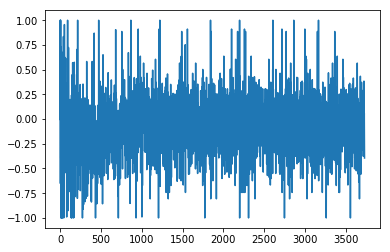

1.49094080631
[ 0.66666667  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          0.66666667  0.77777778  0.66666667  0.66666667  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.77777778  0.77777778  0.77777778
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          1.          0.66666667  0.44444444  0.77777778  0.66666667
  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.77777778  0.66666667  0.77777778  0.77777778  0.66666667]
Writing away results
1985-08-01 00:00:00


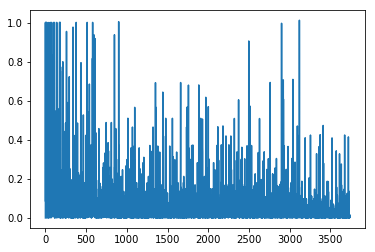

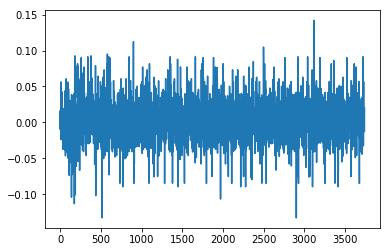

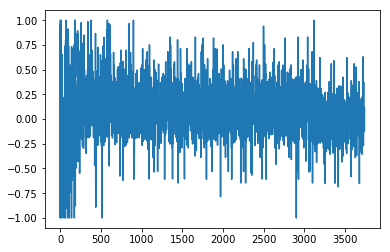

1.23716510493
[ 0.66666667  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.66666667  0.33333333  0.66666667  0.66666667  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667
  0.33333333  0.66666667  0.88888889  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667]
Writing away results
1985-09-01 00:00:00


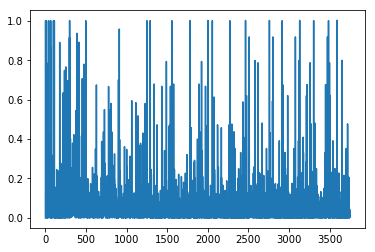

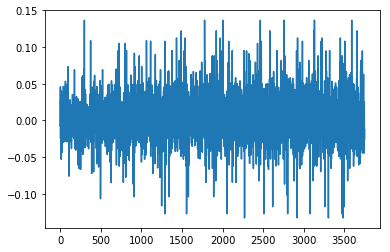

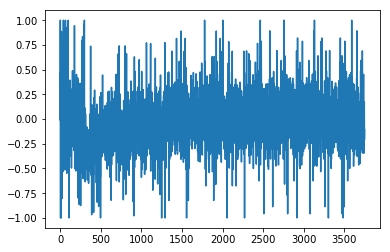

1.09946362375
[ 0.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.          1.
  1.          0.          1.          1.          1.          1.          1.
  0.44444444  1.          1.          1.          0.          0.          0.
  0.          1.          1.          1.          0.          1.
  0.11111111  1.          1.          0.44444444  0.          1.          1.
  0.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.          0.          0.          0.
  0.          1.          1.          1.        ]
Writing away results
1985-10-01 00:00:00


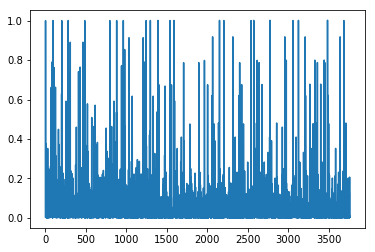

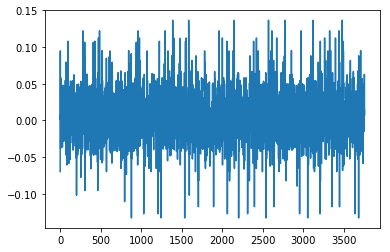

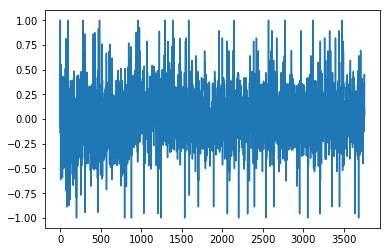

1.08886744355
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.          1.          1.
  0.          1.          1.          1.          1.          1.
  0.77777778  1.          1.          1.          0.          0.          0.
  0.          1.          1.          1.          0.          1.          1.
  1.          1.          0.          1.          1.          1.          0.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.          0.          0.          0.          0.          0.
  1.          1.          1.          0.        ]
Writing away results
1985-11-01 00:00:00


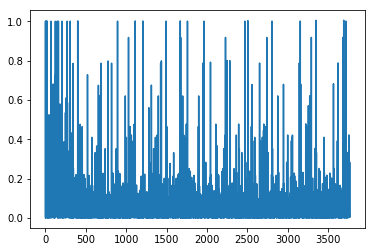

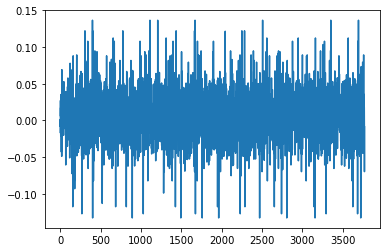

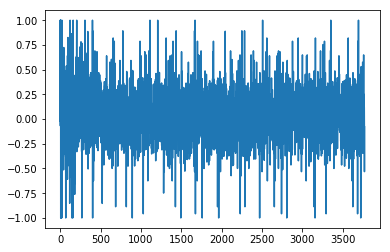

1.04999317974
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.11111111  1.          1.
  0.11111111  1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.11111111  0.11111111  0.11111111
  0.11111111  1.          1.          1.          0.11111111  1.          1.
  1.          1.          0.11111111  0.11111111  1.          1.
  0.11111111  1.          1.          1.          1.          1.          1.
  1.          1.          0.66666667  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  1.          1.          1.          0.11111111
  0.11111111]
Writing away results
1985-12-01 00:00:00


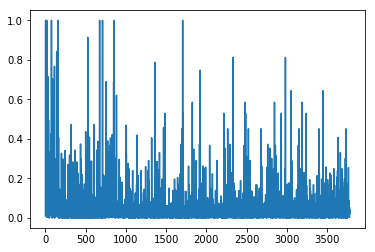

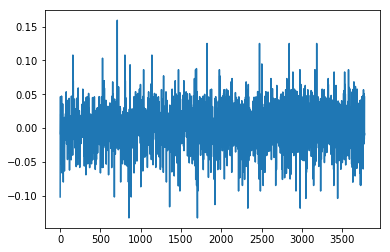

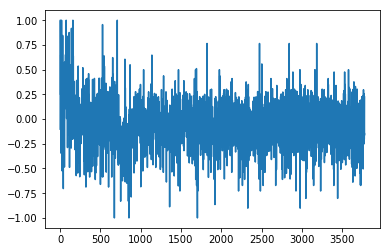

1.39029182247
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.66666667  0.77777778  0.66666667  0.66666667
  0.77777778  0.66666667  0.66666667  1.          0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.66666667  0.          0.66666667
  0.77777778  0.77777778  1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.33333333  0.66666667  0.77777778  0.77777778
  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.77777778  0.66666667  0.77777778  0.77777778  0.66666667
  0.66666667  0.33333333  0.66666667  0.          0.77777778]
Writing away results
1986-01-01 00:00:00


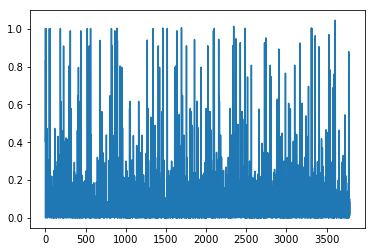

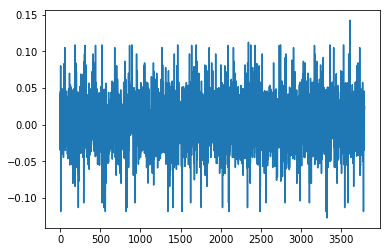

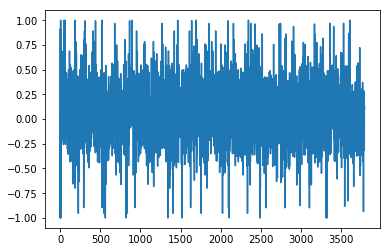

1.20081200966
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.88888889  0.66666667  0.88888889  0.88888889  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.66666667  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1986-02-01 00:00:00


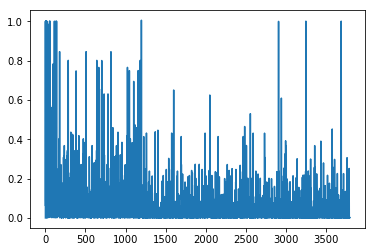

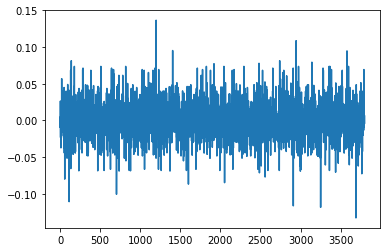

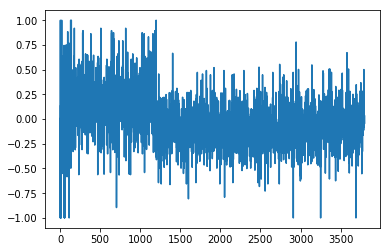

1.18567301465
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.77777778
  0.33333333  1.          0.11111111  0.33333333  0.11111111  0.33333333
  0.33333333  0.33333333  0.33333333  0.44444444  0.33333333  0.33333333
  0.33333333  0.33333333  0.44444444  0.44444444  0.44444444  0.11111111
  0.33333333  0.33333333  0.33333333  0.44444444  0.          0.33333333
  0.44444444  0.33333333  0.33333333  0.11111111  0.33333333  0.33333333
  0.88888889  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.44444444  0.33333333  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  0.33333333  0.33333333
  0.44444444  0.44444444  0.44444444  0.44444444  0.33333333]
Writing away results
1986-03-01 00:00:00


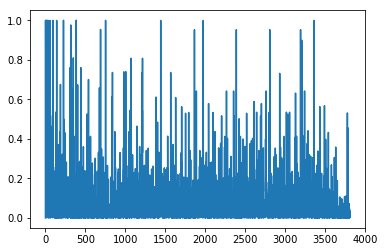

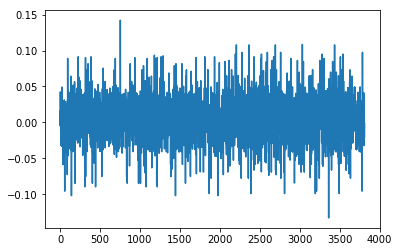

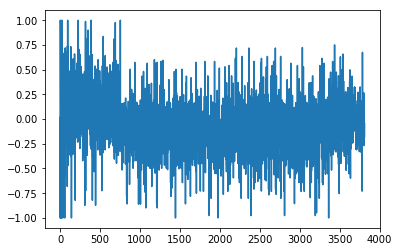

1.01013120183
[ 0.66666667  0.66666667  0.77777778  0.77777778  0.66666667  0.66666667
  0.44444444  0.66666667  0.77777778  0.11111111  0.66666667  0.77777778
  0.77777778  0.77777778  0.11111111  0.22222222  0.77777778  0.77777778
  0.77777778  0.11111111  0.66666667  0.44444444  0.11111111  0.77777778
  0.77777778  0.66666667  0.11111111  0.77777778  0.          0.11111111
  0.66666667  0.88888889  0.          0.66666667  0.77777778  0.11111111
  0.77777778  0.77777778  0.77777778  0.66666667  0.66666667  0.77777778
  0.77777778  0.66666667  0.66666667  0.44444444  0.11111111  0.66666667
  0.44444444  0.11111111  0.66666667  0.77777778  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.77777778  0.77777778]
Writing away results
1986-04-01 00:00:00


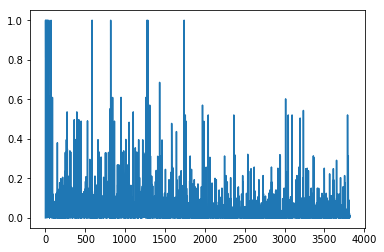

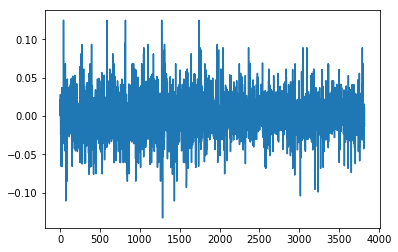

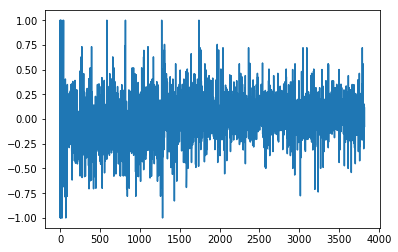

1.04618164045
[ 0.33333333  0.33333333  0.33333333  0.11111111  0.33333333  0.11111111
  0.11111111  0.33333333  0.11111111  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.11111111  0.11111111  0.11111111  0.11111111  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111  0.33333333
  0.33333333  0.11111111  0.33333333  0.33333333  0.11111111  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.55555556  0.11111111  0.11111111  0.11111111
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111
  0.11111111  0.11111111  0.33333333  0.33333333  0.33333333]
Writing away results
1986-05-01 00:00:00


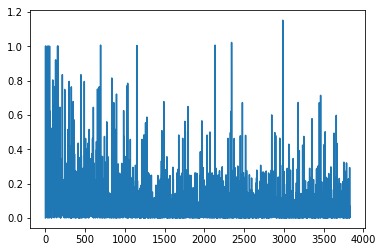

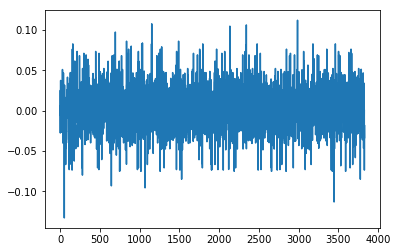

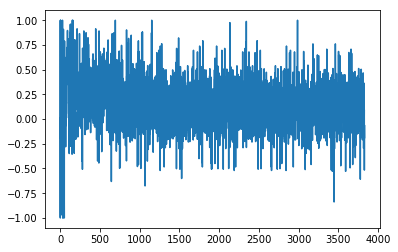

1.16376462242
[ 0.55555556  0.55555556  0.44444444  0.55555556  0.44444444  0.44444444
  0.55555556  0.44444444  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444
  0.44444444  0.44444444  0.44444444  0.55555556  0.55555556  0.55555556
  0.44444444  0.55555556  0.55555556  0.44444444  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.55555556  0.55555556  0.55555556  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1986-06-01 00:00:00


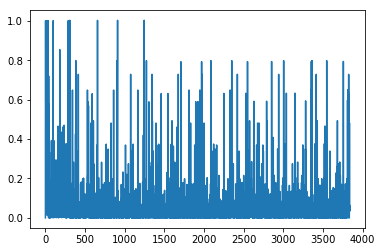

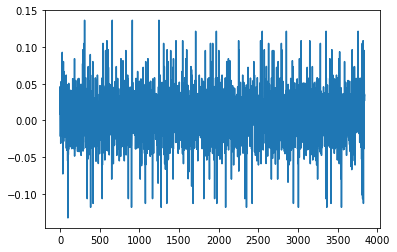

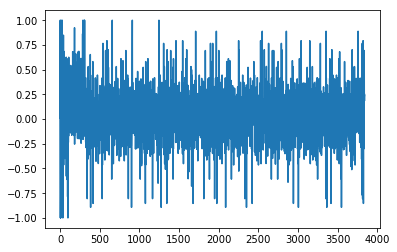

1.07755628804
[ 0.88888889  0.88888889  0.88888889  0.          0.88888889  0.11111111
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.          0.
  0.          0.88888889  0.88888889  0.88888889  0.          0.88888889
  0.22222222  0.88888889  0.88888889  0.          0.          0.88888889
  0.88888889  0.          0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.          0.
  0.          0.          0.          0.88888889  0.88888889  0.88888889
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889]
Writing away results
1986-07-01 00:00:00


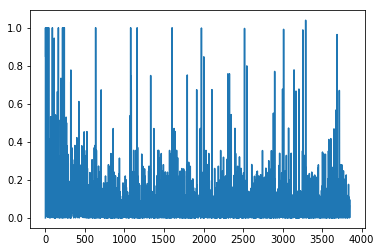

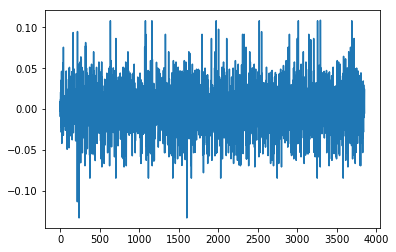

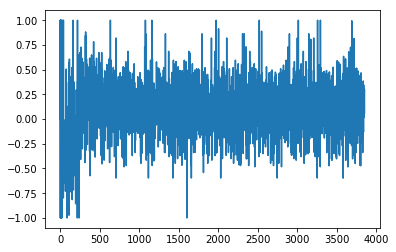

1.25072466305
[ 0.66666667  0.44444444  0.66666667  0.66666667  0.44444444  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.44444444  0.44444444  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1986-08-01 00:00:00


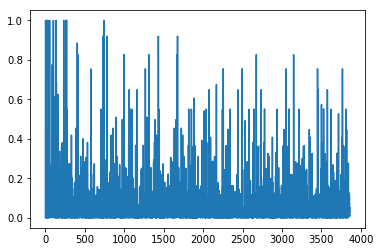

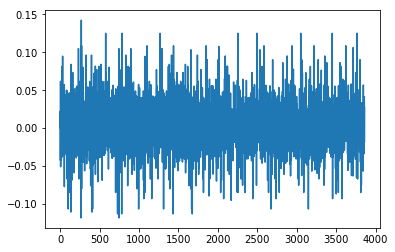

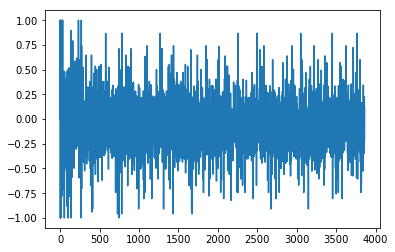

1.18948685797
[ 0.66666667  0.          0.66666667  0.66666667  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.
  0.66666667  0.66666667  0.          0.77777778  0.11111111  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.66666667  0.44444444  0.77777778  0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.          0.22222222
  0.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.77777778  0.77777778  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.        ]
Writing away results
1986-09-01 00:00:00


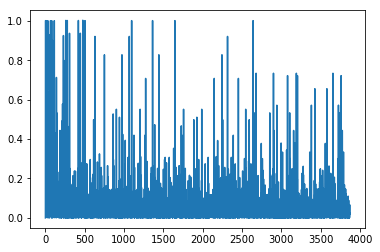

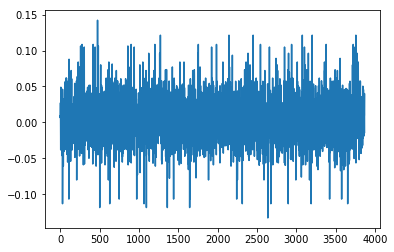

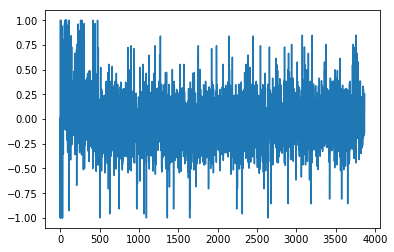

1.13435035594
[ 0.11111111  0.88888889  0.88888889  0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889  0.88888889
  0.88888889  0.33333333  0.33333333  0.33333333  0.          0.88888889
  0.88888889  0.88888889  0.33333333  0.88888889  0.66666667  0.88888889
  0.88888889  0.          0.          0.88888889  0.88888889  0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.          0.11111111  0.77777778
  0.33333333  0.11111111  0.88888889  0.88888889  0.88888889  0.33333333
  0.33333333  0.33333333  0.77777778  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.11111111  0.88888889]
Writing away results
1986-10-01 00:00:00


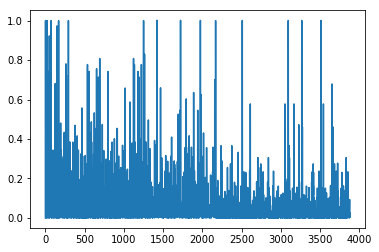

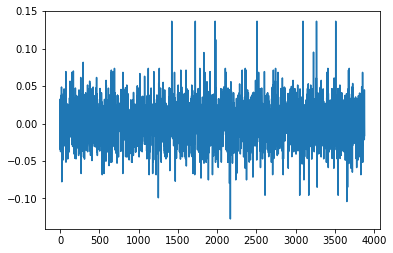

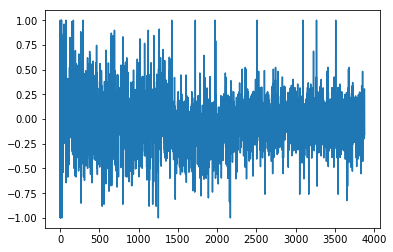

1.35521786162
[ 1.          0.33333333  1.          0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.77777778  0.33333333  0.33333333
  0.44444444  0.44444444  0.44444444  0.77777778  0.33333333  0.33333333
  0.33333333  0.66666667  0.11111111  0.          1.          0.33333333
  0.          0.77777778  0.33333333  0.66666667  0.          0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.77777778  0.          0.11111111  0.44444444
  0.          0.33333333  0.33333333  0.33333333  0.33333333  0.44444444
  0.44444444  0.55555556  0.77777778  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1986-11-01 00:00:00


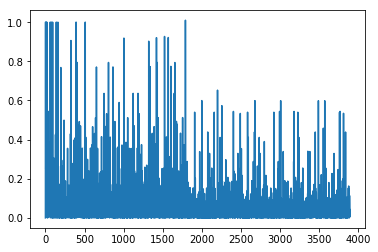

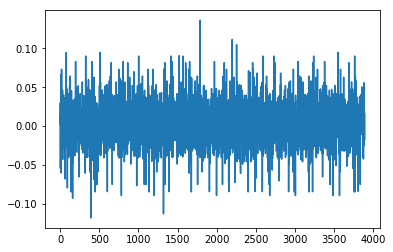

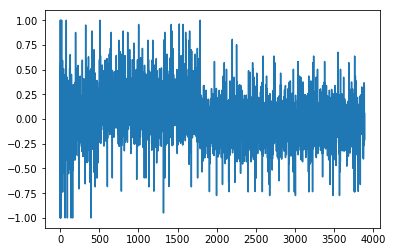

1.13382653348
[ 0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667  0.44444444
  0.22222222  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667]
Writing away results
1986-12-01 00:00:00


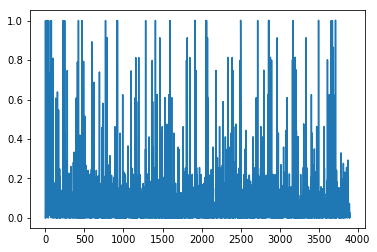

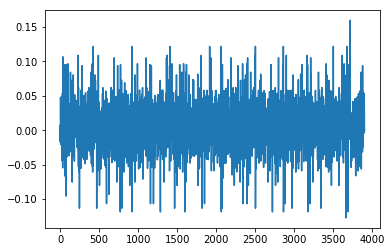

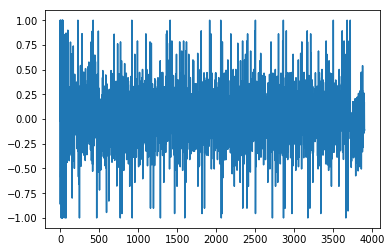

1.17226513646
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.88888889  0.88888889  0.88888889  0.          0.          0.
  0.          0.88888889  0.88888889  0.88888889  0.          0.88888889
  0.88888889  0.88888889  0.88888889  0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.          0.
  0.          0.          0.          0.88888889  0.88888889  0.88888889
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.88888889
  0.88888889  0.88888889  0.88888889]
Writing away results
1987-01-01 00:00:00


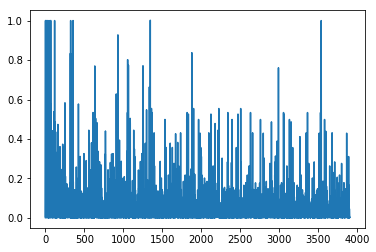

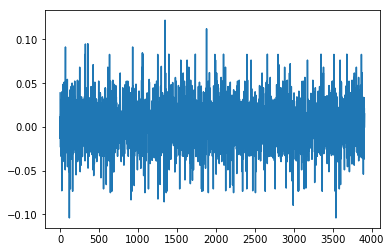

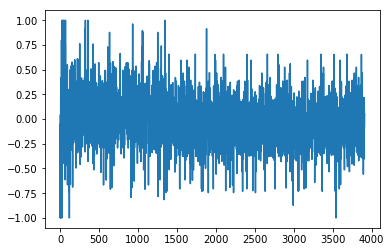

1.14460011943
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.11111111
  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222
  0.33333333  0.55555556  0.55555556  0.55555556  0.22222222  0.55555556
  0.33333333  0.66666667  0.55555556  0.33333333  0.66666667  0.55555556
  0.55555556  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111  0.77777778
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556
  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1987-02-01 00:00:00


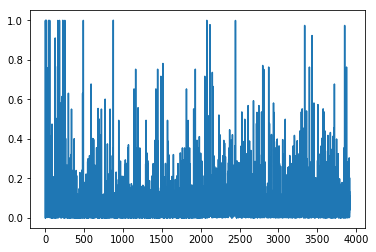

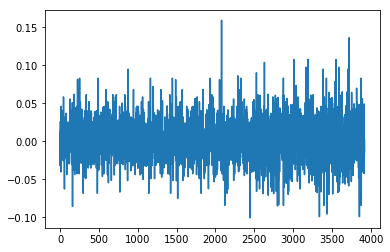

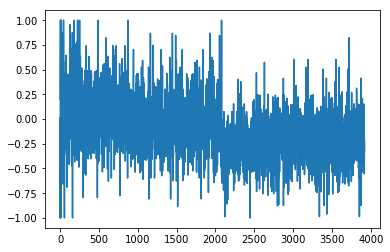

1.22527775478
[ 0.77777778  0.77777778  0.55555556  0.22222222  0.11111111  0.11111111
  0.77777778  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.77777778  0.77777778  0.22222222  0.11111111  0.77777778
  0.22222222  0.88888889  0.77777778  0.44444444  0.88888889  0.88888889
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.66666667  0.33333333  0.66666667
  0.66666667  0.66666667  0.22222222  0.77777778  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778
  0.77777778  0.77777778  0.77777778  0.77777778  0.77777778  0.88888889
  0.77777778  0.77777778  0.77777778  0.33333333  0.77777778]
Writing away results
1987-03-01 00:00:00


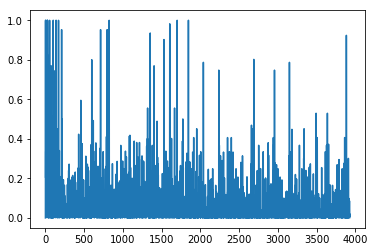

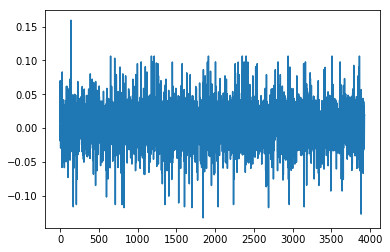

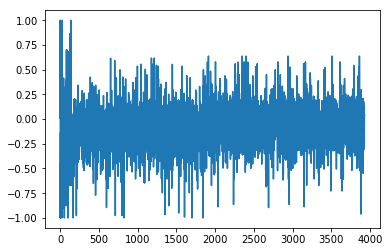

1.26694100098
[ 0.66666667  0.66666667  0.66666667  0.33333333  0.77777778  0.66666667
  0.66666667  0.55555556  0.88888889  0.77777778  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.          0.33333333
  0.66666667  0.55555556  0.77777778  0.66666667  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.77777778  0.66666667
  0.          0.77777778  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.22222222  0.77777778  0.77777778  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1987-04-01 00:00:00


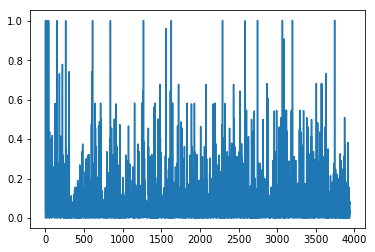

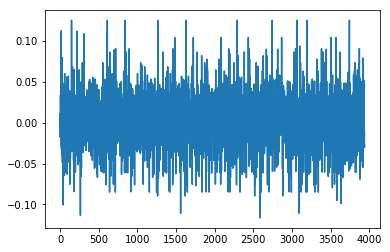

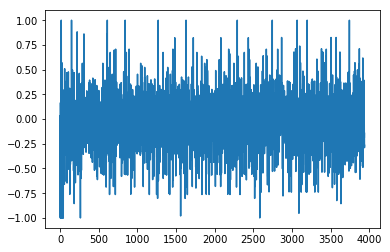

1.07990948009
[ 0.66666667  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.77777778  0.66666667
  0.55555556  0.11111111  0.66666667  0.66666667  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.77777778  0.77777778  1.
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.11111111  0.11111111  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1987-05-01 00:00:00


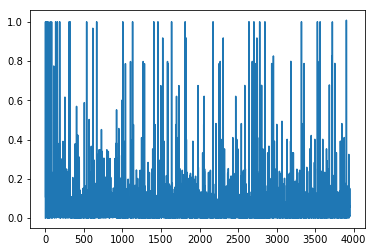

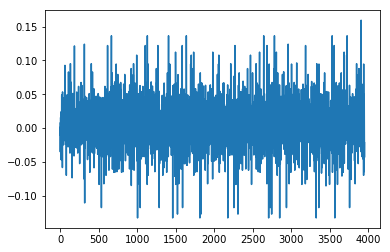

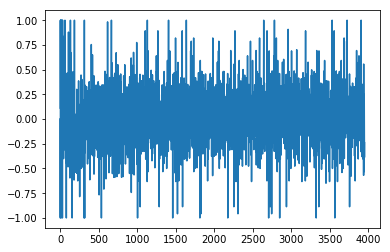

1.0660614836
[ 0.  0.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.
  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.
  1.  1.  1.  1.  1.]
Writing away results
1987-06-01 00:00:00


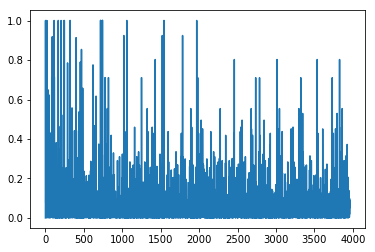

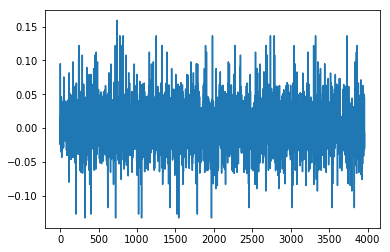

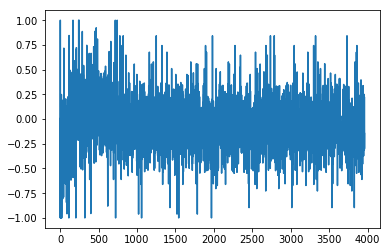

1.22903298322
[ 0.22222222  0.77777778  0.66666667  0.66666667  0.          0.44444444
  0.44444444  0.77777778  1.          0.66666667  0.66666667  0.22222222
  0.66666667  0.77777778  1.          0.66666667  0.77777778  1.
  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667  1.
  0.66666667  0.66666667  0.66666667  1.          0.66666667  0.66666667
  0.44444444  0.77777778  0.55555556  0.44444444  0.77777778  0.66666667
  0.66666667  1.          0.66666667  0.44444444  0.44444444  0.77777778
  1.          1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  1.          0.66666667  0.66666667
  0.66666667  0.66666667  1.          0.66666667  0.77777778]
Writing away results
1987-07-01 00:00:00


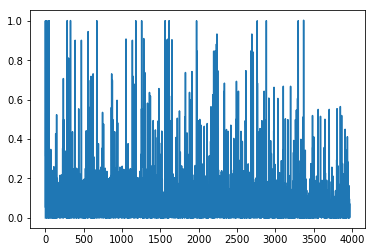

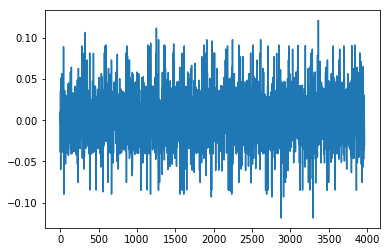

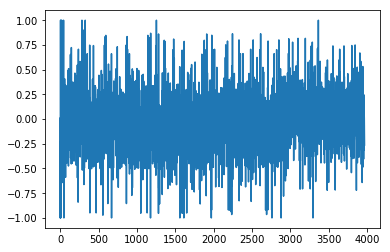

1.14130422787
[ 0.88888889  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.33333333  0.66666667  0.55555556  0.77777778  0.66666667
  0.66666667  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667]
Writing away results
1987-08-01 00:00:00


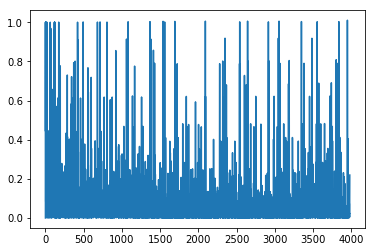

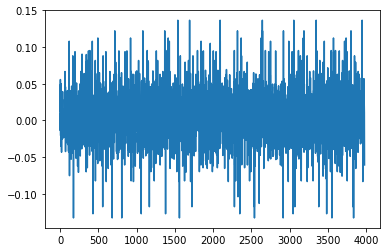

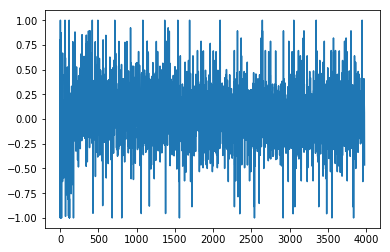

1.00073527118
[ 1.  1.  0.  0.  0.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  1.  1.  1.
  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.
  1.  1.  0.  0.  0.]
Writing away results
1987-09-01 00:00:00


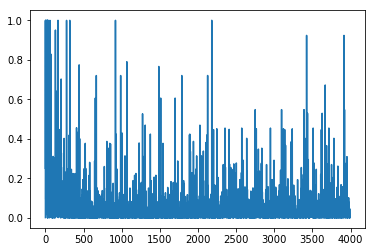

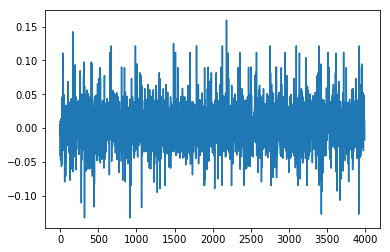

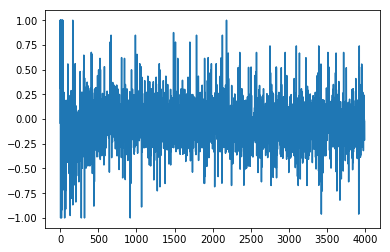

1.20331189493
[ 0.55555556  0.11111111  0.44444444  1.          0.77777778  0.66666667
  0.66666667  0.66666667  1.          0.44444444  0.33333333  0.88888889
  0.66666667  0.33333333  0.22222222  0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  0.11111111  0.44444444
  1.          0.11111111  0.66666667  0.33333333  0.66666667  1.          1.
  1.          0.44444444  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  1.
  0.44444444  0.44444444  0.88888889  0.66666667]
Writing away results
1987-10-01 00:00:00


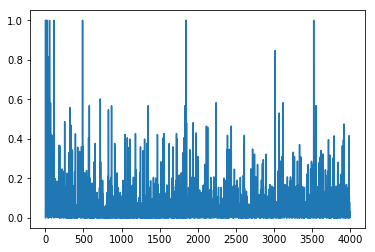

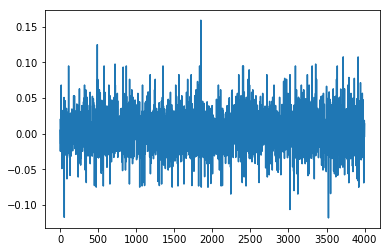

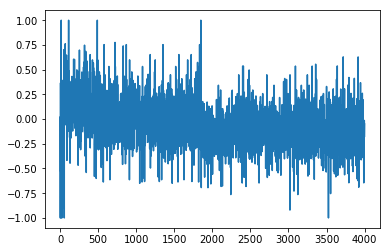

1.3870998266
[ 0.          0.55555556  0.55555556  0.55555556  0.33333333  0.77777778
  1.          0.          0.77777778  0.11111111  0.          1.
  0.33333333  0.11111111  0.77777778  0.77777778  0.          1.
  0.77777778  0.33333333  0.55555556  0.77777778  0.77777778  0.77777778
  0.55555556  1.          0.33333333  0.          1.          0.66666667
  0.          0.77777778  0.33333333  0.55555556  0.66666667  0.55555556
  0.55555556  0.55555556  0.33333333  0.77777778  0.77777778  0.77777778
  0.77777778  0.77777778  0.          1.          0.33333333  0.55555556
  0.55555556  0.55555556  0.55555556  0.33333333  0.77777778  0.66666667
  1.          0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1987-11-01 00:00:00


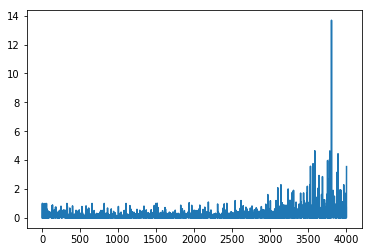

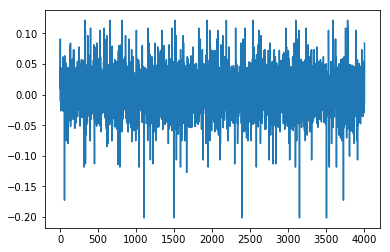

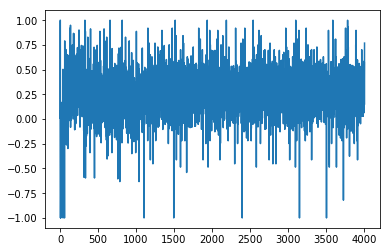

1.38408862455
[ 0.55555556  0.55555556  0.88888889  0.88888889  0.88888889  0.88888889
  0.55555556  0.88888889  0.88888889  0.55555556  0.55555556  0.88888889
  0.88888889  0.55555556  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.55555556
  0.55555556  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556
  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556  0.55555556
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.55555556  0.88888889  0.88888889  0.88888889  0.88888889
  0.55555556  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556
  0.88888889  0.55555556  0.88888889  0.88888889  0.88888889]
Writing away results
1987-12-01 00:00:00


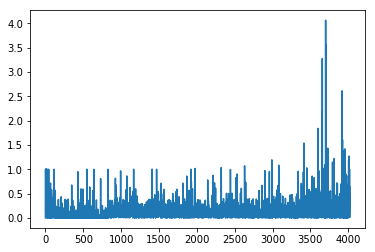

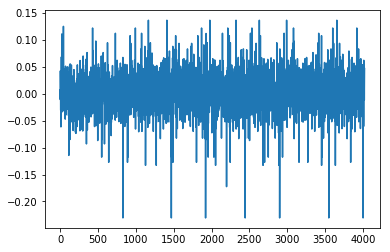

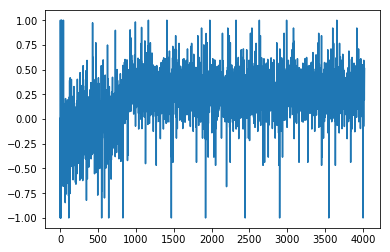

1.34323082992
[ 0.22222222  0.22222222  1.          1.          1.          0.22222222
  1.          1.          0.22222222  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  1.          1.          1.
  0.22222222  0.22222222  0.22222222  0.22222222  1.          1.          1.
  1.          1.          1.          0.22222222  1.          1.          1.
  1.          0.22222222  1.          1.          1.          1.
  0.22222222  0.22222222  0.22222222  1.          1.          1.          1.        ]
Writing away results
1988-01-01 00:00:00


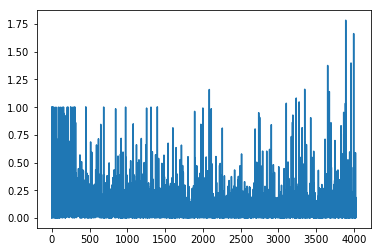

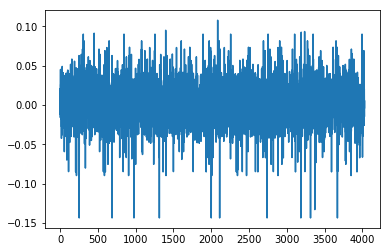

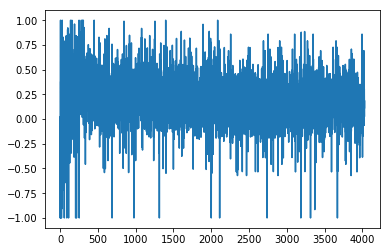

1.33736926129
[ 0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1988-02-01 00:00:00


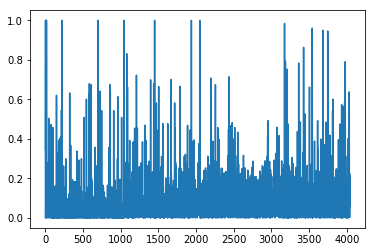

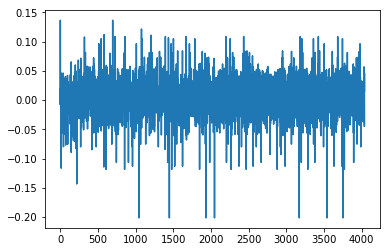

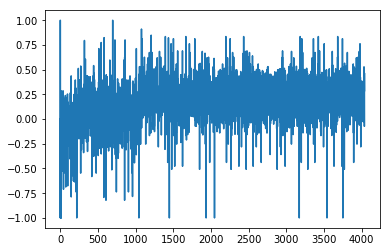

1.32199975736
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.22222222  0.88888889  0.88888889  0.22222222  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.88888889  0.88888889  0.88888889
  0.22222222  0.22222222  0.22222222  0.22222222  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.88888889  0.88888889
  0.88888889  0.88888889  0.22222222  0.22222222  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1988-03-01 00:00:00


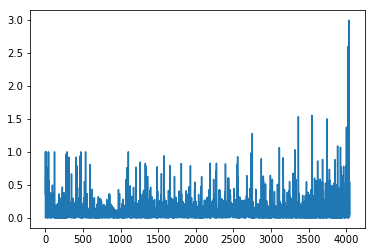

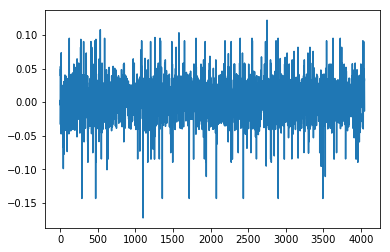

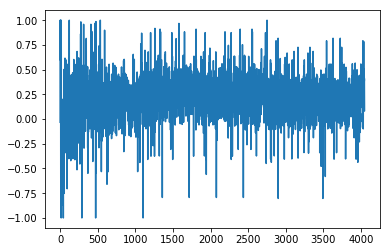

1.28490656289
[ 0.66666667  0.66666667  0.          0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.          0.          0.          0.
  0.          0.66666667  0.66666667  0.66666667  0.          0.          0.
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667]
Writing away results
1988-04-01 00:00:00


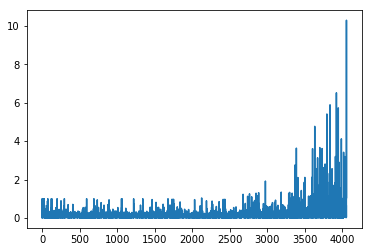

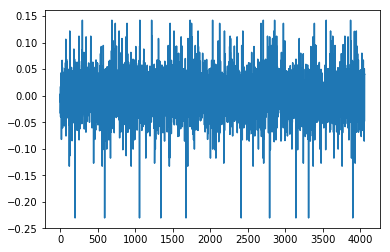

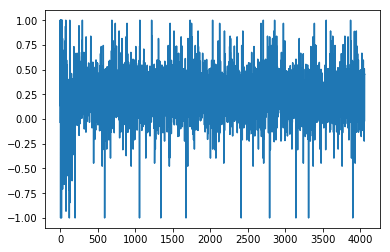

1.49006058486
[ 1.          0.88888889  1.          1.          0.88888889  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.88888889  0.88888889
  1.          0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  1.          0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  1.          1.          1.          1.          0.88888889  1.          1.
  1.          1.          0.88888889  1.          1.          1.          1.
  0.88888889  1.          0.88888889  1.          1.          1.          1.
  1.          1.          1.          1.        ]
Writing away results
1988-05-01 00:00:00


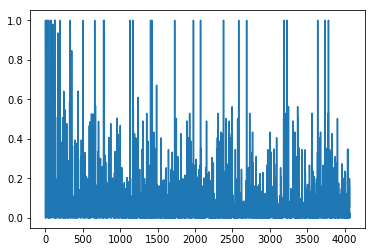

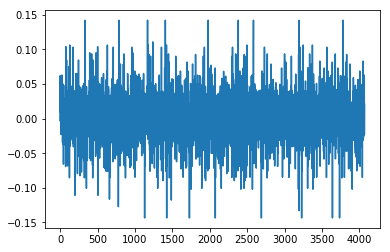

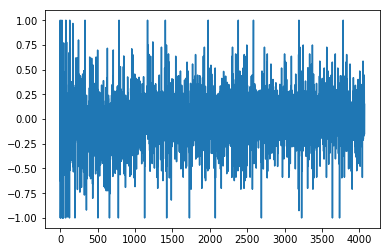

1.30089812488
[ 0.88888889  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.22222222  0.88888889  0.88888889  0.22222222
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1988-06-01 00:00:00


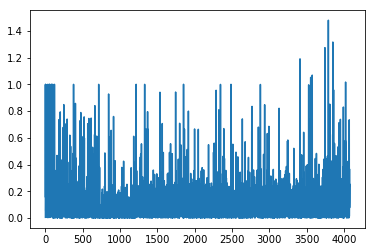

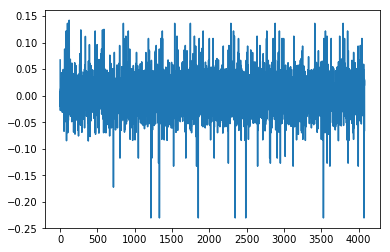

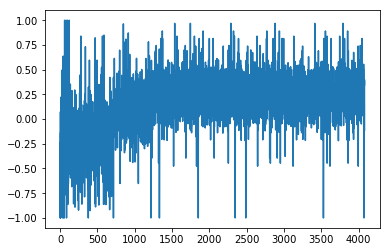

1.4190117354
[ 1.          1.          0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.          1.          1.          0.66666667  1.          1.          1.
  1.          0.66666667  1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.        ]
Writing away results
1988-07-01 00:00:00


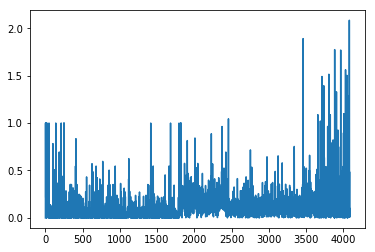

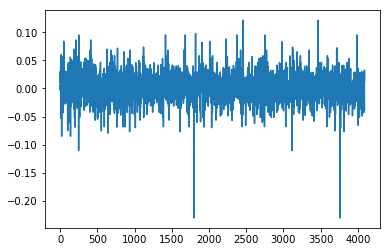

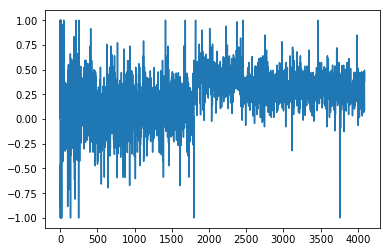

1.25005348075
[ 0.33333333  0.          0.33333333  0.33333333  0.          0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.          0.          0.33333333
  0.          0.          0.          0.          0.33333333  0.33333333
  0.33333333  0.          0.          0.          0.          0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.33333333
  0.33333333  0.33333333  0.33333333  0.          0.33333333  0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1988-08-01 00:00:00


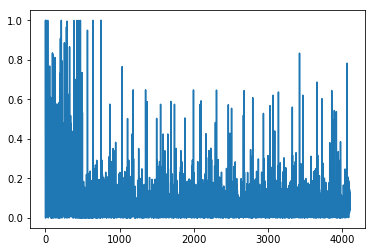

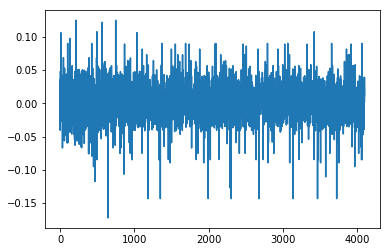

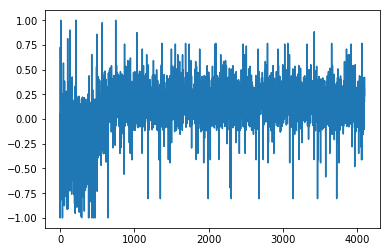

1.32500778514
[ 0.11111111  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.66666667  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1988-09-01 00:00:00


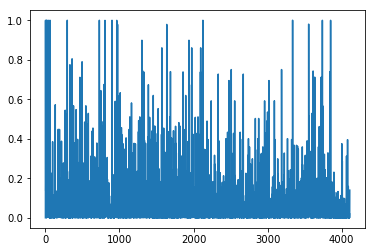

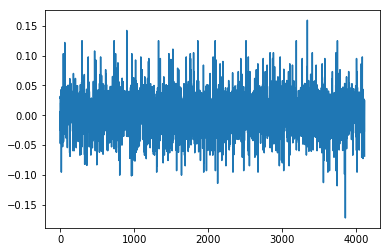

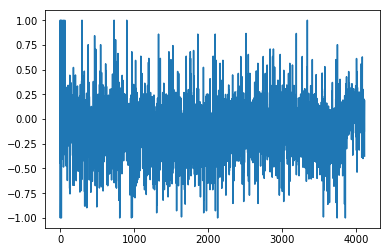

1.45541471847
[ 0.66666667  0.88888889  0.77777778  0.66666667  0.66666667  0.77777778
  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.          0.66666667  0.88888889  0.77777778  0.77777778
  0.          0.66666667  0.66666667  0.88888889  0.88888889  0.66666667
  0.88888889  0.88888889  0.66666667  0.77777778  0.66666667  0.66666667
  0.77777778  0.66666667  0.88888889  0.66666667  0.88888889  0.55555556
  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667  0.88888889
  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.88888889  0.66666667  0.66666667  0.55555556]
Writing away results
1988-10-01 00:00:00


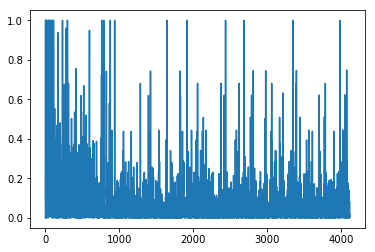

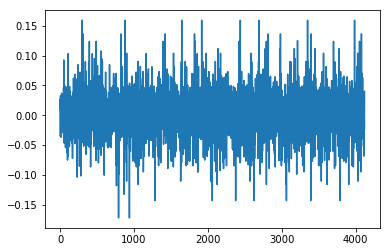

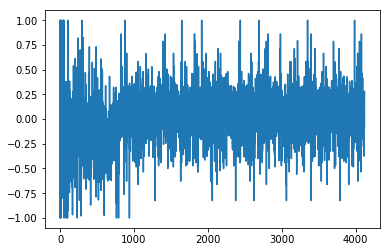

1.51207467989
[ 0.66666667  1.          0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          0.66666667]
Writing away results
1988-11-01 00:00:00


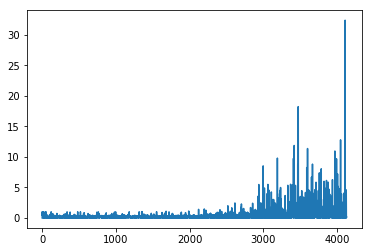

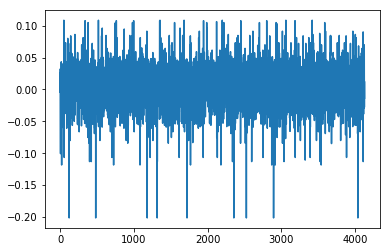

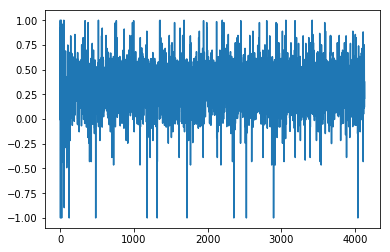

1.47171034368
[ 0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1988-12-01 00:00:00


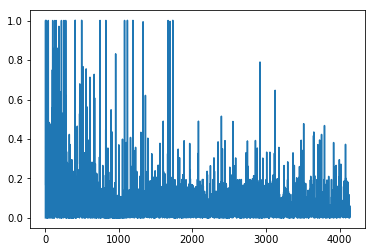

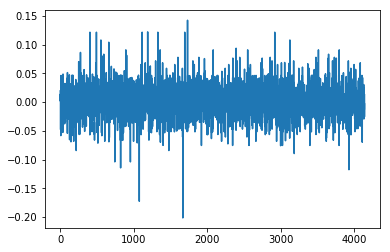

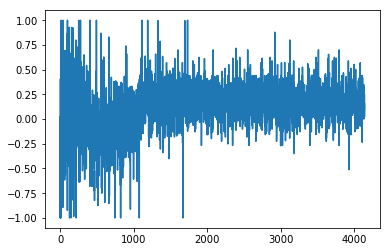

1.4034037799
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333
  0.33333333  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.55555556
  0.33333333  0.33333333  0.33333333  0.33333333  0.55555556  0.33333333
  0.55555556  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
1989-01-01 00:00:00


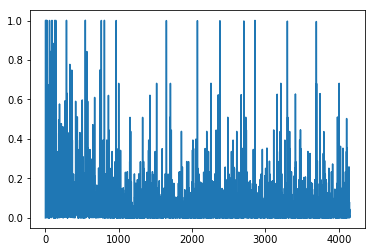

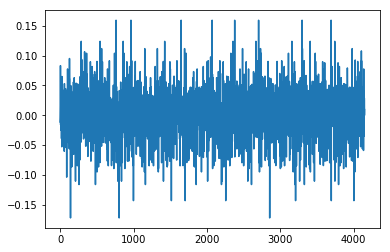

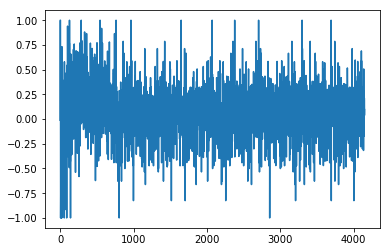

1.44928307337
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.          1.          1.          0.66666667  0.66666667  0.66666667
  1.          1.          1.          1.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  1.          0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1989-02-01 00:00:00


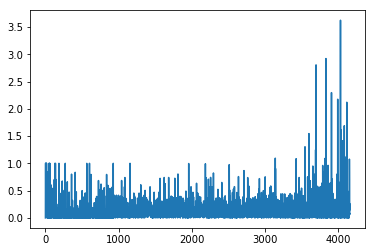

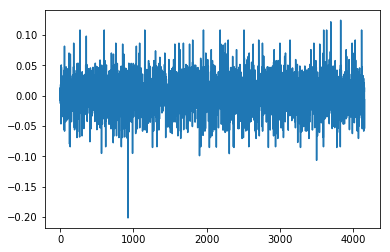

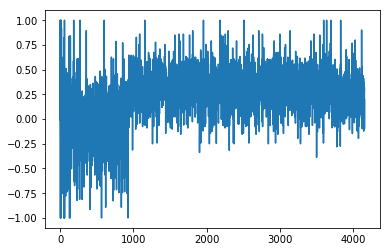

1.48611170209
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.44444444  0.44444444
  0.44444444  0.44444444  0.66666667  0.44444444  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1989-03-01 00:00:00


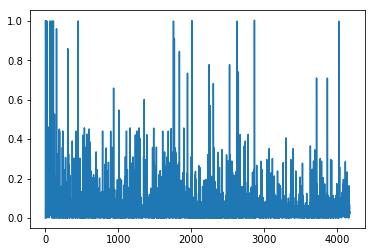

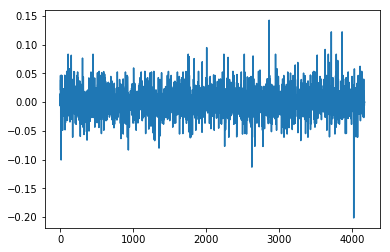

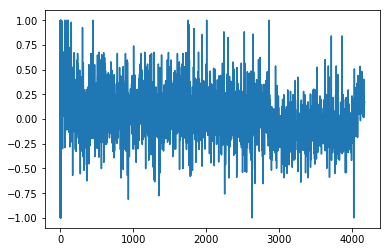

1.29970878074
[ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.22222222  0.22222222  0.22222222
  0.22222222  0.          0.          0.55555556  0.          0.22222222
  0.22222222  0.22222222  0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.22222222  0.
  0.22222222  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.22222222  0.          0.          0.          0.          0.22222222
  0.        ]
Writing away results
1989-04-01 00:00:00


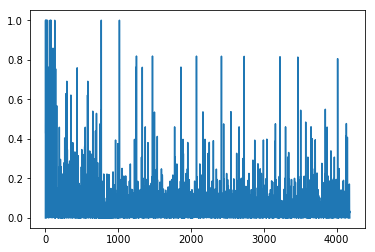

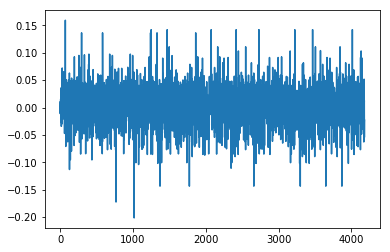

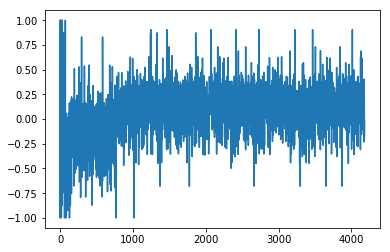

1.33021673893
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889]
Writing away results
1989-05-01 00:00:00


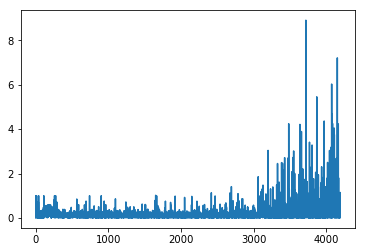

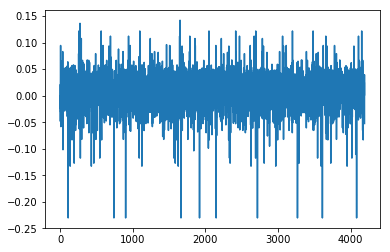

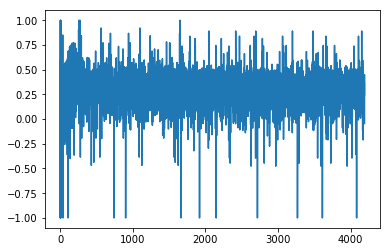

1.13992877127
[ 1.          1.          1.          1.          1.          0.22222222
  0.22222222  1.          0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          1.          0.22222222  0.22222222  0.22222222
  1.          1.          1.          1.          1.          1.          1.
  0.22222222  1.          1.          1.          1.          0.22222222
  1.          1.          1.          0.22222222  0.22222222  1.
  0.22222222  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.22222222  1.          1.
  0.22222222  0.22222222]
Writing away results
1989-06-01 00:00:00


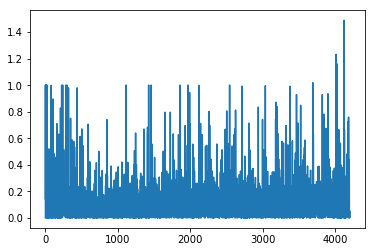

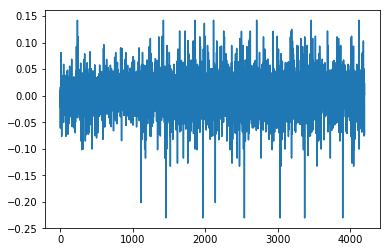

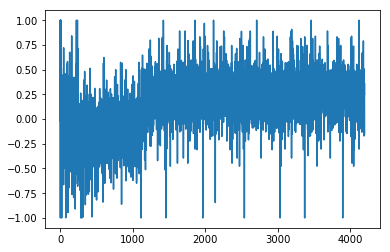

1.33295832874
[ 1.          1.          1.          1.          1.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  1.          0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  1.          1.          1.          1.          0.88888889  1.          1.
  1.          1.          0.88888889  1.          1.          1.          1.
  0.88888889  0.88888889  0.88888889  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.88888889  0.88888889  0.88888889]
Writing away results
1989-07-01 00:00:00


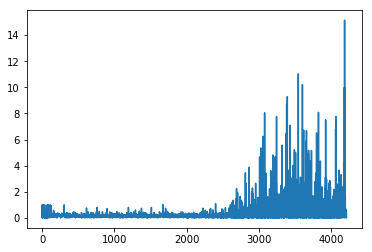

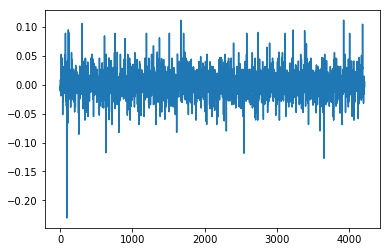

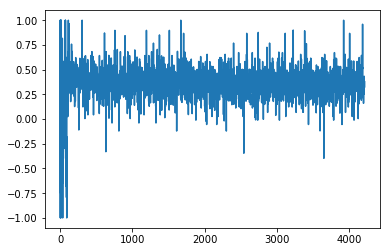

1.18748980149
[ 0.          0.          0.          0.11111111  0.11111111  0.
  0.11111111  0.11111111  0.11111111  0.11111111  0.          0.          0.
  0.11111111  0.11111111  0.11111111  0.          0.          0.          0.
  0.          0.          0.          0.11111111  0.          0.          0.
  0.          0.11111111  0.          0.          0.          0.
  0.11111111  0.          0.11111111  0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.11111111
  0.          0.          0.          0.          0.          0.
  0.11111111  0.          0.          0.11111111  0.11111111  0.11111111
  0.11111111]
Writing away results
1989-08-01 00:00:00


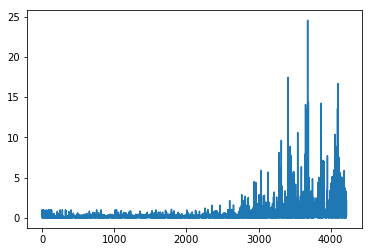

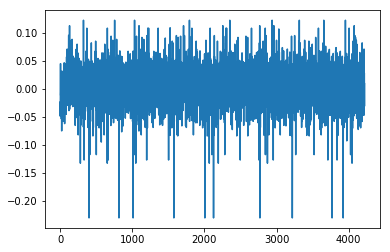

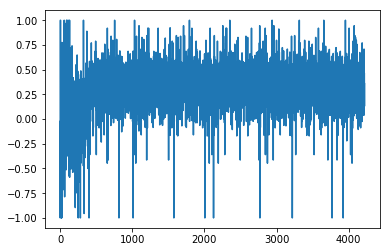

1.15442571284
[ 1.          1.          0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          1.          0.66666667  1.          1.          1.
  1.          0.66666667  1.          1.          1.          0.66666667
  0.66666667  1.          0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.66666667
  1.          1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667]
Writing away results
1989-09-01 00:00:00


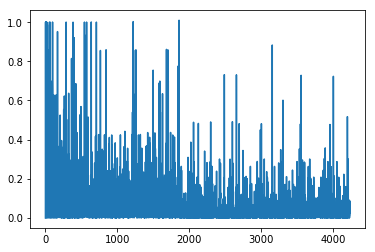

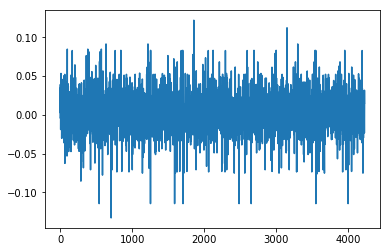

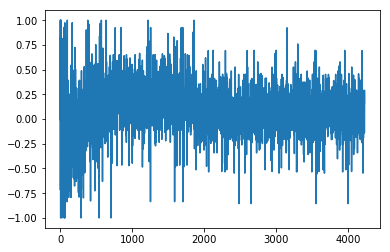

1.20625075792
[ 0.55555556  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.22222222  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  0.55555556  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556]
Writing away results
1989-10-01 00:00:00


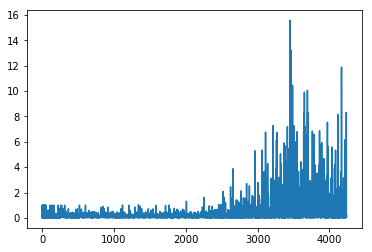

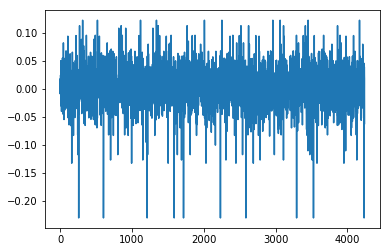

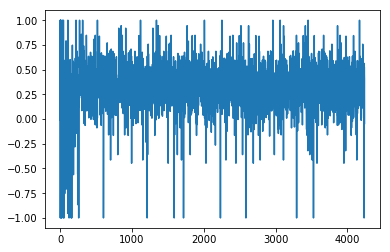

1.04767630509
[ 0.  0.  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.
  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.
  0.  0.  0.  1.  1.]
Writing away results
1989-11-01 00:00:00


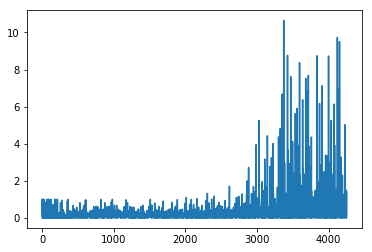

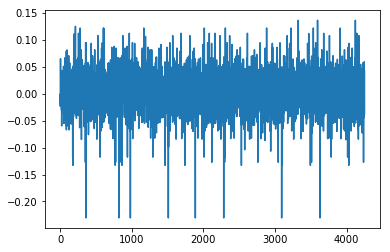

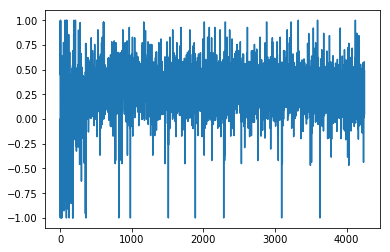

1.22836784797
[ 0.66666667  1.          0.66666667  0.66666667  0.66666667  0.66666667
  1.          1.          1.          0.66666667  0.66666667  0.66666667
  1.          1.          1.          1.          1.          1.          1.
  0.66666667  1.          1.          1.          1.          0.66666667
  1.          1.          1.          0.66666667  0.66666667  1.
  0.66666667  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.66666667  1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.
  1.        ]
Writing away results
1989-12-01 00:00:00


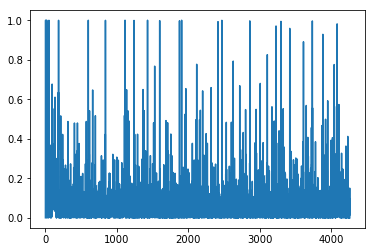

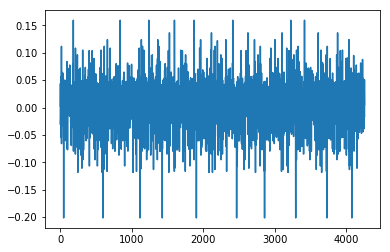

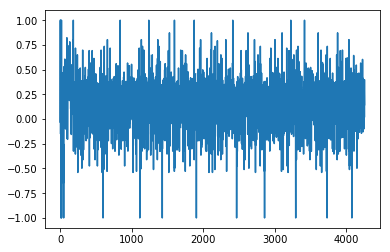

1.23505438062
[ 1.          1.          1.          1.          1.          0.88888889
  0.88888889  0.88888889  1.          1.          1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.
  0.88888889  0.88888889  0.88888889  0.88888889  1.          0.88888889
  1.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  1.          1.          1.          1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1990-01-01 00:00:00


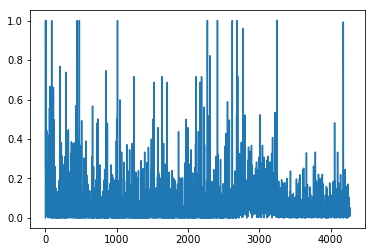

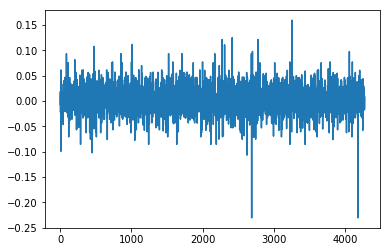

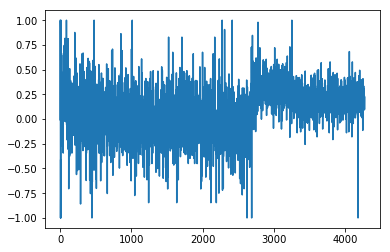

1.22075233331
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.33333333  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  0.44444444  0.33333333
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.33333333  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.44444444  0.44444444  0.33333333  0.44444444  0.33333333]
Writing away results
1990-02-01 00:00:00


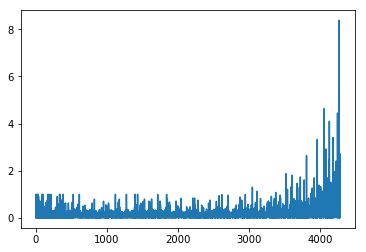

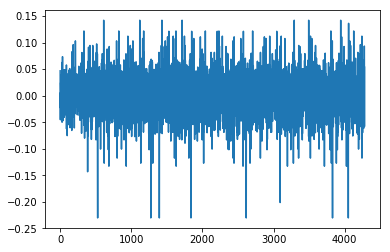

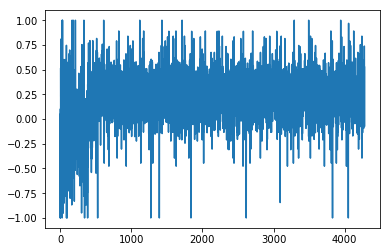

1.32841300751
[ 0.88888889  0.88888889  0.88888889  1.          1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.          1.
  1.          1.          1.          0.88888889  1.          1.          1.
  1.          0.88888889  1.          1.          1.          1.
  0.88888889  1.          0.88888889  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.88888889  0.88888889  0.88888889  0.88888889
  1.          1.          1.          1.          0.88888889  0.88888889]
Writing away results
1990-03-01 00:00:00


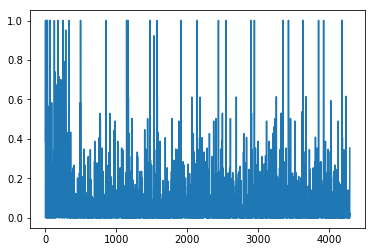

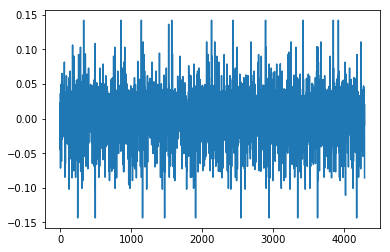

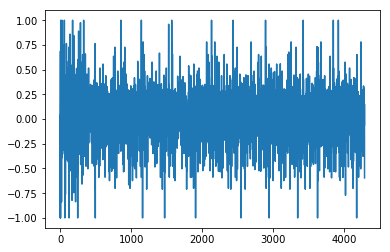

1.32698587827
[ 0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.66666667  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.11111111  0.66666667  0.88888889  0.88888889  0.66666667]
Writing away results
1990-04-01 00:00:00


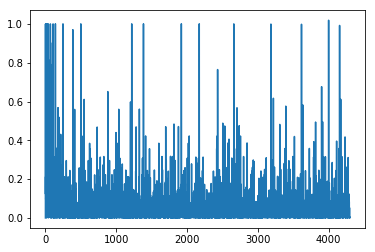

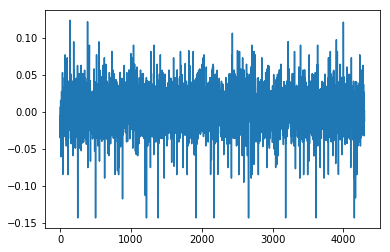

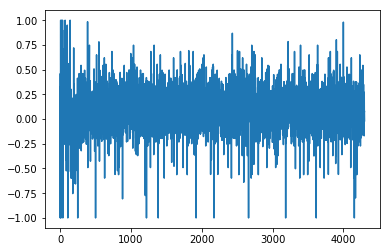

1.30586936929
[ 0.33333333  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667  0.33333333
  0.66666667  0.33333333  0.33333333  0.66666667  0.66666667]
Writing away results
1990-05-01 00:00:00


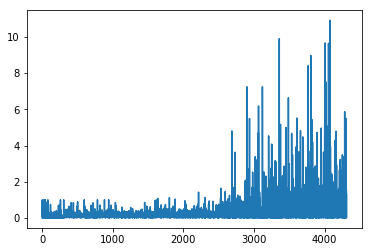

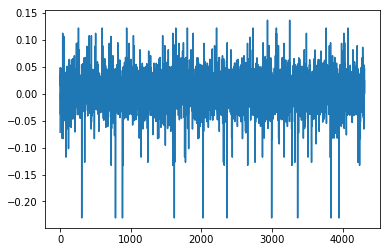

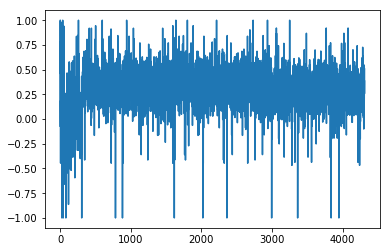

1.22665587919
[ 1.          1.          1.          0.11111111  0.11111111  0.11111111
  1.          1.          1.          1.          1.          1.          1.
  0.11111111  1.          1.          1.          1.          0.11111111
  1.          1.          1.          0.11111111  0.11111111  1.
  0.11111111  1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.11111111  1.          1.          1.
  1.          1.          1.          0.11111111  1.          1.
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  1.          1.
  1.          1.          0.11111111  0.11111111  1.          1.          1.        ]
Writing away results
1990-06-01 00:00:00


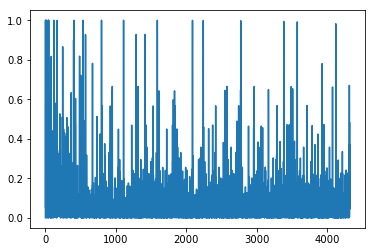

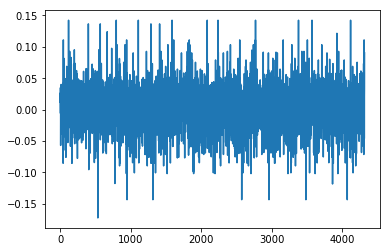

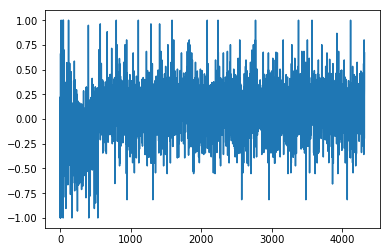

1.3881815728
[ 0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667]
Writing away results
1990-07-01 00:00:00


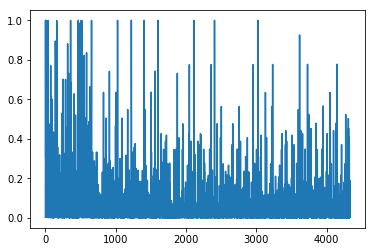

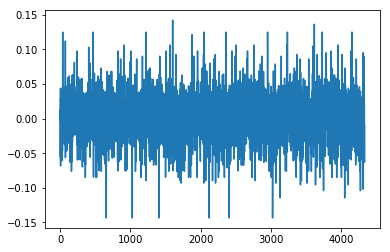

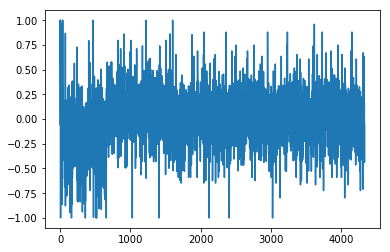

1.40956103985
[ 0.66666667  0.66666667  0.77777778  0.77777778  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778
  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.77777778  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.77777778  0.77777778  0.88888889  0.77777778  0.77777778
  0.66666667  0.66666667  0.77777778  0.66666667  0.77777778  0.77777778
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1990-08-01 00:00:00


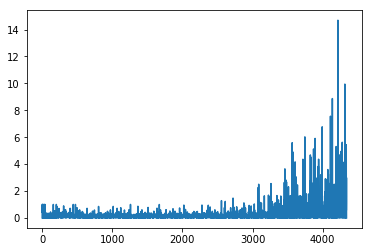

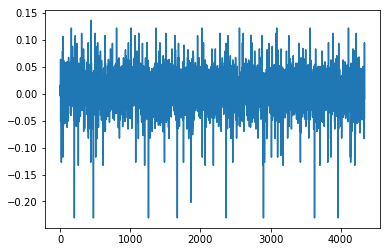

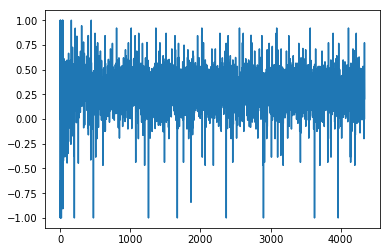

1.58300263762
[ 0.22222222  0.22222222  0.22222222  1.          1.          1.          1.
  1.          1.          1.          0.22222222  1.          1.          1.
  1.          0.22222222  1.          1.          1.          0.22222222
  0.22222222  1.          0.22222222  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.22222222
  1.          1.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  1.          1.          1.          1.          0.22222222
  0.22222222  1.          1.          1.          1.          1.          1.        ]
Writing away results
1990-09-01 00:00:00


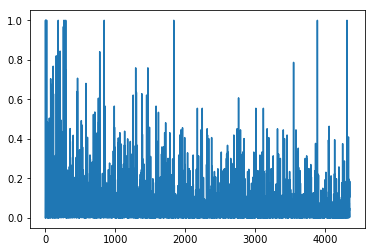

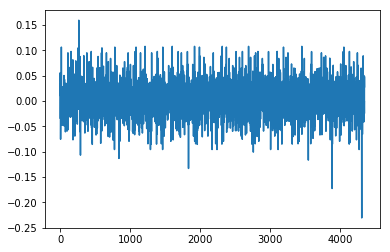

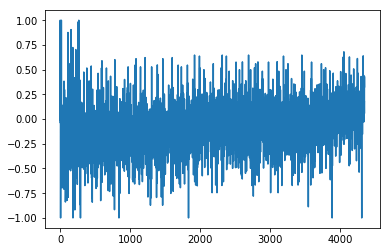

1.75443250698
[ 0.11111111  0.66666667  0.11111111  0.77777778  1.          1.          1.
  1.          1.          0.88888889  1.          1.          0.77777778
  1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.77777778  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.77777778  1.          1.          1.          1.          1.
  0.66666667  0.11111111  0.11111111  0.66666667  0.11111111  0.11111111
  0.66666667  1.          0.11111111  1.          0.11111111  0.11111111
  0.66666667  1.          1.          1.          1.          1.          1.        ]
Writing away results
1990-10-01 00:00:00


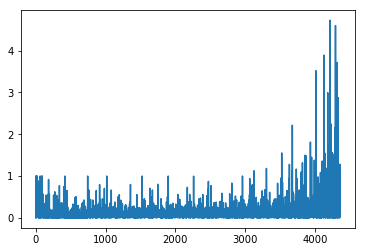

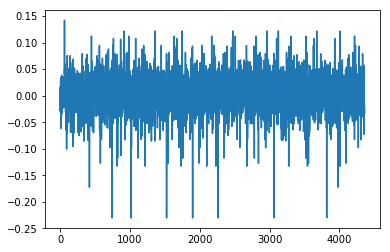

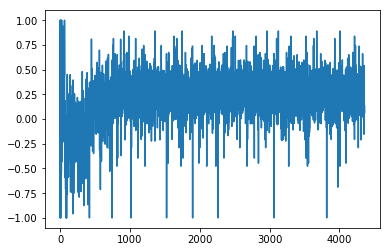

1.69567066589
[ 0.33333333  0.33333333  1.          1.          1.          1.          1.
  1.          0.33333333  1.          1.          1.          1.
  0.33333333  1.          1.          1.          1.          0.33333333
  1.          0.33333333  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  1.          1.
  1.          1.          0.33333333  0.33333333  1.          1.          1.
  1.          1.          1.          1.          1.        ]
Writing away results
1990-11-01 00:00:00


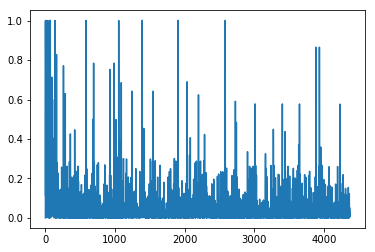

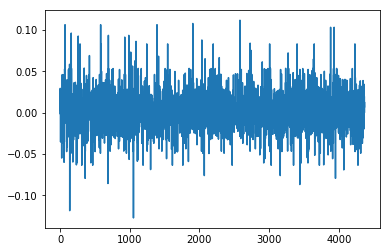

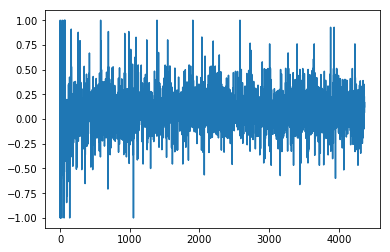

1.30152198237
[ 0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.11111111  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.22222222  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.11111111  0.11111111  0.22222222  0.11111111
  0.22222222  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1990-12-01 00:00:00


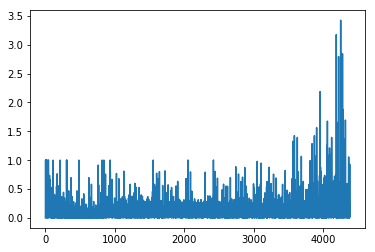

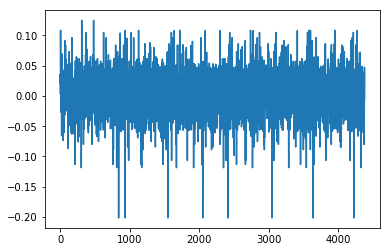

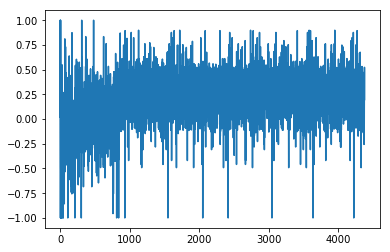

1.68920518422
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1991-01-01 00:00:00


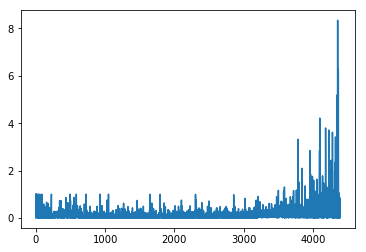

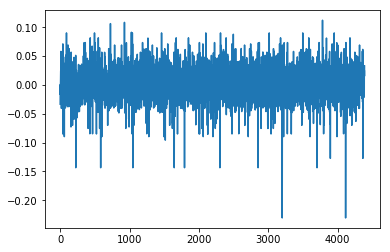

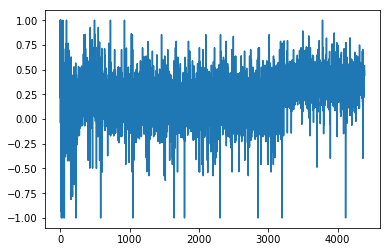

1.51594886669
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1991-02-01 00:00:00


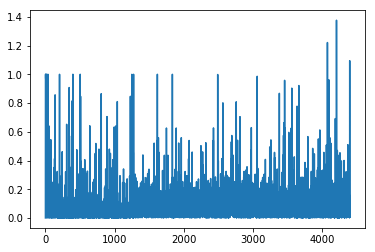

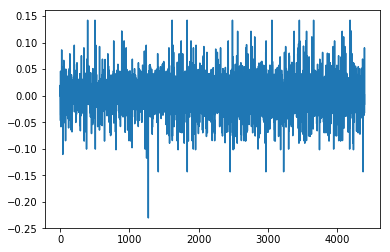

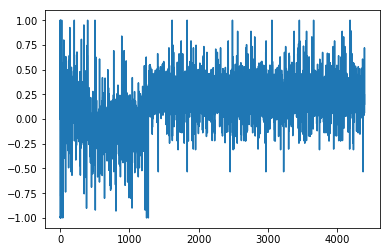

1.54117243179
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1991-03-01 00:00:00


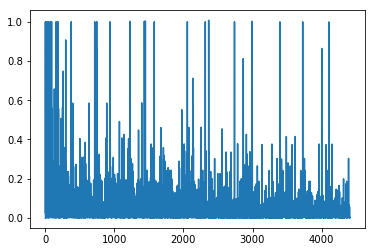

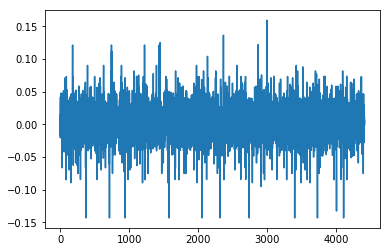

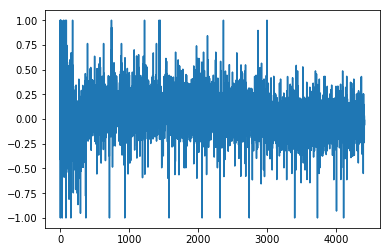

1.47305692071
[ 0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.44444444  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1991-04-01 00:00:00


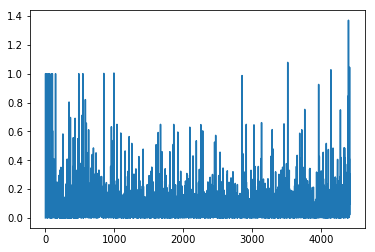

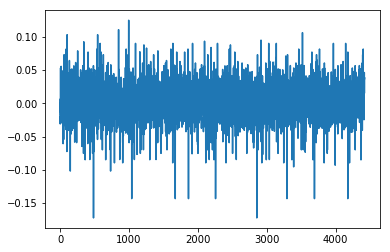

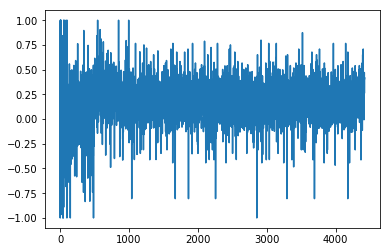

1.42392052689
[ 0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1991-05-01 00:00:00


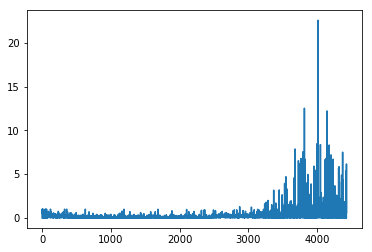

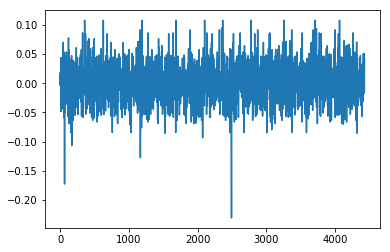

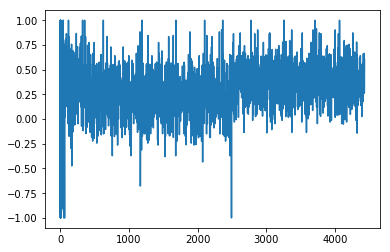

1.35901386164
[ 0.11111111  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.11111111  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
1991-06-01 00:00:00


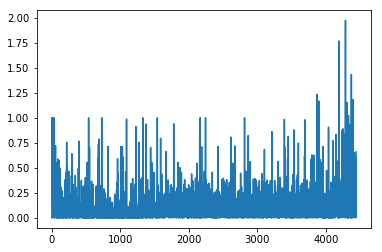

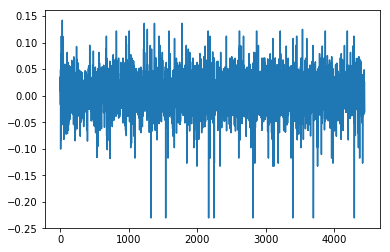

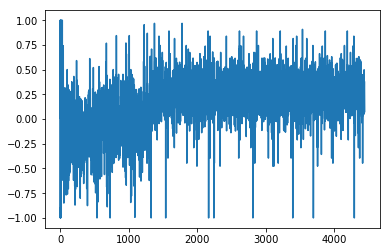

1.63584838207
[ 0.44444444  1.          1.          1.          1.          0.44444444
  1.          1.          1.          1.          0.44444444  0.44444444
  0.44444444  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.44444444  0.44444444  0.44444444  0.44444444  1.          1.          1.
  1.          0.44444444  0.44444444  0.44444444  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.        ]
Writing away results
1991-07-01 00:00:00


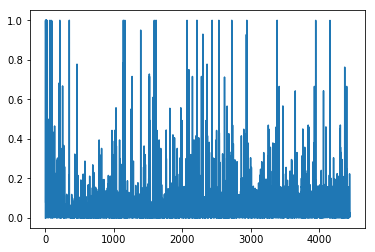

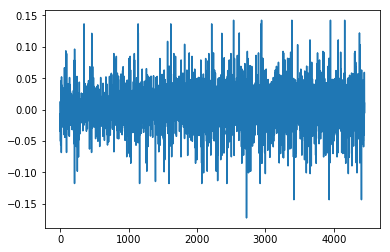

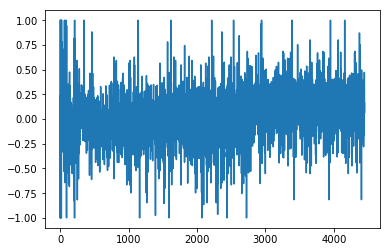

1.48550780297
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.88888889  0.66666667  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1991-08-01 00:00:00


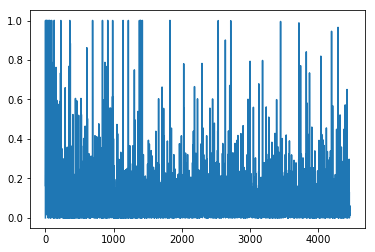

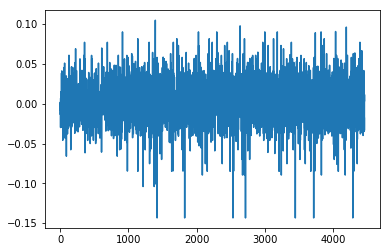

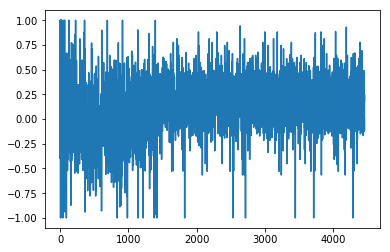

1.35055821827
[ 0.66666667  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.66666667  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1991-09-01 00:00:00


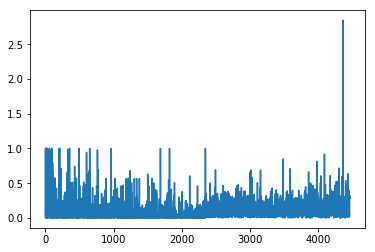

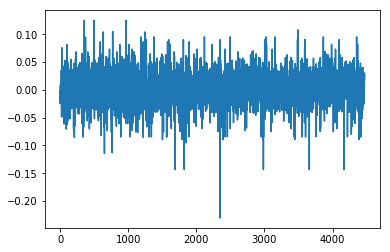

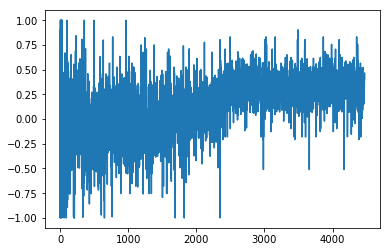

1.33810353036
[ 0.66666667  0.66666667  0.          0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.          0.          0.          0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.        ]
Writing away results
1991-10-01 00:00:00


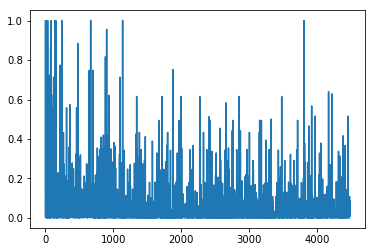

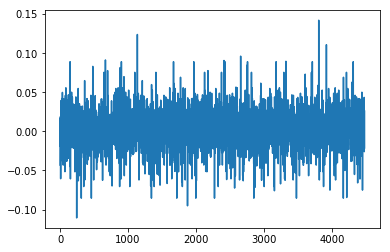

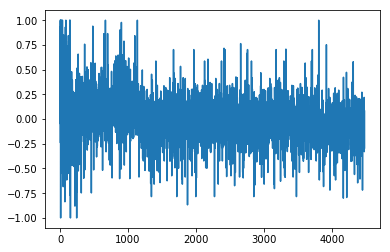

1.30498965401
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.11111111  0.44444444  0.22222222  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.44444444  0.44444444  0.11111111
  0.44444444  0.11111111  0.11111111  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.66666667  0.11111111  0.44444444]
Writing away results
1991-11-01 00:00:00


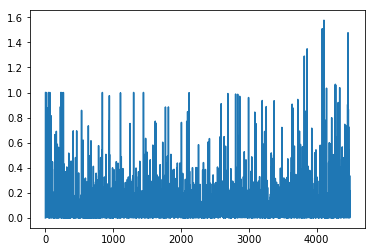

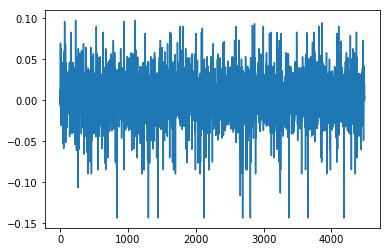

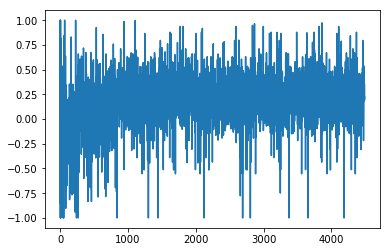

1.41478827495
[ 0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.66666667]
Writing away results
1991-12-01 00:00:00


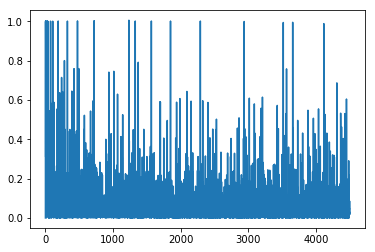

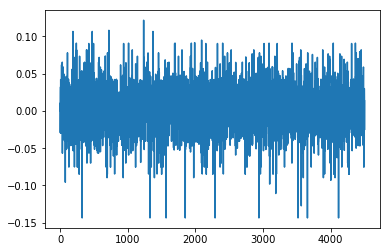

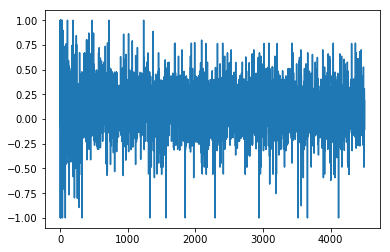

1.45828989796
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.55555556  0.55555556  0.66666667  0.66666667]
Writing away results
1992-01-01 00:00:00


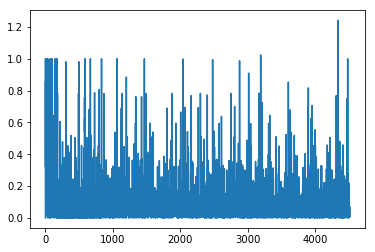

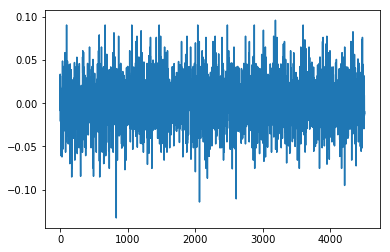

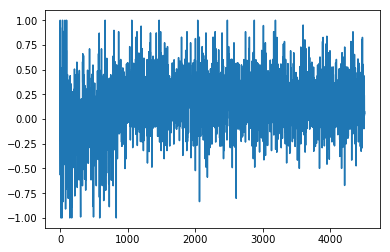

1.26648484485
[ 0.22222222  0.22222222  0.22222222  0.55555556  0.22222222  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222]
Writing away results
1992-02-01 00:00:00


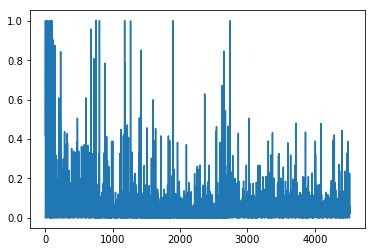

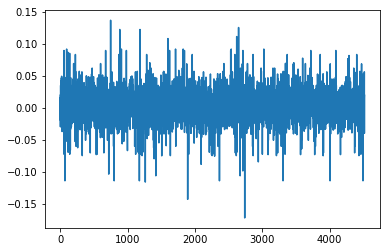

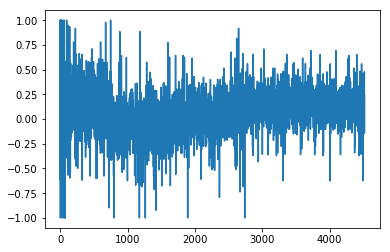

1.37210675357
[ 0.55555556  0.55555556  0.11111111  0.55555556  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556
  0.55555556  0.11111111  0.55555556  0.11111111  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1992-03-01 00:00:00


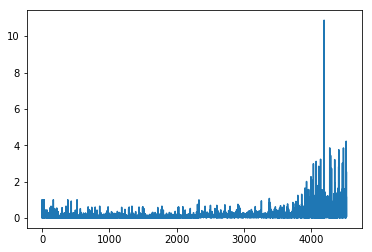

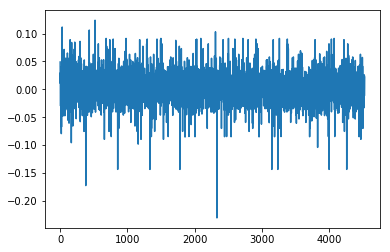

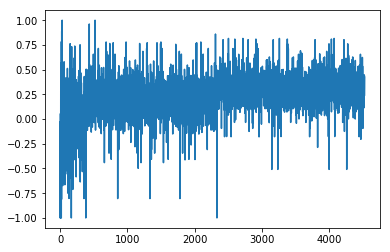

1.43688002415
[ 0.66666667  0.11111111  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1992-04-01 00:00:00


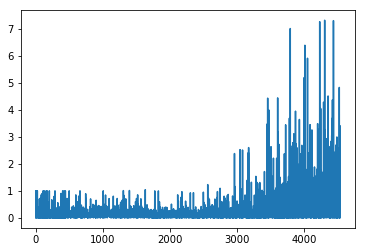

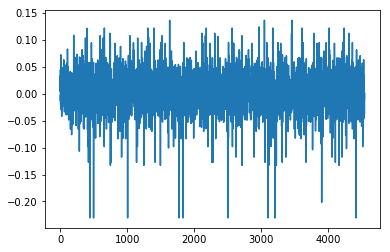

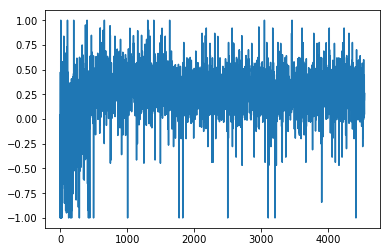

1.45797672382
[ 0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.
  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.  0.  0.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  1.
  1.  1.  1.  1.  1.]
Writing away results
1992-05-01 00:00:00


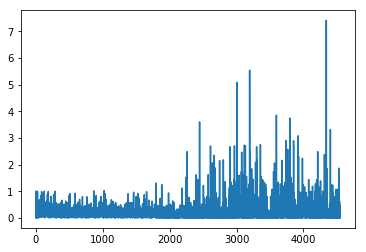

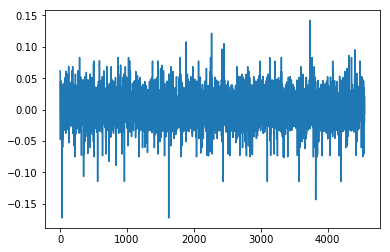

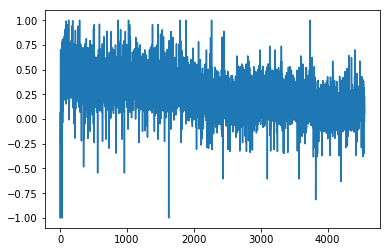

1.36221372235
[ 0.55555556  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.33333333  0.55555556  0.55555556  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556
  0.33333333  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.33333333  0.33333333  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333]
Writing away results
1992-06-01 00:00:00


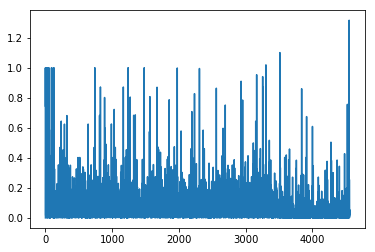

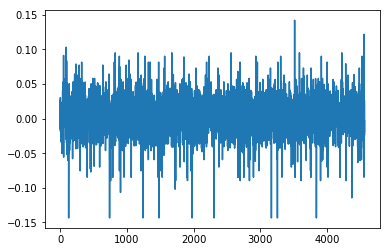

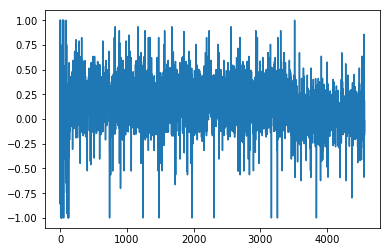

1.44933573257
[ 0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.66666667]
Writing away results
1992-07-01 00:00:00


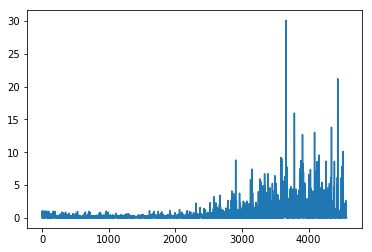

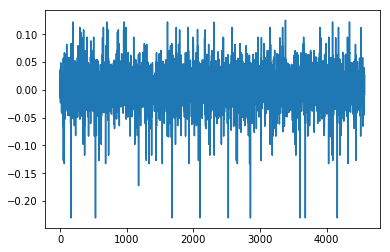

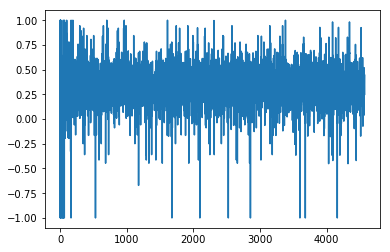

1.68965964323
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.22222222  1.          1.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  1.          1.
  0.22222222  1.          0.22222222  0.22222222  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.22222222  0.22222222  1.          1.          1.          1.
  1.          1.          0.22222222  1.          1.        ]
Writing away results
1992-08-01 00:00:00


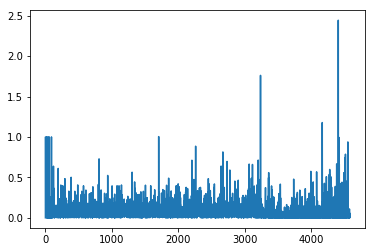

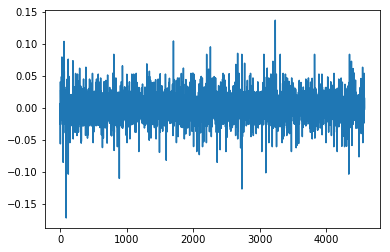

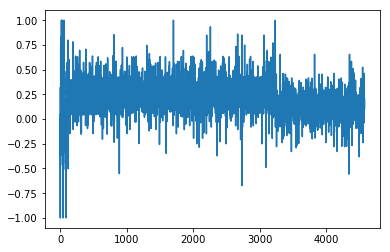

1.11876381187
[ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.          0.          0.          0.
  0.22222222  0.22222222  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.22222222  0.22222222  0.          0.          0.          0.          0.
  0.          0.22222222  0.          0.          0.        ]
Writing away results
1992-09-01 00:00:00


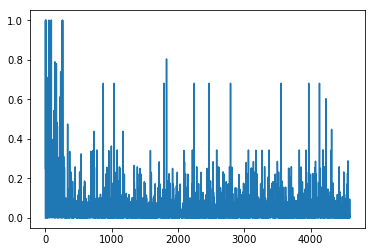

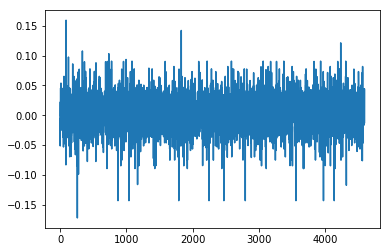

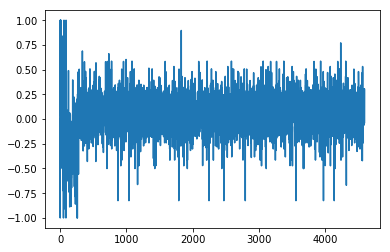

1.5752496712
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667
  0.55555556  0.66666667  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1992-10-01 00:00:00


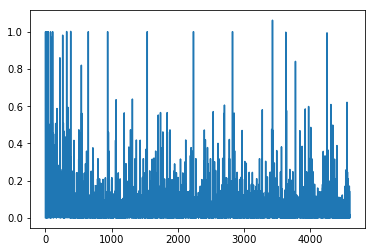

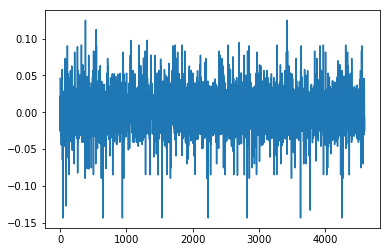

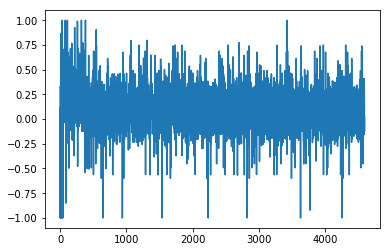

1.58034507521
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1992-11-01 00:00:00


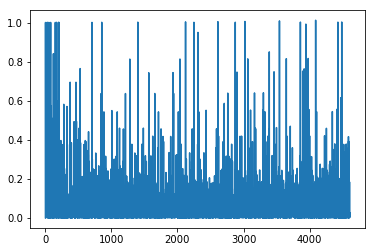

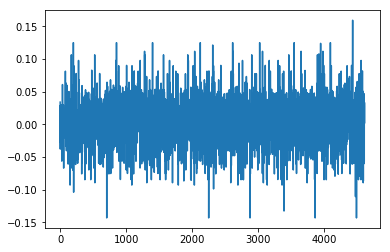

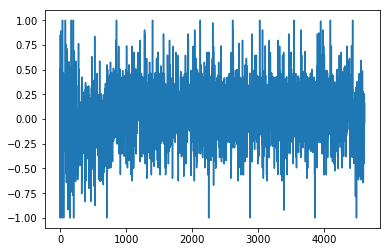

1.62988226168
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.77777778  1.          1.          1.
  1.          0.66666667  0.66666667  0.77777778  0.66666667  1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.77777778  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667]
Writing away results
1992-12-01 00:00:00


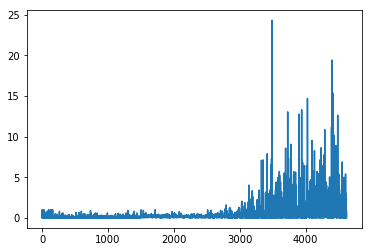

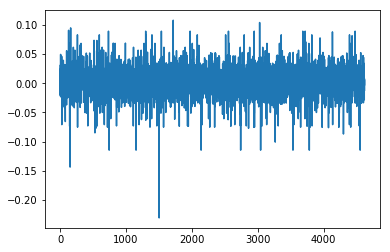

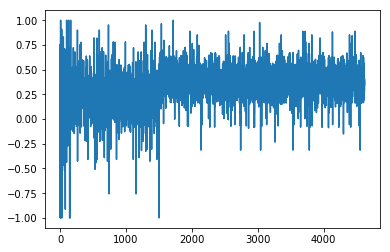

1.39384298403
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.55555556  0.55555556  0.11111111  0.55555556  0.11111111
  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1993-01-01 00:00:00


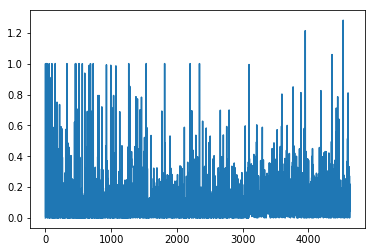

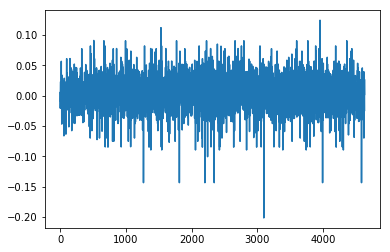

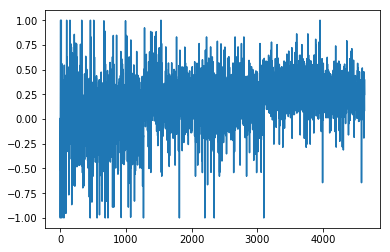

1.5380658246
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1993-02-01 00:00:00


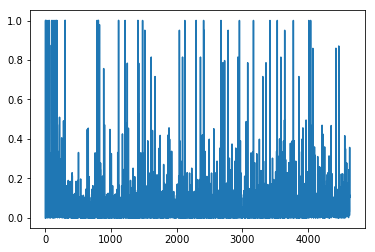

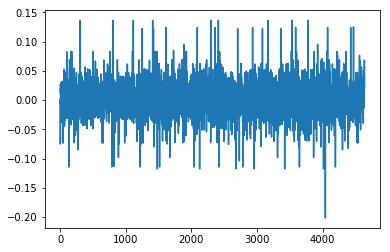

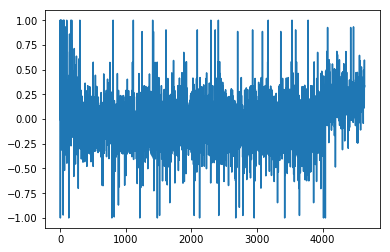

1.41290283458
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  1.          0.22222222  0.22222222  0.22222222  0.22222222  0.55555556
  0.55555556  1.          0.55555556  0.22222222  0.22222222  0.22222222
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1993-03-01 00:00:00


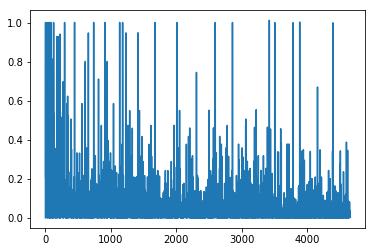

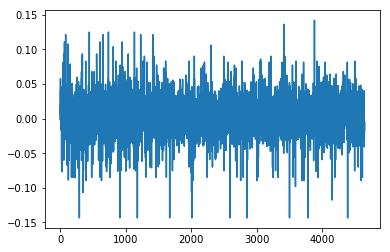

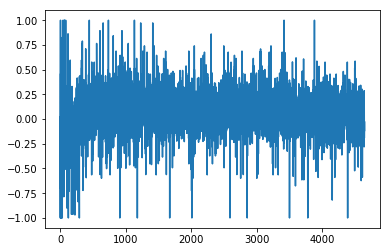

1.57208083291
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667
  0.22222222  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1993-04-01 00:00:00


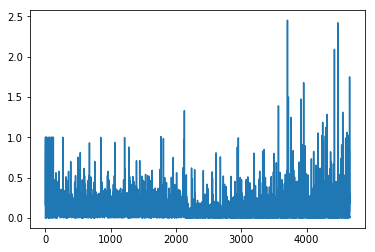

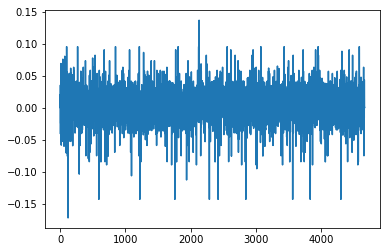

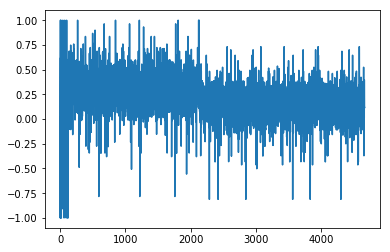

1.59638229252
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.          0.
  0.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1993-05-01 00:00:00


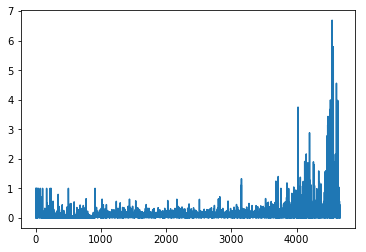

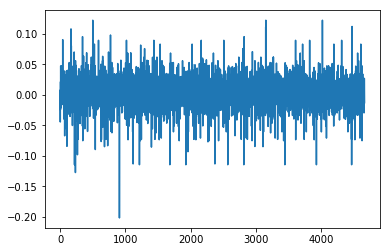

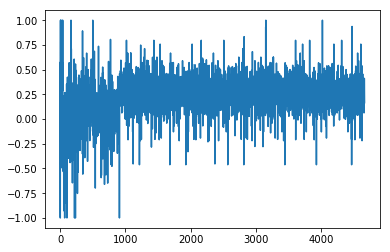

1.49327346865
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.11111111  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1993-06-01 00:00:00


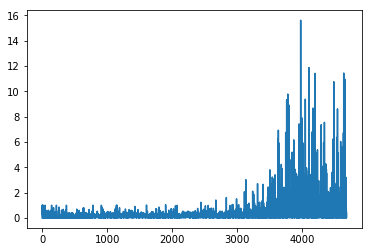

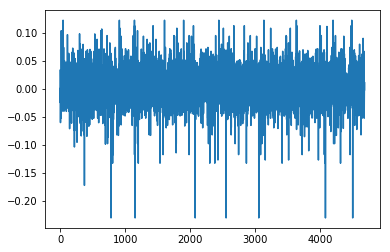

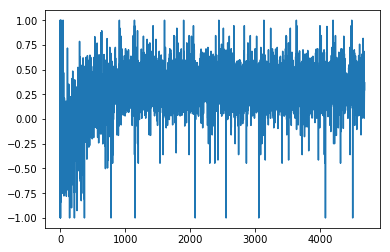

1.93125533455
[ 1.          1.          1.          1.          1.          0.44444444
  1.          1.          0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  1.          1.          1.          1.          0.44444444
  0.44444444  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.44444444
  0.44444444  1.          1.          1.          1.          1.          1.
  0.44444444  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.        ]
Writing away results
1993-07-01 00:00:00


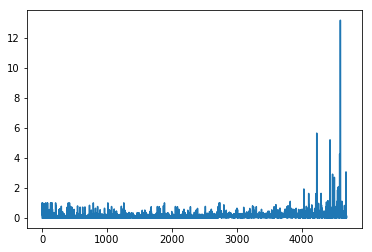

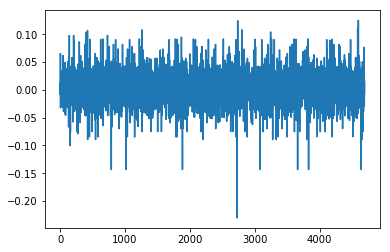

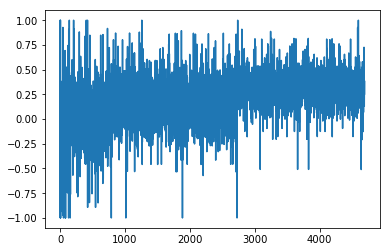

1.6629414653
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1993-08-01 00:00:00


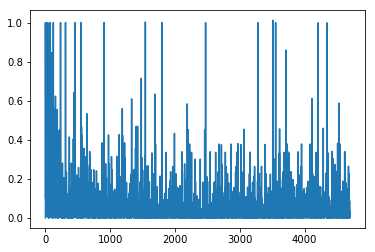

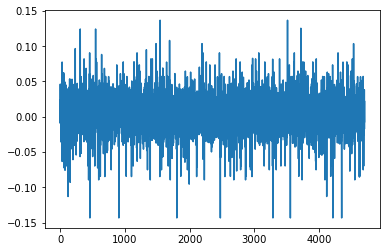

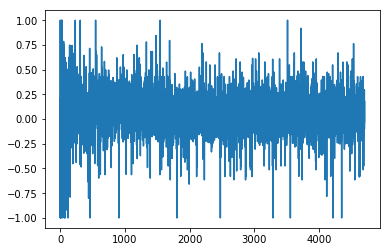

1.55880006368
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.33333333  0.66666667  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1993-09-01 00:00:00


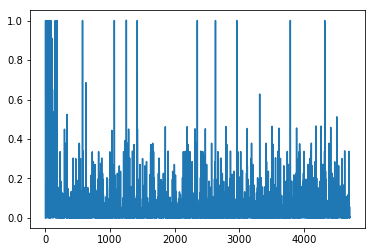

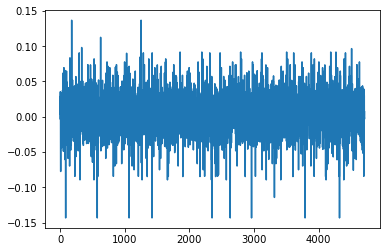

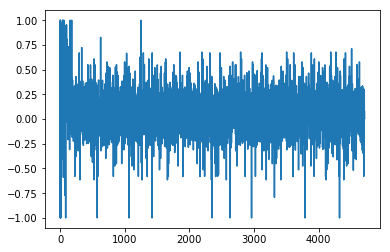

1.47239501271
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444]
Writing away results
1993-10-01 00:00:00


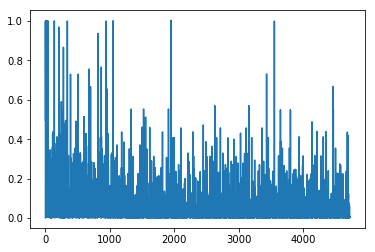

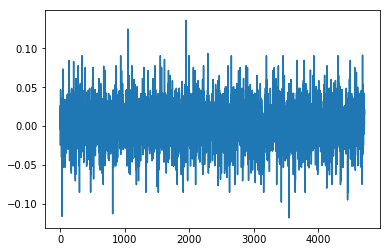

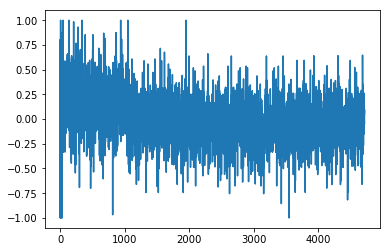

1.31773731851
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.44444444  0.44444444  0.66666667
  0.44444444  0.55555556  0.55555556  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.66666667  0.55555556  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.55555556
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.55555556  0.55555556]
Writing away results
1993-11-01 00:00:00


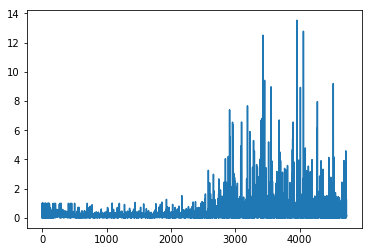

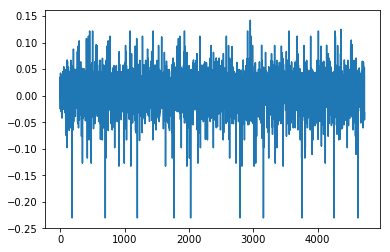

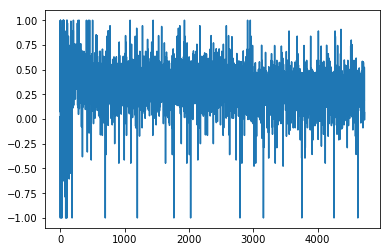

1.90627358737
[ 1.          1.          1.          0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  1.          1.          1.          1.
  0.22222222  0.22222222  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.22222222  0.22222222  1.          1.          1.          1.          1.
  1.          0.22222222  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.22222222  0.22222222  0.22222222]
Writing away results
1993-12-01 00:00:00


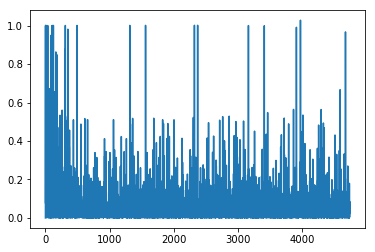

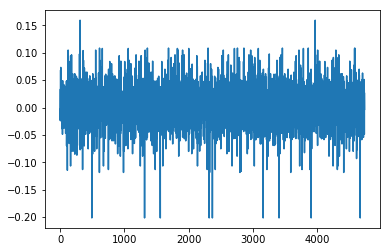

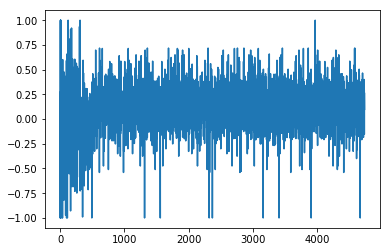

1.84620302815
[ 0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1994-01-01 00:00:00


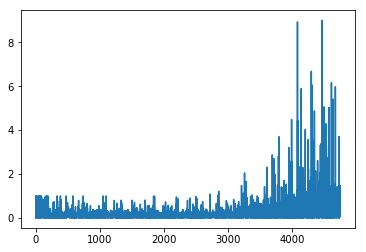

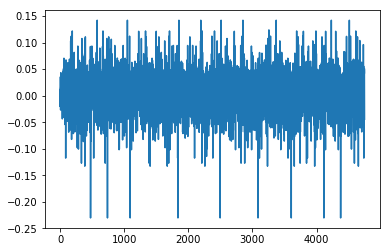

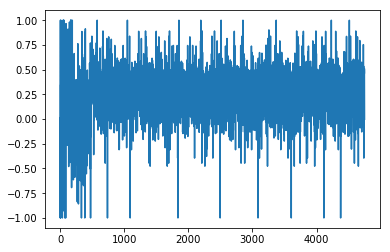

2.0713449131
[ 1.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  1.          1.          1.          1.          0.88888889  0.88888889
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.88888889  0.88888889
  1.          1.          1.          1.          1.          1.
  0.88888889  0.88888889  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.88888889  0.88888889  0.88888889  1.          1.        ]
Writing away results
1994-02-01 00:00:00


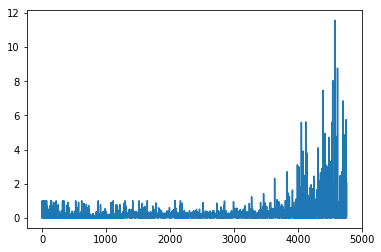

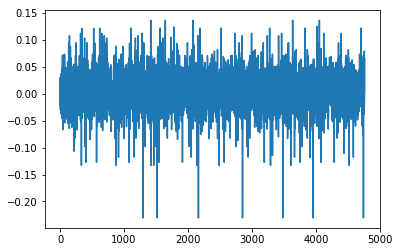

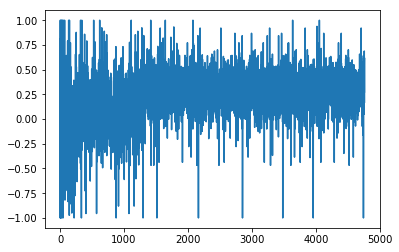

2.19191370685
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  1.          1.
  1.          1.          0.44444444  0.44444444  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.44444444  0.44444444  1.          1.          1.          1.
  1.          1.          0.44444444  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.44444444  0.44444444
  0.44444444  1.          1.          1.        ]
Writing away results
1994-03-01 00:00:00


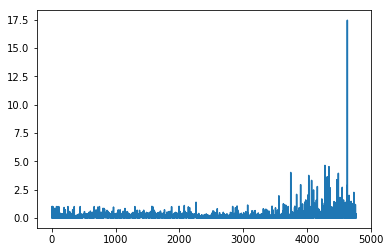

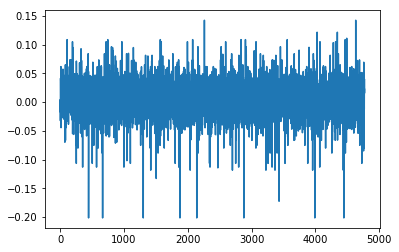

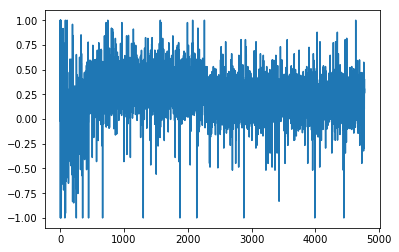

2.0205749759
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889
  0.88888889  0.88888889  0.44444444  0.44444444  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444  0.44444444
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444  0.44444444
  0.44444444  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1994-04-01 00:00:00


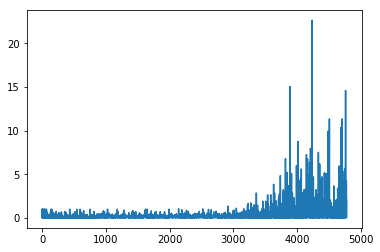

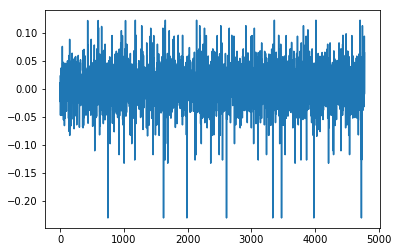

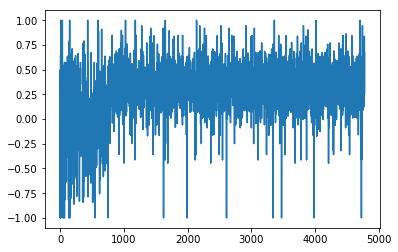

2.22960476648
[ 0.  0.  0.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.
  1.  1.  1.  1.  1.]
Writing away results
1994-05-01 00:00:00


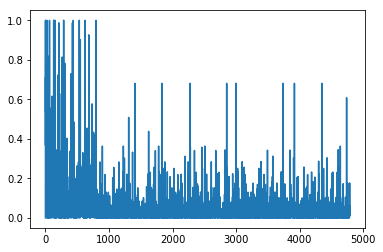

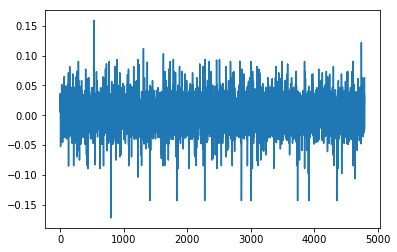

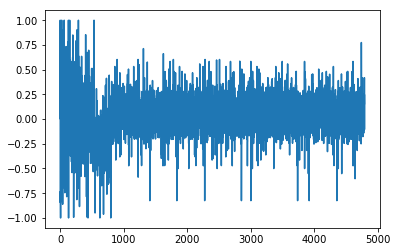

1.8826141852
[ 0.44444444  0.44444444  0.66666667  0.66666667  0.44444444  0.66666667
  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1994-06-01 00:00:00


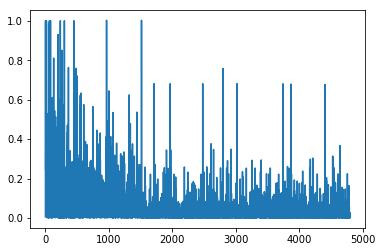

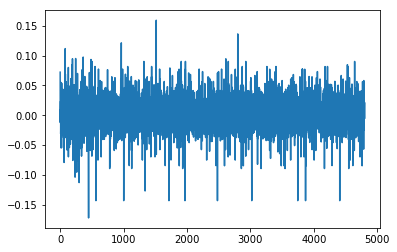

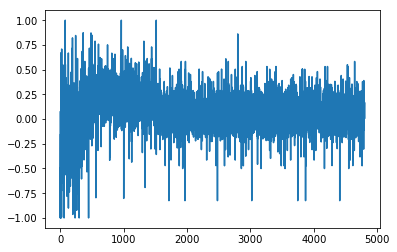

1.78441030921
[ 0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1994-07-01 00:00:00


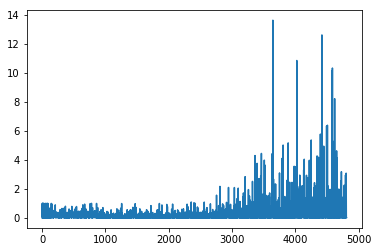

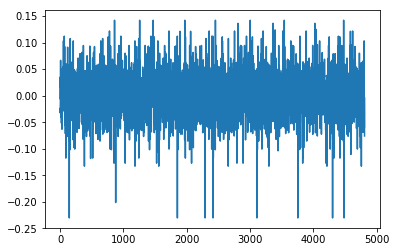

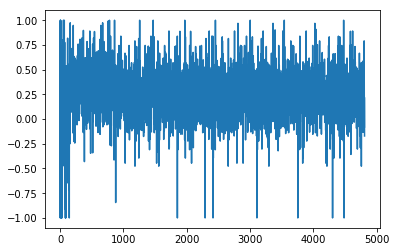

2.43831472154
[ 1.          1.          1.          1.          0.88888889  0.88888889
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.88888889  0.88888889
  1.          1.          1.          1.          1.          1.
  0.88888889  1.          1.          1.          1.          1.          1.
  0.88888889  1.          1.          1.          1.          1.          1.
  0.88888889  1.          0.88888889  0.88888889  0.88888889  1.          1.
  1.          1.          1.          1.          1.          1.        ]
Writing away results
1994-08-01 00:00:00


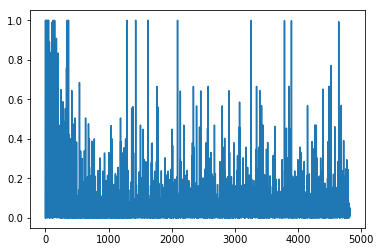

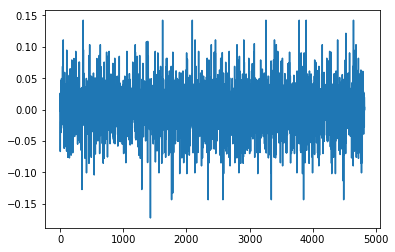

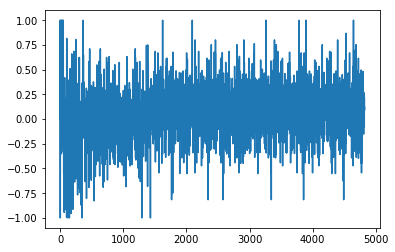

1.84663570452
[ 0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667]
Writing away results
1994-09-01 00:00:00


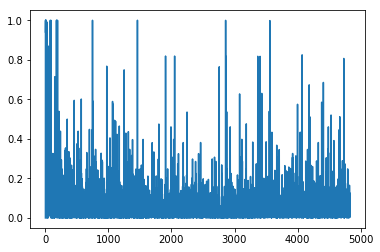

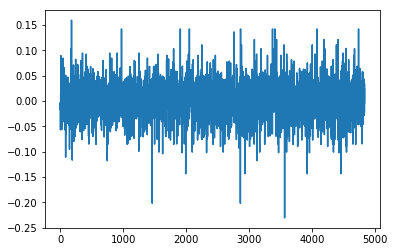

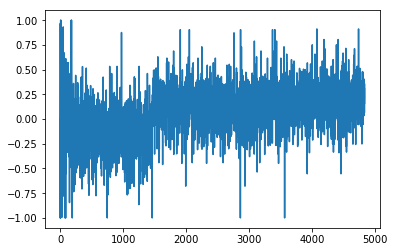

1.8669008921
[ 0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667]
Writing away results
1994-10-01 00:00:00


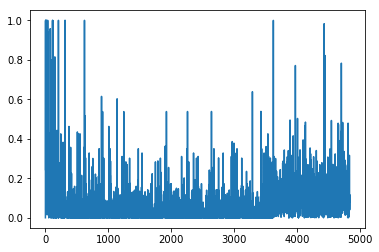

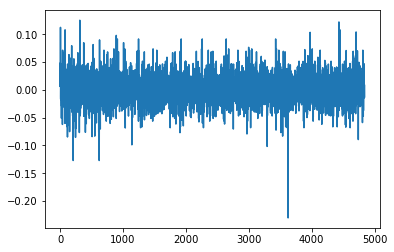

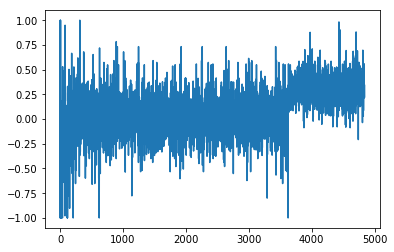

1.41912936011
[ 0.33333333  0.44444444  0.44444444  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.44444444  0.33333333  0.33333333  0.44444444]
Writing away results
1994-11-01 00:00:00


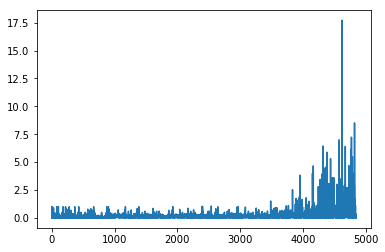

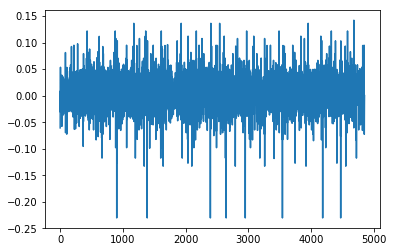

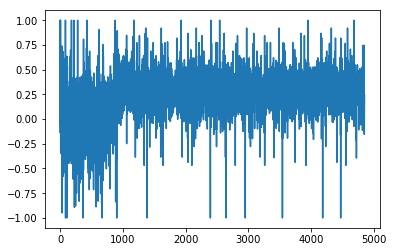

2.16157689862
[ 0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  0.  0.]
Writing away results
1994-12-01 00:00:00


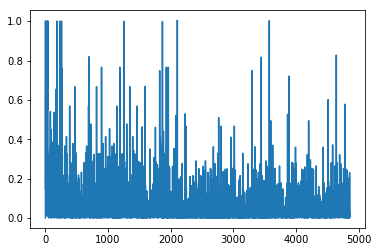

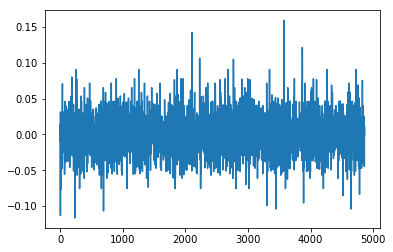

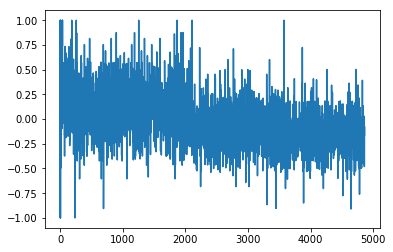

1.71493183705
[ 0.55555556  0.          0.22222222  0.44444444  0.77777778  0.
  0.44444444  0.77777778  0.77777778  0.77777778  0.44444444  0.22222222
  0.          0.33333333  0.77777778  0.77777778  0.55555556  0.55555556
  0.44444444  0.44444444  0.55555556  0.          0.44444444  0.22222222
  0.44444444  0.22222222  0.          0.55555556  0.55555556  0.
  0.44444444  0.77777778  0.44444444  0.22222222  0.          0.88888889
  0.          0.44444444  0.22222222  0.33333333  0.77777778  0.77777778
  0.          0.          0.55555556  0.55555556  0.          0.33333333
  0.77777778  0.77777778  0.77777778  0.22222222  0.          0.88888889
  0.22222222  0.          0.55555556  0.          0.55555556]
Writing away results
1995-01-01 00:00:00


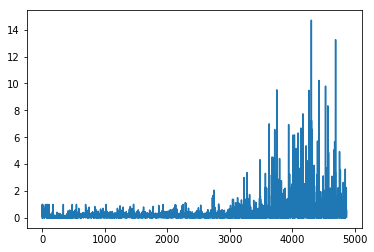

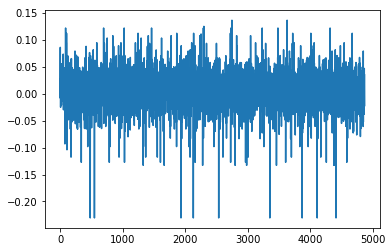

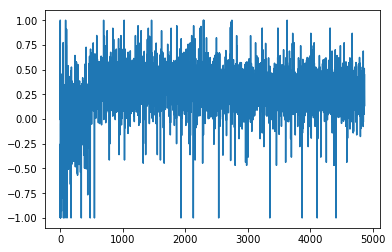

2.3902166284
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.11111111  0.11111111
  1.          1.          1.          1.          1.          1.
  0.11111111  0.11111111  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.11111111  1.          0.11111111  0.11111111  0.11111111  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.11111111  0.11111111  0.11111111  1.          1.        ]
Writing away results
1995-02-01 00:00:00


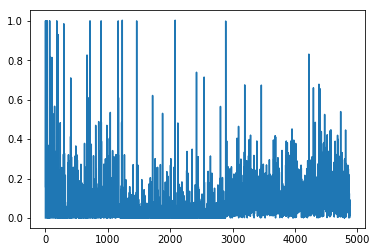

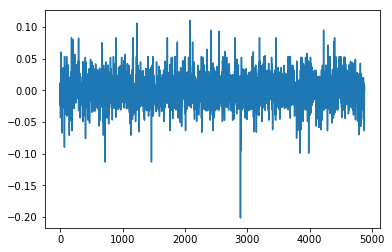

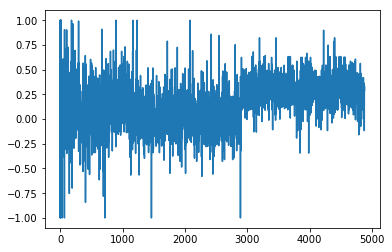

1.17816142912
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222
  0.22222222  0.22222222  0.22222222  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.22222222  0.22222222  0.22222222  0.11111111  0.11111111]
Writing away results
1995-03-01 00:00:00


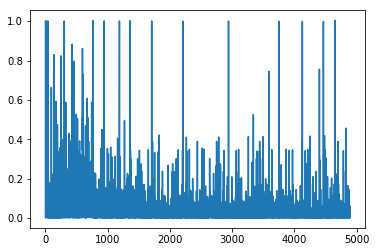

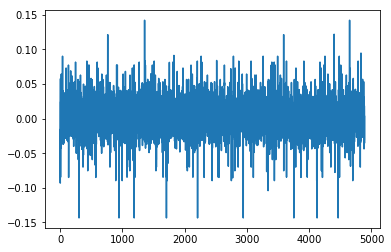

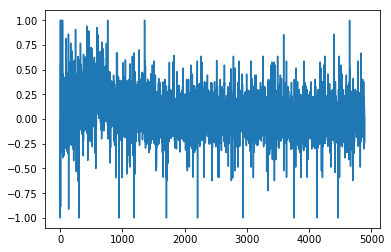

1.788231446
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667  0.22222222
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1995-04-01 00:00:00


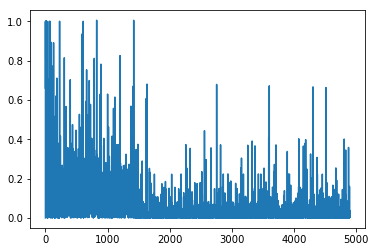

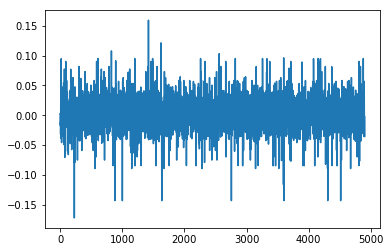

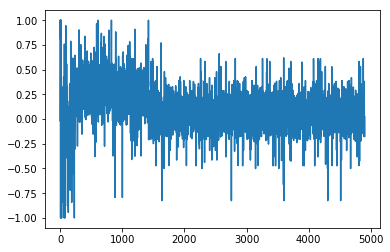

1.84084615728
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1995-05-01 00:00:00


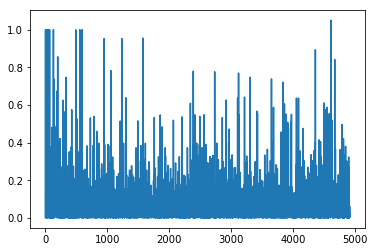

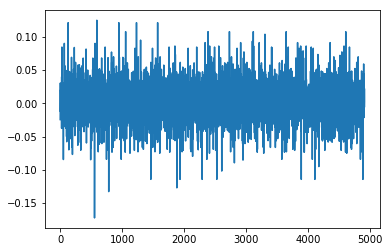

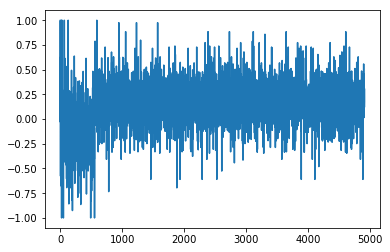

1.64182064934
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
1995-06-01 00:00:00


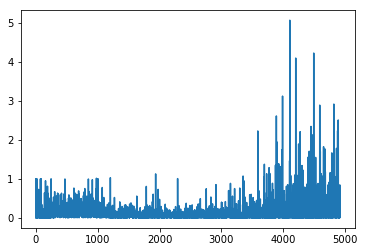

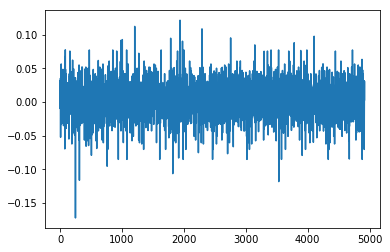

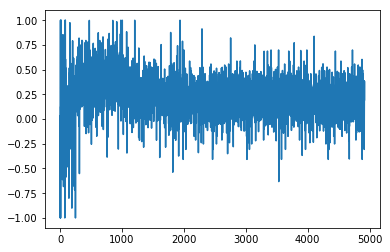

1.42204108337
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.33333333  0.33333333  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.33333333]
Writing away results
1995-07-01 00:00:00


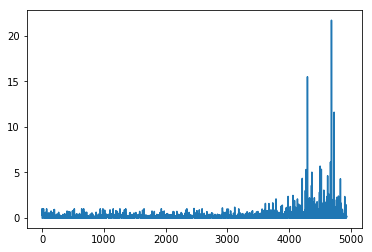

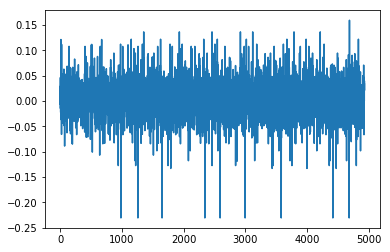

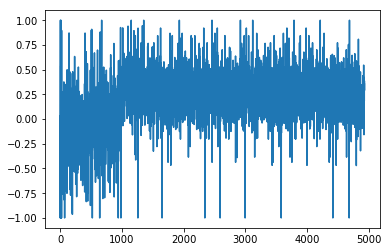

2.17596519372
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.66666667
  0.66666667  1.          1.          1.          1.          1.          1.
  0.66666667  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.66666667  0.66666667  0.66666667  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          0.66666667  0.66666667]
Writing away results
1995-08-01 00:00:00


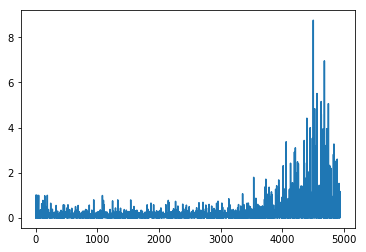

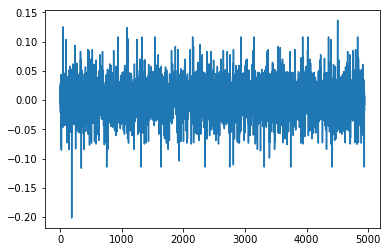

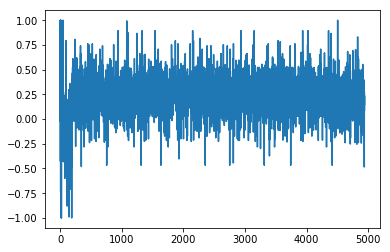

1.55722075696
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.55555556]
Writing away results
1995-09-01 00:00:00


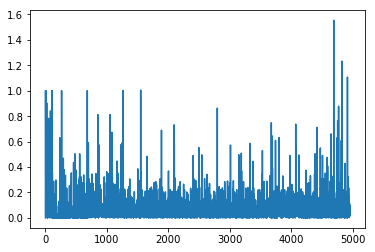

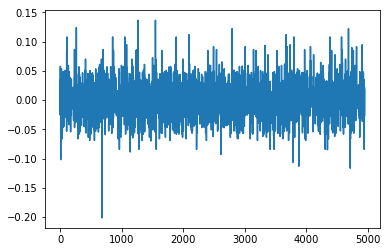

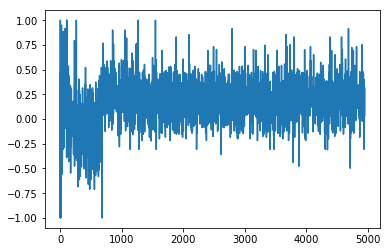

1.25207408483
[ 0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1995-10-01 00:00:00


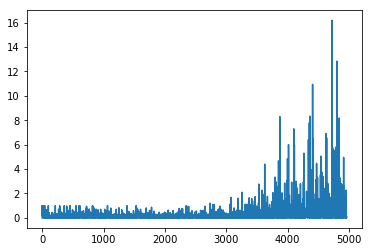

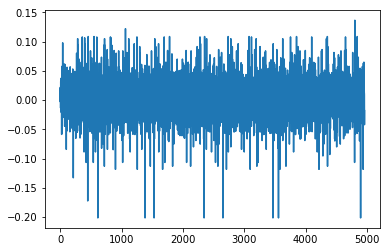

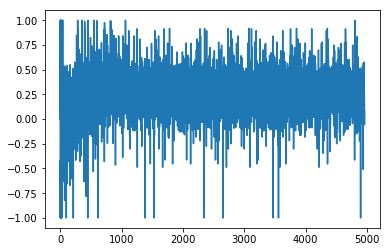

1.93936340495
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889]
Writing away results
1995-11-01 00:00:00


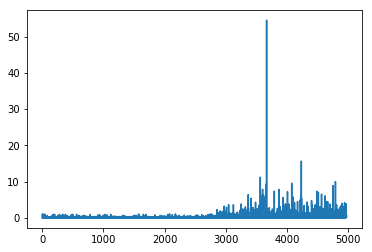

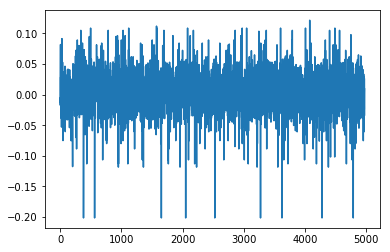

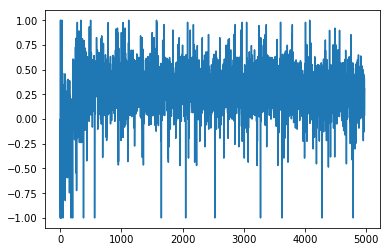

1.73658116556
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.11111111  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  0.88888889  0.11111111  0.11111111  0.11111111  0.88888889
  0.88888889  0.88888889  0.88888889  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.11111111  0.11111111  0.11111111  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111
  0.11111111  0.88888889  0.88888889  0.88888889  0.11111111]
Writing away results
1995-12-01 00:00:00


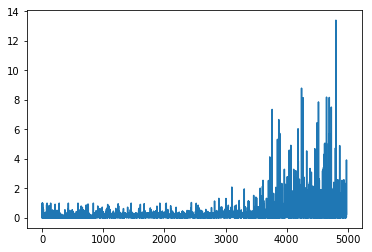

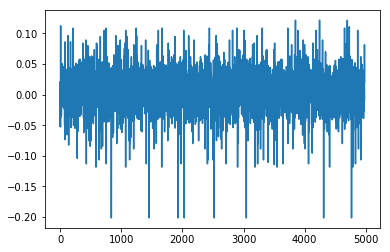

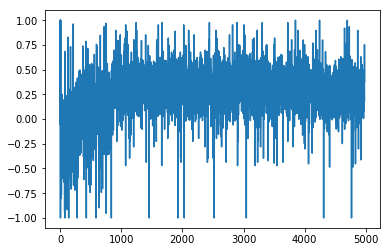

1.70037323468
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.11111111  0.11111111  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.11111111
  0.88888889  0.11111111  0.88888889  0.88888889  0.11111111]
Writing away results
1996-01-01 00:00:00


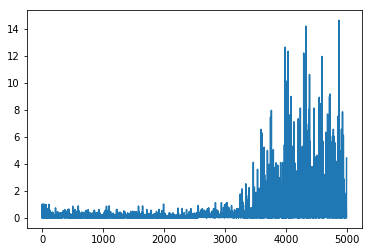

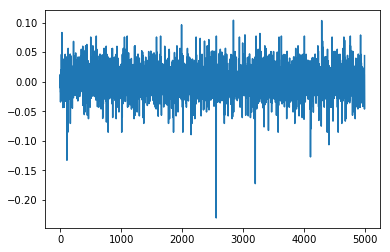

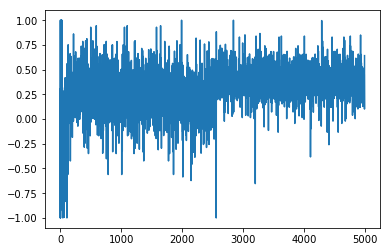

1.30590230315
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.33333333  0.33333333  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.33333333  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.33333333  0.44444444
  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444  0.44444444
  0.44444444  0.33333333  0.44444444  0.44444444  0.33333333  0.44444444
  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  0.33333333  0.44444444
  0.33333333  0.44444444  0.33333333  0.33333333  0.33333333]
Writing away results
1996-02-01 00:00:00


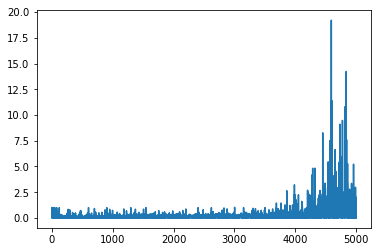

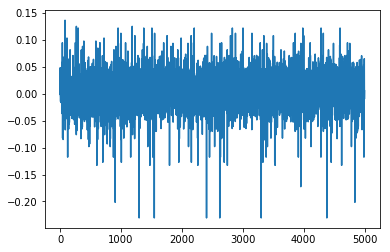

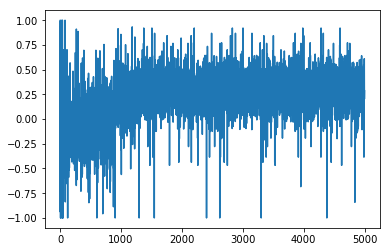

1.82439929078
[ 1.          1.          1.          1.          1.          0.44444444
  0.44444444  1.          1.          1.          1.          1.          1.
  0.44444444  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.44444444  0.44444444  0.44444444  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.44444444  0.44444444  0.44444444  1.          1.          1.          1.
  1.          1.          0.44444444  0.44444444  0.44444444  0.44444444
  1.          1.          0.44444444  0.44444444  0.44444444]
Writing away results
1996-03-01 00:00:00


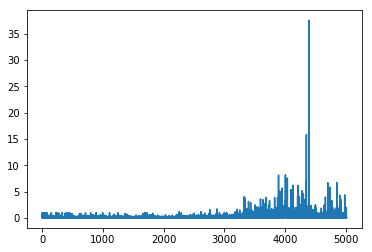

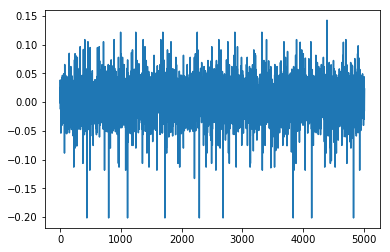

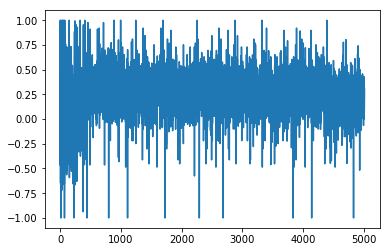

1.51985036747
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.55555556  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556
  0.55555556  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.55555556  0.88888889  0.55555556  0.55555556
  0.55555556  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.55555556  0.55555556  0.88888889  0.55555556  0.88888889
  0.88888889  0.55555556  0.55555556  0.55555556  0.88888889]
Writing away results
1996-04-01 00:00:00


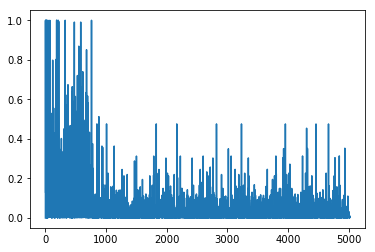

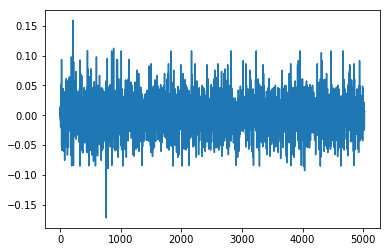

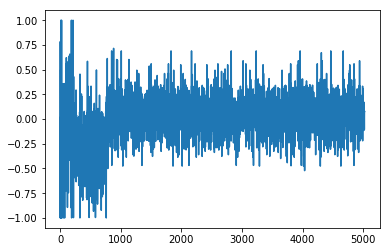

1.22895118451
[ 0.44444444  0.44444444  0.44444444  0.66666667  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.44444444
  0.44444444  0.77777778  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.44444444  0.66666667  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1996-05-01 00:00:00


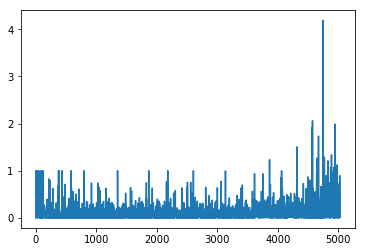

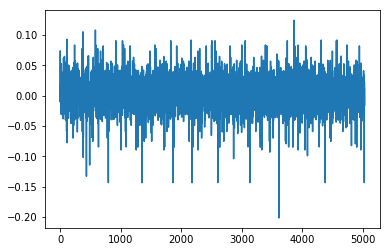

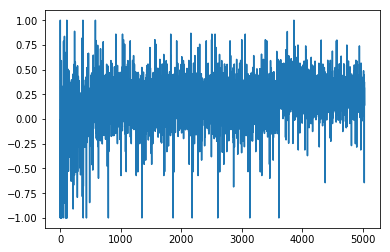

1.41770558051
[ 0.66666667  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1996-06-01 00:00:00


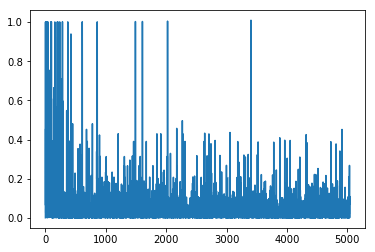

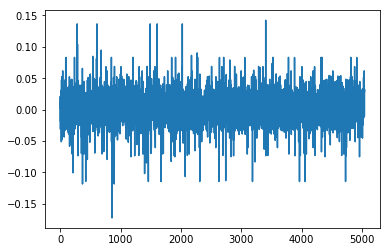

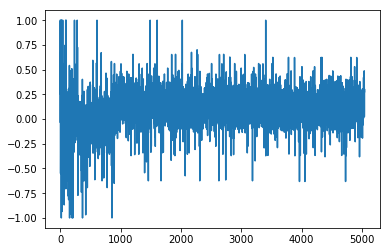

1.31362668833
[ 0.55555556  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.55555556  0.55555556  0.22222222  0.22222222  0.22222222  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222
  0.55555556  0.22222222  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1996-07-01 00:00:00


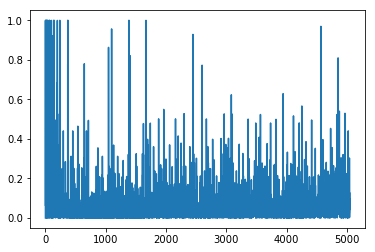

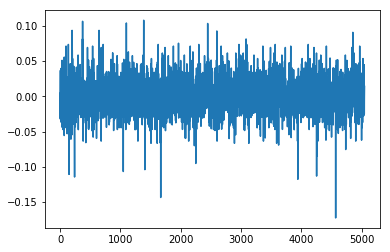

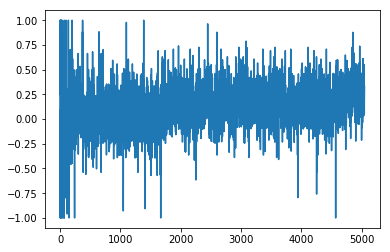

1.1501325787
[ 0.44444444  0.44444444  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.44444444  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.44444444  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.44444444  0.44444444  0.44444444  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.44444444  0.11111111
  0.11111111  0.44444444  0.44444444  0.44444444  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.44444444  0.44444444  0.11111111
  0.44444444  0.11111111  0.11111111  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1996-08-01 00:00:00


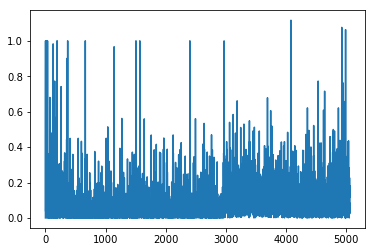

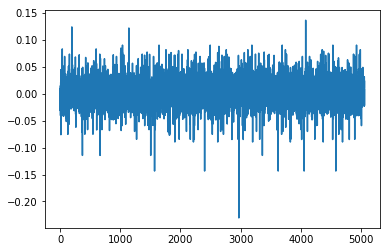

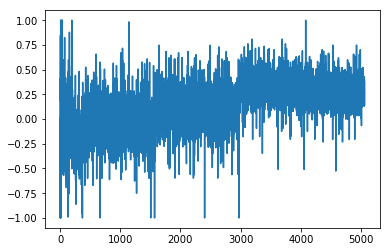

1.4194764552
[ 0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667]
Writing away results
1996-09-01 00:00:00


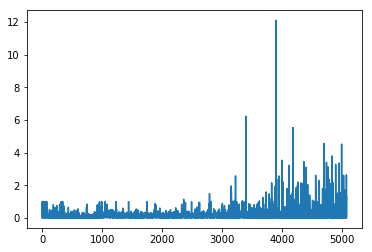

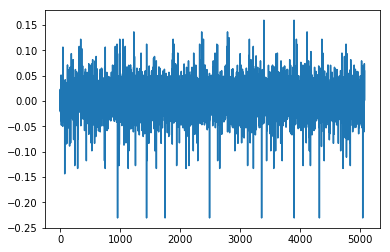

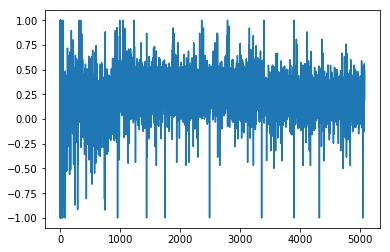

1.53193946203
[ 1.          1.          1.          1.          1.          1.
  0.44444444  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.44444444  0.44444444  0.44444444  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.44444444  0.44444444  0.44444444  1.          1.          1.          1.
  1.          1.          0.44444444  0.44444444  1.          0.44444444
  1.          1.          0.44444444  0.44444444  0.44444444  1.
  0.44444444  0.44444444  0.44444444  1.          0.44444444  0.44444444]
Writing away results
1996-10-01 00:00:00


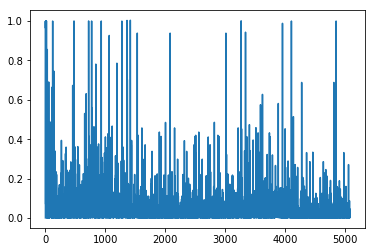

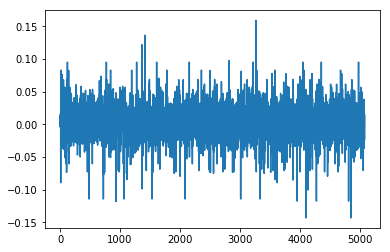

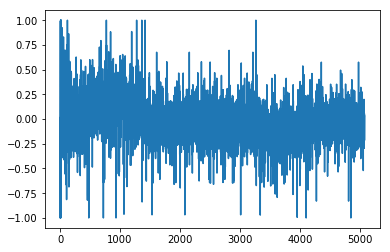

1.37603200543
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.          0.55555556
  0.88888889  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.55555556  0.          0.          0.55555556
  0.44444444  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.55555556  0.55555556  0.          0.55555556  0.55555556
  0.55555556  0.          0.44444444  0.88888889  0.          0.
  0.55555556  0.          0.          0.55555556  0.        ]
Writing away results
1996-11-01 00:00:00


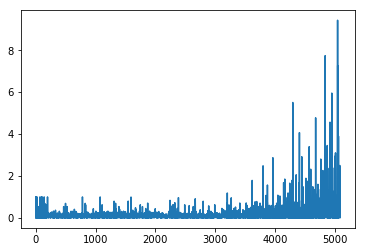

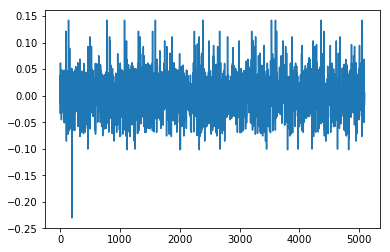

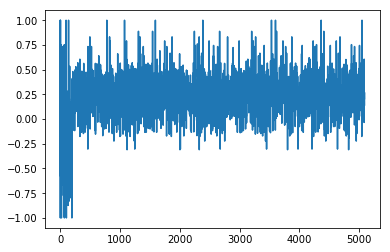

0.890569914937
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.88888889  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.88888889  0.88888889  0.88888889  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.88888889  0.88888889  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1996-12-01 00:00:00


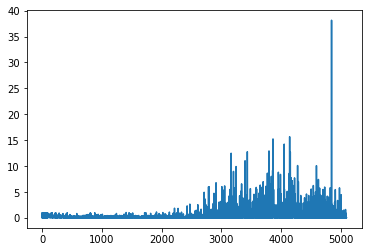

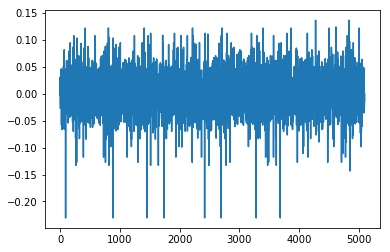

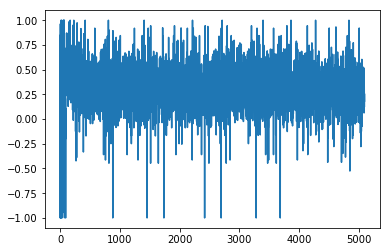

1.3745050005
[ 1.          1.          1.          0.66666667  1.          1.          1.
  1.          1.          1.          0.66666667  1.          1.          1.
  1.          1.          1.          0.66666667  1.          0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.
  0.66666667  1.          1.          1.          1.          0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.          1.
  1.          0.66666667  0.66666667  1.          0.66666667  1.
  0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  1.          1.          0.66666667  0.66666667
  0.66666667  0.66666667]
Writing away results
1997-01-01 00:00:00


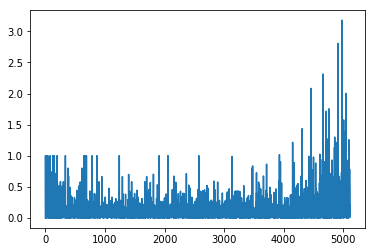

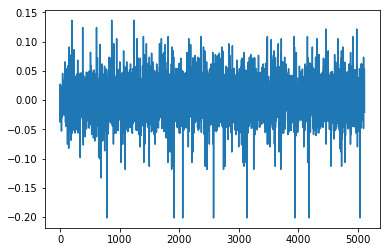

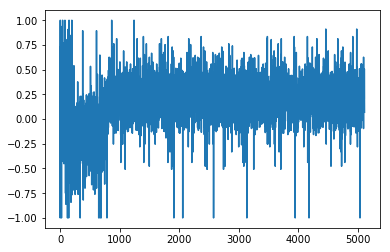

1.40230503181
[ 0.88888889  0.88888889  0.55555556  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.55555556  0.55555556  0.55555556  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.55555556  0.55555556  0.55555556  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556  0.55555556
  0.55555556  0.88888889  0.88888889  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889
  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889]
Writing away results
1997-02-01 00:00:00


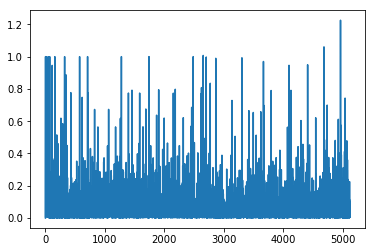

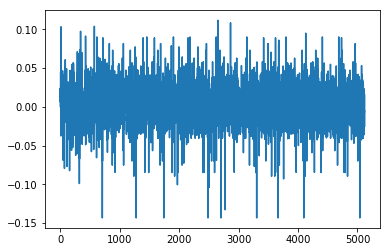

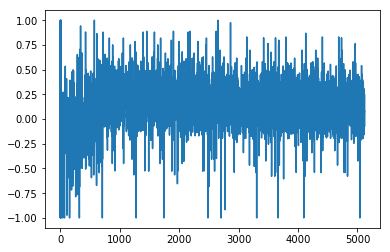

1.40756056708
[ 0.66666667  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667]
Writing away results
1997-03-01 00:00:00


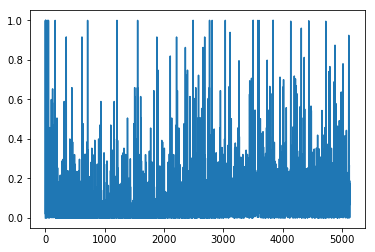

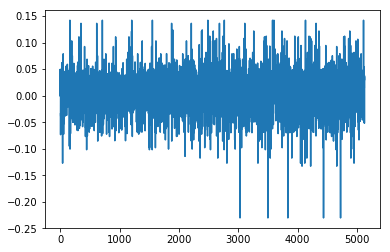

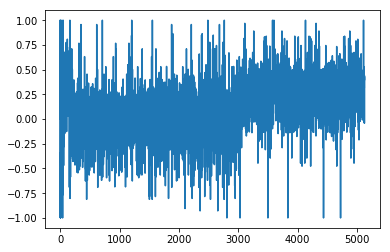

1.32891169567
[ 0.88888889  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.88888889  0.88888889  0.88888889  0.88888889
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.88888889  0.88888889  1.          1.          1.
  1.          1.          1.          0.88888889  0.88888889  0.88888889
  0.88888889  1.          1.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.        ]
Writing away results
1997-04-01 00:00:00


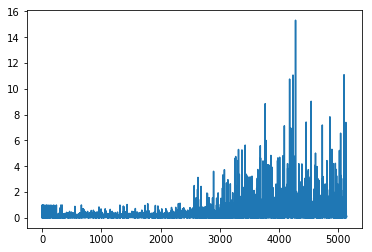

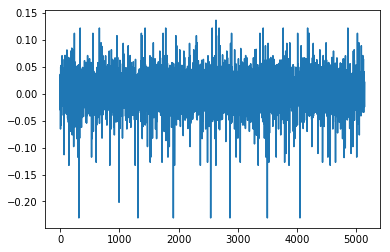

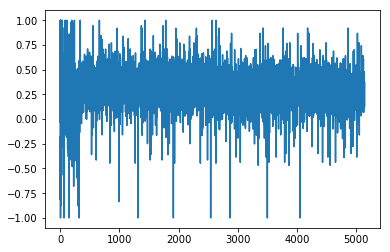

1.44376539036
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.11111111  0.11111111  0.11111111  1.          1.          1.
  1.          0.11111111  1.          1.          1.          1.          1.
  0.11111111  0.11111111  1.          1.          1.          1.          1.
  1.          0.11111111  0.11111111  1.          0.11111111  1.          1.
  0.11111111  0.11111111  0.11111111  1.          0.11111111  0.11111111
  1.          1.          0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  1.          1.          1.          0.11111111]
Writing away results
1997-05-01 00:00:00


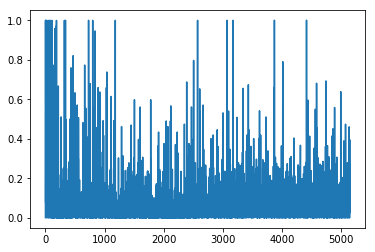

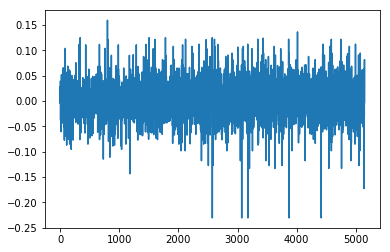

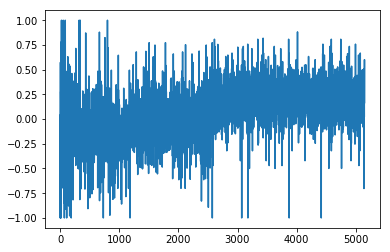

1.22965912849
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.55555556  0.55555556  0.55555556  0.55555556  1.          1.          1.
  1.          1.          1.          0.55555556  1.          1.
  0.55555556  0.55555556  1.          1.          1.          1.          1.
  1.          0.55555556  0.55555556  1.          0.55555556  1.          1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  1.          0.55555556  0.55555556
  0.55555556  0.55555556  1.          1.          1.          1.        ]
Writing away results
1997-06-01 00:00:00


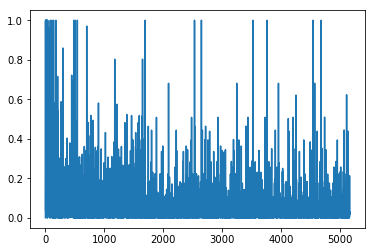

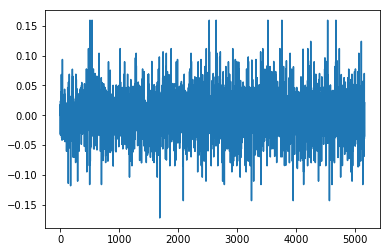

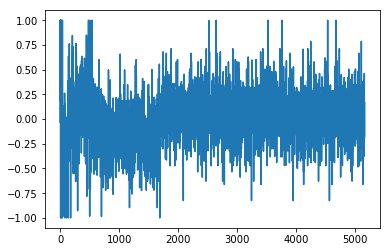

1.11771862468
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          1.          0.66666667  1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.
  0.66666667  1.          1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.
  0.66666667  1.          0.66666667  0.66666667  0.77777778  1.          1.
  1.          1.          1.          1.          1.          0.33333333
  0.66666667  1.          1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  1.        ]
Writing away results
1997-07-01 00:00:00


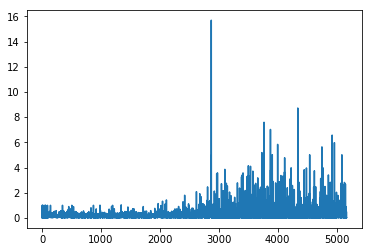

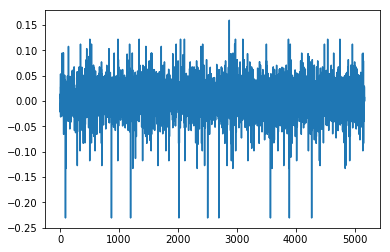

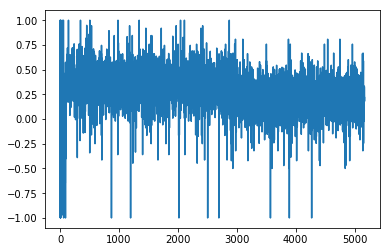

1.13199058771
[ 1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.33333333
  0.33333333  0.33333333  1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.33333333  0.33333333
  0.33333333  1.          1.          1.          1.          1.          1.
  0.33333333  0.33333333  1.          0.33333333  1.          1.
  0.33333333  0.33333333  0.33333333  1.          0.33333333  0.33333333
  0.33333333  1.          0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  1.          1.          1.          0.33333333  1.
  0.33333333  0.33333333]
Writing away results
1997-08-01 00:00:00


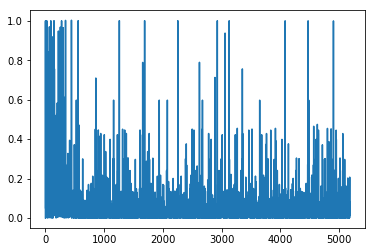

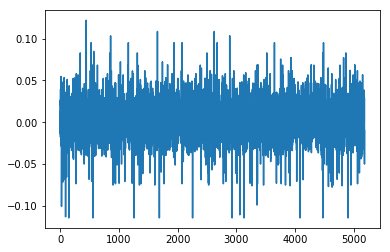

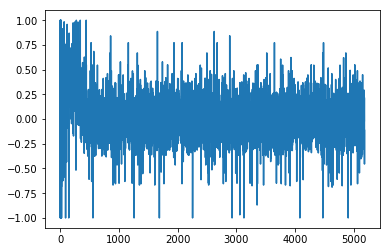

1.35914312012
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.55555556  0.88888889  0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.          0.55555556  0.          0.55555556  0.55555556
  0.          0.          0.          0.          0.          0.
  0.55555556  0.          0.          0.55555556  0.          0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.
  0.        ]
Writing away results
1997-09-01 00:00:00


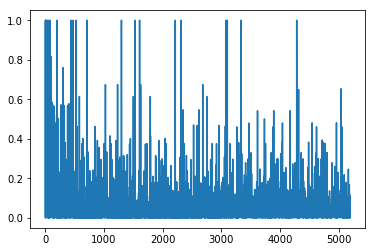

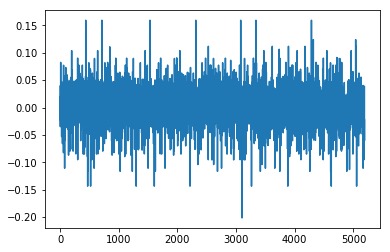

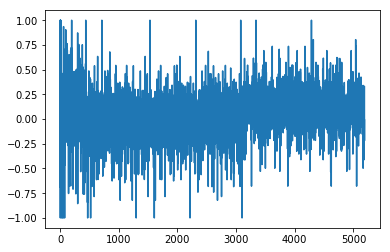

0.872176033646
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          0.66666667  0.66666667  1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          1.          0.66666667  1.          0.66666667  0.66666667
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.66666667  1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.        ]
Writing away results
1997-10-01 00:00:00


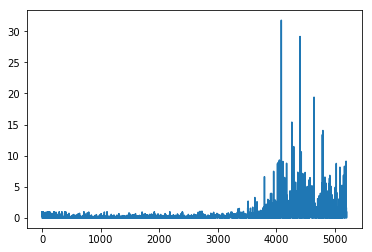

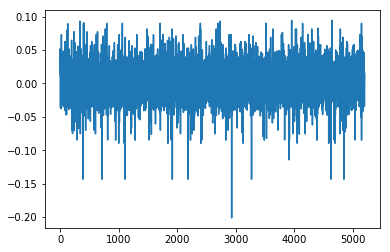

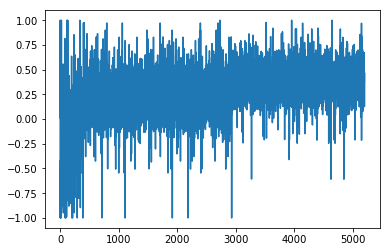

1.0391223297
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.66666667  0.44444444  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.66666667  0.44444444  0.44444444
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1997-11-01 00:00:00


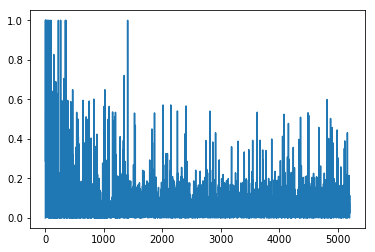

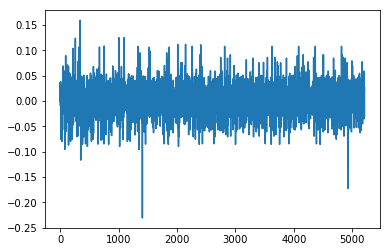

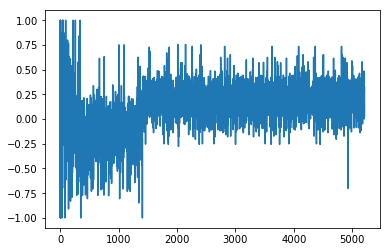

0.955234579831
[ 0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1997-12-01 00:00:00


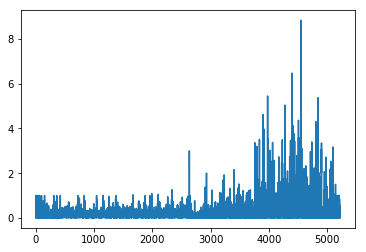

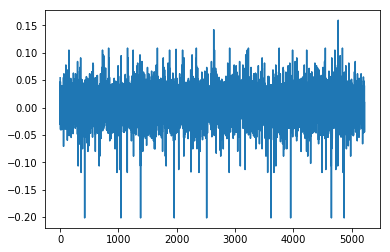

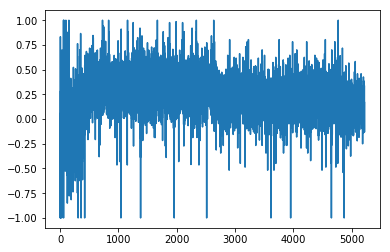

1.07720673185
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.55555556  0.55555556  0.55555556  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.55555556  0.55555556  0.55555556  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556
  0.88888889  0.55555556  0.88888889  0.88888889  0.55555556  0.55555556
  0.55555556  0.88888889  0.55555556  0.55555556  0.88888889  0.88888889
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889
  0.88888889  0.88888889  0.55555556  0.88888889  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889]
Writing away results
1998-01-01 00:00:00


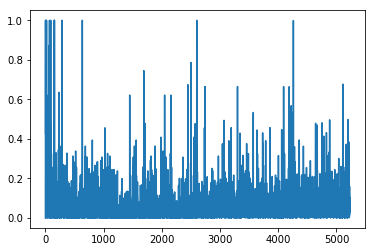

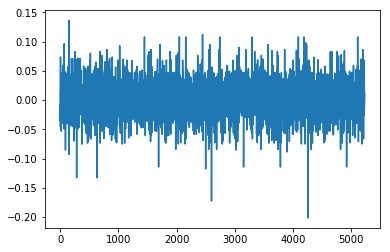

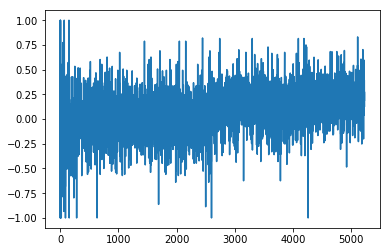

0.966382287684
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556]
Writing away results
1998-02-01 00:00:00


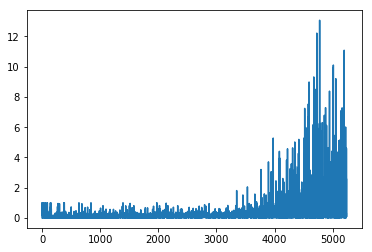

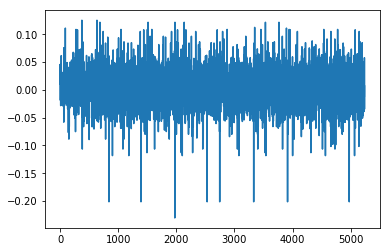

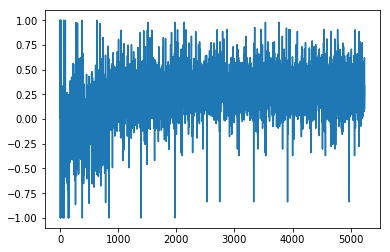

0.916710400339
[ 0.88888889  0.88888889  0.88888889  0.66666667  0.88888889  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667
  0.88888889  0.88888889  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667
  0.66666667  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667]
Writing away results
1998-03-01 00:00:00


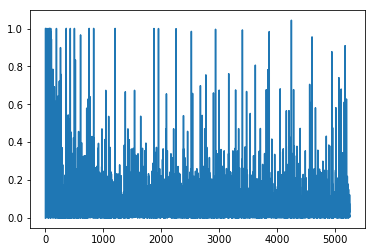

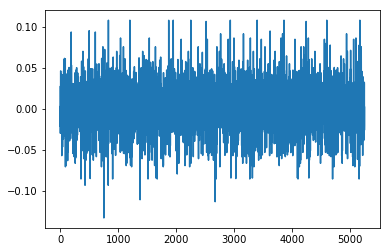

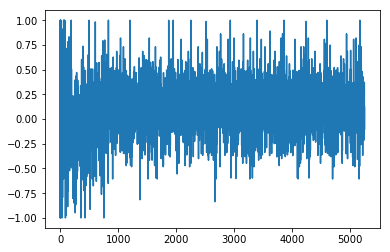

0.889568289723
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.66666667  0.44444444]
Writing away results
1998-04-01 00:00:00


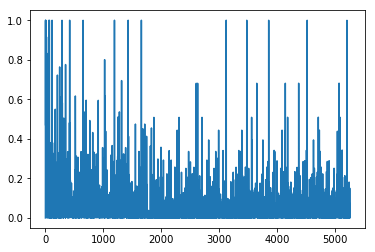

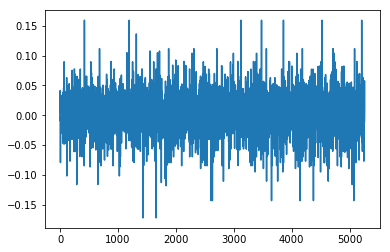

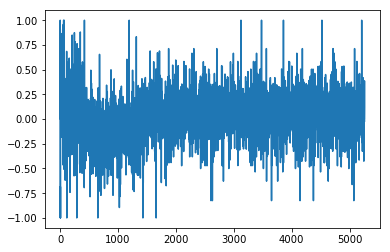

0.785562962406
[ 0.66666667  0.66666667  0.66666667  1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.66666667  0.66666667  1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.
  0.66666667  1.          0.66666667  0.66666667  1.          1.          1.
  1.          1.          1.          1.          1.          0.22222222
  0.66666667  1.          1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          1.          0.66666667  0.22222222  0.66666667
  1.        ]
Writing away results
1998-05-01 00:00:00


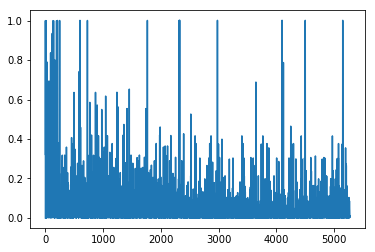

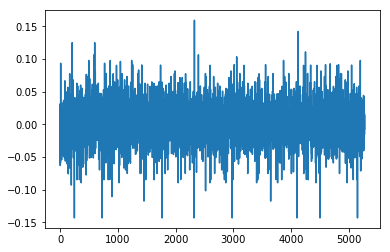

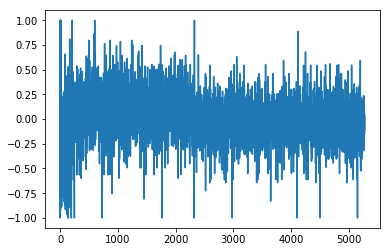

0.924078014361
[ 0.66666667  0.66666667  0.55555556  0.88888889  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.77777778  0.66666667  0.22222222  0.88888889  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  1.          0.66666667  0.77777778  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.88888889  0.55555556  0.55555556
  0.77777778  0.77777778  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.55555556  0.88888889
  1.          0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556]
Writing away results
1998-06-01 00:00:00


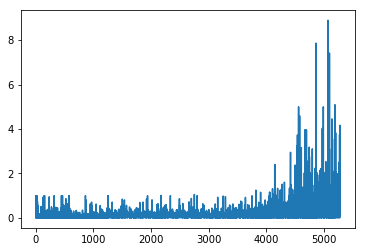

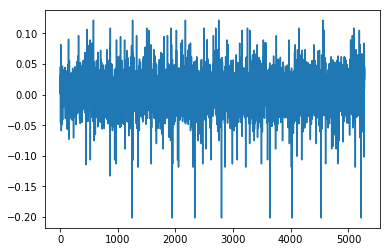

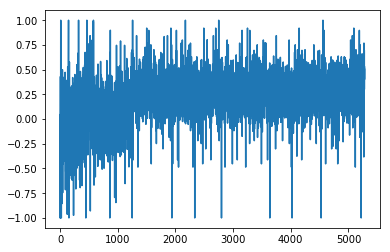

1.1174926185
[ 0.88888889  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.11111111
  0.88888889  0.11111111  0.88888889  0.88888889  0.11111111  0.11111111
  0.11111111  0.88888889  0.11111111  0.11111111  0.11111111  0.88888889
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.88888889
  0.88888889  0.88888889  0.11111111  0.88888889  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.88888889
  0.11111111  0.11111111  0.11111111  0.11111111  0.88888889]
Writing away results
1998-07-01 00:00:00


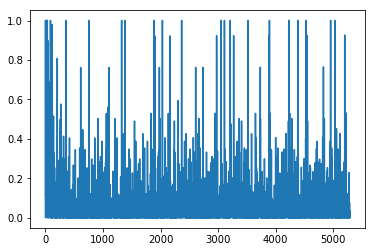

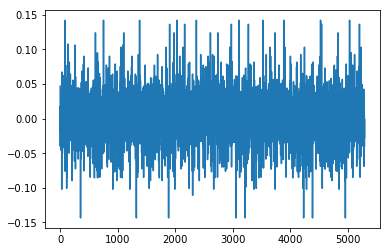

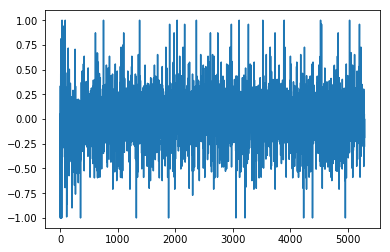

0.933288100573
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667
  0.88888889  0.66666667  0.66666667  1.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  1.
  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667]
Writing away results
1998-08-01 00:00:00


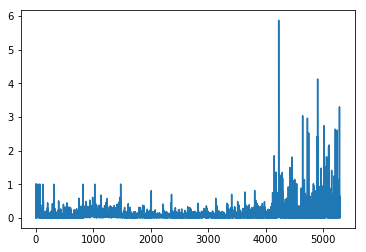

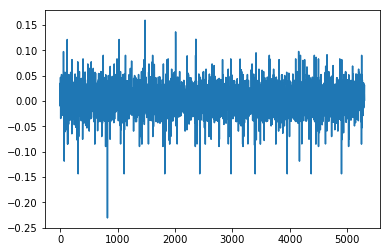

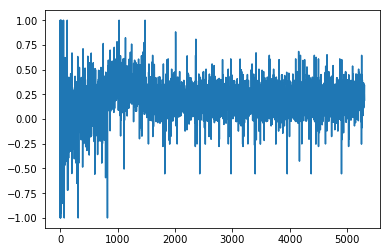

1.13638682175
[ 0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222  0.66666667
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667]
Writing away results
1998-09-01 00:00:00


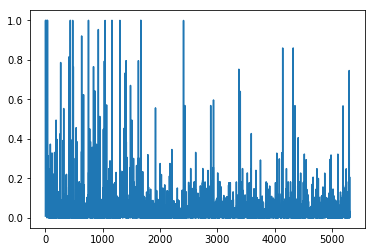

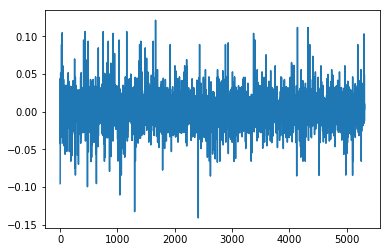

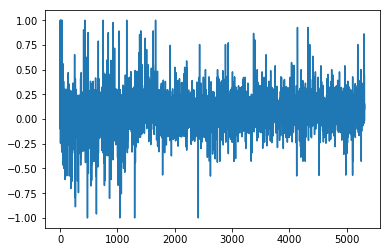

1.12764907017
[ 0.11111111  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.11111111  0.22222222  0.22222222  0.11111111
  0.11111111  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.11111111  0.22222222  0.11111111  0.22222222
  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222  0.11111111
  0.11111111  0.11111111  0.11111111  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.22222222  0.11111111  0.22222222  0.11111111
  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
1998-10-01 00:00:00


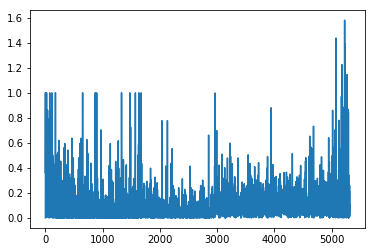

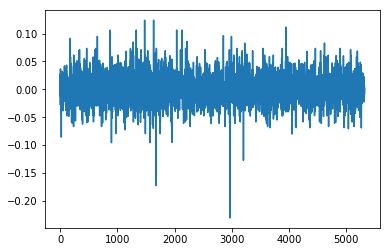

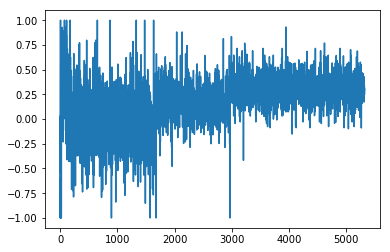

1.03870087617
[ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.44444444  0.44444444  0.          0.
  0.          0.          0.          0.          0.44444444  0.44444444
  0.44444444  0.44444444  0.          0.          0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.          0.44444444  0.44444444  0.44444444  0.          0.
  0.          0.          0.          0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.          0.          0.
  0.44444444  0.44444444  0.          0.          0.          0.          0.        ]
Writing away results
1998-11-01 00:00:00


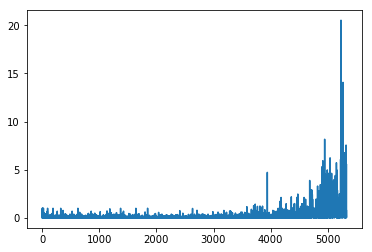

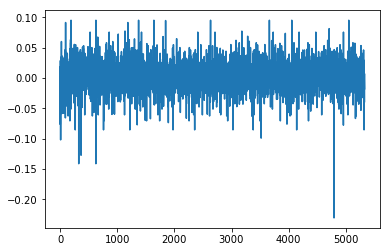

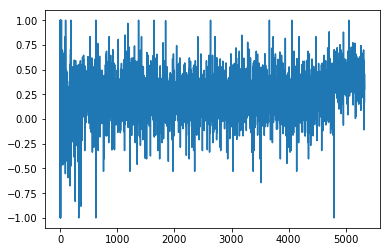

1.18125146627
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.          0.
  0.          0.          0.44444444  0.44444444  0.          0.          0.
  0.44444444  0.          0.          0.          0.44444444  0.          0.
  0.          0.          0.          0.44444444  0.44444444  0.44444444
  0.          0.44444444  0.          0.          0.          0.          0.
  0.          0.          0.44444444  0.44444444  0.          0.          0.
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1998-12-01 00:00:00


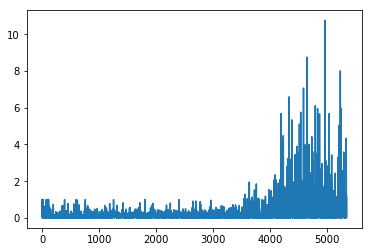

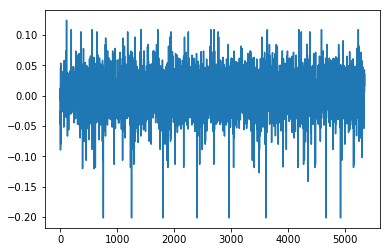

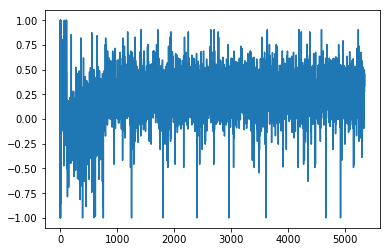

1.08371697322
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444  0.44444444
  0.88888889  0.44444444  0.88888889  0.44444444  0.44444444  0.44444444
  0.44444444  0.88888889  0.44444444  0.44444444  0.88888889  0.88888889
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.88888889
  0.88888889  0.88888889  0.44444444  0.88888889  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889
  0.88888889  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1999-01-01 00:00:00


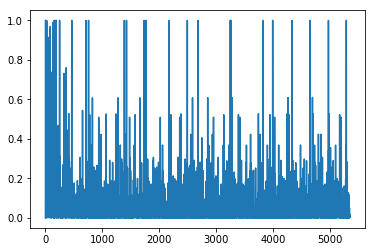

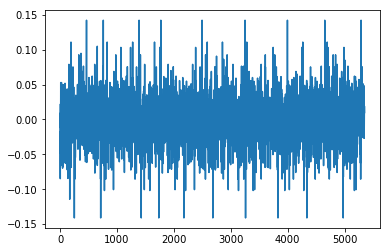

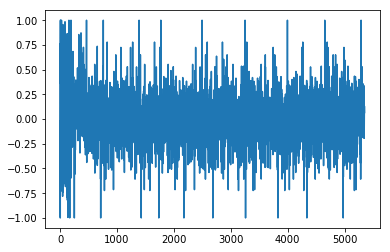

0.95107544032
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.88888889  0.44444444
  0.44444444  0.88888889  0.88888889  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889  0.44444444
  0.88888889  0.44444444  0.44444444  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.44444444  0.88888889  0.88888889
  0.44444444  0.88888889  0.88888889  0.88888889  0.44444444  0.33333333
  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444  0.77777778
  0.44444444  0.88888889  0.88888889  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
1999-02-01 00:00:00


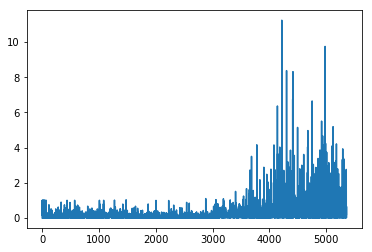

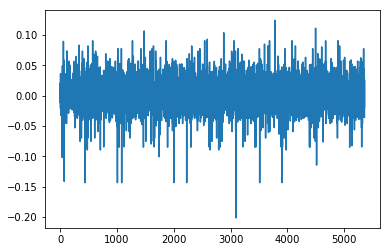

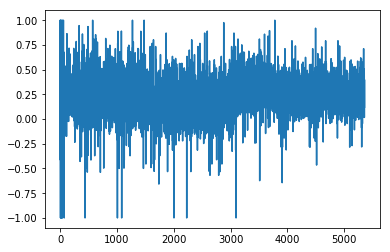

1.16063700542
[ 0.33333333  0.66666667  0.66666667  0.33333333  0.66666667  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.33333333
  0.66666667  0.66666667  0.33333333  0.33333333  0.66666667  0.33333333
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.33333333  0.33333333  0.66666667  0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667  0.33333333
  0.33333333  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1999-03-01 00:00:00


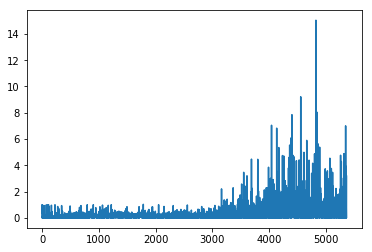

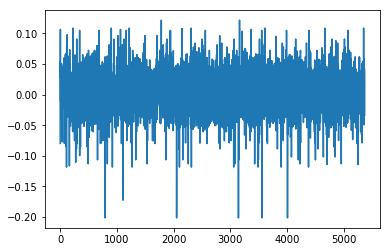

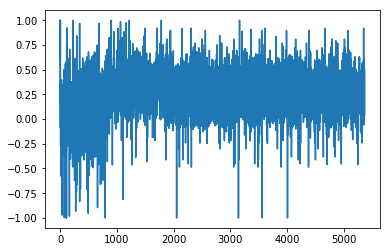

1.16361333548
[ 0.88888889  0.88888889  0.55555556  0.88888889  0.55555556  0.55555556
  0.55555556  0.88888889  0.88888889  0.88888889  0.55555556  0.88888889
  0.88888889  0.55555556  0.55555556  0.88888889  0.55555556  0.88888889
  0.55555556  0.55555556  0.55555556  0.55555556  0.88888889  0.55555556
  0.55555556  0.88888889  0.88888889  0.55555556  0.55555556  0.55555556
  0.55555556  0.88888889  0.88888889  0.88888889  0.55555556  0.55555556
  0.88888889  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.88888889  0.88888889  0.55555556  0.55555556  0.55555556
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1999-04-01 00:00:00


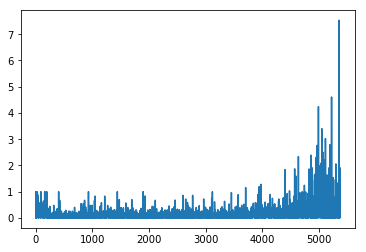

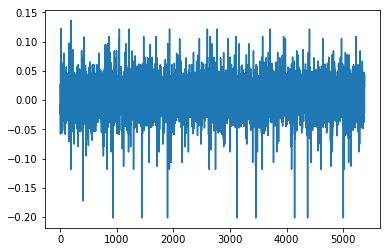

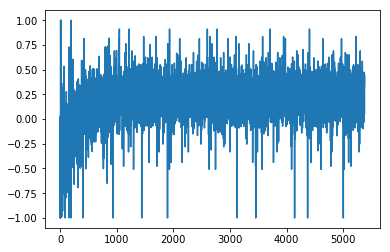

1.04600612321
[ 0.88888889  0.88888889  0.88888889  0.33333333  0.33333333  0.33333333
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.33333333  0.33333333  0.33333333  0.33333333  0.88888889  0.88888889
  0.33333333  0.33333333  0.33333333  0.88888889  0.33333333  0.33333333
  0.33333333  0.88888889  0.88888889  0.33333333  0.33333333  0.33333333
  0.33333333  0.88888889  0.88888889  0.88888889  0.33333333  0.88888889
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.88888889  0.88888889  0.33333333  0.33333333  0.33333333
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
1999-05-01 00:00:00


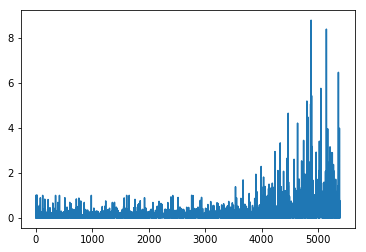

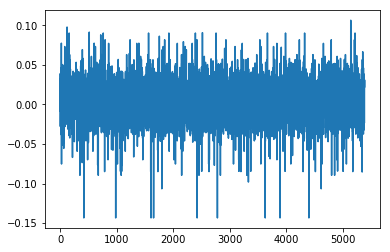

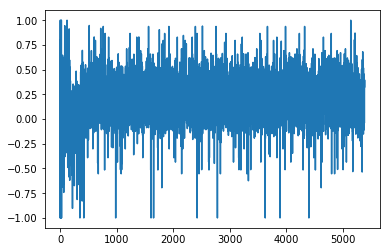

1.12256771539
[ 0.66666667  0.66666667  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.33333333
  0.33333333  0.33333333  0.66666667  0.33333333  0.33333333  0.33333333
  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.33333333  0.66666667  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
1999-06-01 00:00:00


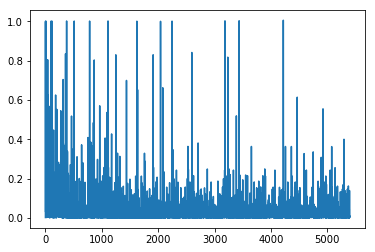

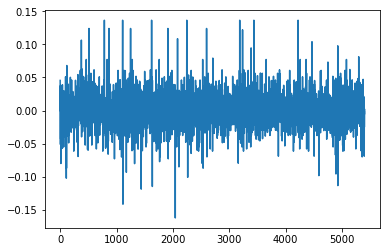

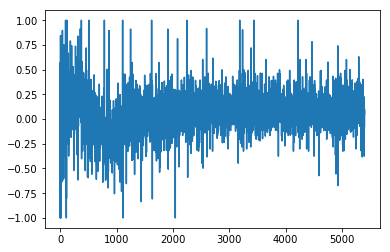

1.14126389793
[ 0.          0.          0.33333333  0.33333333  0.33333333  0.          0.
  0.          0.          0.          0.33333333  0.33333333  0.
  0.33333333  0.          0.          0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.          0.33333333  0.33333333  0.33333333  0.33333333  0.          0.
  0.          0.          0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.          0.33333333  0.
  0.33333333  0.33333333  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.33333333]
Writing away results
1999-07-01 00:00:00


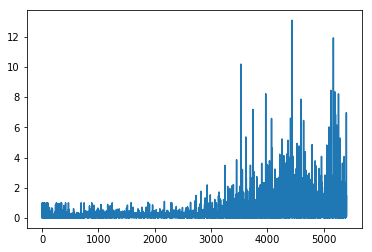

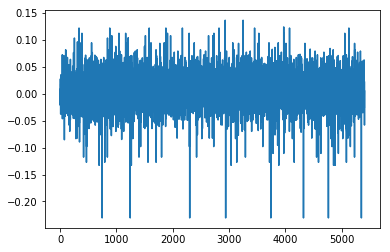

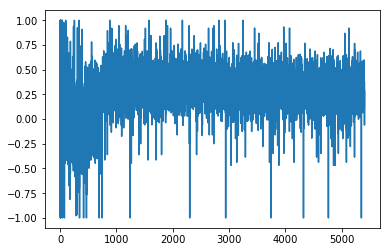

1.09414546864
[ 0.33333333  0.33333333  0.33333333  1.          1.          1.          1.
  1.          1.          0.33333333  0.33333333  1.          0.33333333
  1.          1.          0.33333333  0.33333333  0.33333333  1.
  0.33333333  0.33333333  0.33333333  1.          0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  1.          1.          1.
  0.33333333  1.          0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  1.          1.          1.          0.33333333
  0.33333333  0.33333333  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.33333333  0.33333333]
Writing away results
1999-08-01 00:00:00


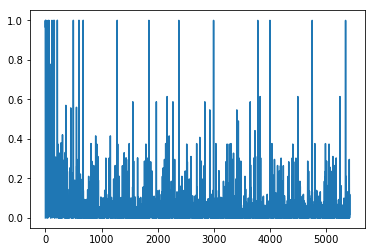

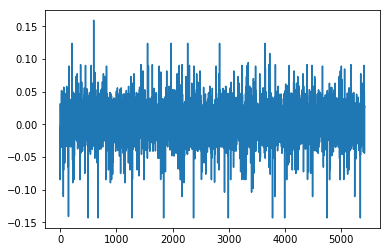

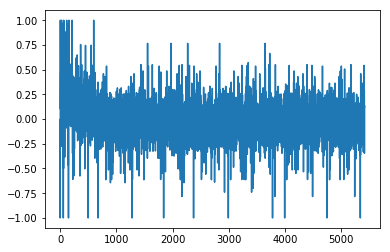

1.12930341755
[ 0.11111111  0.11111111  1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          0.66666667  0.66666667  1.
  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111  1.          0.
  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667  0.11111111
  0.11111111  0.66666667  1.          0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.66666667  0.11111111  0.11111111  0.11111111
  0.11111111  0.66666667  0.77777778  0.66666667  0.66666667  0.11111111
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.11111111  0.11111111]
Writing away results
1999-09-01 00:00:00


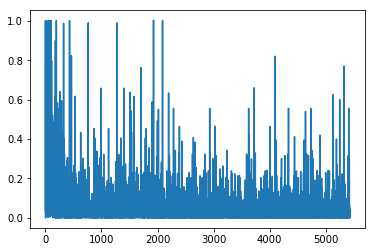

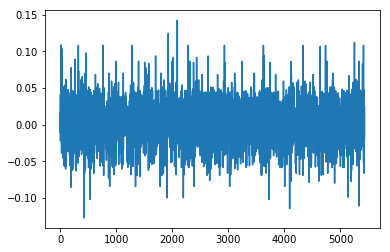

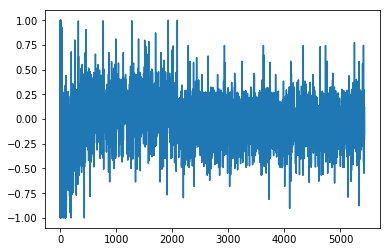

1.14667575602
[ 0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.22222222  0.66666667  0.33333333  0.88888889  0.33333333
  0.33333333  0.22222222  0.66666667  0.66666667  0.33333333  0.22222222
  0.66666667  0.66666667  0.88888889  0.22222222  0.33333333  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.22222222  0.33333333  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.22222222  0.66666667  0.66666667  0.66666667]
Writing away results
1999-10-01 00:00:00


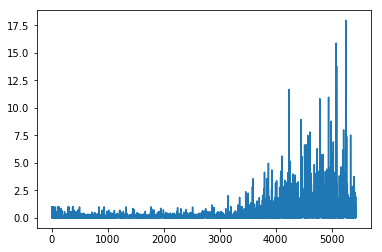

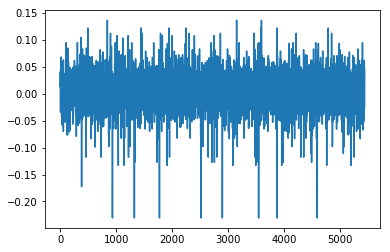

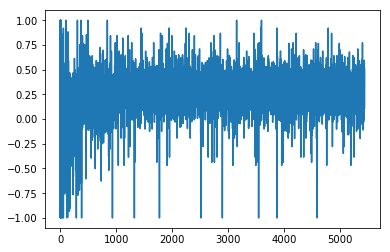

1.14965434964
[ 1.          1.          1.          1.          1.          1.
  0.22222222  0.22222222  1.          0.22222222  1.          0.22222222
  0.22222222  0.22222222  0.22222222  1.          0.22222222  0.22222222
  1.          1.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  1.          1.          1.          0.22222222  1.
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.22222222
  0.22222222  1.          0.22222222  0.22222222]
Writing away results
1999-11-01 00:00:00


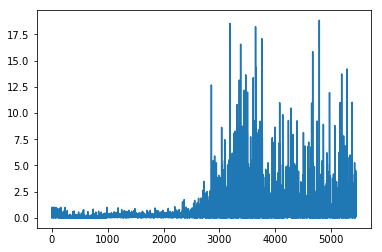

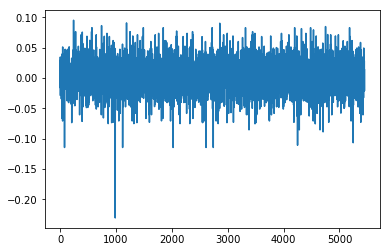

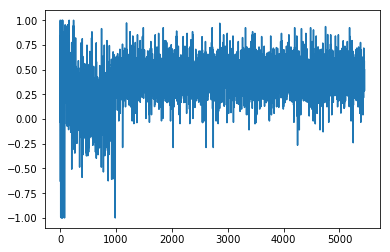

1.08239396277
[ 0.55555556  0.55555556  0.44444444  0.55555556  0.55555556  0.44444444
  0.44444444  0.55555556  0.44444444  0.55555556  0.44444444  0.44444444
  0.44444444  0.44444444  0.55555556  0.44444444  0.44444444  0.55555556
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.55555556  0.55555556  0.55555556  0.44444444  0.55555556  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.55555556
  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.44444444
  0.44444444  0.55555556  0.44444444  0.55555556  0.55555556]
Writing away results
1999-12-01 00:00:00


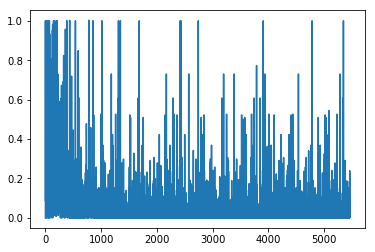

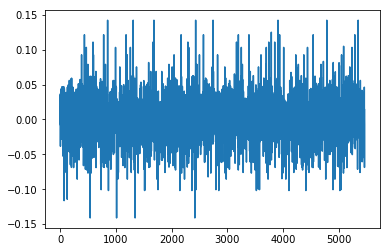

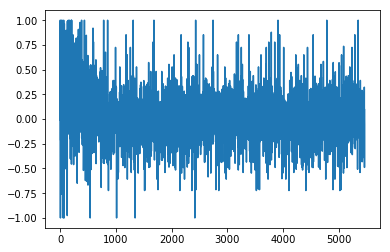

1.07764943471
[ 0.          0.          0.          0.          0.88888889  0.88888889
  0.          0.88888889  0.          0.          0.88888889  0.88888889
  0.88888889  0.          0.88888889  0.88888889  0.          0.88888889
  0.88888889  0.          0.88888889  0.88888889  0.88888889  1.          1.
  0.          0.          0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.88888889
  0.          0.          0.88888889  0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  1.        ]
Writing away results
2000-01-01 00:00:00


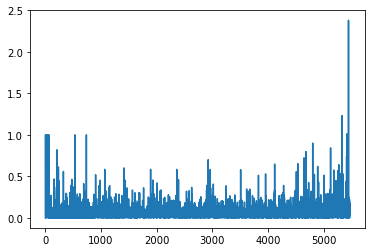

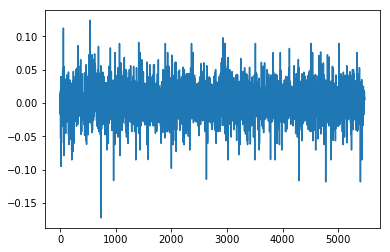

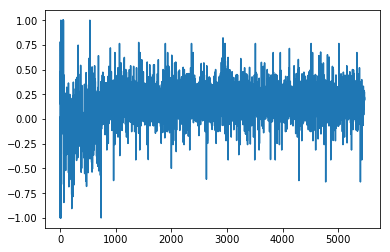

1.22751906047
[ 0.44444444  0.44444444  0.44444444  0.11111111  0.11111111  0.11111111
  0.11111111  0.44444444  0.44444444  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.44444444
  0.44444444  0.11111111  0.11111111  0.11111111  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.44444444  0.44444444
  0.11111111  0.11111111  0.11111111  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.11111111  0.11111111  0.44444444
  0.11111111  0.11111111  0.44444444  0.44444444  0.44444444]
Writing away results
2000-02-01 00:00:00


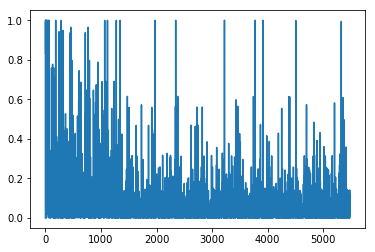

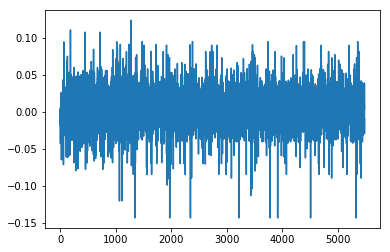

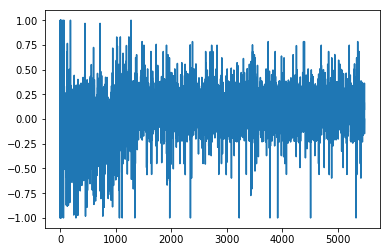

1.26182825292
[ 0.66666667  0.66666667  0.          0.          0.66666667  0.
  0.66666667  0.66666667  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.66666667  0.          0.
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.          0.          0.          0.          0.
  0.66666667  0.          0.66666667  0.          0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667]
Writing away results
2000-03-01 00:00:00


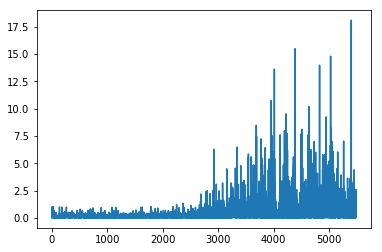

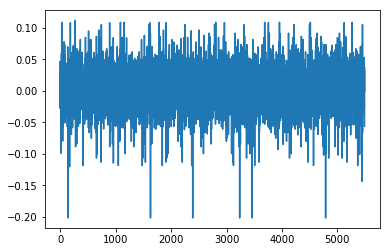

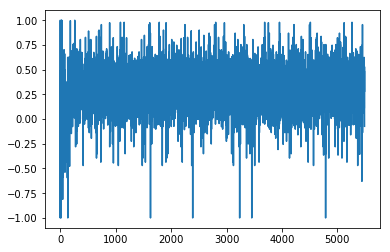

0.945060391251
[ 0.88888889  0.66666667  0.66666667  0.88888889  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667
  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667]
Writing away results
2000-04-01 00:00:00


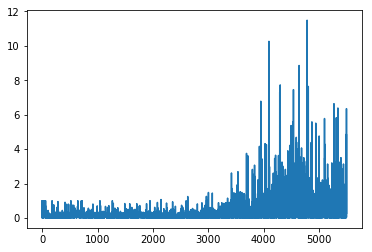

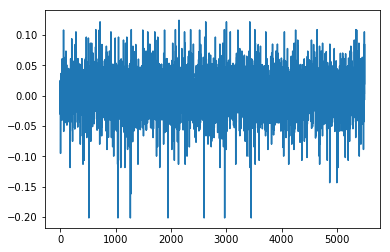

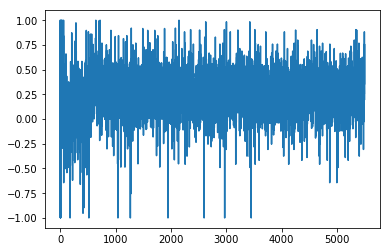

0.991353043953
[ 0.66666667  0.66666667  0.88888889  0.66666667  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
2000-05-01 00:00:00


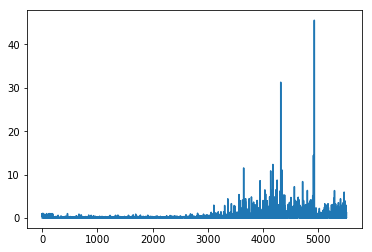

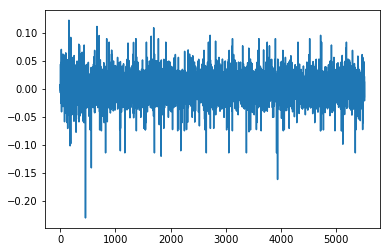

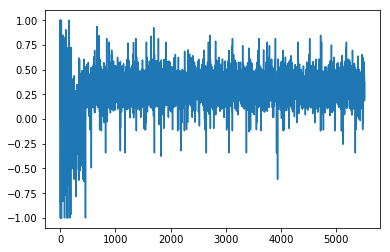

1.13083893216
[ 0.11111111  0.11111111  0.11111111  0.55555556  0.55555556  0.11111111
  0.11111111  0.11111111  0.55555556  0.11111111  0.11111111  0.11111111
  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.11111111  0.55555556  0.11111111  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111]
Writing away results
2000-06-01 00:00:00


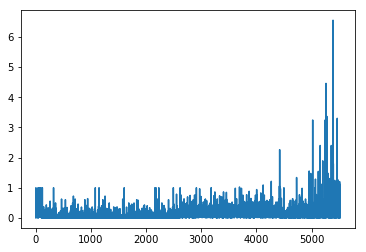

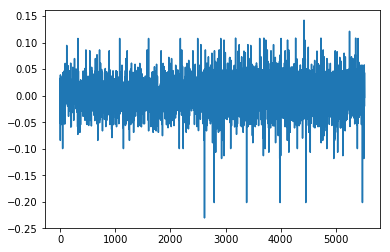

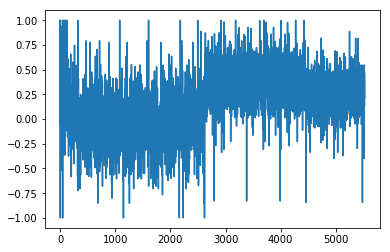

0.989627499951
[ 0.66666667  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.66666667  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667]
Writing away results
2000-07-01 00:00:00


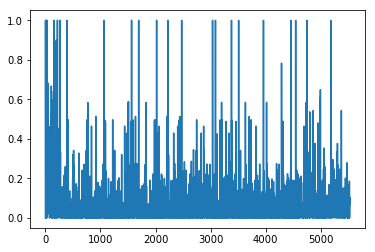

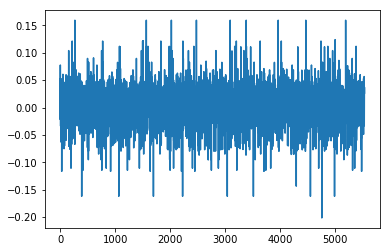

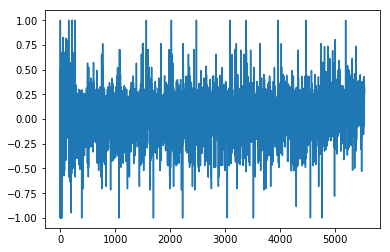

0.939583109774
[ 1.          0.55555556  0.55555556  1.          1.          1.          1.
  1.          1.          1.          1.          0.55555556  0.55555556
  1.          1.          1.          1.          0.55555556  0.55555556
  0.55555556  0.55555556  1.          1.          1.          1.          1.
  1.          1.          0.55555556  0.55555556  0.55555556  1.          1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  1.          1.          1.          1.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  1.          1.
  0.55555556]
Writing away results
2000-08-01 00:00:00


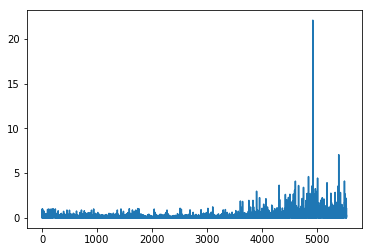

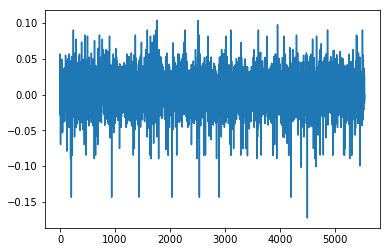

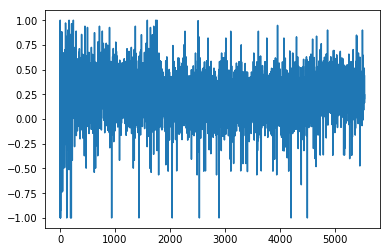

1.18022829121
[ 0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.22222222  0.22222222  0.66666667  0.66666667  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.66666667  0.22222222
  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667]
Writing away results
2000-09-01 00:00:00


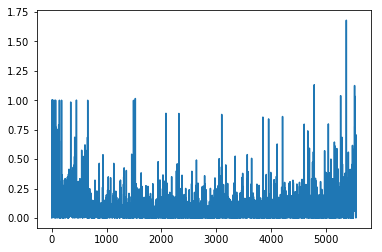

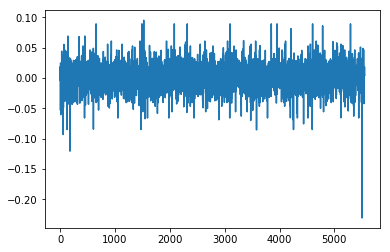

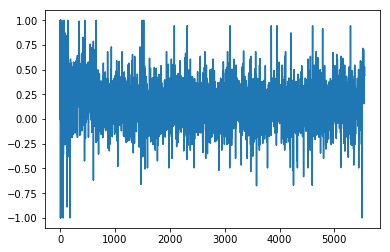

1.2174668297
[ 0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.22222222  0.11111111
  0.11111111  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.22222222  0.22222222  0.11111111  0.11111111
  0.11111111  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.11111111  0.11111111  0.22222222  0.11111111  0.11111111
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.11111111  0.11111111  0.22222222  0.22222222  0.22222222]
Writing away results
2000-10-01 00:00:00


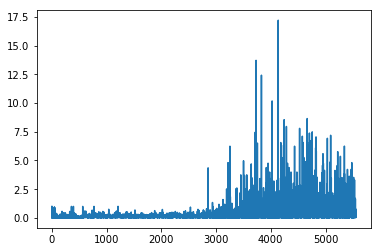

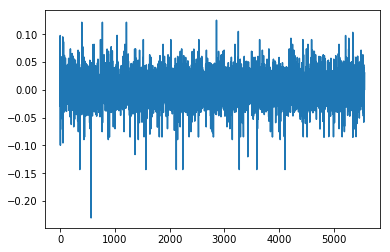

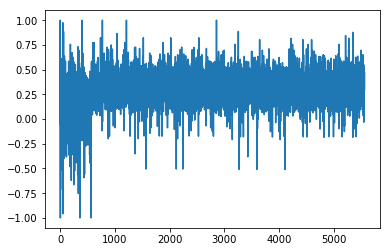

1.13201775543
[ 0.44444444  0.44444444  0.44444444  0.66666667  0.44444444  0.44444444
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.66666667  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.44444444
  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2000-11-01 00:00:00


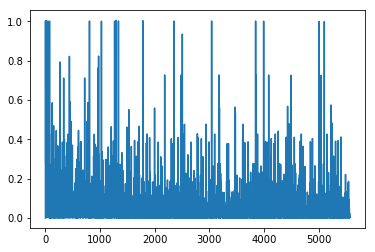

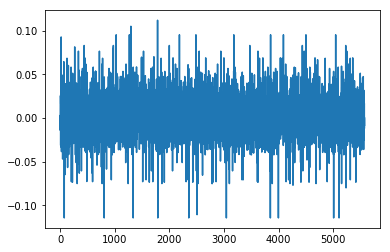

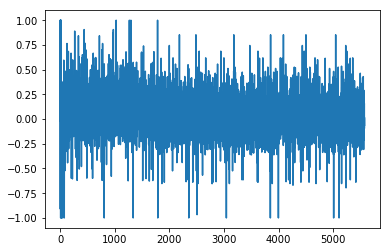

1.31561804782
[ 0.          0.          0.          0.          0.          0.          0.
  0.55555556  0.55555556  0.          0.          0.          0.
  0.55555556  0.55555556  0.55555556  0.          0.          0.          0.
  0.          0.          0.          0.          0.55555556  0.55555556
  0.55555556  0.          0.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.          0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.          0.77777778  0.55555556  0.55555556
  0.55555556  0.55555556]
Writing away results
2000-12-01 00:00:00


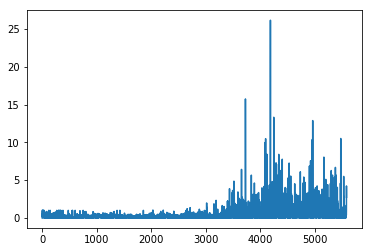

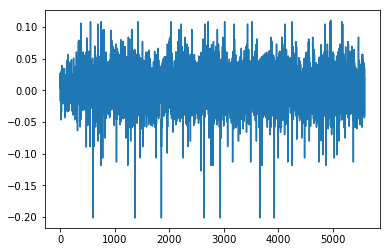

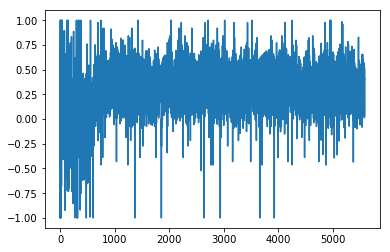

1.22253810194
[ 0.33333333  0.88888889  0.33333333  0.33333333  0.88888889  0.88888889
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.88888889
  0.88888889  0.33333333  0.33333333  0.88888889  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.88888889  0.88888889
  0.33333333  0.33333333  0.33333333  0.33333333  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333  0.33333333
  0.88888889  0.33333333  0.33333333  0.88888889  0.88888889  0.88888889
  0.88888889  0.33333333  0.88888889  0.33333333  0.33333333  0.88888889
  0.88888889  0.88888889  0.88888889  0.33333333  0.33333333]
Writing away results
2001-01-01 00:00:00


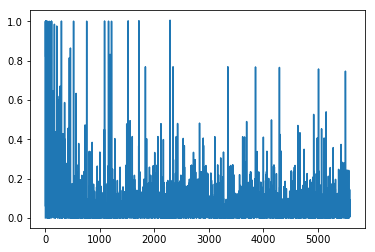

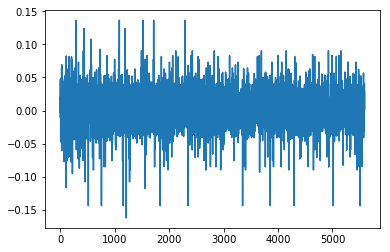

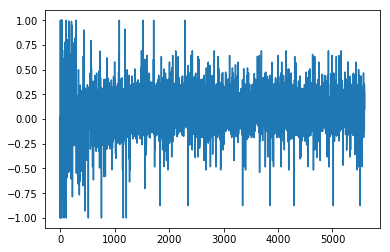

1.17686890617
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667]
Writing away results
2001-02-01 00:00:00


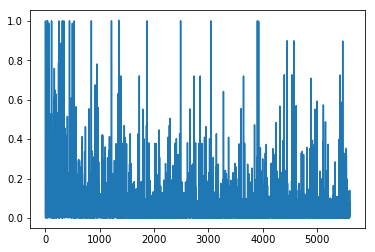

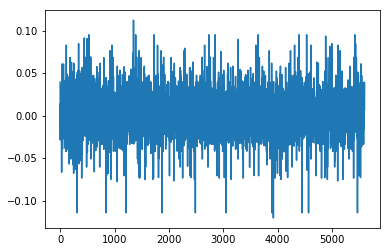

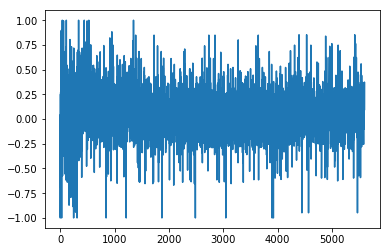

1.28907726675
[ 0.          0.          0.          0.          0.55555556  0.55555556
  0.          0.          0.          0.          0.55555556  0.55555556
  0.55555556  0.          0.          0.          0.          0.          0.
  0.          0.          0.55555556  0.55555556  0.55555556  0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.          0.          0.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.
  0.          0.55555556  0.55555556  0.55555556  0.55555556  0.
  0.55555556  0.55555556]
Writing away results
2001-03-01 00:00:00


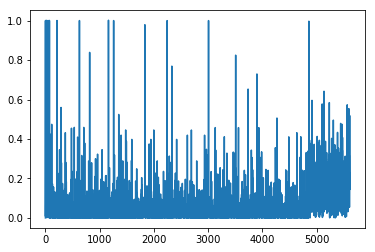

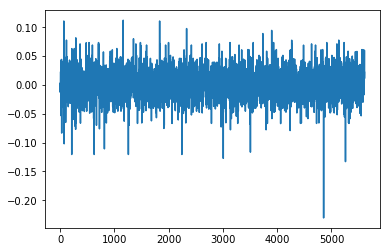

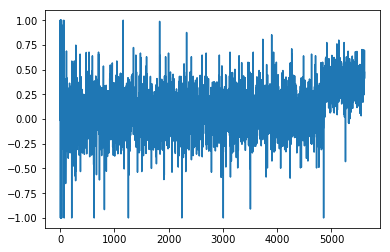

1.16179344783
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.22222222  0.44444444
  0.44444444  0.44444444  0.44444444  0.22222222  0.22222222  0.22222222
  0.22222222  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.22222222  0.22222222  0.22222222  0.44444444
  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
2001-04-01 00:00:00


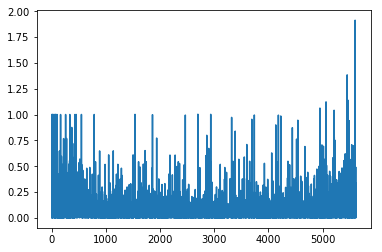

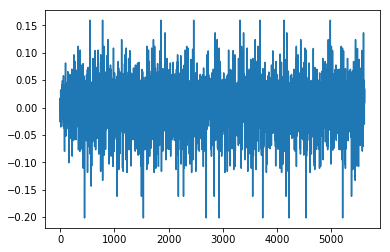

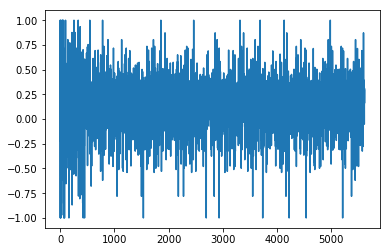

1.18735047317
[ 1.          0.88888889  0.88888889  1.          1.          1.          1.
  0.88888889  0.88888889  0.88888889  1.          0.88888889  1.          1.
  1.          1.          1.          1.          1.          0.88888889
  0.88888889  1.          1.          1.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  0.88888889  1.          1.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  1.          1.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  1.          0.88888889
  0.88888889  0.88888889  0.88888889]
Writing away results
2001-05-01 00:00:00


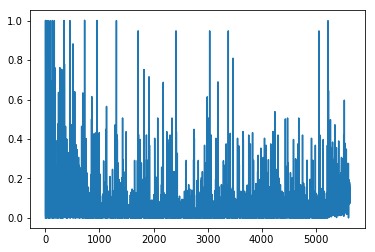

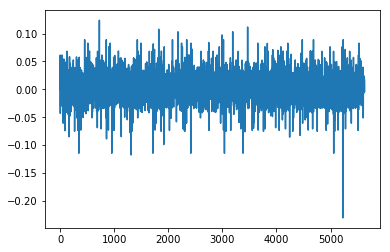

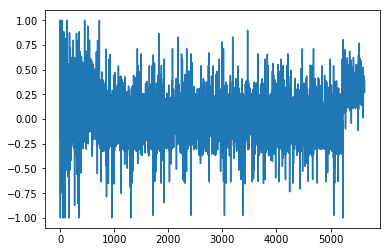

1.27901652587
[ 0.11111111  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111
  0.11111111  0.55555556  0.55555556  0.55555556  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.55555556  0.55555556  0.11111111  0.11111111  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.11111111  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111  0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
2001-06-01 00:00:00


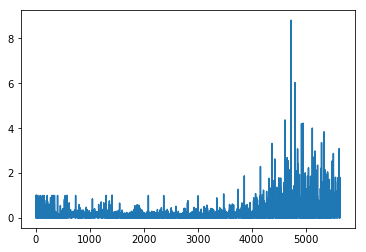

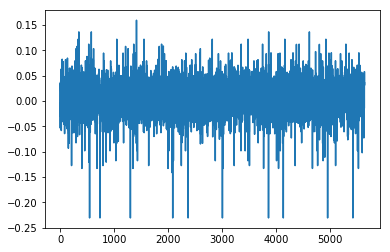

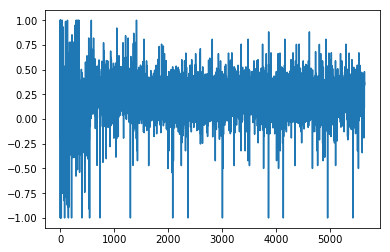

1.47301158006
[ 0.  0.  0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  0.  0.  1.  1.
  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.
  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.
  1.  1.  1.  1.  1.]
Writing away results
2001-07-01 00:00:00


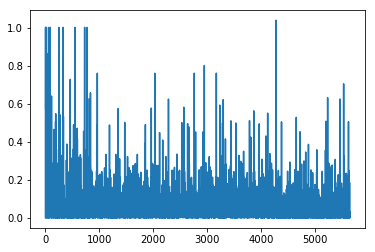

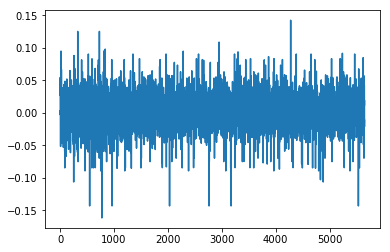

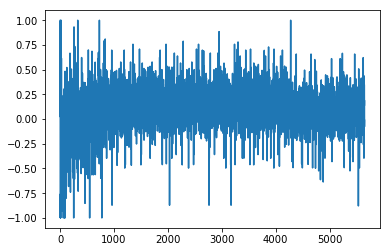

1.23072406305
[ 0.66666667  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.22222222]
Writing away results
2001-08-01 00:00:00


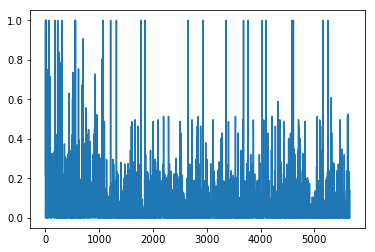

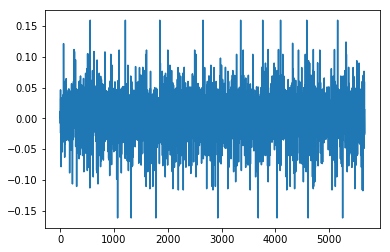

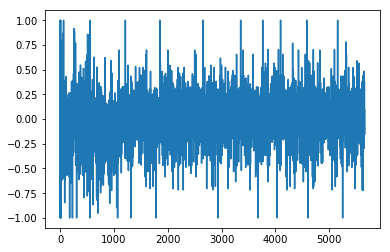

1.11408859307
[ 1.          1.          1.          1.          0.55555556  0.55555556
  0.55555556  1.          1.          1.          1.          1.          1.
  1.          1.          0.55555556  0.55555556  0.55555556  1.          1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  1.          1.          1.          1.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  1.          1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  1.
  0.55555556  0.77777778  0.55555556  0.55555556  0.55555556  0.55555556
  1.          1.        ]
Writing away results
2001-09-01 00:00:00


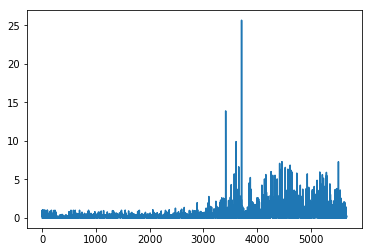

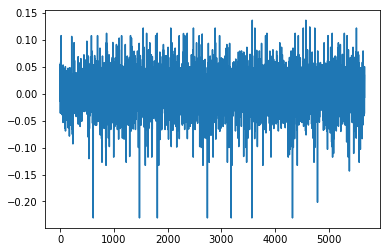

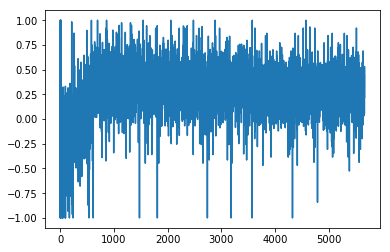

1.47907614375
[ 0.66666667  0.66666667  1.          1.          0.66666667  0.66666667
  1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          1.          0.66666667  0.66666667  0.66666667
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  1.          0.66666667  0.66666667  1.          1.
  1.          1.          0.66666667  1.          0.66666667  0.66666667
  1.          1.          1.          1.          1.          0.66666667
  1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667]
Writing away results
2001-10-01 00:00:00


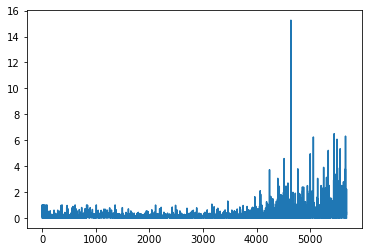

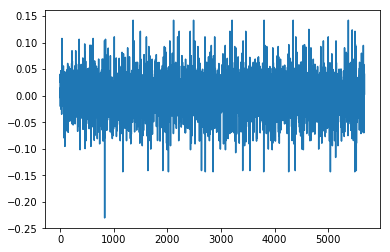

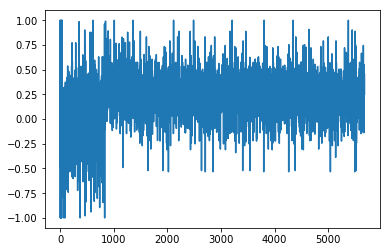

1.31803545018
[ 0.88888889  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.66666667  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667]
Writing away results
2001-11-01 00:00:00


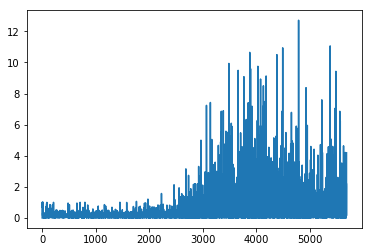

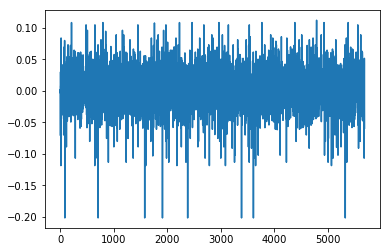

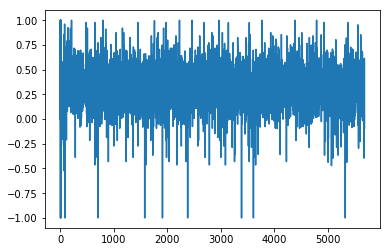

1.34418724898
[ 0.88888889  0.88888889  0.88888889  0.11111111  0.88888889  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.88888889  0.88888889  0.11111111  0.11111111  0.11111111  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111
  0.11111111  0.88888889  0.11111111  0.11111111  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111  0.11111111
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.11111111
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.11111111  0.11111111  0.11111111  0.88888889  0.88888889]
Writing away results
2001-12-01 00:00:00


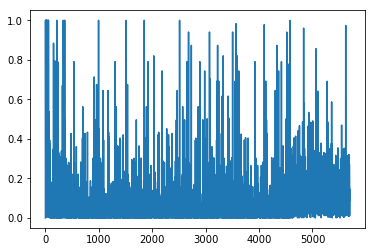

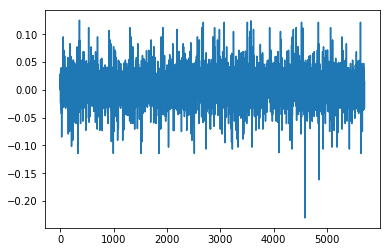

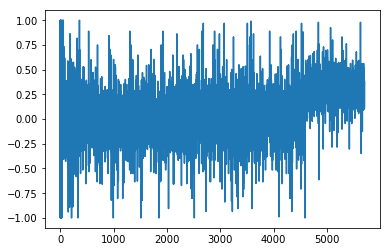

1.33401444545
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.          0.          0.
  0.          0.          0.          0.          0.55555556  0.
  0.55555556  0.          0.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.          0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.          0.          0.
  0.55555556  0.55555556]
Writing away results
2002-01-01 00:00:00


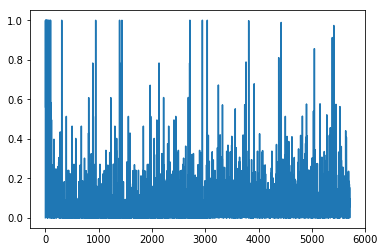

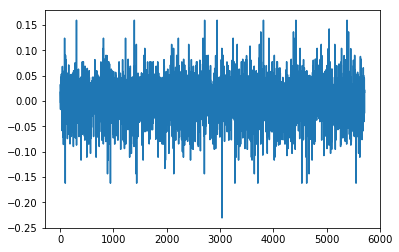

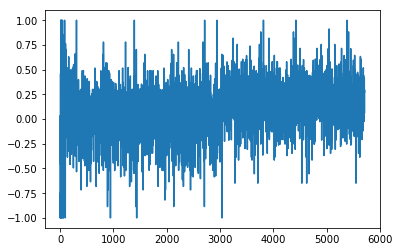

1.25250640116
[ 0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          1.          0.66666667  0.66666667  0.66666667
  1.          1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667]
Writing away results
2002-02-01 00:00:00


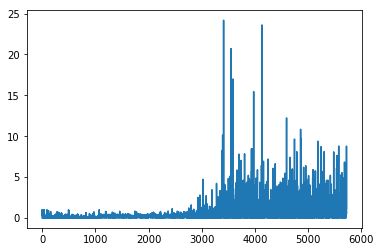

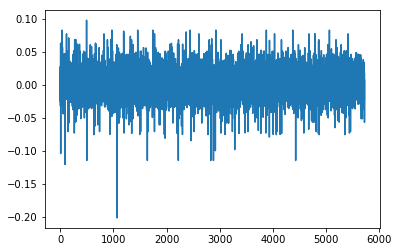

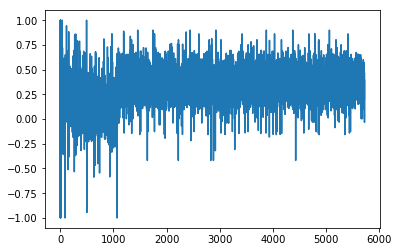

1.30794429604
[ 0.33333333  0.55555556  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.55555556  0.55555556  0.33333333  0.33333333
  0.55555556  0.33333333  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.33333333  0.33333333  0.55555556  0.33333333
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.33333333
  0.55555556  0.33333333  0.33333333  0.55555556  0.55555556  0.55555556
  0.55555556  0.33333333  0.33333333  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.33333333  0.33333333  0.33333333
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
2002-03-01 00:00:00


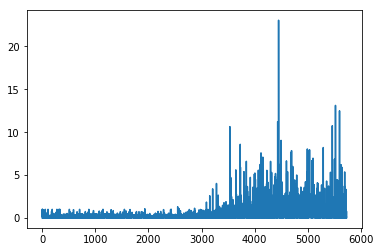

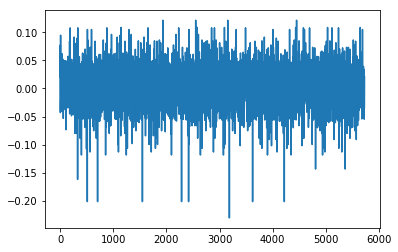

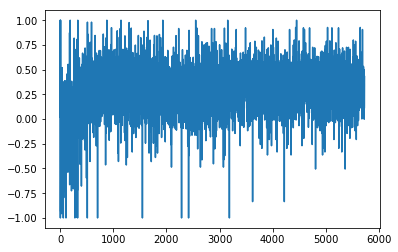

1.38906380457
[ 0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.88888889  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
2002-04-01 00:00:00


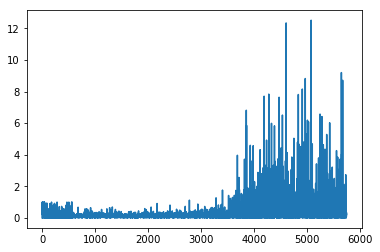

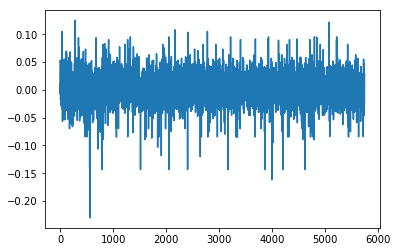

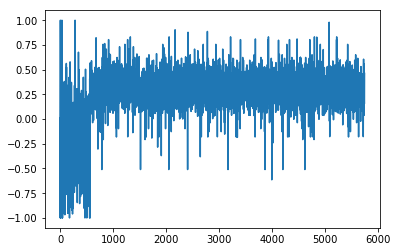

1.44587402119
[ 0.          0.          0.          0.          0.          0.
  0.66666667  0.66666667  0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.66666667  0.          0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.66666667  0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.        ]
Writing away results
2002-05-01 00:00:00


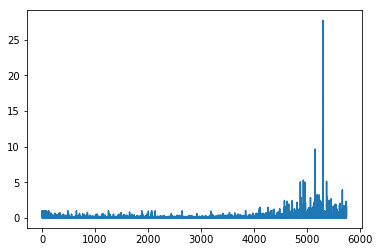

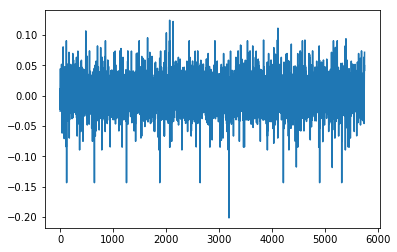

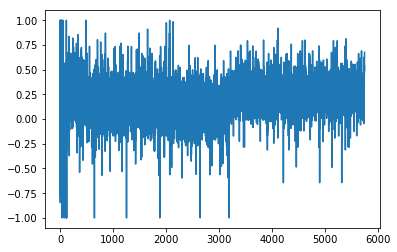

1.40408739931
[ 0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667]
Writing away results
2002-06-01 00:00:00


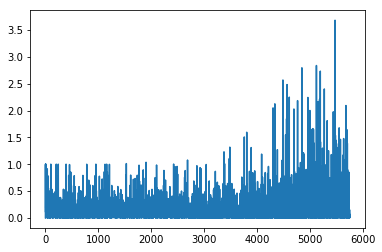

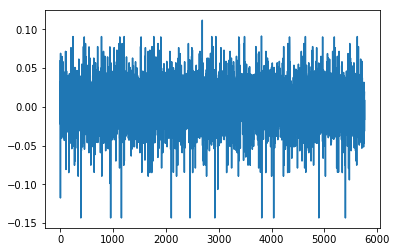

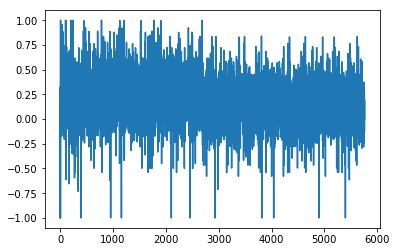

1.43874965718
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.66666667  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.66666667  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667]
Writing away results
2002-07-01 00:00:00


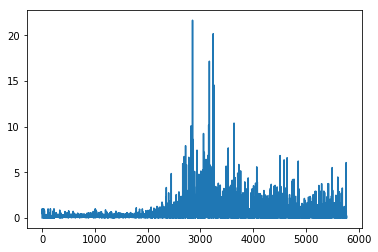

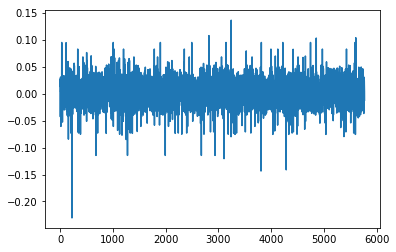

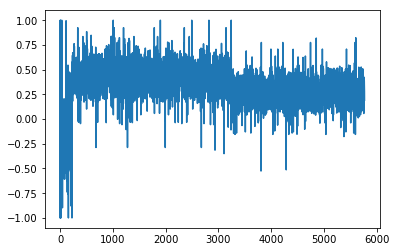

1.26870200096
[ 0.          0.55555556  0.          0.55555556  0.55555556  0.          0.
  0.          0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.          0.55555556  0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.
  0.55555556  0.          0.          0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.          0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.55555556  0.55555556  0.55555556]
Writing away results
2002-08-01 00:00:00


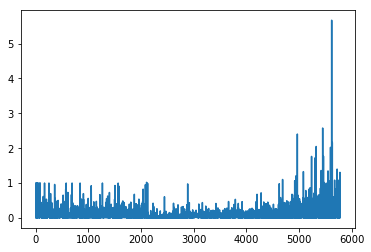

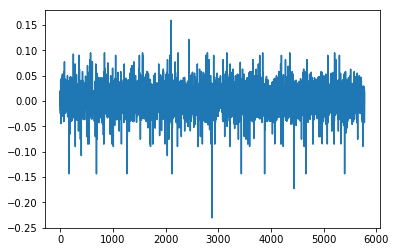

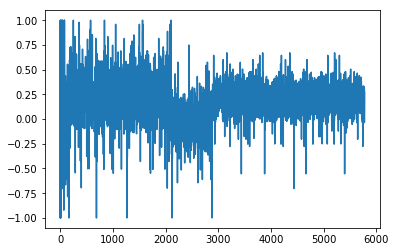

1.31951687305
[ 0.          0.          0.          0.66666667  0.66666667  0.          0.
  0.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.66666667  0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.          0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.          0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2002-09-01 00:00:00


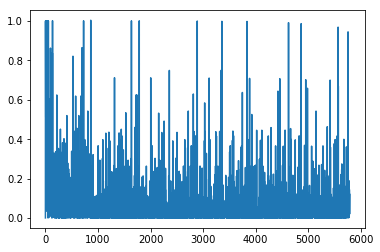

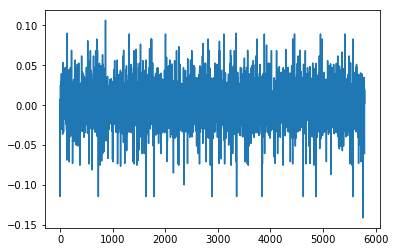

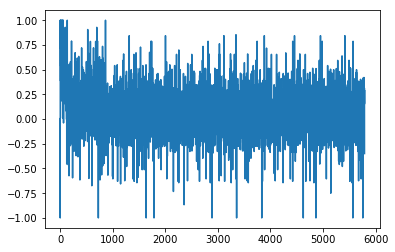

1.2938086763
[ 0.11111111  0.11111111  0.55555556  0.11111111  0.55555556  0.11111111
  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.11111111]
Writing away results
2002-10-01 00:00:00


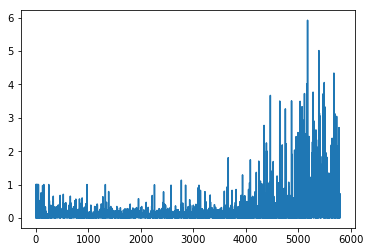

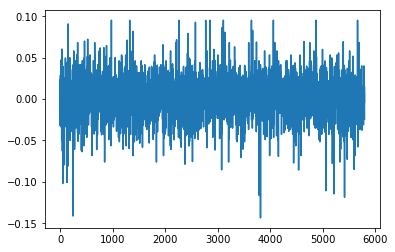

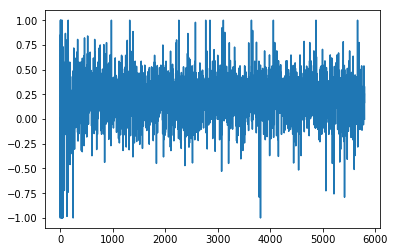

1.18363869148
[ 0.33333333  0.33333333  0.          0.          0.          0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.          0.          0.33333333  0.          0.          0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.          0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.          0.          0.          0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.          0.33333333  0.33333333
  0.33333333  0.33333333  0.          0.        ]
Writing away results
2002-11-01 00:00:00


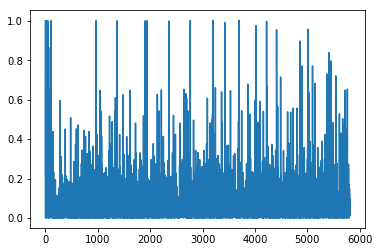

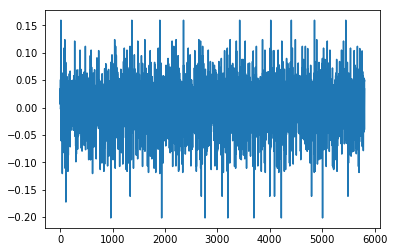

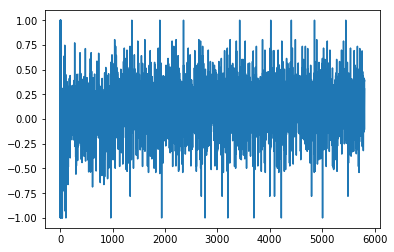

1.71585661825
[ 0.88888889  0.88888889  0.88888889  1.          1.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  1.          1.          1.          1.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  1.          1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889  1.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.
  1.          1.          0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  1.          1.          0.88888889]
Writing away results
2002-12-01 00:00:00


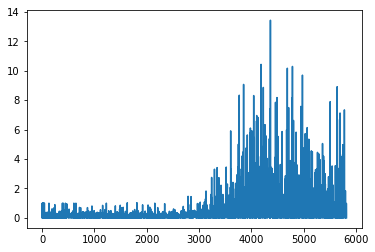

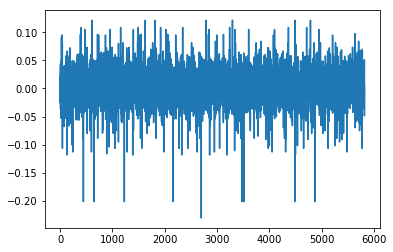

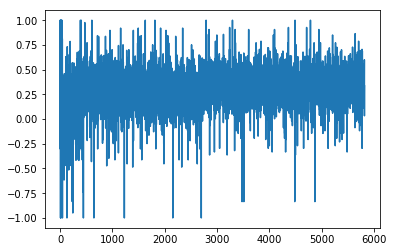

1.49420140454
[ 0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  0.88888889  0.          0.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.          0.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.          0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.          0.88888889  0.88888889]
Writing away results
2003-01-01 00:00:00


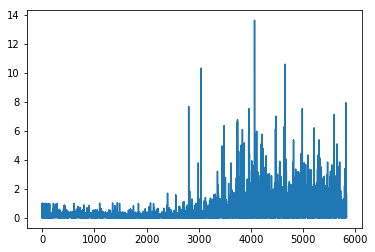

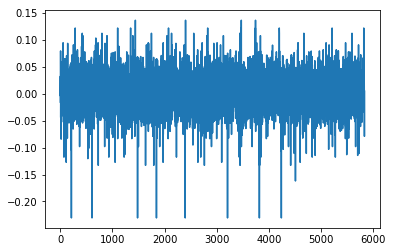

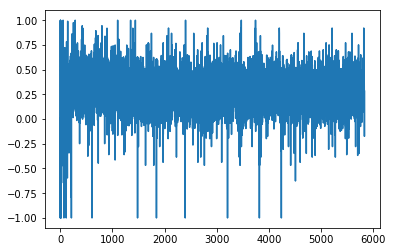

1.74991559129
[ 0.55555556  0.55555556  0.55555556  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.55555556  0.55555556  1.          0.55555556  0.55555556
  1.          1.          1.          1.          0.55555556  1.
  0.55555556  0.55555556  1.          1.          1.          1.          1.
  0.55555556  1.          1.          1.          1.          1.          1.
  0.55555556  0.55555556  0.55555556  1.          1.          1.          1.
  1.          1.          0.55555556  1.          1.          1.
  0.55555556  0.55555556  1.          1.          1.          0.55555556]
Writing away results
2003-02-01 00:00:00


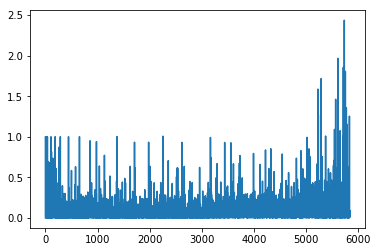

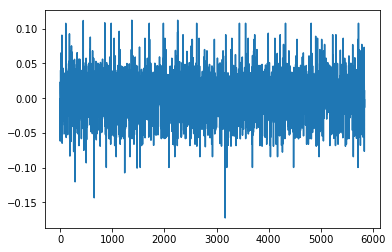

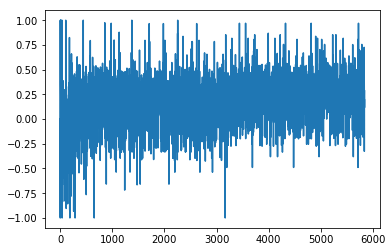

1.29729327447
[ 0.66666667  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.33333333  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.66666667
  0.66666667  0.33333333  0.33333333  0.33333333  0.66666667]
Writing away results
2003-03-01 00:00:00


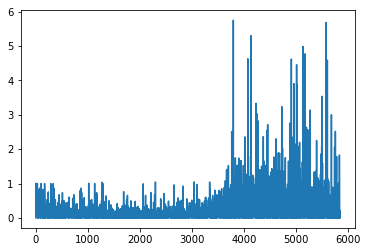

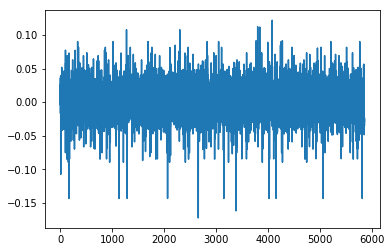

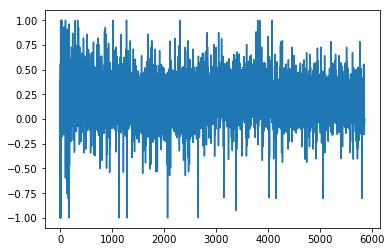

1.44311038697
[ 0.44444444  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.66666667  0.44444444  0.44444444
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444]
Writing away results
2003-04-01 00:00:00


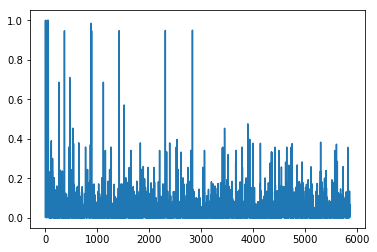

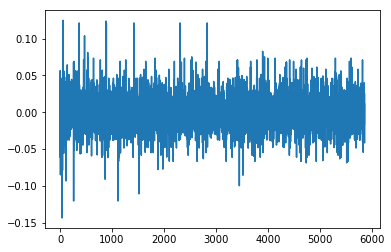

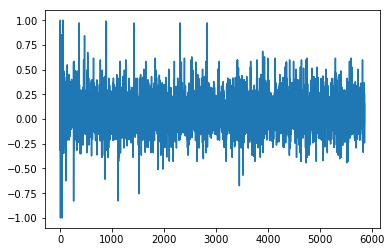

1.0419831532
[ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.          0.          0.
  0.          0.          0.          0.          0.44444444  0.          0.
  0.          0.          0.          0.          0.44444444  0.          0.
  0.          0.          0.          0.44444444  0.44444444  0.44444444
  0.44444444  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.44444444
  0.          0.          0.          0.44444444  0.44444444  0.44444444]
Writing away results
2003-05-01 00:00:00


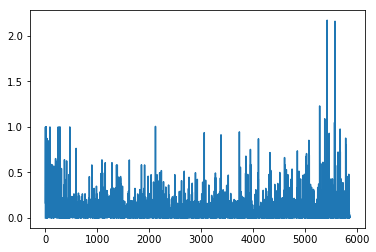

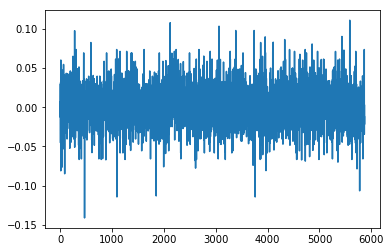

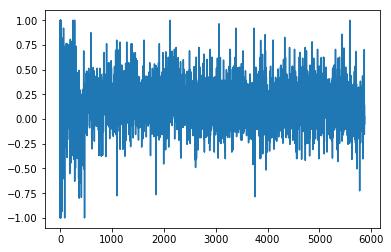

1.12944521677
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.44444444
  0.44444444  0.22222222  0.44444444  0.44444444  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.44444444  0.44444444
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.44444444
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.44444444  0.44444444  0.22222222  0.22222222
  0.22222222  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
2003-06-01 00:00:00


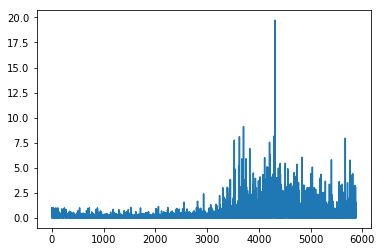

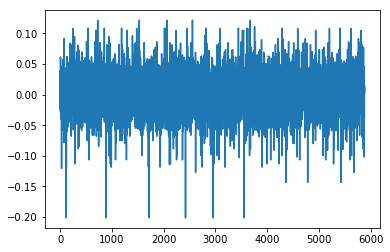

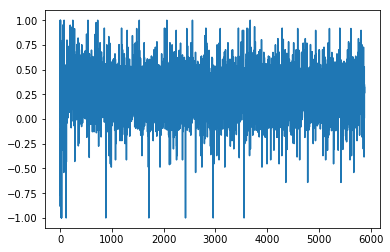

1.46025017792
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889]
Writing away results
2003-07-01 00:00:00


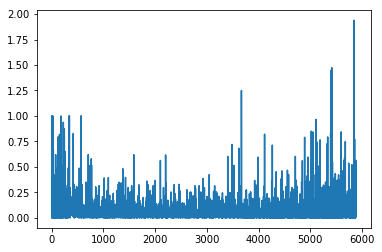

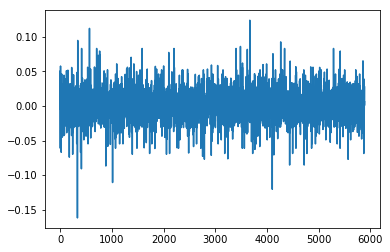

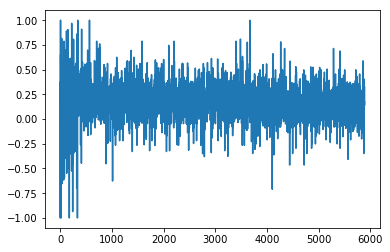

1.05778360013
[ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.22222222  0.22222222  0.          0.22222222
  0.22222222  0.          0.          0.          0.          0.          0.
  0.22222222  0.22222222  0.          0.          0.          0.          0.
  0.22222222  0.          0.          0.          0.          0.          0.
  0.22222222  0.22222222  0.22222222  0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.22222222  0.22222222  0.          0.          0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.          0.        ]
Writing away results
2003-08-01 00:00:00


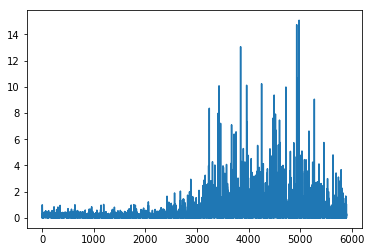

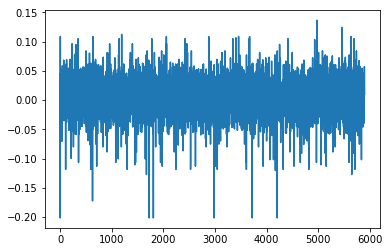

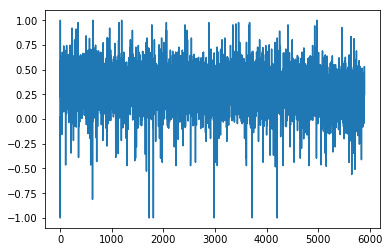

1.2708986147
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.33333333  0.33333333  0.88888889  0.33333333
  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333
  0.88888889  0.33333333  0.33333333  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.33333333  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.33333333  0.33333333  0.33333333
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333
  0.33333333  0.88888889  0.88888889  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.88888889  0.88888889  0.33333333]
Writing away results
2003-09-01 00:00:00


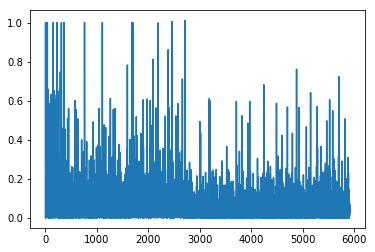

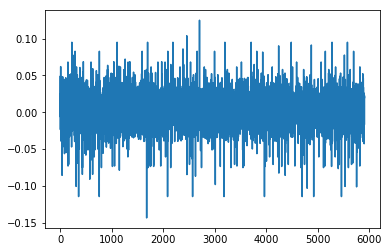

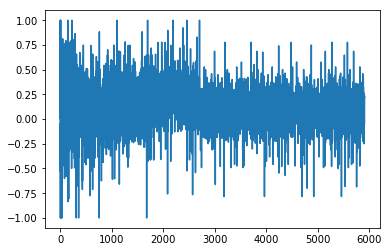

1.17176780652
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.          0.55555556  0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.          0.          0.          0.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.
  0.55555556  0.55555556  0.55555556  0.          0.          0.          0.
  0.          0.55555556  0.          0.        ]
Writing away results
2003-10-01 00:00:00


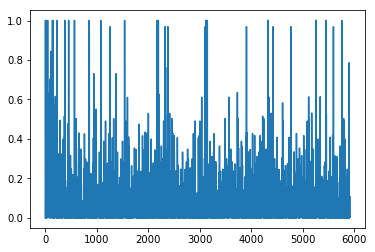

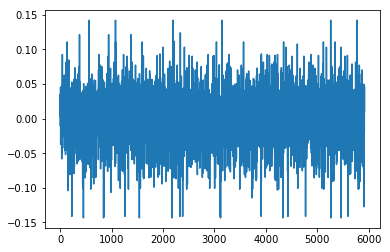

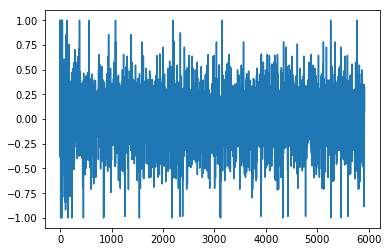

1.11320819219
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889]
Writing away results
2003-11-01 00:00:00


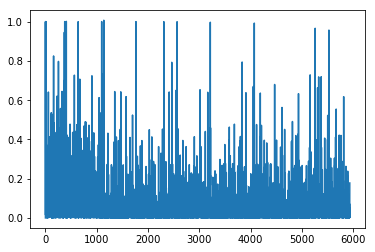

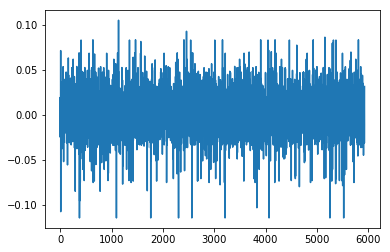

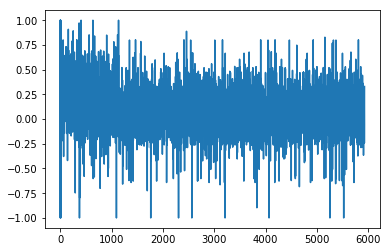

1.10590536278
[ 0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.22222222  0.22222222  0.55555556  0.55555556
  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.55555556  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
2003-12-01 00:00:00


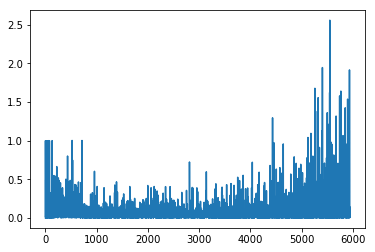

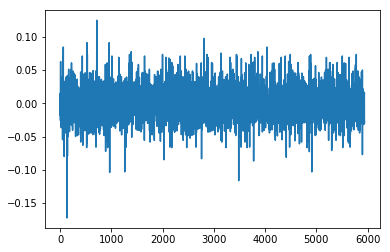

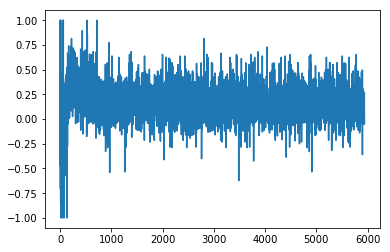

0.948472114559
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.44444444  0.44444444
  0.22222222  0.44444444  0.44444444  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.44444444  0.44444444  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.44444444  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.44444444
  0.44444444  0.44444444  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.44444444  0.22222222  0.22222222  0.22222222
  0.22222222  0.44444444  0.44444444  0.22222222  0.22222222  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.22222222  0.22222222
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
2004-01-01 00:00:00


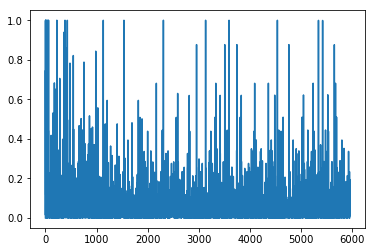

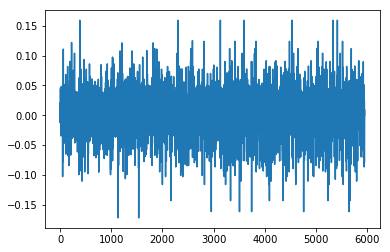

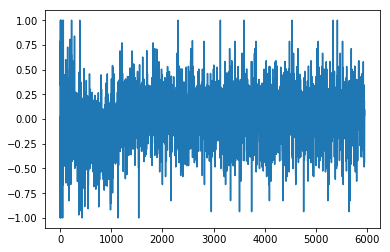

0.818514908708
[ 0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.          0.66666667  1.          1.          1.          1.          1.
  1.        ]
Writing away results
2004-02-01 00:00:00


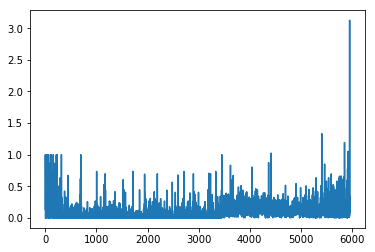

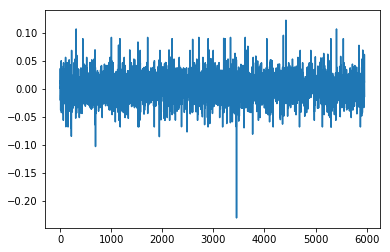

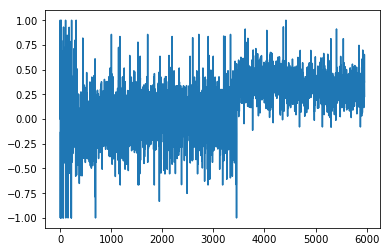

1.07455731537
[ 0.33333333  0.33333333  0.11111111  0.11111111  0.33333333  0.11111111
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.11111111  0.11111111  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.11111111  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.11111111  0.11111111  0.11111111
  0.11111111  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.11111111
  0.11111111  0.33333333  0.33333333  0.33333333  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.33333333  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111]
Writing away results
2004-03-01 00:00:00


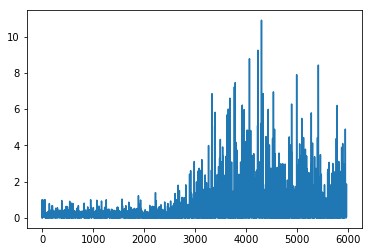

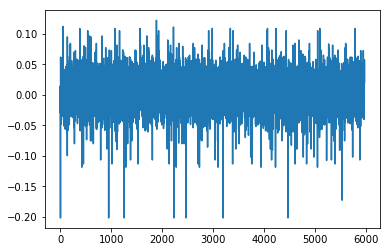

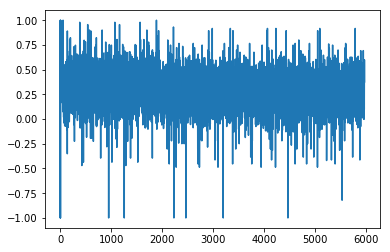

1.00775357011
[ 0.88888889  0.33333333  0.33333333  0.88888889  0.33333333  0.33333333
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.33333333  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.33333333  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.33333333  0.33333333  0.33333333  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333
  0.88888889  0.88888889  0.88888889  0.88888889  0.33333333  0.33333333
  0.88888889  0.88888889  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.88888889  0.88888889  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333]
Writing away results
2004-04-01 00:00:00


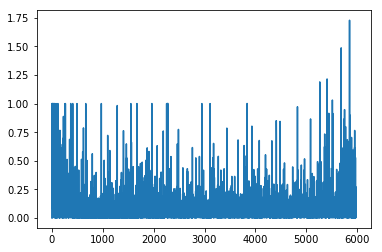

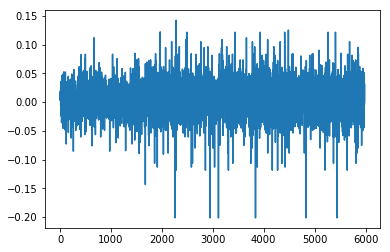

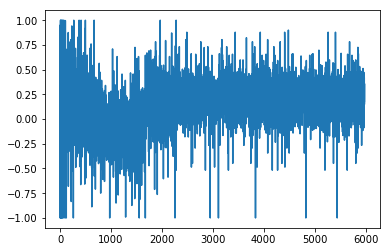

1.10781395695
[ 0.22222222  0.22222222  0.88888889  0.22222222  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.22222222
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.22222222  0.22222222  0.22222222  0.22222222  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222  0.88888889
  0.88888889  0.88888889  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.88888889  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
2004-05-01 00:00:00


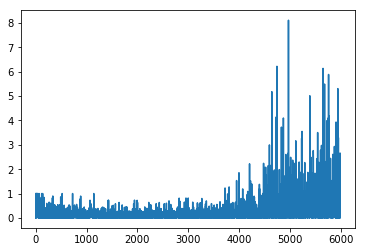

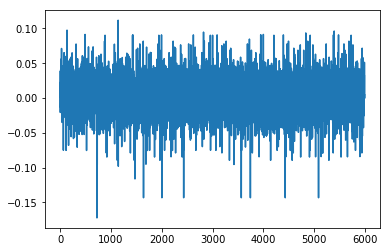

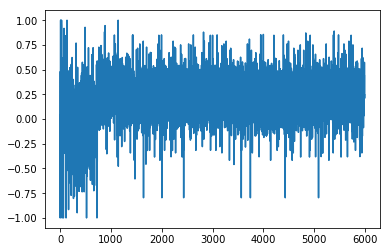

0.989899686588
[ 0.55555556  0.66666667  0.55555556  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.66666667  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.55555556  0.66666667  0.66666667
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667
  0.66666667  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.66666667]
Writing away results
2004-06-01 00:00:00


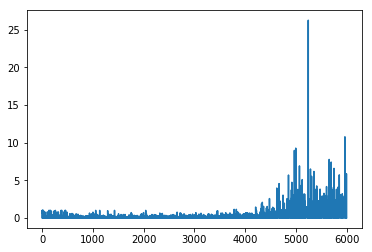

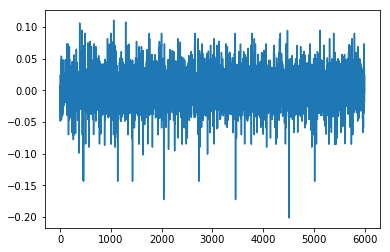

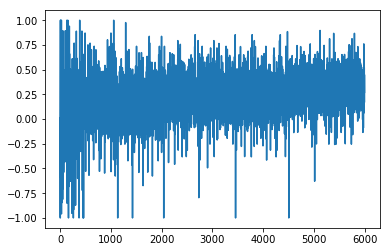

1.08604380221
[ 0.66666667  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.44444444  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667]
Writing away results
2004-07-01 00:00:00


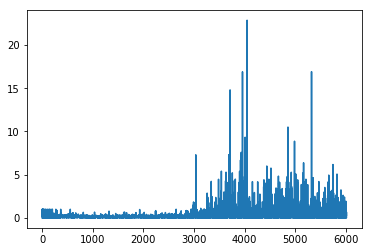

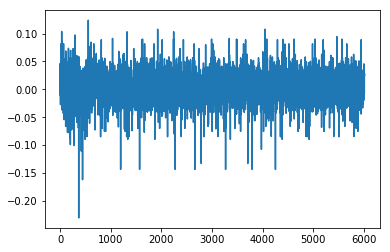

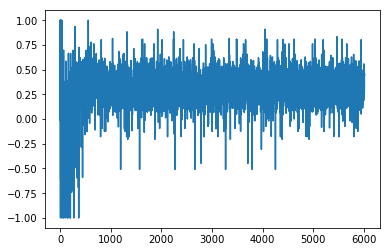

1.37479734069
[ 0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.66666667  0.66666667  0.66666667]
Writing away results
2004-08-01 00:00:00


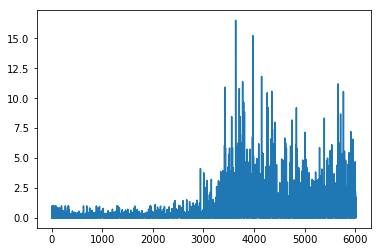

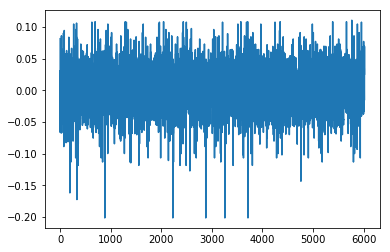

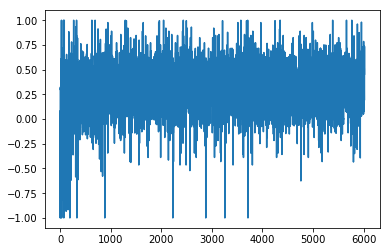

1.14509201704
[ 0.66666667  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.88888889  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
2004-09-01 00:00:00


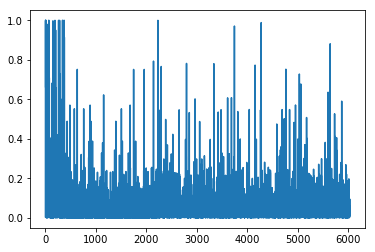

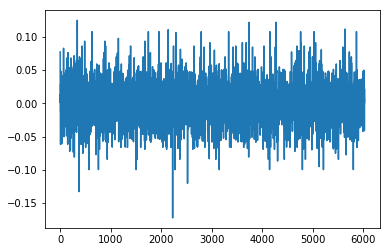

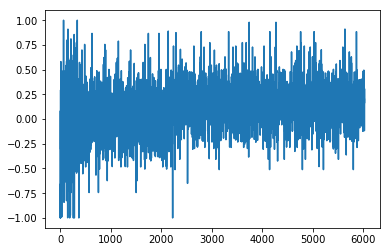

0.907756495195
[ 0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667  0.66666667
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667
  0.22222222  0.22222222  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222]
Writing away results
2004-10-01 00:00:00


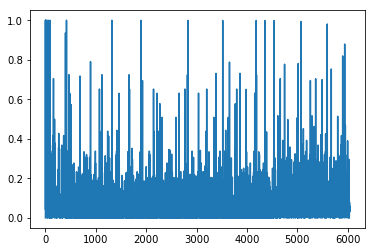

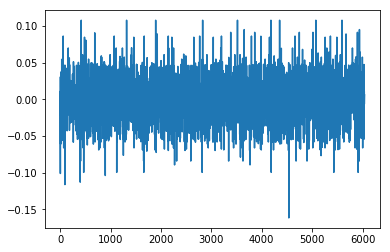

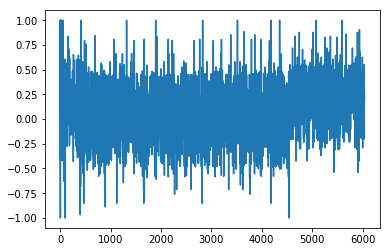

0.851120125773
[ 0.          0.          0.          0.          0.          0.
  0.66666667  0.          0.          0.          0.          0.          0.
  0.66666667  0.          0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.66666667  0.          0.          0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.          0.          0.
  0.        ]
Writing away results
2004-11-01 00:00:00


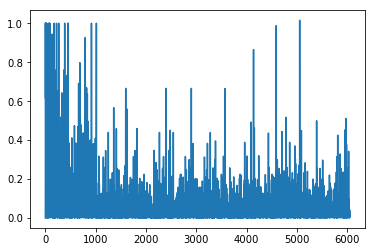

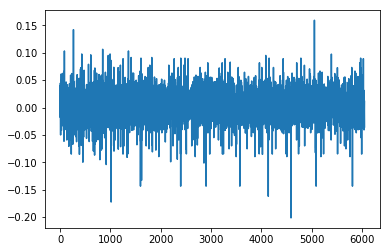

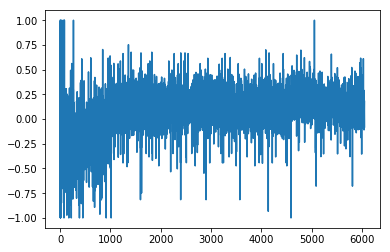

1.25818473835
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.11111111  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.66666667  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2004-12-01 00:00:00


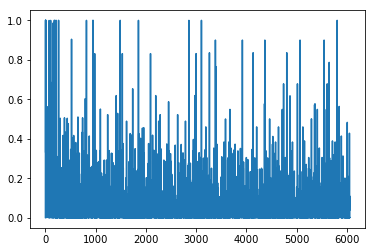

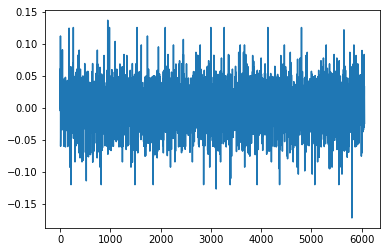

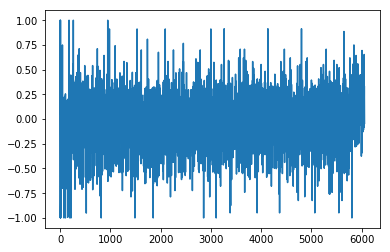

1.17566950378
[ 0.66666667  0.55555556  0.66666667  0.11111111  0.11111111  0.66666667
  0.55555556  0.66666667  0.66666667  0.66666667  0.11111111  0.66666667
  0.77777778  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.77777778  0.66666667  0.66666667  0.66666667  0.55555556  0.66666667
  0.66666667  0.11111111  0.66666667  0.11111111  0.11111111  0.77777778
  0.11111111  0.66666667  0.66666667  0.11111111  0.11111111  0.66666667
  0.66666667  0.11111111  0.11111111  0.66666667  0.55555556  0.55555556
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2005-01-01 00:00:00


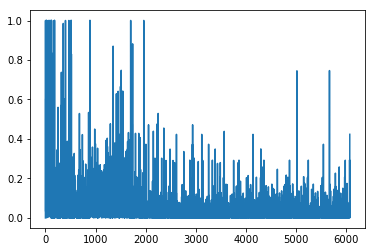

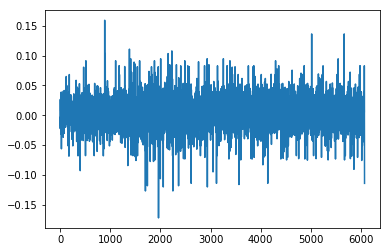

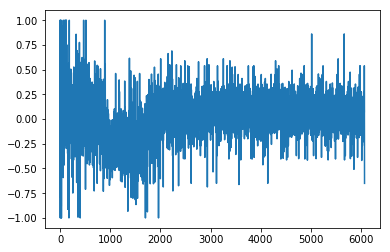

1.16174284637
[ 0.55555556  0.55555556  0.22222222  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.22222222  0.22222222
  0.22222222  0.22222222  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
2005-02-01 00:00:00


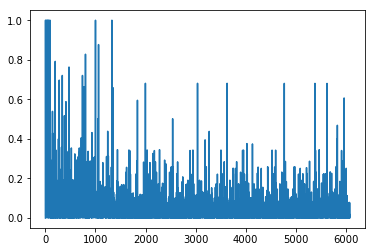

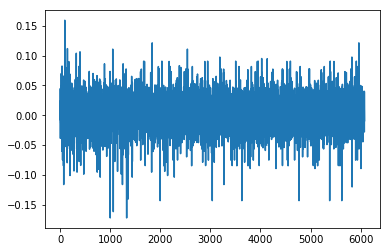

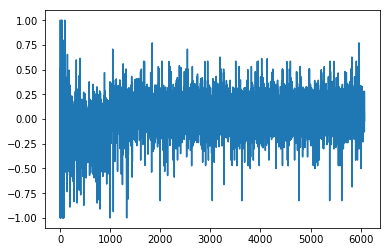

1.070850411
[ 0.66666667  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.55555556  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2005-03-01 00:00:00


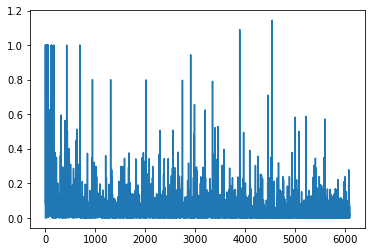

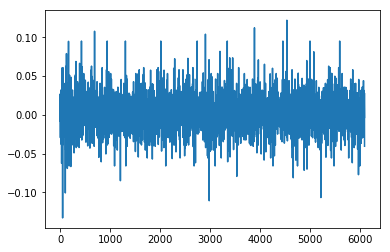

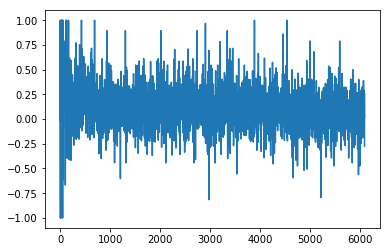

1.21463491872
[ 0.22222222  0.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.          0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.          0.          0.          0.
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.          0.
  0.22222222  0.22222222  0.22222222  0.          0.          0.          0.
  0.          0.22222222  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222]
Writing away results
2005-04-01 00:00:00


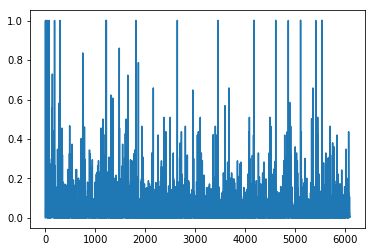

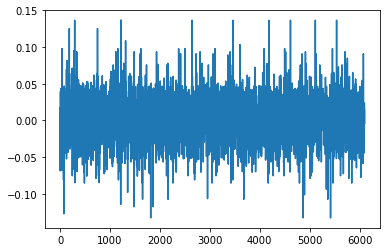

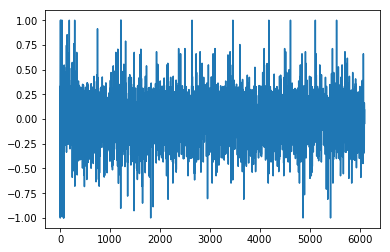

1.14813627581
[ 0.55555556  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.55555556  0.55555556  0.55555556  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.55555556  0.55555556  0.55555556
  0.55555556  0.11111111  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  1.          0.44444444]
Writing away results
2005-05-01 00:00:00


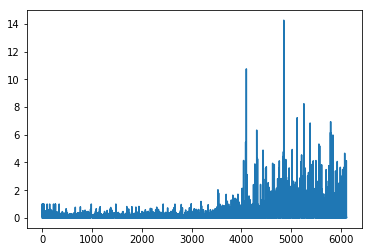

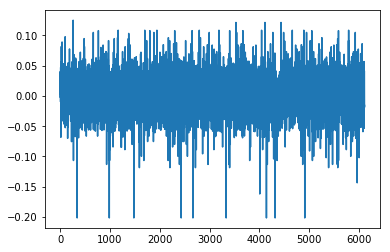

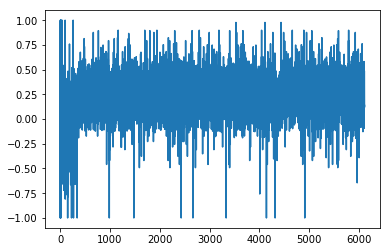

1.22663502131
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.66666667  0.66666667  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889]
Writing away results
2005-06-01 00:00:00


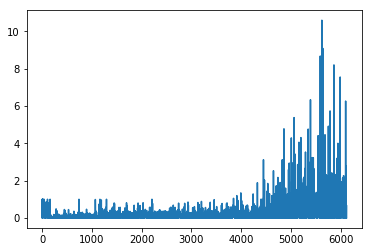

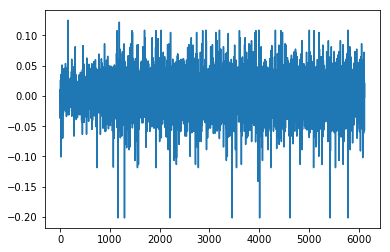

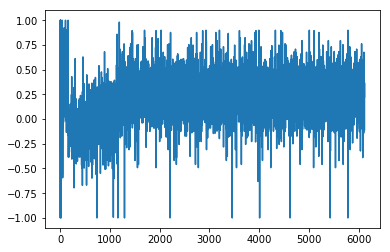

1.13693178938
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.66666667  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.88888889  0.88888889  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889]
Writing away results
2005-07-01 00:00:00


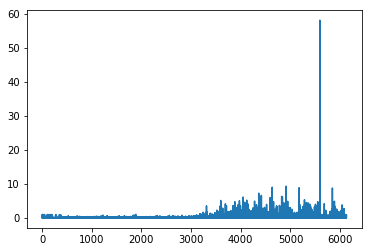

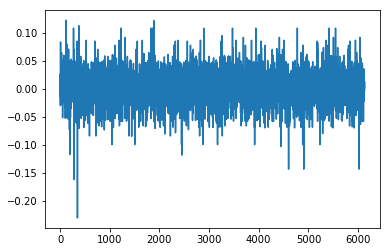

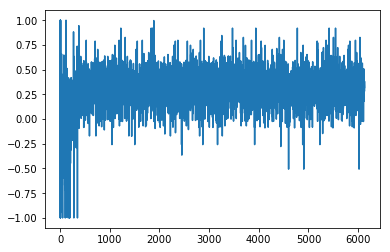

0.858514821253
[ 0.          0.          0.66666667  0.66666667  0.          0.          0.
  0.          0.          0.          0.66666667  0.66666667  0.66666667
  0.          0.          0.          0.          0.          0.
  0.66666667  0.66666667  0.          0.          0.66666667  0.66666667
  0.          0.          0.          0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.          0.          0.66666667  0.66666667
  0.          0.66666667  0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.66666667  0.          0.
  0.          0.66666667]
Writing away results
2005-08-01 00:00:00


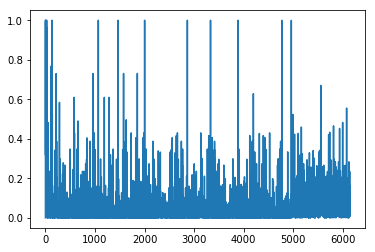

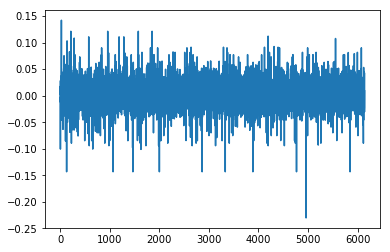

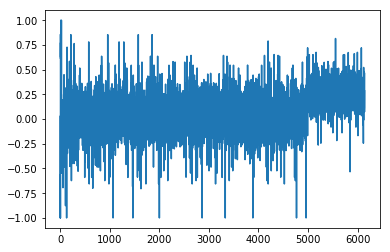

1.14824114524
[ 0.66666667  0.66666667  0.33333333  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333
  0.33333333  0.33333333  0.33333333  0.66666667  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.33333333]
Writing away results
2005-09-01 00:00:00


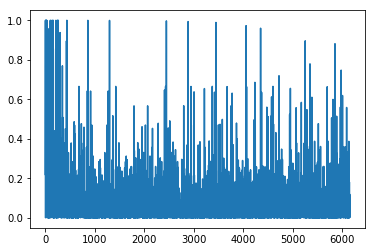

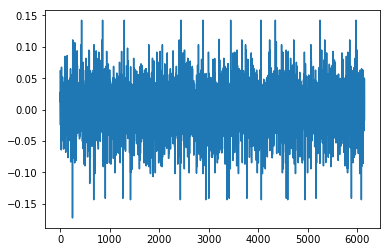

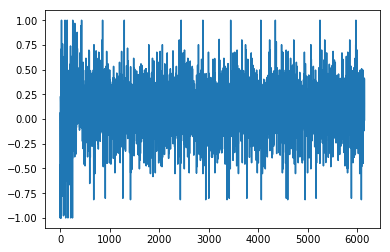

0.961409988859
[ 0.66666667  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.66666667  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.88888889  0.88888889]
Writing away results
2005-10-01 00:00:00


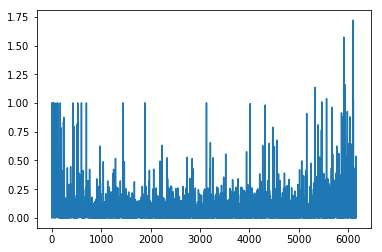

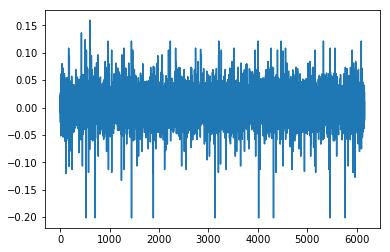

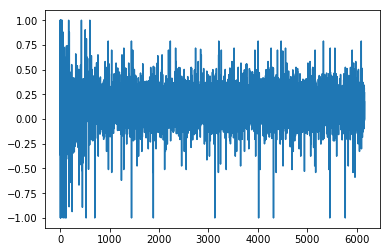

1.29825189924
[ 0.44444444  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.44444444  0.44444444  0.44444444  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.44444444
  0.88888889  0.88888889  0.88888889  0.44444444  0.44444444  0.88888889
  0.88888889  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444
  0.88888889  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
2005-11-01 00:00:00


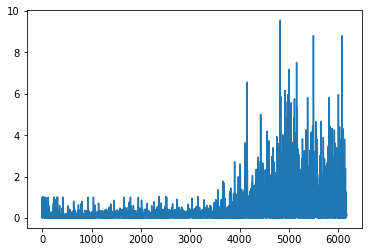

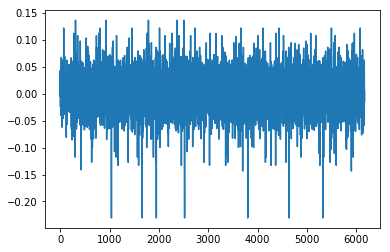

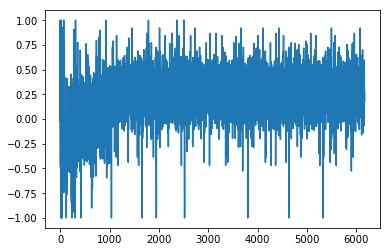

1.33376219458
[ 1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          0.66666667  1.          1.          1.
  0.66666667  0.66666667  0.66666667  1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.66666667  1.          1.          1.          0.66666667  0.66666667
  1.          1.          1.        ]
Writing away results
2005-12-01 00:00:00


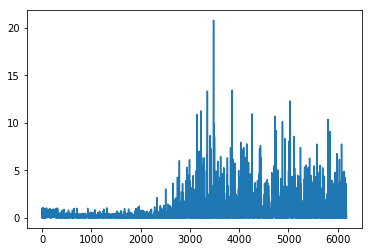

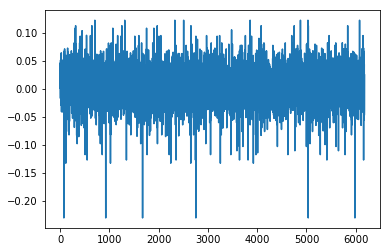

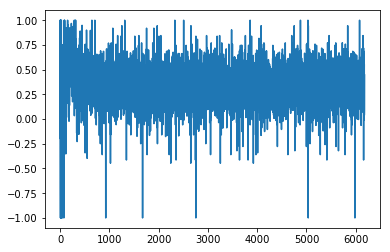

1.42158768256
[ 1.          1.          1.          1.          1.          0.33333333
  0.33333333  0.33333333  1.          1.          1.          1.          1.
  1.          0.33333333  1.          1.          1.          0.33333333
  0.33333333  1.          1.          1.          0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  1.          1.          0.33333333
  0.33333333  1.          0.33333333  0.33333333  0.33333333  1.
  0.33333333  0.33333333  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.33333333
  1.          1.          1.          0.33333333  0.33333333  1.
  0.33333333  1.          1.        ]
Writing away results
2006-01-01 00:00:00


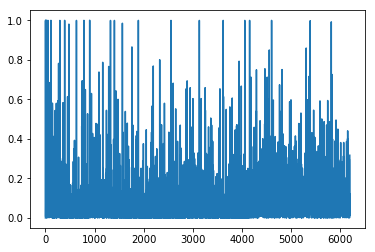

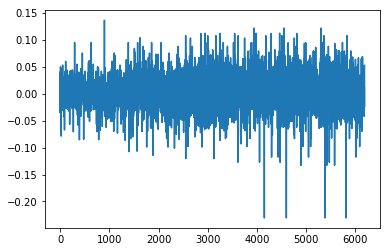

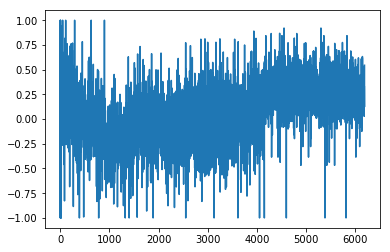

1.32538060335
[ 1.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  0.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.
  1.  0.  1.  1.  1.]
Writing away results
2006-02-01 00:00:00


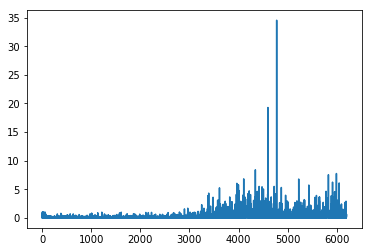

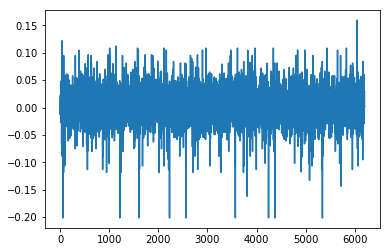

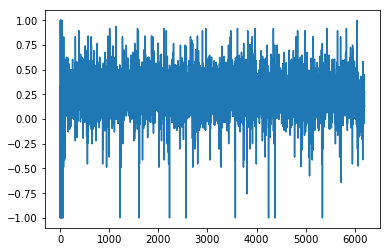

1.77139256948
[ 0.88888889  0.88888889  0.88888889  0.          0.          0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.          0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  0.88888889  0.88888889  0.          0.          0.          0.          0.
  0.88888889  0.88888889  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.          0.88888889  0.88888889  0.88888889
  0.          0.          0.88888889  0.          0.88888889  0.88888889
  0.88888889  0.88888889]
Writing away results
2006-03-01 00:00:00


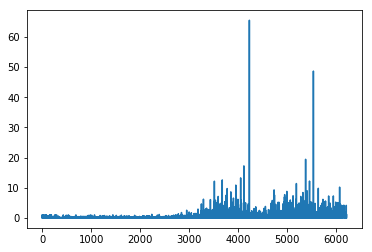

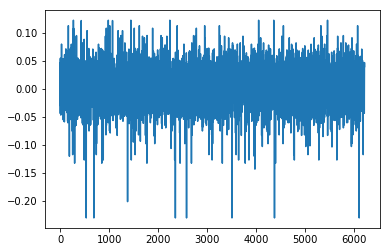

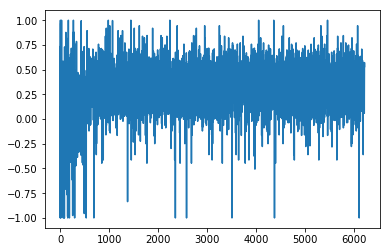

1.4556666868
[ 1.          1.          0.55555556  0.55555556  0.55555556  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.55555556  0.55555556  1.          1.          1.
  0.55555556  0.55555556  0.55555556  0.55555556  1.          1.
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          0.55555556  0.55555556  1.          1.
  1.          1.          1.          1.          1.        ]
Writing away results
2006-04-01 00:00:00


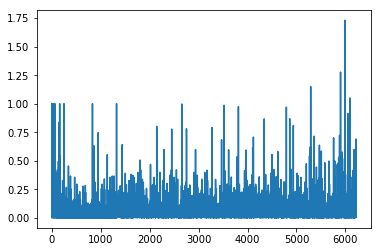

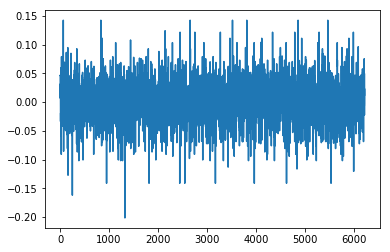

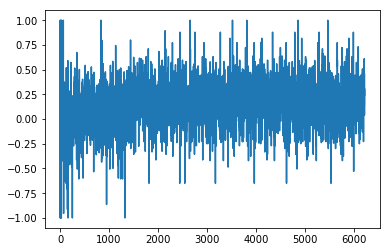

0.921657028157
[ 0.          0.88888889  0.88888889  0.88888889  0.88888889  0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.88888889  0.88888889  0.          0.          0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.88888889  0.88888889
  0.88888889  0.          0.          0.          0.          0.          0.        ]
Writing away results
2006-05-01 00:00:00


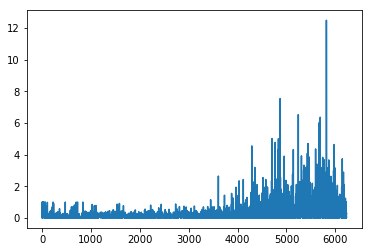

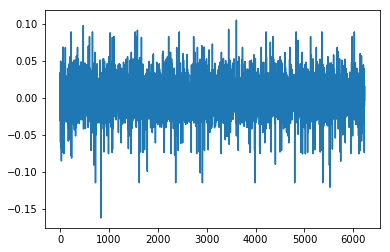

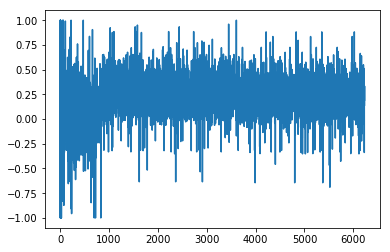

1.54686521914
[ 0.11111111  0.11111111  0.11111111  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.11111111  0.11111111  0.55555556  0.55555556
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556
  0.55555556  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.11111111  0.55555556  0.55555556  0.55555556
  0.11111111  0.11111111  0.55555556  0.11111111  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
2006-06-01 00:00:00


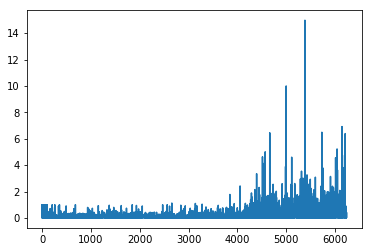

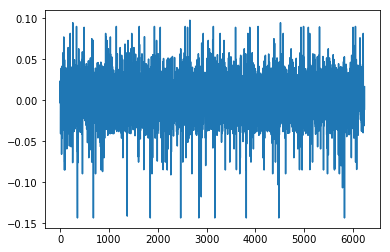

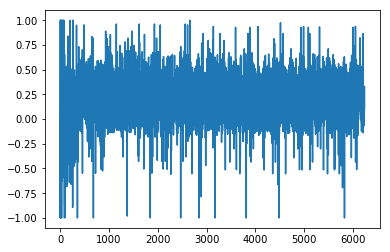

1.61939938959
[ 0.11111111  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.11111111  0.66666667  0.66666667  0.66666667
  0.66666667  0.11111111  0.11111111  0.66666667  0.66666667  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.11111111
  0.11111111  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2006-07-01 00:00:00


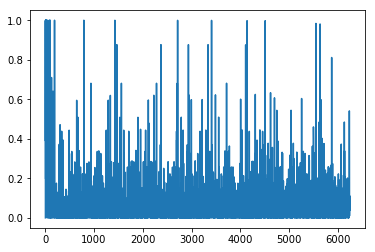

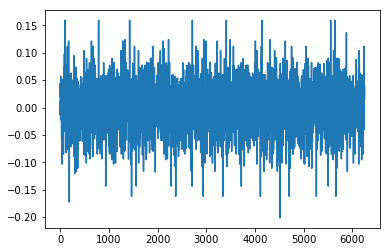

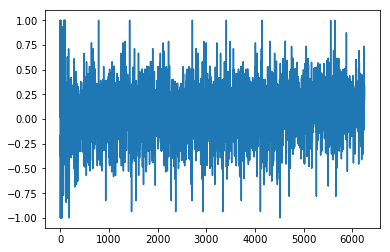

1.12040026434
[ 1.          1.          0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  1.          0.66666667  0.66666667  0.66666667  1.          1.
  1.          1.          1.          0.66666667  1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667]
Writing away results
2006-08-01 00:00:00


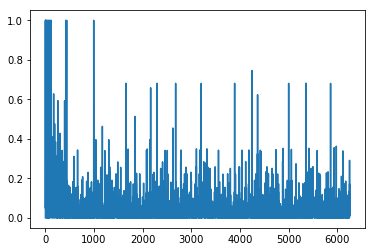

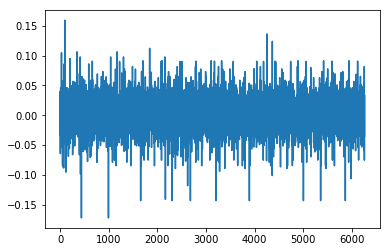

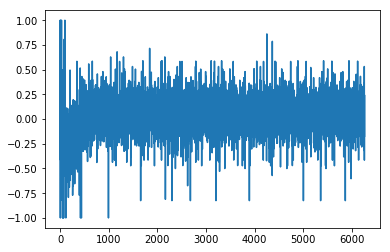

1.23617192193
[ 0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2006-09-01 00:00:00


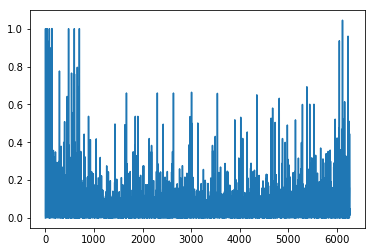

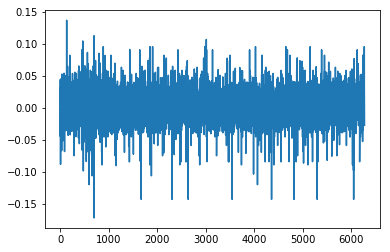

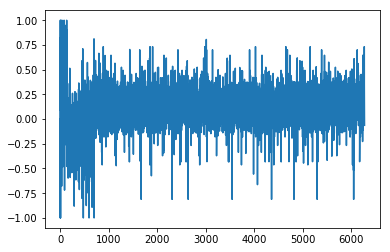

1.60104413322
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.
  0.66666667  0.66666667  0.66666667  0.          0.          0.          0.
  0.66666667  0.66666667  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.          0.          0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.          0.        ]
Writing away results
2006-10-01 00:00:00


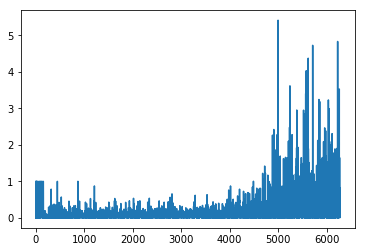

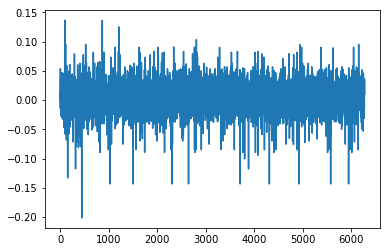

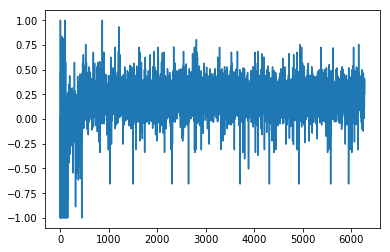

1.44661401941
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.22222222  0.66666667
  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.22222222  0.66666667  0.66666667
  0.66666667  0.22222222  0.22222222  0.66666667  0.22222222  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.22222222  0.22222222  0.22222222]
Writing away results
2006-11-01 00:00:00


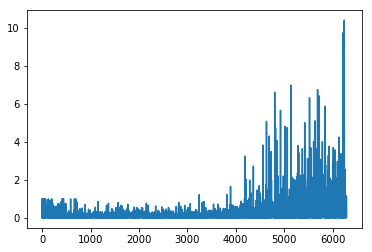

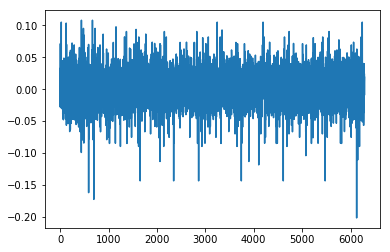

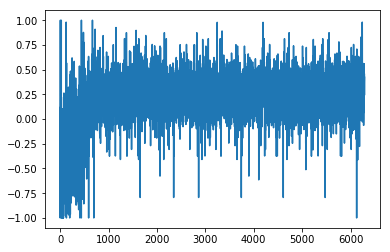

1.29018090431
[ 0.66666667  0.66666667  0.66666667  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.66666667  0.66666667  0.66666667
  0.44444444  0.44444444  0.66666667  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
2006-12-01 00:00:00


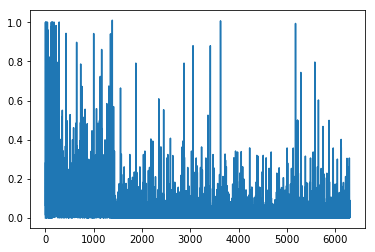

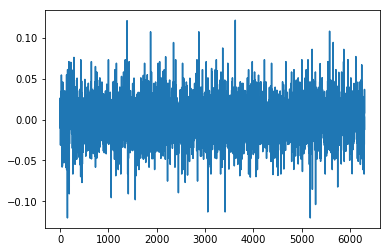

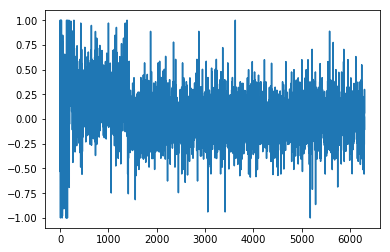

1.19578236192
[ 0.          0.          0.          0.44444444  0.          0.          0.
  0.44444444  0.44444444  0.          0.          0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.          0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.55555556
  0.          0.          0.          0.          0.44444444  0.
  0.44444444  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.44444444  0.          0.44444444
  0.44444444  0.44444444]
Writing away results
2007-01-01 00:00:00


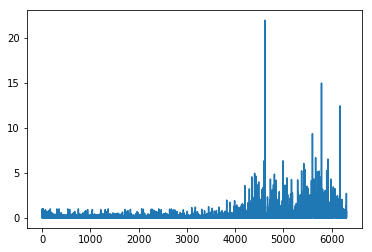

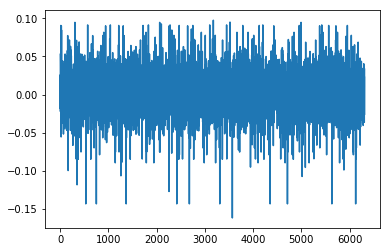

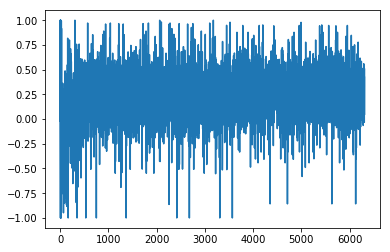

1.20205415586
[ 0.66666667  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.55555556  0.66666667  0.66666667  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.55555556  0.66666667  0.66666667  0.66666667  0.55555556  0.55555556
  0.66666667  0.55555556  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.55555556
  0.55555556  0.55555556  0.55555556  0.66666667  0.66666667]
Writing away results
2007-02-01 00:00:00


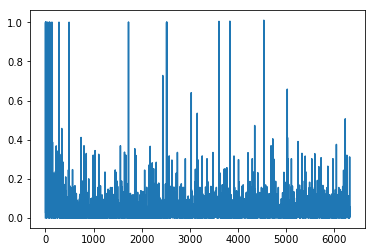

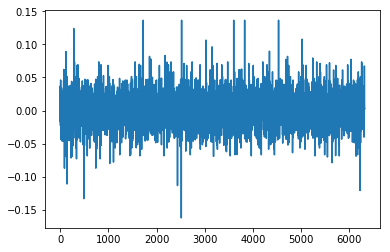

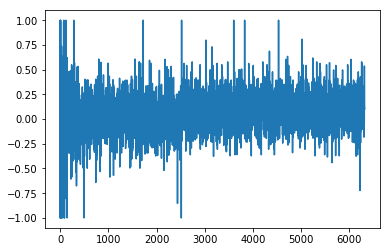

1.19642201157
[ 0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444
  0.44444444  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.33333333  0.33333333]
Writing away results
2007-03-01 00:00:00


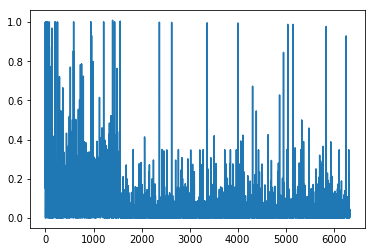

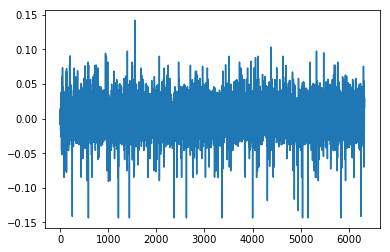

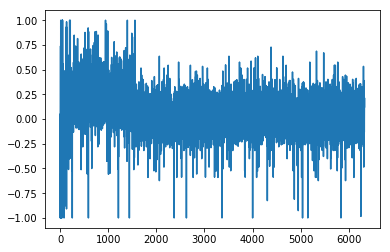

1.41397280554
[ 0.66666667  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.33333333  0.33333333  0.66666667  0.33333333
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.33333333  0.33333333  0.33333333
  0.33333333  0.66666667  0.66666667  0.66666667  0.66666667]
Writing away results
2007-04-01 00:00:00


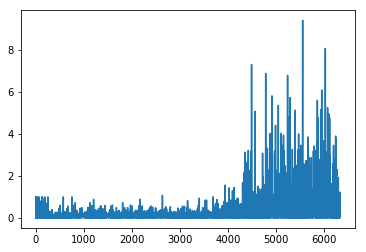

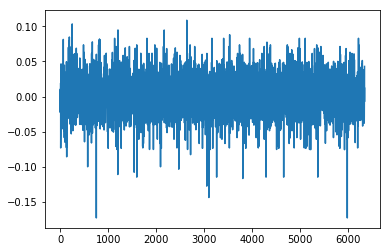

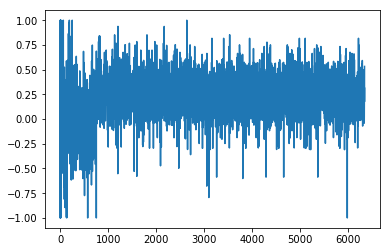

1.27607249937
[ 0.55555556  0.55555556  0.55555556  0.44444444  0.44444444  0.55555556
  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.55555556  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.44444444  0.55555556  0.55555556
  0.55555556  0.44444444  0.44444444  0.55555556  0.44444444  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.44444444  0.44444444  0.44444444  0.44444444
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556]
Writing away results
2007-05-01 00:00:00


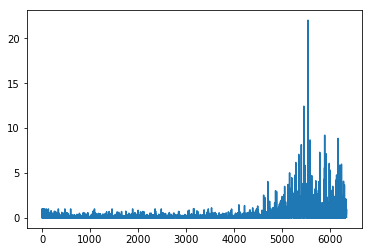

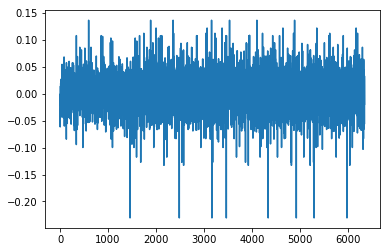

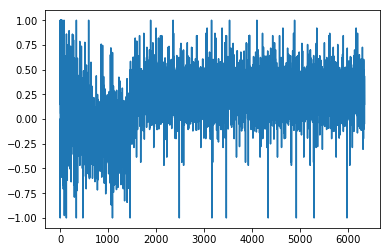

1.3050969567
[ 1.          1.          0.66666667  0.66666667  1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.66666667  1.          1.          1.          0.66666667  0.66666667
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.66666667  0.66666667
  0.66666667  0.66666667  1.          1.          1.          1.          1.
  1.        ]
Writing away results
2007-06-01 00:00:00


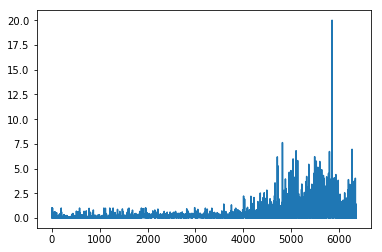

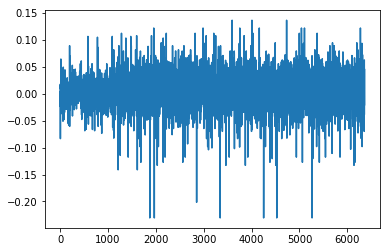

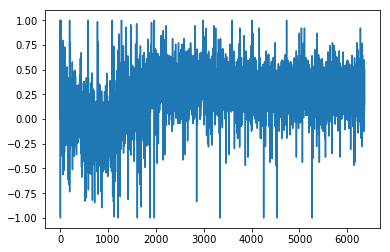

1.73739098995
[ 1.          0.11111111  0.11111111  1.          1.          0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  1.          1.
  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.
  0.11111111  1.          1.          1.          0.11111111  0.11111111
  1.          0.11111111  1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.11111111  0.11111111
  0.11111111  0.11111111  1.          1.          1.          1.          1.
  1.          1.        ]
Writing away results
2007-07-01 00:00:00


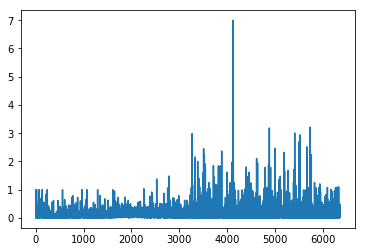

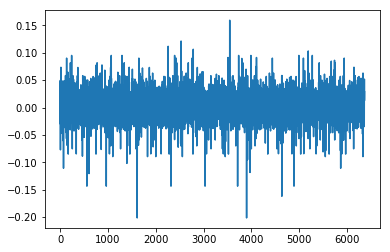

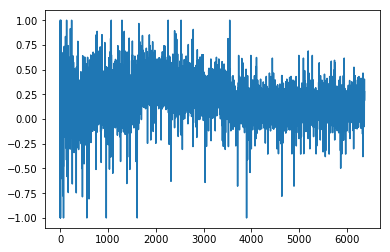

1.70327238822
[ 0.          0.          0.66666667  0.66666667  0.          0.          0.
  0.          0.          0.66666667  0.66666667  0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.          0.66666667
  0.66666667  0.66666667  0.          0.          0.66666667  0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.          0.          0.          0.
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.        ]
Writing away results
2007-08-01 00:00:00


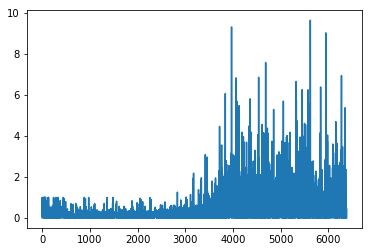

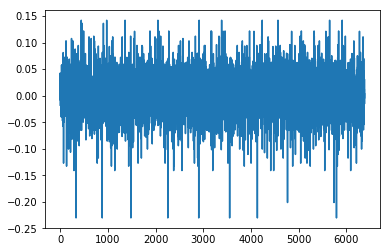

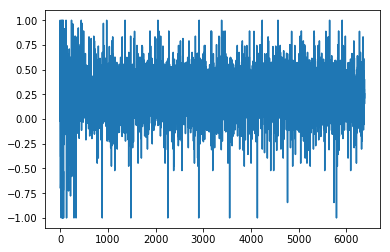

1.20329919457
[ 0.88888889  1.          1.          0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  1.          1.          0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  1.          1.          1.          1.          1.          1.
  1.          1.          1.          1.          0.88888889  1.          1.
  1.          0.88888889  0.88888889  1.          1.          1.          1.
  1.          1.          1.          1.          1.          1.          1.
  0.88888889  0.88888889  0.88888889  0.88888889  1.          1.          1.
  1.          1.          1.          1.          0.88888889  1.        ]
Writing away results
2007-09-01 00:00:00


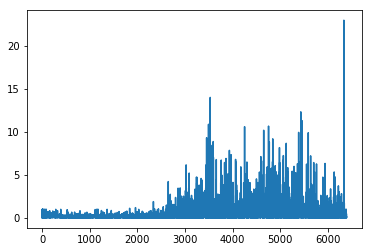

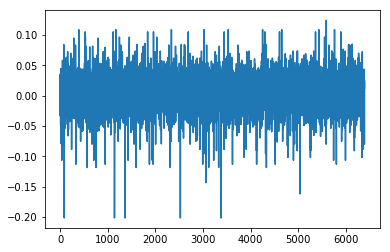

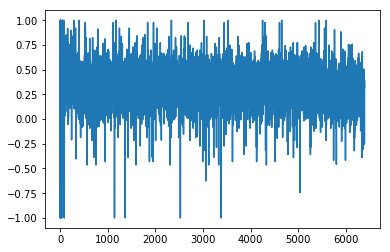

1.49370375981
[ 0.88888889  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222
  0.22222222  0.22222222  0.88888889  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.22222222  0.22222222  0.88888889  0.22222222
  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.88888889  0.88888889  0.22222222  0.22222222
  0.22222222  0.88888889  0.88888889  0.88888889  0.88888889  0.88888889
  0.88888889  0.88888889  0.22222222  0.88888889  0.88888889]
Writing away results
2007-10-01 00:00:00


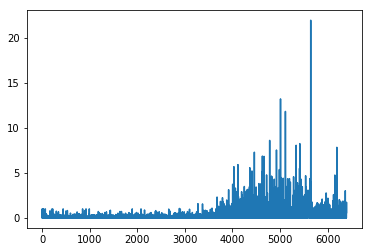

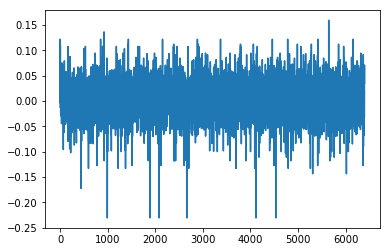

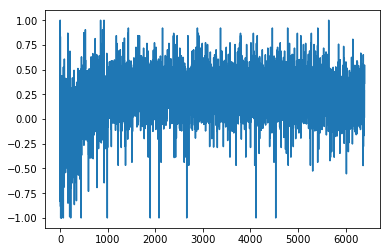

1.25448233113
[ 1.          0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  1.          1.          0.66666667  0.66666667  1.          0.66666667
  0.66666667  0.66666667  1.          0.66666667  0.66666667  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          0.66666667  1.          1.          1.          0.66666667
  0.66666667  1.          0.66666667  1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.66666667
  0.66666667  0.66666667  0.66666667  1.          1.          0.66666667
  1.          1.          1.          1.          0.66666667  1.          1.
  1.        ]
Writing away results
2007-11-01 00:00:00


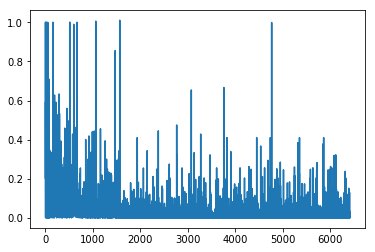

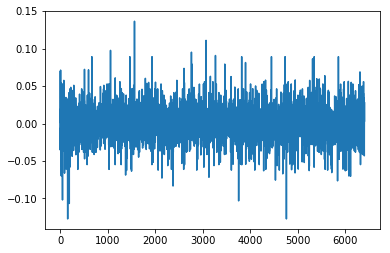

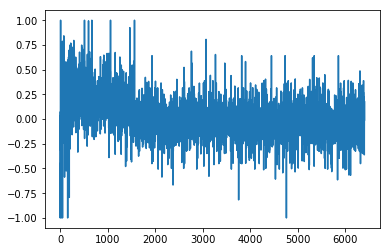

1.18184185283
[ 0.          0.          0.11111111  0.11111111  0.11111111  0.11111111
  0.88888889  0.11111111  0.11111111  0.11111111  0.11111111  0.11111111
  0.11111111  0.11111111  0.11111111  0.11111111  0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.11111111  0.          0.          0.          0.          0.11111111
  0.          0.11111111  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.11111111  0.
  0.11111111  0.11111111  0.          0.88888889  0.11111111  0.          0.
  0.          0.          0.11111111  0.          0.          0.88888889
  0.        ]
Writing away results
2007-12-01 00:00:00


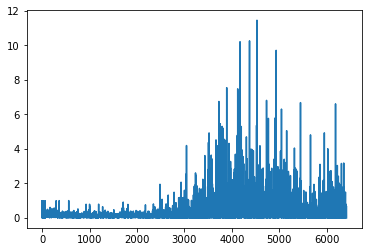

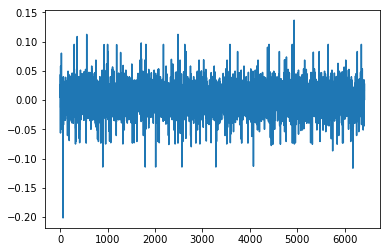

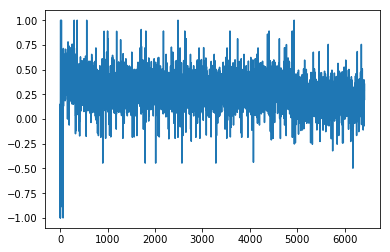

1.67399781922
[ 0.          0.          0.          0.          0.55555556  0.55555556
  0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556
  0.          0.55555556  0.55555556  0.55555556  0.          0.
  0.55555556  0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.55555556  0.55555556  0.          0.
  0.          0.          0.55555556  0.55555556  0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556  0.          0.55555556  0.55555556
  0.55555556  0.55555556  0.55555556]
Writing away results
2008-01-01 00:00:00


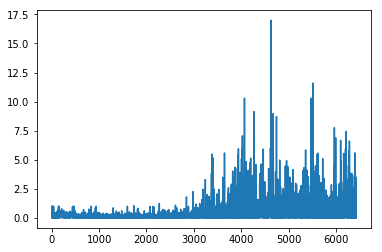

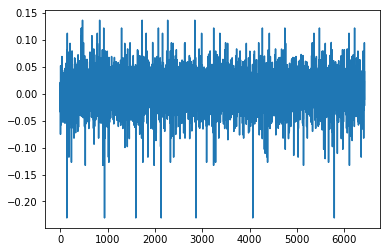

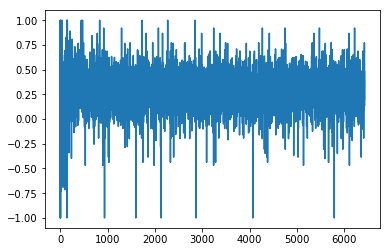

1.94367790063
[ 0.22222222  0.22222222  0.22222222  1.          1.          0.22222222
  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222  0.22222222
  0.22222222  0.22222222  1.          1.          1.          1.          1.
  1.          1.          1.          1.          1.          0.22222222
  1.          1.          1.          0.22222222  0.22222222  1.          1.
  1.          1.          1.          1.          1.          1.          1.
  1.          1.          0.22222222  0.22222222  0.22222222  0.22222222
  1.          1.          1.          1.          1.          1.          1.
  0.22222222  0.22222222  1.          1.          1.          1.          1.        ]
Writing away results
2008-02-01 00:00:00


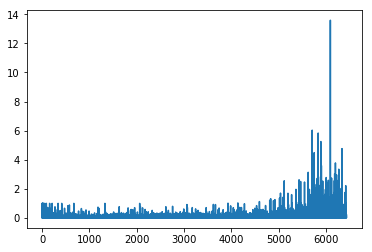

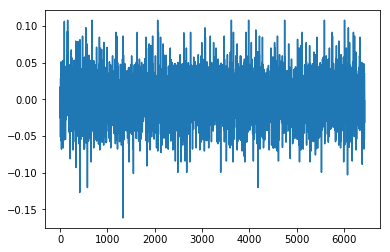

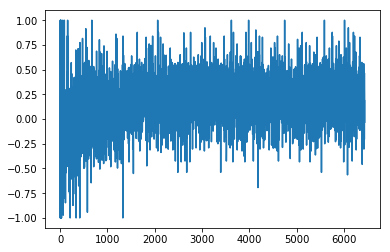

1.17055344943
[ 0.66666667  0.66666667  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667  0.66666667
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667
  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667  0.44444444
  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.66666667  0.66666667
  0.66666667  0.66666667  0.44444444  0.44444444  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.66666667  0.44444444  0.44444444
  0.44444444  0.44444444  0.44444444  0.44444444  0.44444444]
Writing away results
Done!


In [14]:
# initialize
init = tf.global_variables_initializer()
startepsilon = 0.8
endepsilon = 0.01
startlr = 0.8
endlr = 0.01
startgamma = 0.01
endgamma = 0.8
TWlist = []
Index = []
MWeights = []
Turnover = []
chooserlist = []
RU = []
learningrateQ = 0.01
n = 707
periods = 60
epochs = 10     # preferred to have a low amount of epochs because otherwise the the same data is used multiple times (usually not the case in stock returns)

# data parsing
dates = data['Date']
mdata = data[['r','xs','xb']]
mdata.index = pd.DatetimeIndex(dates)

# include the lags
for i in range(1,num_lags+1):  # 1 till 11
    mdata['r_lag' + str(i)] = mdata['r'].shift(i)
    mdata['xs_lag' + str(i)] = mdata['xs'].shift(i)
    mdata['xb_lag' + str(i)] = mdata['xb'].shift(i)

mdata.drop(mdata.head(num_lags).index, inplace=True)
# have a look at the data (if not include NANs)
# print(mdata)

# Train the the Q-function DNN
with tf.Session() as sess:
    for i in range(240,int(n-periods-1)):
        lostlist = []
        OptimalWeights = np.zeros(periods-1)
        currentK = 0
        print(mdata.index[i])
        rmin = -1
        rmax = 1
        sess.run(init) # initialize the Neural Network again
        epsilon = 0.15
        lr = 0.1
        gamma = 0.98
        currentEpoch = 0
        rlist = []  
        runitlist = []
        while currentEpoch < epochs:
            #Training of the Q-Network for the data available (with Neural Nets) 
            indexes = np.asarray(range(i+currentK-1)) 
            random.shuffle(indexes)
            for j in indexes:
                s = mdata.iloc[j,:].values.reshape(1,num_inputvar)
                #Choose an action by greedily (with e chance of random action) from the Q-network
                a_int,allQ = sess.run([A_Max,output],feed_dict={NN_input:s})
                a = A[a_int]  # -1 because index
                if np.random.rand(1) < epsilon:
                    a = random.choice(A)

                #Get new state and reward from environment
                s1 = mdata.iloc[j+1,:].values.reshape(1,num_inputvar)
                r = (a*s1[0][1] + (1-a)*s1[0][2]) #reward: this is now the wealth gained from this step, but could be other rewards like utility
                rlist.append(r)
                Q = sess.run(output,feed_dict={NN_input:s1})
                    
                #Obtain maxQ' and set our target value for chosen action.
                Q1 = np.max(Q)
                targetQ = allQ
                if(len(rlist)>1):
                    rmin = np.min(rlist)
                    rmax = np.max(rlist)
                runit = -1 + 2*((r -rmin)/(rmax-rmin))
                targetQ[0,int(a*(num_actions-1))] = runit + gamma*Q1
                runitlist.append(runit)
                #Train the neural network using target and predicted Q values
                opt,W1,loss_ = sess.run([optmzr,w1,loss],feed_dict={NN_input:s,Q_Next:targetQ,learning_rate:lr})
                lostlist.append(loss_)
            currentEpoch += 1
                
        while currentK < periods - 1:
            # After training now calculate the optimal weights for the K=60 periods to come
            s = mdata.iloc[i+currentK,:].values.reshape(1,num_inputvar)
            a_int,allQ = sess.run([A_Max,output],feed_dict={NN_input:s})
            aOpt = A[a_int]
            OptimalWeights[currentK] = aOpt
            currentK += 1
            
        # For insight purposes (Write away)
        plt.ion()
        plt.plot(lostlist)
        plt.show()
        plt.plot(rlist)
        plt.show()
        plt.plot(runitlist)
        plt.show()
        
        firstdiff = OptimalWeights[1:] - OptimalWeights[:-1]
        MWeights.append(np.mean(OptimalWeights))
        TerminalWealth = np.exp(sum(OptimalWeights*mdata[i+1:i+currentK+1]['xs'] + (1-OptimalWeights)*mdata[i+1:i+currentK+1]['xb']))
        TWlist.append(TerminalWealth)
        Index.append(mdata.index[i])
        Turnover.append(sum(abs(firstdiff*np.exp(mdata[i+1:i+currentK]['xs'])) + abs((1-firstdiff)*np.exp(mdata[i+1:i+currentK]['xb']))))
        RU.append((1/(1-5))*pow(TerminalWealth,(1-5)))
        print(TerminalWealth)
        print(OptimalWeights)
        
        print('Writing away results')
        df = pd.DataFrame({'index date':Index,'TW':TWlist, 'Mean Weights Xs':MWeights,'Turnover':Turnover, 'Realized Utility':RU})
        df.to_excel('DNN_constant_singleTrain.xlsx', sheet_name='sheet1', index=False)
print('Done!')
        